# M2177.003100 Deep Learning <br> Assignment #4 Implementing Variational AutoEncoder - part1 MNIST data

Copyright (C) Data Science Laboratory, Seoul National University. This material is for educational uses only. Some contents are based on the material provided by other paper/book authors and may be copyrighted by them. Written by Chaehun Shin, September 2020

In this notebook, you will learn how to implement Variational AutoEncoder (VAEs) <br>
The goal here is to build VAEs that draw a digit (MNIST data) <br> 

**Note**: certain details are missing or ambiguous on purpose, in order to test your knowledge on the related materials. However, if you really feel that something essential is missing and cannot proceed to the next step, then contact the teaching staff with clear description of your problem.

### Submitting your work:
<font color=red>**DO NOT clear the final outputs**</font> so that TAs can grade both your code and results.  
Once you have done **all parts**, run the *CollectSubmission.sh* script with your **Student_ID** as input argument. <br>
This will produce a zipped file called *[Your Student_ID].zip*. Please submit this file on ETL. &nbsp;&nbsp; (Usage: ./*CollectSubmission.sh* &nbsp; Student_ID)

### Some helpful tutorials and references for assignment #4-1:
- [1] Pytorch official tutorials. [[link]](https://pytorch.org/tutorials/)
- [2] Stanford CS231n lectures. [[link]](http://cs231n.stanford.edu/)
- [3] Kingma, Diederik P., and Max Welling. "Auto-encoding variational bayes." arXiv preprint arXiv:1312.6114 (2013).
- [4] Doersch, Carl. "Tutorial on variational autoencoders." arXiv preprint arXiv:1606.05908 (2016).
- [5] Kingma, Diederik P., and Max Welling. "An Introduction to Variational Autoencoders." arXiv preprint arXiv:1906.02691 (2019).

## 0. Download and load MNIST datasets
The MNIST datasets will be downloaded into the 'data/mnist' directory. If you want to change the directory the data is saved in, change 'mnist_data_dir' with where you want. <br>

In [1]:
import os
from torchvision.datasets import MNIST
import torchvision.transforms as T

mnist_data_dir = './data/mnist'
dataset = MNIST(root=mnist_data_dir,
               transform=T.ToTensor(), train=True, download=True)
print(dataset.train_data.shape)
print(dataset.train_labels.shape)

torch.Size([60000, 28, 28])
torch.Size([60000])


/home/ccw/anaconda3/envs/deep-learning-20/lib/python3.8/site-packages/torchvision/datasets/mnist.py:55: UserWarning: train_data has been renamed data
  warnings.warn("train_data has been renamed data")
/home/ccw/anaconda3/envs/deep-learning-20/lib/python3.8/site-packages/torchvision/datasets/mnist.py:45: UserWarning: train_labels has been renamed targets
  warnings.warn("train_labels has been renamed targets")


## <a name="1"></a> 1. Building a network

In this section, you will implement neural networks for <br>
(1) encoder $q_\phi(z \mid x)$ to encode latent variable distribution from the image of the digit <br>
(2) decoder $p_\theta(x \mid z)$ to decode the image distribution of the digit from the sample of latent variable distribution.<br>
You can use some layer function implemented in **'torch.nn'** library (abbretivated as **nn**) or **'torch.nn.functional'** library (abbreviated as **F**) as you want.

Just write the code in whatever way you find most clear.

In [9]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

hdim1 = 256
hdim2 = 128

It is time for an encoder. <br>
It takes img_data, img_dim(should be 28\*28\*1=784 here), latent_dim(dimension of the z).<br>
It should return parameters of the latent variable distribution with the dimension of latent_dim. <br>
Because we model the latent variable distribution as multivariate Gaussian, we can make the distribution with only mean and covariance matrix. Also as we model each dimension of the latent variable as independent, covariance matrix becomes a diagonal matrix and we need only latent_dim number of elements for covariance matrix. <br>
So we output 2 latent_dim dimension vectors from the encoder function implemented by neural network. **I recommend to use logvar not variance itself for stable training.**


Maybe you can use two neural networks for mean and logvar vectors. However **it is recommended to use only one neural network with two last branches.**<br>
For example, if you use 5 layer networks, first 4 layers are shared and there are two 5th layers each corresponding to mean and logvar.

In [3]:
class Encoder(nn.Module):
    def __init__(self, img_dim=784, latent_dim=30):
        super().__init__()
        ################ ToDo ################
        self.fc1 = nn.Linear(img_dim, hdim1)
        self.fc2 = nn.Linear(hdim1, hdim2)
        self.fc3_mu = nn.Linear(hdim2, latent_dim)
        self.fc3_var = nn.Linear(hdim2, latent_dim)
    def forward(self, imgs):
        ################ ToDo ################
        out = F.relu(self.fc1(imgs))
        out = F.relu(self.fc2(out))
        mu = self.fc3_mu(out)
        logvar = self.fc3_var(out)
        return mu, logvar

Now, it's time for a decoder model. <br>
It takes sample of the latent variable distribution(z), latent_dim(dimension of the latent variable), and img_dim(28\*28\*1=784 here). It should return the reconstruction of the original image x_hat. <br>
Decoder models the likelihood distributions and in here, we model each pixel as Bernoulli distribution(So we use binary cross entropy as loss function). So **you should use the sigmoid function to make the output as probability in [0, 1]**

In [4]:
class Decoder(nn.Module):
    def __init__(self, latent_dim=30, img_dim=784):
        super().__init__()
        ################ ToDo ################
        self.fc4 = nn.Linear(latent_dim, hdim2)
        self.fc5 = nn.Linear(hdim2, hdim1)
        self.fc6 = nn.Linear(hdim1, img_dim)
        
    def forward(self, z):
        ################ ToDo ################
        out = F.relu(self.fc4(z))
        out = F.relu(self.fc5(out))
        out = F.sigmoid(self.fc6(out))
        return out

Now, we construct the VAEs with encoder and decoder.<br>
This model rquires an implementation of reparameterization trick (which you need to implement) due to impossible differentiation of sampling.<br>

### Reparameterization trick can be implemented as follows.
Our Encoder outputs mean and variance of Guassian distrubiton as parameters of posterior distribution.<br>

1. We sample epsilon form standard normal distribution with the size of latent dimension. <br>
2. Then, we scale and shift epsilon by using variance and mean of posterior distrubiton.<br>

Because sampling is out of graph, gradient can be flowed from loss to encoder and decoder. So we can train all networks jointly as you see in the forward function.

If you want to sample from the VAEs, you just sample from the prior distribution and go trough the decoder, as you can see in the sample function implemented below.

In [7]:
class VAE(nn.Module):
    def __init__(self, img_dim=784, latent_dim=10):
        super().__init__()
        self.encoder = Encoder(img_dim, latent_dim)
        self.decoder = Decoder(latent_dim, img_dim)
        self.latent_dim = latent_dim
        
    def encode(self, imgs):
        mu, logvar = self.encoder(imgs)
        return mu, logvar
    
    def decode(self, z):
        recon_imgs = self.decoder(z)
        return recon_imgs
        
    def reparameterize(self, eps, mu, logvar):
        ################ ToDo ################
        std = torch.exp(0.5*logvar)
        # eps = torch.randn_like(std)
        return eps.mul(std).add_(mu)
        
    def forward(self, imgs):
        mu, logvar = self.encode(imgs)
        eps = torch.randn_like(mu)
        z = self.reparameterize(eps, mu, logvar)
        recon_imgs = self.decode(z)
        return recon_imgs, mu, logvar
    
    def sample(self, num_samples=16):
        device = next(self.parameters()).device
        eps = torch.randn((num_samples, self.latent_dim)).to(device)
        gen_imgs = self.decode(eps)
        return gen_imgs        

## <a name="2"></a> 2. Build a main part and train

In this section, you will implement the main part (define the loss function in TODO part).
Feel free to set the hyperparmeters and fill in the main part.
Then run the code and check the model reconstructs a digit.
When you are done, run the following to check your implementations.

Be sure to define **batch size bigger than 16** (Because, we visualize 16 images per batch in training time). <br>
You must show **at least three generated images** (At the beginning of ,in the midway of, at the end of training).

In [6]:
# hyperparameter setting
img_dim=784
latent_dim=50

batch_size = 64 # it should be larger than 16
learning_rate = 1e-4
total_iter = 50000

log_freq = 10
viz_freq = 50

/home/ccw/anaconda3/envs/deep-learning-20/lib/python3.8/site-packages/torch/nn/functional.py:1625: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


Iter: 00010/50000, Recon loss: 34320.4844, KL div loss: 6.1830, Total loss: 34326.6680
Iter: 00020/50000, Recon loss: 33761.1406, KL div loss: 7.8148, Total loss: 33768.9570
Iter: 00030/50000, Recon loss: 33012.7812, KL div loss: 16.6907, Total loss: 33029.4727
Iter: 00040/50000, Recon loss: 31792.1562, KL div loss: 53.9914, Total loss: 31846.1484
Iter: 00050/50000, Recon loss: 29632.3926, KL div loss: 231.1187, Total loss: 29863.5117


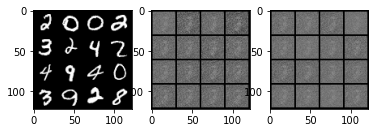

Iter: 00060/50000, Recon loss: 26184.1680, KL div loss: 784.6871, Total loss: 26968.8555
Iter: 00070/50000, Recon loss: 20911.9336, KL div loss: 2422.1023, Total loss: 23334.0352
Iter: 00080/50000, Recon loss: 17800.5977, KL div loss: 2018.7771, Total loss: 19819.3750
Iter: 00090/50000, Recon loss: 15729.3906, KL div loss: 1743.3896, Total loss: 17472.7812
Iter: 00100/50000, Recon loss: 15551.7051, KL div loss: 1387.7126, Total loss: 16939.4180


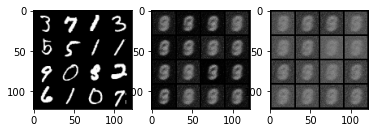

Iter: 00110/50000, Recon loss: 15216.8320, KL div loss: 1223.4312, Total loss: 16440.2637
Iter: 00120/50000, Recon loss: 14833.0742, KL div loss: 1055.6519, Total loss: 15888.7266
Iter: 00130/50000, Recon loss: 14286.7344, KL div loss: 899.4767, Total loss: 15186.2109
Iter: 00140/50000, Recon loss: 14260.0254, KL div loss: 674.7339, Total loss: 14934.7598
Iter: 00150/50000, Recon loss: 13413.3633, KL div loss: 742.4628, Total loss: 14155.8262


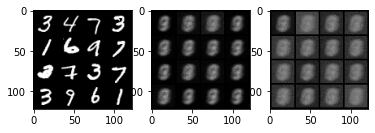

Iter: 00160/50000, Recon loss: 13504.2021, KL div loss: 720.9990, Total loss: 14225.2012
Iter: 00170/50000, Recon loss: 12689.3340, KL div loss: 678.2691, Total loss: 13367.6035
Iter: 00180/50000, Recon loss: 13660.3691, KL div loss: 587.9064, Total loss: 14248.2754
Iter: 00190/50000, Recon loss: 13302.7129, KL div loss: 512.2465, Total loss: 13814.9590
Iter: 00200/50000, Recon loss: 13849.8379, KL div loss: 406.9417, Total loss: 14256.7793


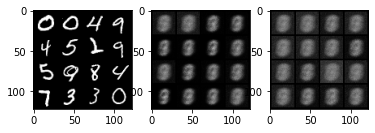

Iter: 00210/50000, Recon loss: 13737.1064, KL div loss: 382.4532, Total loss: 14119.5596
Iter: 00220/50000, Recon loss: 13354.1016, KL div loss: 423.4744, Total loss: 13777.5762
Iter: 00230/50000, Recon loss: 13068.3008, KL div loss: 432.6542, Total loss: 13500.9551
Iter: 00240/50000, Recon loss: 14040.2627, KL div loss: 369.4716, Total loss: 14409.7344
Iter: 00250/50000, Recon loss: 13410.5039, KL div loss: 274.3893, Total loss: 13684.8936


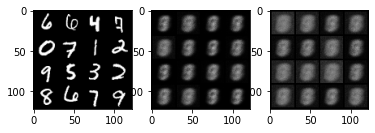

Iter: 00260/50000, Recon loss: 13515.5752, KL div loss: 349.7830, Total loss: 13865.3584
Iter: 00270/50000, Recon loss: 13801.2646, KL div loss: 264.8669, Total loss: 14066.1318
Iter: 00280/50000, Recon loss: 13151.7246, KL div loss: 296.6625, Total loss: 13448.3867
Iter: 00290/50000, Recon loss: 12687.0176, KL div loss: 300.0157, Total loss: 12987.0332
Iter: 00300/50000, Recon loss: 13246.8320, KL div loss: 304.9658, Total loss: 13551.7979


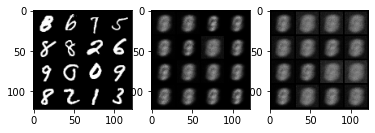

Iter: 00310/50000, Recon loss: 12686.2969, KL div loss: 301.5093, Total loss: 12987.8066
Iter: 00320/50000, Recon loss: 13900.0508, KL div loss: 196.9008, Total loss: 14096.9512
Iter: 00330/50000, Recon loss: 13676.0840, KL div loss: 168.4362, Total loss: 13844.5205
Iter: 00340/50000, Recon loss: 12951.2881, KL div loss: 231.7629, Total loss: 13183.0508
Iter: 00350/50000, Recon loss: 12889.4268, KL div loss: 277.7883, Total loss: 13167.2148


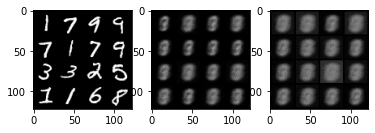

Iter: 00360/50000, Recon loss: 13439.2861, KL div loss: 181.6651, Total loss: 13620.9512
Iter: 00370/50000, Recon loss: 12870.7285, KL div loss: 254.6073, Total loss: 13125.3359
Iter: 00380/50000, Recon loss: 13288.0596, KL div loss: 150.0950, Total loss: 13438.1543
Iter: 00390/50000, Recon loss: 12417.1953, KL div loss: 265.5140, Total loss: 12682.7090
Iter: 00400/50000, Recon loss: 12854.5742, KL div loss: 202.2634, Total loss: 13056.8379


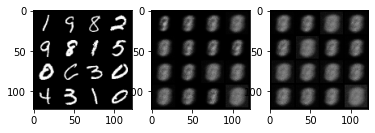

Iter: 00410/50000, Recon loss: 12839.1973, KL div loss: 197.8221, Total loss: 13037.0195
Iter: 00420/50000, Recon loss: 13575.9316, KL div loss: 139.2605, Total loss: 13715.1924
Iter: 00430/50000, Recon loss: 13110.6523, KL div loss: 207.2051, Total loss: 13317.8574
Iter: 00440/50000, Recon loss: 13187.4941, KL div loss: 194.0101, Total loss: 13381.5039
Iter: 00450/50000, Recon loss: 12634.4590, KL div loss: 189.1152, Total loss: 12823.5742


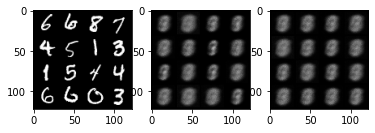

Iter: 00460/50000, Recon loss: 12837.3047, KL div loss: 201.2315, Total loss: 13038.5361
Iter: 00470/50000, Recon loss: 13081.4404, KL div loss: 144.4113, Total loss: 13225.8516
Iter: 00480/50000, Recon loss: 12521.5449, KL div loss: 192.2297, Total loss: 12713.7744
Iter: 00490/50000, Recon loss: 12941.7363, KL div loss: 164.0048, Total loss: 13105.7412
Iter: 00500/50000, Recon loss: 12150.4961, KL div loss: 179.1965, Total loss: 12329.6924


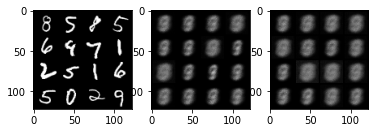

Iter: 00510/50000, Recon loss: 12513.8379, KL div loss: 205.0595, Total loss: 12718.8975
Iter: 00520/50000, Recon loss: 12739.0273, KL div loss: 139.9465, Total loss: 12878.9736
Iter: 00530/50000, Recon loss: 13179.1641, KL div loss: 137.5229, Total loss: 13316.6865
Iter: 00540/50000, Recon loss: 12735.4766, KL div loss: 154.9065, Total loss: 12890.3828
Iter: 00550/50000, Recon loss: 12498.6436, KL div loss: 179.4613, Total loss: 12678.1045


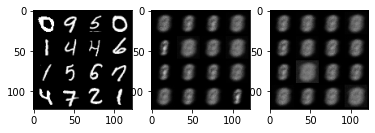

Iter: 00560/50000, Recon loss: 12914.2744, KL div loss: 144.3674, Total loss: 13058.6416
Iter: 00570/50000, Recon loss: 12965.2012, KL div loss: 139.9630, Total loss: 13105.1641
Iter: 00580/50000, Recon loss: 12810.4688, KL div loss: 147.2450, Total loss: 12957.7139
Iter: 00590/50000, Recon loss: 12711.8770, KL div loss: 129.2401, Total loss: 12841.1172
Iter: 00600/50000, Recon loss: 11926.0840, KL div loss: 223.4239, Total loss: 12149.5078


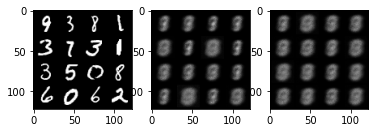

Iter: 00610/50000, Recon loss: 12661.2207, KL div loss: 163.2262, Total loss: 12824.4473
Iter: 00620/50000, Recon loss: 12934.0703, KL div loss: 158.6777, Total loss: 13092.7480
Iter: 00630/50000, Recon loss: 12544.4844, KL div loss: 141.6549, Total loss: 12686.1396
Iter: 00640/50000, Recon loss: 12340.2246, KL div loss: 161.1088, Total loss: 12501.3330
Iter: 00650/50000, Recon loss: 12565.1895, KL div loss: 174.9947, Total loss: 12740.1846


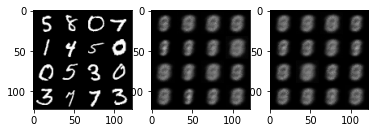

Iter: 00660/50000, Recon loss: 12342.5820, KL div loss: 144.7420, Total loss: 12487.3242
Iter: 00670/50000, Recon loss: 12413.2412, KL div loss: 185.6621, Total loss: 12598.9033
Iter: 00680/50000, Recon loss: 12535.9082, KL div loss: 154.7757, Total loss: 12690.6836
Iter: 00690/50000, Recon loss: 13184.5967, KL div loss: 151.3350, Total loss: 13335.9316
Iter: 00700/50000, Recon loss: 13051.7354, KL div loss: 162.6711, Total loss: 13214.4062


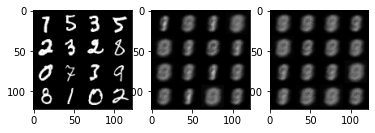

Iter: 00710/50000, Recon loss: 12387.1895, KL div loss: 160.5102, Total loss: 12547.6992
Iter: 00720/50000, Recon loss: 13327.7559, KL div loss: 163.2859, Total loss: 13491.0420
Iter: 00730/50000, Recon loss: 12544.9590, KL div loss: 146.1669, Total loss: 12691.1260
Iter: 00740/50000, Recon loss: 12339.6318, KL div loss: 217.6816, Total loss: 12557.3135
Iter: 00750/50000, Recon loss: 13241.5459, KL div loss: 161.9404, Total loss: 13403.4863


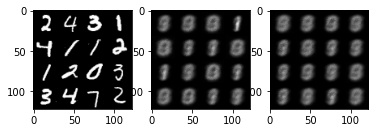

Iter: 00760/50000, Recon loss: 12319.6240, KL div loss: 140.7586, Total loss: 12460.3828
Iter: 00770/50000, Recon loss: 13434.7559, KL div loss: 164.7157, Total loss: 13599.4717
Iter: 00780/50000, Recon loss: 12505.8750, KL div loss: 204.2127, Total loss: 12710.0879
Iter: 00790/50000, Recon loss: 12490.6543, KL div loss: 176.6777, Total loss: 12667.3320
Iter: 00800/50000, Recon loss: 12399.6602, KL div loss: 154.0416, Total loss: 12553.7021


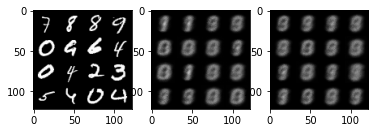

Iter: 00810/50000, Recon loss: 12518.0098, KL div loss: 190.0198, Total loss: 12708.0293
Iter: 00820/50000, Recon loss: 12996.0566, KL div loss: 135.7807, Total loss: 13131.8369
Iter: 00830/50000, Recon loss: 11895.1924, KL div loss: 229.9364, Total loss: 12125.1289
Iter: 00840/50000, Recon loss: 12652.9766, KL div loss: 189.7639, Total loss: 12842.7402
Iter: 00850/50000, Recon loss: 11889.7402, KL div loss: 169.1806, Total loss: 12058.9209


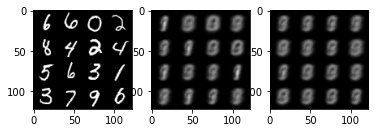

Iter: 00860/50000, Recon loss: 12487.6621, KL div loss: 158.6919, Total loss: 12646.3535
Iter: 00870/50000, Recon loss: 12086.4395, KL div loss: 188.6348, Total loss: 12275.0742
Iter: 00880/50000, Recon loss: 12175.4404, KL div loss: 141.1178, Total loss: 12316.5586
Iter: 00890/50000, Recon loss: 12314.5645, KL div loss: 181.4265, Total loss: 12495.9912
Iter: 00900/50000, Recon loss: 12185.2969, KL div loss: 190.4898, Total loss: 12375.7871


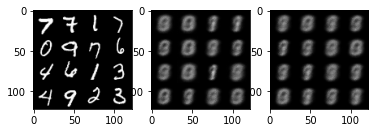

Iter: 00910/50000, Recon loss: 12212.6611, KL div loss: 192.8763, Total loss: 12405.5371
Iter: 00920/50000, Recon loss: 12088.3652, KL div loss: 194.9191, Total loss: 12283.2842
Iter: 00930/50000, Recon loss: 12650.8320, KL div loss: 175.0903, Total loss: 12825.9219
Iter: 00940/50000, Recon loss: 11109.3008, KL div loss: 233.9830, Total loss: 11343.2842
Iter: 00950/50000, Recon loss: 12493.3955, KL div loss: 165.7955, Total loss: 12659.1914


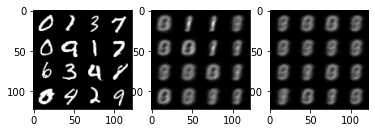

Iter: 00960/50000, Recon loss: 12511.5400, KL div loss: 128.9211, Total loss: 12640.4609
Iter: 00970/50000, Recon loss: 12970.1279, KL div loss: 191.3473, Total loss: 13161.4756
Iter: 00980/50000, Recon loss: 11751.6953, KL div loss: 220.8147, Total loss: 11972.5098
Iter: 00990/50000, Recon loss: 11873.0088, KL div loss: 239.9377, Total loss: 12112.9463
Iter: 01000/50000, Recon loss: 12224.6768, KL div loss: 187.3894, Total loss: 12412.0664


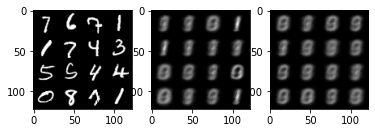

Iter: 01010/50000, Recon loss: 12679.0332, KL div loss: 164.4999, Total loss: 12843.5332
Iter: 01020/50000, Recon loss: 11573.5498, KL div loss: 244.9727, Total loss: 11818.5225
Iter: 01030/50000, Recon loss: 12748.5557, KL div loss: 153.8192, Total loss: 12902.3750
Iter: 01040/50000, Recon loss: 12320.3086, KL div loss: 189.9855, Total loss: 12510.2939
Iter: 01050/50000, Recon loss: 11938.2363, KL div loss: 147.1435, Total loss: 12085.3799


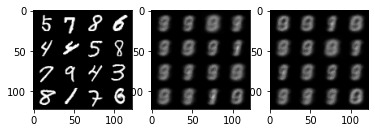

Iter: 01060/50000, Recon loss: 12663.1289, KL div loss: 181.2587, Total loss: 12844.3877
Iter: 01070/50000, Recon loss: 12200.8174, KL div loss: 210.9096, Total loss: 12411.7266
Iter: 01080/50000, Recon loss: 12057.8340, KL div loss: 213.5041, Total loss: 12271.3379
Iter: 01090/50000, Recon loss: 12877.2754, KL div loss: 226.1689, Total loss: 13103.4443
Iter: 01100/50000, Recon loss: 12789.1895, KL div loss: 223.8446, Total loss: 13013.0342


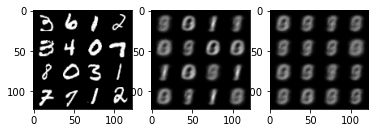

Iter: 01110/50000, Recon loss: 12250.3320, KL div loss: 245.3300, Total loss: 12495.6621
Iter: 01120/50000, Recon loss: 11907.7598, KL div loss: 245.4202, Total loss: 12153.1797
Iter: 01130/50000, Recon loss: 12321.2148, KL div loss: 216.9464, Total loss: 12538.1611
Iter: 01140/50000, Recon loss: 12667.6973, KL div loss: 270.4780, Total loss: 12938.1748
Iter: 01150/50000, Recon loss: 12267.5391, KL div loss: 199.4846, Total loss: 12467.0234


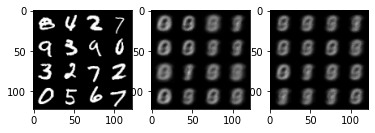

Iter: 01160/50000, Recon loss: 11901.5283, KL div loss: 233.5444, Total loss: 12135.0723
Iter: 01170/50000, Recon loss: 12248.6406, KL div loss: 243.9513, Total loss: 12492.5918
Iter: 01180/50000, Recon loss: 11287.3926, KL div loss: 218.7454, Total loss: 11506.1377
Iter: 01190/50000, Recon loss: 12165.9043, KL div loss: 199.3754, Total loss: 12365.2793
Iter: 01200/50000, Recon loss: 11758.8076, KL div loss: 230.1614, Total loss: 11988.9688


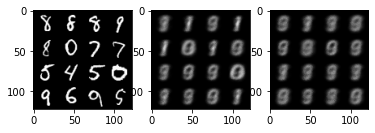

Iter: 01210/50000, Recon loss: 12099.7598, KL div loss: 196.1065, Total loss: 12295.8662
Iter: 01220/50000, Recon loss: 12226.8516, KL div loss: 242.4089, Total loss: 12469.2607
Iter: 01230/50000, Recon loss: 11717.0781, KL div loss: 256.0710, Total loss: 11973.1494
Iter: 01240/50000, Recon loss: 11877.3857, KL div loss: 294.7650, Total loss: 12172.1504
Iter: 01250/50000, Recon loss: 11721.1875, KL div loss: 260.2358, Total loss: 11981.4238


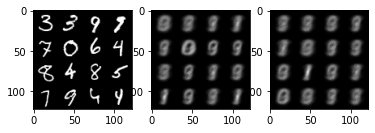

Iter: 01260/50000, Recon loss: 12542.6826, KL div loss: 188.7867, Total loss: 12731.4697
Iter: 01270/50000, Recon loss: 12016.0312, KL div loss: 274.0471, Total loss: 12290.0781
Iter: 01280/50000, Recon loss: 12455.2197, KL div loss: 216.1549, Total loss: 12671.3750
Iter: 01290/50000, Recon loss: 11980.1270, KL div loss: 228.2407, Total loss: 12208.3672
Iter: 01300/50000, Recon loss: 12010.6318, KL div loss: 230.4917, Total loss: 12241.1230


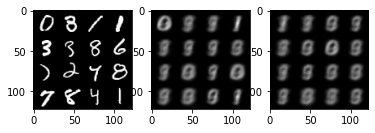

Iter: 01310/50000, Recon loss: 12445.4893, KL div loss: 165.3410, Total loss: 12610.8301
Iter: 01320/50000, Recon loss: 11566.3447, KL div loss: 234.8733, Total loss: 11801.2178
Iter: 01330/50000, Recon loss: 11941.3398, KL div loss: 296.5263, Total loss: 12237.8662
Iter: 01340/50000, Recon loss: 11203.0664, KL div loss: 307.3665, Total loss: 11510.4326
Iter: 01350/50000, Recon loss: 11663.7061, KL div loss: 278.4550, Total loss: 11942.1611


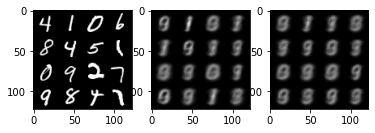

Iter: 01360/50000, Recon loss: 12238.6504, KL div loss: 240.8922, Total loss: 12479.5430
Iter: 01370/50000, Recon loss: 12891.8564, KL div loss: 281.2150, Total loss: 13173.0713
Iter: 01380/50000, Recon loss: 12661.8340, KL div loss: 272.8784, Total loss: 12934.7119
Iter: 01390/50000, Recon loss: 12407.2588, KL div loss: 286.7109, Total loss: 12693.9697
Iter: 01400/50000, Recon loss: 12057.3555, KL div loss: 278.4864, Total loss: 12335.8418


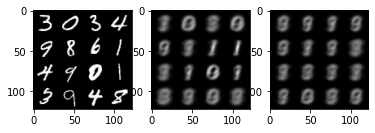

Iter: 01410/50000, Recon loss: 11726.3652, KL div loss: 296.4248, Total loss: 12022.7900
Iter: 01420/50000, Recon loss: 12584.1084, KL div loss: 289.2862, Total loss: 12873.3945
Iter: 01430/50000, Recon loss: 12539.2617, KL div loss: 241.1609, Total loss: 12780.4229
Iter: 01440/50000, Recon loss: 11489.6777, KL div loss: 330.3310, Total loss: 11820.0088
Iter: 01450/50000, Recon loss: 12164.0918, KL div loss: 280.8014, Total loss: 12444.8936


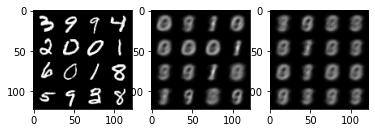

Iter: 01460/50000, Recon loss: 12325.3672, KL div loss: 269.5513, Total loss: 12594.9189
Iter: 01470/50000, Recon loss: 11929.5381, KL div loss: 301.3501, Total loss: 12230.8887
Iter: 01480/50000, Recon loss: 11882.0391, KL div loss: 264.2688, Total loss: 12146.3076
Iter: 01490/50000, Recon loss: 12744.4414, KL div loss: 250.6389, Total loss: 12995.0801
Iter: 01500/50000, Recon loss: 12499.5703, KL div loss: 262.4674, Total loss: 12762.0381


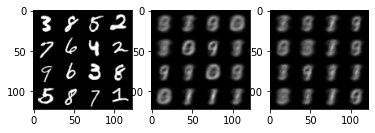

Iter: 01510/50000, Recon loss: 11603.8652, KL div loss: 334.5016, Total loss: 11938.3672
Iter: 01520/50000, Recon loss: 11253.8174, KL div loss: 373.4518, Total loss: 11627.2695
Iter: 01530/50000, Recon loss: 11748.3867, KL div loss: 284.2057, Total loss: 12032.5928
Iter: 01540/50000, Recon loss: 11894.7520, KL div loss: 347.4536, Total loss: 12242.2051
Iter: 01550/50000, Recon loss: 11189.3984, KL div loss: 351.2247, Total loss: 11540.6230


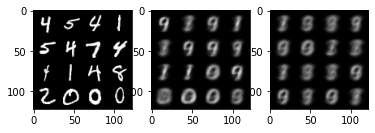

Iter: 01560/50000, Recon loss: 11097.6250, KL div loss: 320.8814, Total loss: 11418.5068
Iter: 01570/50000, Recon loss: 11232.9541, KL div loss: 349.2516, Total loss: 11582.2061
Iter: 01580/50000, Recon loss: 12341.8379, KL div loss: 277.9162, Total loss: 12619.7539
Iter: 01590/50000, Recon loss: 11898.5596, KL div loss: 280.7186, Total loss: 12179.2783
Iter: 01600/50000, Recon loss: 11937.0947, KL div loss: 328.7070, Total loss: 12265.8018


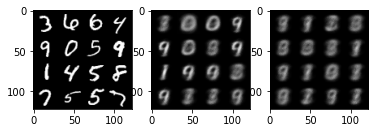

Iter: 01610/50000, Recon loss: 11871.1094, KL div loss: 392.4800, Total loss: 12263.5898
Iter: 01620/50000, Recon loss: 10996.6016, KL div loss: 339.8896, Total loss: 11336.4912
Iter: 01630/50000, Recon loss: 11429.4629, KL div loss: 364.5359, Total loss: 11793.9990
Iter: 01640/50000, Recon loss: 11013.2002, KL div loss: 350.0325, Total loss: 11363.2324
Iter: 01650/50000, Recon loss: 12270.9238, KL div loss: 432.0573, Total loss: 12702.9814


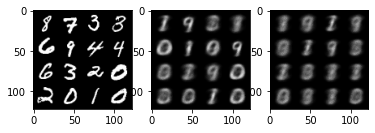

Iter: 01660/50000, Recon loss: 11576.2842, KL div loss: 355.6378, Total loss: 11931.9219
Iter: 01670/50000, Recon loss: 10721.5508, KL div loss: 375.3402, Total loss: 11096.8906
Iter: 01680/50000, Recon loss: 11203.7275, KL div loss: 362.9141, Total loss: 11566.6416
Iter: 01690/50000, Recon loss: 11737.4111, KL div loss: 408.9161, Total loss: 12146.3271
Iter: 01700/50000, Recon loss: 11385.4551, KL div loss: 347.4775, Total loss: 11732.9326


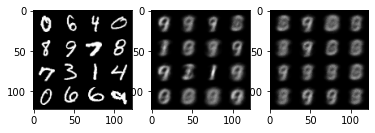

Iter: 01710/50000, Recon loss: 11446.1172, KL div loss: 417.6337, Total loss: 11863.7510
Iter: 01720/50000, Recon loss: 11671.7852, KL div loss: 362.9693, Total loss: 12034.7549
Iter: 01730/50000, Recon loss: 11590.2881, KL div loss: 376.5887, Total loss: 11966.8770
Iter: 01740/50000, Recon loss: 10633.3203, KL div loss: 388.5831, Total loss: 11021.9033
Iter: 01750/50000, Recon loss: 11672.3779, KL div loss: 358.7497, Total loss: 12031.1279


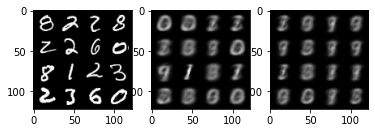

Iter: 01760/50000, Recon loss: 11581.3535, KL div loss: 372.6451, Total loss: 11953.9990
Iter: 01770/50000, Recon loss: 11366.8096, KL div loss: 323.5540, Total loss: 11690.3633
Iter: 01780/50000, Recon loss: 10895.6914, KL div loss: 367.3406, Total loss: 11263.0322
Iter: 01790/50000, Recon loss: 11743.2773, KL div loss: 373.7915, Total loss: 12117.0684
Iter: 01800/50000, Recon loss: 11970.6777, KL div loss: 357.0132, Total loss: 12327.6914


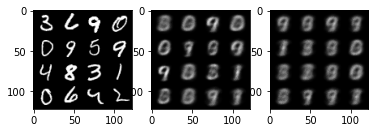

Iter: 01810/50000, Recon loss: 11434.7344, KL div loss: 359.1649, Total loss: 11793.8994
Iter: 01820/50000, Recon loss: 11755.3672, KL div loss: 368.8212, Total loss: 12124.1885
Iter: 01830/50000, Recon loss: 11823.7344, KL div loss: 356.3691, Total loss: 12180.1035
Iter: 01840/50000, Recon loss: 11312.5410, KL div loss: 425.5852, Total loss: 11738.1260
Iter: 01850/50000, Recon loss: 12635.4424, KL div loss: 338.5977, Total loss: 12974.0400


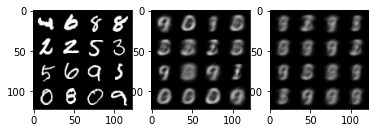

Iter: 01860/50000, Recon loss: 11810.5273, KL div loss: 416.5307, Total loss: 12227.0576
Iter: 01870/50000, Recon loss: 11552.0205, KL div loss: 391.5318, Total loss: 11943.5527
Iter: 01880/50000, Recon loss: 11507.7969, KL div loss: 392.6487, Total loss: 11900.4453
Iter: 01890/50000, Recon loss: 11148.5352, KL div loss: 384.1207, Total loss: 11532.6562
Iter: 01900/50000, Recon loss: 11873.4463, KL div loss: 387.4152, Total loss: 12260.8613


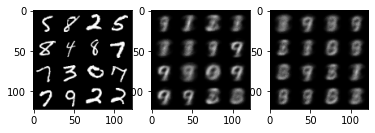

Iter: 01910/50000, Recon loss: 11280.7598, KL div loss: 397.6134, Total loss: 11678.3730
Iter: 01920/50000, Recon loss: 11362.3154, KL div loss: 375.6392, Total loss: 11737.9551
Iter: 01930/50000, Recon loss: 11520.8242, KL div loss: 367.6711, Total loss: 11888.4951
Iter: 01940/50000, Recon loss: 11095.7314, KL div loss: 356.9963, Total loss: 11452.7275
Iter: 01950/50000, Recon loss: 11339.0645, KL div loss: 362.7249, Total loss: 11701.7891


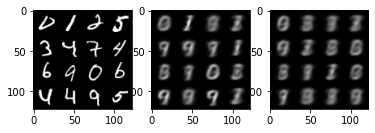

Iter: 01960/50000, Recon loss: 11254.9189, KL div loss: 424.6846, Total loss: 11679.6035
Iter: 01970/50000, Recon loss: 11297.6777, KL div loss: 400.8888, Total loss: 11698.5664
Iter: 01980/50000, Recon loss: 10789.6689, KL div loss: 398.7908, Total loss: 11188.4600
Iter: 01990/50000, Recon loss: 11544.1846, KL div loss: 387.6489, Total loss: 11931.8330
Iter: 02000/50000, Recon loss: 11261.2627, KL div loss: 427.6014, Total loss: 11688.8643


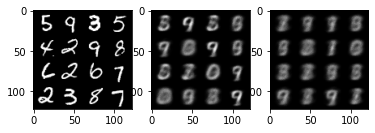

Iter: 02010/50000, Recon loss: 11195.6914, KL div loss: 434.2800, Total loss: 11629.9717
Iter: 02020/50000, Recon loss: 10911.8408, KL div loss: 462.3316, Total loss: 11374.1729
Iter: 02030/50000, Recon loss: 11596.7266, KL div loss: 413.3207, Total loss: 12010.0469
Iter: 02040/50000, Recon loss: 10646.2891, KL div loss: 408.2946, Total loss: 11054.5840
Iter: 02050/50000, Recon loss: 11792.9766, KL div loss: 421.2972, Total loss: 12214.2734


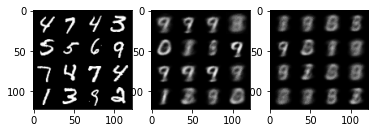

Iter: 02060/50000, Recon loss: 11109.3418, KL div loss: 419.0837, Total loss: 11528.4258
Iter: 02070/50000, Recon loss: 11435.3281, KL div loss: 486.2005, Total loss: 11921.5283
Iter: 02080/50000, Recon loss: 10930.3691, KL div loss: 442.6257, Total loss: 11372.9951
Iter: 02090/50000, Recon loss: 10652.1660, KL div loss: 496.4768, Total loss: 11148.6426
Iter: 02100/50000, Recon loss: 10459.5771, KL div loss: 438.2674, Total loss: 10897.8447


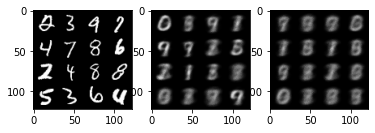

Iter: 02110/50000, Recon loss: 11586.3027, KL div loss: 461.3875, Total loss: 12047.6904
Iter: 02120/50000, Recon loss: 11146.0977, KL div loss: 434.5432, Total loss: 11580.6406
Iter: 02130/50000, Recon loss: 11254.9082, KL div loss: 493.8912, Total loss: 11748.7998
Iter: 02140/50000, Recon loss: 11238.3408, KL div loss: 417.2062, Total loss: 11655.5469
Iter: 02150/50000, Recon loss: 10433.9512, KL div loss: 412.6548, Total loss: 10846.6055


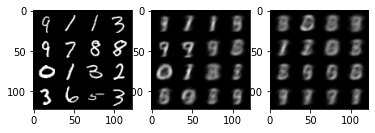

Iter: 02160/50000, Recon loss: 11693.4941, KL div loss: 490.9272, Total loss: 12184.4209
Iter: 02170/50000, Recon loss: 11201.2637, KL div loss: 462.0016, Total loss: 11663.2656
Iter: 02180/50000, Recon loss: 11229.1641, KL div loss: 444.5114, Total loss: 11673.6758
Iter: 02190/50000, Recon loss: 10735.9883, KL div loss: 479.3148, Total loss: 11215.3027
Iter: 02200/50000, Recon loss: 10830.0869, KL div loss: 431.4833, Total loss: 11261.5703


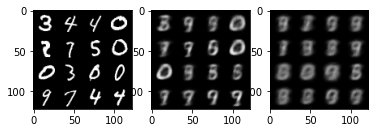

Iter: 02210/50000, Recon loss: 11252.7031, KL div loss: 531.5823, Total loss: 11784.2852
Iter: 02220/50000, Recon loss: 11141.1680, KL div loss: 459.9499, Total loss: 11601.1182
Iter: 02230/50000, Recon loss: 10957.7422, KL div loss: 455.7606, Total loss: 11413.5029
Iter: 02240/50000, Recon loss: 11321.6289, KL div loss: 634.8997, Total loss: 11956.5283
Iter: 02250/50000, Recon loss: 11368.0234, KL div loss: 455.3437, Total loss: 11823.3672


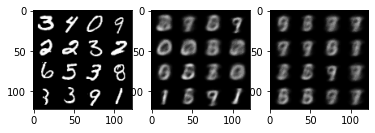

Iter: 02260/50000, Recon loss: 10454.2041, KL div loss: 517.3554, Total loss: 10971.5596
Iter: 02270/50000, Recon loss: 10677.8945, KL div loss: 539.2812, Total loss: 11217.1758
Iter: 02280/50000, Recon loss: 10974.7002, KL div loss: 518.7297, Total loss: 11493.4297
Iter: 02290/50000, Recon loss: 10682.1357, KL div loss: 441.9710, Total loss: 11124.1064
Iter: 02300/50000, Recon loss: 9896.6230, KL div loss: 506.0274, Total loss: 10402.6504


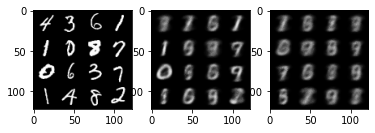

Iter: 02310/50000, Recon loss: 11302.2900, KL div loss: 599.9557, Total loss: 11902.2461
Iter: 02320/50000, Recon loss: 10847.1104, KL div loss: 526.4115, Total loss: 11373.5215
Iter: 02330/50000, Recon loss: 10892.4268, KL div loss: 543.2400, Total loss: 11435.6670
Iter: 02340/50000, Recon loss: 11082.8076, KL div loss: 550.0254, Total loss: 11632.8330
Iter: 02350/50000, Recon loss: 10794.7090, KL div loss: 592.1190, Total loss: 11386.8281


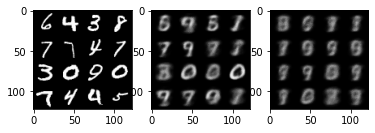

Iter: 02360/50000, Recon loss: 10714.4502, KL div loss: 530.2282, Total loss: 11244.6787
Iter: 02370/50000, Recon loss: 10441.5127, KL div loss: 594.3152, Total loss: 11035.8281
Iter: 02380/50000, Recon loss: 10715.5566, KL div loss: 485.5661, Total loss: 11201.1230
Iter: 02390/50000, Recon loss: 10659.6035, KL div loss: 534.7356, Total loss: 11194.3389
Iter: 02400/50000, Recon loss: 10471.6729, KL div loss: 544.9310, Total loss: 11016.6035


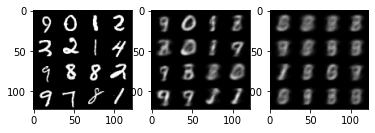

Iter: 02410/50000, Recon loss: 10689.8223, KL div loss: 597.5864, Total loss: 11287.4082
Iter: 02420/50000, Recon loss: 10138.8691, KL div loss: 522.4375, Total loss: 10661.3066
Iter: 02430/50000, Recon loss: 11184.2461, KL div loss: 552.9255, Total loss: 11737.1719
Iter: 02440/50000, Recon loss: 10474.3555, KL div loss: 527.1467, Total loss: 11001.5020
Iter: 02450/50000, Recon loss: 10721.4502, KL div loss: 577.9387, Total loss: 11299.3887


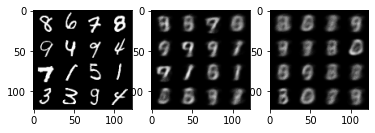

Iter: 02460/50000, Recon loss: 10815.2646, KL div loss: 553.6465, Total loss: 11368.9111
Iter: 02470/50000, Recon loss: 11005.8984, KL div loss: 561.8739, Total loss: 11567.7725
Iter: 02480/50000, Recon loss: 10853.9785, KL div loss: 599.1730, Total loss: 11453.1514
Iter: 02490/50000, Recon loss: 10747.7500, KL div loss: 593.5037, Total loss: 11341.2539
Iter: 02500/50000, Recon loss: 10862.6328, KL div loss: 541.9707, Total loss: 11404.6035


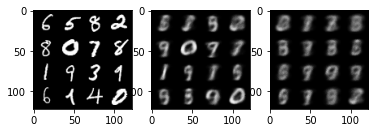

Iter: 02510/50000, Recon loss: 10822.5518, KL div loss: 588.2809, Total loss: 11410.8330
Iter: 02520/50000, Recon loss: 10591.1641, KL div loss: 604.7653, Total loss: 11195.9297
Iter: 02530/50000, Recon loss: 10798.2412, KL div loss: 552.0370, Total loss: 11350.2783
Iter: 02540/50000, Recon loss: 10727.5781, KL div loss: 579.6921, Total loss: 11307.2705
Iter: 02550/50000, Recon loss: 11183.9824, KL div loss: 525.0212, Total loss: 11709.0039


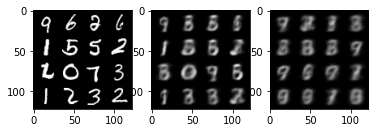

Iter: 02560/50000, Recon loss: 9960.4307, KL div loss: 599.6415, Total loss: 10560.0723
Iter: 02570/50000, Recon loss: 10189.5371, KL div loss: 604.8074, Total loss: 10794.3447
Iter: 02580/50000, Recon loss: 11081.9873, KL div loss: 560.0367, Total loss: 11642.0244
Iter: 02590/50000, Recon loss: 10958.0586, KL div loss: 611.7067, Total loss: 11569.7656
Iter: 02600/50000, Recon loss: 9639.4072, KL div loss: 590.9317, Total loss: 10230.3389


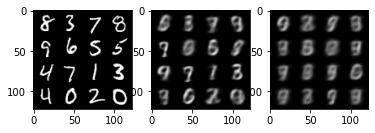

Iter: 02610/50000, Recon loss: 10552.7373, KL div loss: 583.5239, Total loss: 11136.2617
Iter: 02620/50000, Recon loss: 10263.4648, KL div loss: 628.8533, Total loss: 10892.3184
Iter: 02630/50000, Recon loss: 10210.6621, KL div loss: 681.3378, Total loss: 10892.0000
Iter: 02640/50000, Recon loss: 10108.0693, KL div loss: 616.7039, Total loss: 10724.7734
Iter: 02650/50000, Recon loss: 10480.6084, KL div loss: 660.1431, Total loss: 11140.7520


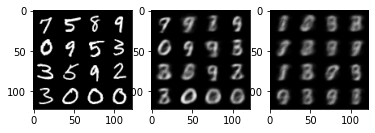

Iter: 02660/50000, Recon loss: 10550.0684, KL div loss: 662.6833, Total loss: 11212.7520
Iter: 02670/50000, Recon loss: 10866.0498, KL div loss: 598.8257, Total loss: 11464.8750
Iter: 02680/50000, Recon loss: 10502.1387, KL div loss: 580.4186, Total loss: 11082.5576
Iter: 02690/50000, Recon loss: 10209.0439, KL div loss: 626.4231, Total loss: 10835.4668
Iter: 02700/50000, Recon loss: 10248.4561, KL div loss: 622.0674, Total loss: 10870.5234


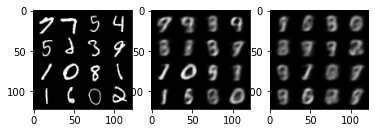

Iter: 02710/50000, Recon loss: 10254.7930, KL div loss: 652.5529, Total loss: 10907.3457
Iter: 02720/50000, Recon loss: 10172.5127, KL div loss: 573.0198, Total loss: 10745.5322
Iter: 02730/50000, Recon loss: 10392.4590, KL div loss: 597.2465, Total loss: 10989.7051
Iter: 02740/50000, Recon loss: 10818.8594, KL div loss: 617.5592, Total loss: 11436.4189
Iter: 02750/50000, Recon loss: 10948.9111, KL div loss: 622.6630, Total loss: 11571.5742


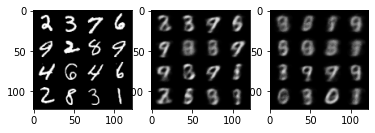

Iter: 02760/50000, Recon loss: 10530.4873, KL div loss: 652.0059, Total loss: 11182.4932
Iter: 02770/50000, Recon loss: 9789.1201, KL div loss: 695.7184, Total loss: 10484.8389
Iter: 02780/50000, Recon loss: 10058.2578, KL div loss: 610.6414, Total loss: 10668.8994
Iter: 02790/50000, Recon loss: 9833.6992, KL div loss: 651.8116, Total loss: 10485.5107
Iter: 02800/50000, Recon loss: 9695.7256, KL div loss: 686.1326, Total loss: 10381.8584


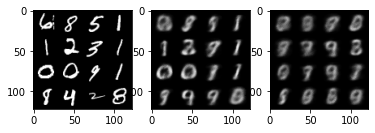

Iter: 02810/50000, Recon loss: 10010.5996, KL div loss: 671.4456, Total loss: 10682.0449
Iter: 02820/50000, Recon loss: 10346.4111, KL div loss: 661.8452, Total loss: 11008.2559
Iter: 02830/50000, Recon loss: 9634.5625, KL div loss: 686.6053, Total loss: 10321.1680
Iter: 02840/50000, Recon loss: 9527.6348, KL div loss: 703.7034, Total loss: 10231.3379
Iter: 02850/50000, Recon loss: 9785.0225, KL div loss: 635.7419, Total loss: 10420.7646


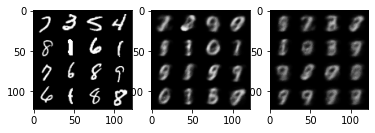

Iter: 02860/50000, Recon loss: 9376.6445, KL div loss: 700.9910, Total loss: 10077.6357
Iter: 02870/50000, Recon loss: 10604.8496, KL div loss: 694.5216, Total loss: 11299.3711
Iter: 02880/50000, Recon loss: 10015.1855, KL div loss: 707.2035, Total loss: 10722.3887
Iter: 02890/50000, Recon loss: 10216.8213, KL div loss: 664.2842, Total loss: 10881.1055
Iter: 02900/50000, Recon loss: 10021.8193, KL div loss: 696.9247, Total loss: 10718.7441


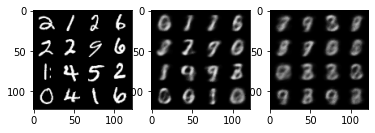

Iter: 02910/50000, Recon loss: 9944.7471, KL div loss: 730.5472, Total loss: 10675.2939
Iter: 02920/50000, Recon loss: 9940.6445, KL div loss: 676.7025, Total loss: 10617.3467
Iter: 02930/50000, Recon loss: 9367.7305, KL div loss: 755.1511, Total loss: 10122.8818
Iter: 02940/50000, Recon loss: 10483.1084, KL div loss: 618.2938, Total loss: 11101.4023
Iter: 02950/50000, Recon loss: 9261.4463, KL div loss: 768.0228, Total loss: 10029.4688


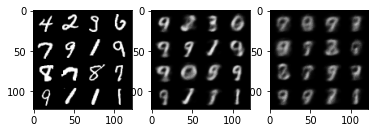

Iter: 02960/50000, Recon loss: 10104.5889, KL div loss: 669.8467, Total loss: 10774.4355
Iter: 02970/50000, Recon loss: 9532.1006, KL div loss: 726.1779, Total loss: 10258.2783
Iter: 02980/50000, Recon loss: 9716.0869, KL div loss: 720.7335, Total loss: 10436.8203
Iter: 02990/50000, Recon loss: 9657.9121, KL div loss: 757.1669, Total loss: 10415.0791
Iter: 03000/50000, Recon loss: 9926.7266, KL div loss: 710.0484, Total loss: 10636.7754


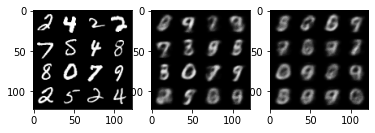

Iter: 03010/50000, Recon loss: 10188.2920, KL div loss: 705.5281, Total loss: 10893.8203
Iter: 03020/50000, Recon loss: 9994.7324, KL div loss: 686.6742, Total loss: 10681.4062
Iter: 03030/50000, Recon loss: 10346.6133, KL div loss: 709.6153, Total loss: 11056.2285
Iter: 03040/50000, Recon loss: 9552.2939, KL div loss: 771.9183, Total loss: 10324.2119
Iter: 03050/50000, Recon loss: 9938.8916, KL div loss: 761.4741, Total loss: 10700.3652


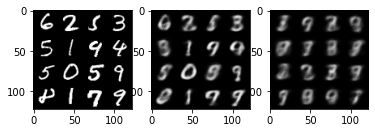

Iter: 03060/50000, Recon loss: 9920.0703, KL div loss: 730.3727, Total loss: 10650.4434
Iter: 03070/50000, Recon loss: 9913.8506, KL div loss: 740.7103, Total loss: 10654.5605
Iter: 03080/50000, Recon loss: 9507.5811, KL div loss: 719.0222, Total loss: 10226.6035
Iter: 03090/50000, Recon loss: 9150.2520, KL div loss: 763.4148, Total loss: 9913.6670
Iter: 03100/50000, Recon loss: 9502.5039, KL div loss: 747.9369, Total loss: 10250.4404


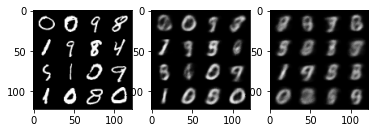

Iter: 03110/50000, Recon loss: 10325.4434, KL div loss: 794.9812, Total loss: 11120.4248
Iter: 03120/50000, Recon loss: 9645.0146, KL div loss: 749.6643, Total loss: 10394.6787
Iter: 03130/50000, Recon loss: 10231.8682, KL div loss: 788.5538, Total loss: 11020.4219
Iter: 03140/50000, Recon loss: 9656.3262, KL div loss: 758.7281, Total loss: 10415.0547
Iter: 03150/50000, Recon loss: 9326.9756, KL div loss: 770.3053, Total loss: 10097.2812


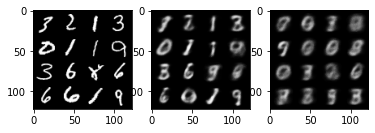

Iter: 03160/50000, Recon loss: 9637.6533, KL div loss: 708.1574, Total loss: 10345.8105
Iter: 03170/50000, Recon loss: 9276.8379, KL div loss: 818.6171, Total loss: 10095.4551
Iter: 03180/50000, Recon loss: 9817.4951, KL div loss: 761.0657, Total loss: 10578.5605
Iter: 03190/50000, Recon loss: 10230.2305, KL div loss: 749.8438, Total loss: 10980.0742
Iter: 03200/50000, Recon loss: 10058.2129, KL div loss: 783.2878, Total loss: 10841.5010


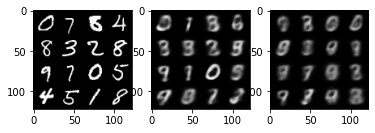

Iter: 03210/50000, Recon loss: 9621.5723, KL div loss: 736.3391, Total loss: 10357.9111
Iter: 03220/50000, Recon loss: 9732.3047, KL div loss: 745.3033, Total loss: 10477.6084
Iter: 03230/50000, Recon loss: 9459.9414, KL div loss: 831.3582, Total loss: 10291.2998
Iter: 03240/50000, Recon loss: 9727.8184, KL div loss: 683.3573, Total loss: 10411.1758
Iter: 03250/50000, Recon loss: 9944.6074, KL div loss: 821.5287, Total loss: 10766.1357


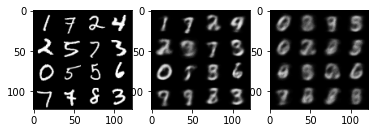

Iter: 03260/50000, Recon loss: 9097.1289, KL div loss: 775.2590, Total loss: 9872.3877
Iter: 03270/50000, Recon loss: 9409.6855, KL div loss: 810.1809, Total loss: 10219.8662
Iter: 03280/50000, Recon loss: 9918.3223, KL div loss: 770.4799, Total loss: 10688.8018
Iter: 03290/50000, Recon loss: 9317.5029, KL div loss: 761.9555, Total loss: 10079.4580
Iter: 03300/50000, Recon loss: 9855.3203, KL div loss: 736.3464, Total loss: 10591.6670


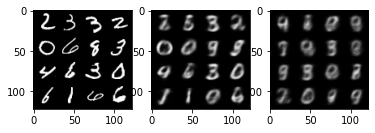

Iter: 03310/50000, Recon loss: 9376.7676, KL div loss: 801.2675, Total loss: 10178.0352
Iter: 03320/50000, Recon loss: 9486.3457, KL div loss: 832.6371, Total loss: 10318.9824
Iter: 03330/50000, Recon loss: 9985.6602, KL div loss: 825.2206, Total loss: 10810.8809
Iter: 03340/50000, Recon loss: 8805.9346, KL div loss: 778.0590, Total loss: 9583.9932
Iter: 03350/50000, Recon loss: 9084.0625, KL div loss: 775.5884, Total loss: 9859.6504


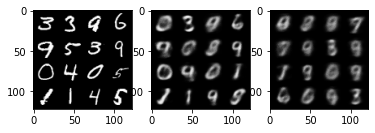

Iter: 03360/50000, Recon loss: 9126.7559, KL div loss: 852.9611, Total loss: 9979.7168
Iter: 03370/50000, Recon loss: 9444.3281, KL div loss: 811.6563, Total loss: 10255.9844
Iter: 03380/50000, Recon loss: 10123.9053, KL div loss: 711.6784, Total loss: 10835.5840
Iter: 03390/50000, Recon loss: 9482.3438, KL div loss: 769.9196, Total loss: 10252.2637
Iter: 03400/50000, Recon loss: 8799.0049, KL div loss: 815.0482, Total loss: 9614.0527


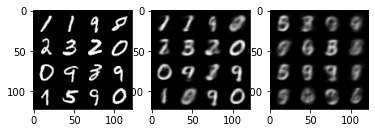

Iter: 03410/50000, Recon loss: 9508.8799, KL div loss: 817.3198, Total loss: 10326.1992
Iter: 03420/50000, Recon loss: 9591.4453, KL div loss: 813.5746, Total loss: 10405.0195
Iter: 03430/50000, Recon loss: 9198.1318, KL div loss: 807.1331, Total loss: 10005.2646
Iter: 03440/50000, Recon loss: 9384.3115, KL div loss: 840.2589, Total loss: 10224.5703
Iter: 03450/50000, Recon loss: 8786.0469, KL div loss: 863.6544, Total loss: 9649.7012


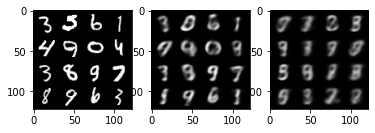

Iter: 03460/50000, Recon loss: 9220.4531, KL div loss: 826.7140, Total loss: 10047.1670
Iter: 03470/50000, Recon loss: 9364.8965, KL div loss: 803.2073, Total loss: 10168.1035
Iter: 03480/50000, Recon loss: 9886.1699, KL div loss: 840.7969, Total loss: 10726.9668
Iter: 03490/50000, Recon loss: 9707.4531, KL div loss: 915.8790, Total loss: 10623.3320
Iter: 03500/50000, Recon loss: 8683.5039, KL div loss: 836.1091, Total loss: 9519.6133


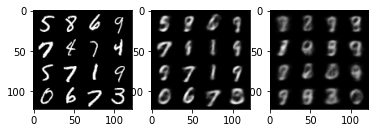

Iter: 03510/50000, Recon loss: 9883.7217, KL div loss: 720.7952, Total loss: 10604.5166
Iter: 03520/50000, Recon loss: 9394.6855, KL div loss: 827.0867, Total loss: 10221.7725
Iter: 03530/50000, Recon loss: 9700.2207, KL div loss: 910.7076, Total loss: 10610.9287
Iter: 03540/50000, Recon loss: 9355.7480, KL div loss: 811.7900, Total loss: 10167.5381
Iter: 03550/50000, Recon loss: 9089.4619, KL div loss: 784.5898, Total loss: 9874.0518


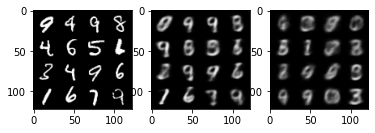

Iter: 03560/50000, Recon loss: 9641.3096, KL div loss: 823.2532, Total loss: 10464.5625
Iter: 03570/50000, Recon loss: 8929.4961, KL div loss: 838.8229, Total loss: 9768.3193
Iter: 03580/50000, Recon loss: 9671.1523, KL div loss: 883.8503, Total loss: 10555.0029
Iter: 03590/50000, Recon loss: 9218.5527, KL div loss: 813.6804, Total loss: 10032.2334
Iter: 03600/50000, Recon loss: 8594.8203, KL div loss: 847.2200, Total loss: 9442.0400


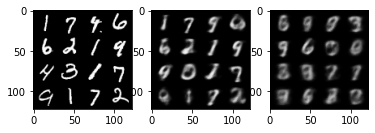

Iter: 03610/50000, Recon loss: 8952.6865, KL div loss: 898.6265, Total loss: 9851.3125
Iter: 03620/50000, Recon loss: 9340.5801, KL div loss: 829.1677, Total loss: 10169.7480
Iter: 03630/50000, Recon loss: 9071.9258, KL div loss: 843.7299, Total loss: 9915.6553
Iter: 03640/50000, Recon loss: 8779.0928, KL div loss: 840.8557, Total loss: 9619.9482
Iter: 03650/50000, Recon loss: 9509.4980, KL div loss: 821.1191, Total loss: 10330.6172


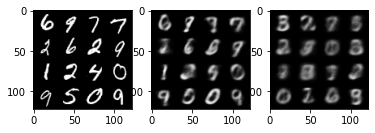

Iter: 03660/50000, Recon loss: 9587.2246, KL div loss: 824.2597, Total loss: 10411.4844
Iter: 03670/50000, Recon loss: 9008.2559, KL div loss: 821.4792, Total loss: 9829.7354
Iter: 03680/50000, Recon loss: 9656.1191, KL div loss: 836.7322, Total loss: 10492.8516
Iter: 03690/50000, Recon loss: 9440.8848, KL div loss: 780.6062, Total loss: 10221.4912
Iter: 03700/50000, Recon loss: 9445.9238, KL div loss: 816.2252, Total loss: 10262.1494


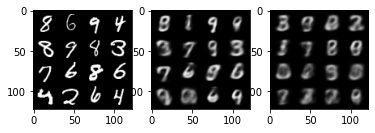

Iter: 03710/50000, Recon loss: 9248.8594, KL div loss: 912.9762, Total loss: 10161.8359
Iter: 03720/50000, Recon loss: 9466.1230, KL div loss: 803.3948, Total loss: 10269.5176
Iter: 03730/50000, Recon loss: 9752.9131, KL div loss: 849.3336, Total loss: 10602.2471
Iter: 03740/50000, Recon loss: 9154.6973, KL div loss: 830.1386, Total loss: 9984.8359
Iter: 03750/50000, Recon loss: 8810.9893, KL div loss: 790.0161, Total loss: 9601.0059


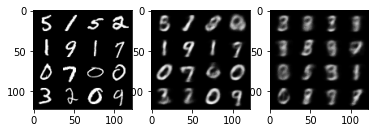

Iter: 03760/50000, Recon loss: 9150.7129, KL div loss: 877.4386, Total loss: 10028.1514
Iter: 03770/50000, Recon loss: 9431.4600, KL div loss: 834.3835, Total loss: 10265.8438
Iter: 03780/50000, Recon loss: 9028.4932, KL div loss: 916.1794, Total loss: 9944.6729
Iter: 03790/50000, Recon loss: 9456.1133, KL div loss: 891.0461, Total loss: 10347.1592
Iter: 03800/50000, Recon loss: 9461.1631, KL div loss: 827.9082, Total loss: 10289.0713


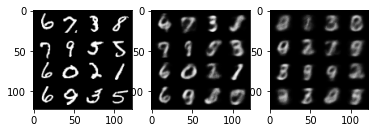

Iter: 03810/50000, Recon loss: 9144.7217, KL div loss: 885.4467, Total loss: 10030.1680
Iter: 03820/50000, Recon loss: 8755.1641, KL div loss: 842.3171, Total loss: 9597.4814
Iter: 03830/50000, Recon loss: 8848.4414, KL div loss: 847.2878, Total loss: 9695.7295
Iter: 03840/50000, Recon loss: 9378.8594, KL div loss: 878.8422, Total loss: 10257.7012
Iter: 03850/50000, Recon loss: 8781.3076, KL div loss: 855.7772, Total loss: 9637.0850


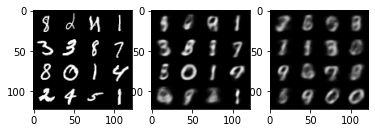

Iter: 03860/50000, Recon loss: 9054.4316, KL div loss: 859.0682, Total loss: 9913.5000
Iter: 03870/50000, Recon loss: 8885.0059, KL div loss: 833.7897, Total loss: 9718.7959
Iter: 03880/50000, Recon loss: 9378.9355, KL div loss: 801.6628, Total loss: 10180.5986
Iter: 03890/50000, Recon loss: 9161.4746, KL div loss: 917.5461, Total loss: 10079.0205
Iter: 03900/50000, Recon loss: 8793.1094, KL div loss: 854.2965, Total loss: 9647.4062


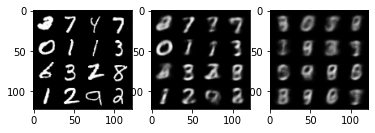

Iter: 03910/50000, Recon loss: 8816.1270, KL div loss: 860.0248, Total loss: 9676.1514
Iter: 03920/50000, Recon loss: 9335.7695, KL div loss: 879.3987, Total loss: 10215.1680
Iter: 03930/50000, Recon loss: 9065.9795, KL div loss: 861.1028, Total loss: 9927.0820
Iter: 03940/50000, Recon loss: 8613.4229, KL div loss: 872.0394, Total loss: 9485.4619
Iter: 03950/50000, Recon loss: 9316.1211, KL div loss: 966.9227, Total loss: 10283.0439


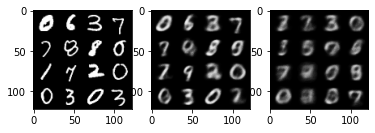

Iter: 03960/50000, Recon loss: 8392.2100, KL div loss: 903.5347, Total loss: 9295.7441
Iter: 03970/50000, Recon loss: 9356.9141, KL div loss: 988.1660, Total loss: 10345.0801
Iter: 03980/50000, Recon loss: 9450.8906, KL div loss: 895.0854, Total loss: 10345.9766
Iter: 03990/50000, Recon loss: 8995.2930, KL div loss: 884.8437, Total loss: 9880.1367
Iter: 04000/50000, Recon loss: 8335.0986, KL div loss: 905.5273, Total loss: 9240.6260


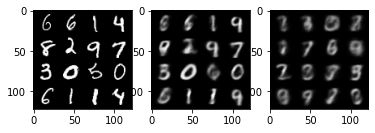

Iter: 04010/50000, Recon loss: 8869.5801, KL div loss: 938.8145, Total loss: 9808.3945
Iter: 04020/50000, Recon loss: 9794.4766, KL div loss: 876.1898, Total loss: 10670.6660
Iter: 04030/50000, Recon loss: 8988.3232, KL div loss: 911.1311, Total loss: 9899.4541
Iter: 04040/50000, Recon loss: 8410.1660, KL div loss: 914.1442, Total loss: 9324.3105
Iter: 04050/50000, Recon loss: 8679.7695, KL div loss: 902.9767, Total loss: 9582.7461


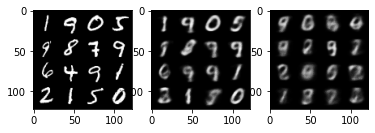

Iter: 04060/50000, Recon loss: 8611.5039, KL div loss: 912.7252, Total loss: 9524.2295
Iter: 04070/50000, Recon loss: 8772.7041, KL div loss: 954.1103, Total loss: 9726.8145
Iter: 04080/50000, Recon loss: 8929.8789, KL div loss: 851.6399, Total loss: 9781.5186
Iter: 04090/50000, Recon loss: 8902.6250, KL div loss: 866.5182, Total loss: 9769.1436
Iter: 04100/50000, Recon loss: 9353.1045, KL div loss: 876.5023, Total loss: 10229.6064


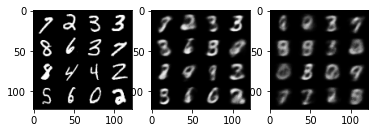

Iter: 04110/50000, Recon loss: 9358.4365, KL div loss: 903.2657, Total loss: 10261.7021
Iter: 04120/50000, Recon loss: 9192.6875, KL div loss: 960.6458, Total loss: 10153.3330
Iter: 04130/50000, Recon loss: 8734.5674, KL div loss: 978.8835, Total loss: 9713.4512
Iter: 04140/50000, Recon loss: 8834.1201, KL div loss: 898.4439, Total loss: 9732.5645
Iter: 04150/50000, Recon loss: 8854.7207, KL div loss: 947.4017, Total loss: 9802.1221


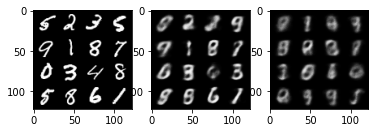

Iter: 04160/50000, Recon loss: 8793.2949, KL div loss: 868.5777, Total loss: 9661.8730
Iter: 04170/50000, Recon loss: 9322.8340, KL div loss: 875.1089, Total loss: 10197.9434
Iter: 04180/50000, Recon loss: 9603.1211, KL div loss: 967.1584, Total loss: 10570.2793
Iter: 04190/50000, Recon loss: 8841.2246, KL div loss: 945.7214, Total loss: 9786.9463
Iter: 04200/50000, Recon loss: 8590.3848, KL div loss: 989.4458, Total loss: 9579.8301


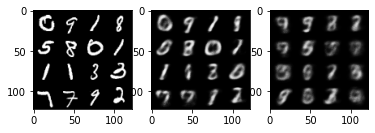

Iter: 04210/50000, Recon loss: 7912.0234, KL div loss: 912.4189, Total loss: 8824.4424
Iter: 04220/50000, Recon loss: 9065.6064, KL div loss: 921.0484, Total loss: 9986.6553
Iter: 04230/50000, Recon loss: 9607.9658, KL div loss: 879.1747, Total loss: 10487.1406
Iter: 04240/50000, Recon loss: 8527.9971, KL div loss: 925.7815, Total loss: 9453.7783
Iter: 04250/50000, Recon loss: 8794.7783, KL div loss: 983.1698, Total loss: 9777.9482


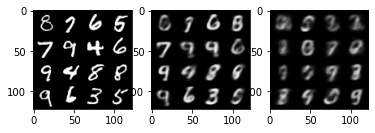

Iter: 04260/50000, Recon loss: 8950.1973, KL div loss: 970.5883, Total loss: 9920.7852
Iter: 04270/50000, Recon loss: 8684.3555, KL div loss: 979.9246, Total loss: 9664.2803
Iter: 04280/50000, Recon loss: 9388.7891, KL div loss: 948.2827, Total loss: 10337.0713
Iter: 04290/50000, Recon loss: 8531.5615, KL div loss: 948.0339, Total loss: 9479.5957
Iter: 04300/50000, Recon loss: 9359.3438, KL div loss: 950.9847, Total loss: 10310.3281


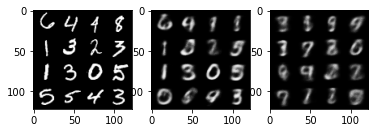

Iter: 04310/50000, Recon loss: 8811.1191, KL div loss: 957.1438, Total loss: 9768.2627
Iter: 04320/50000, Recon loss: 9141.0049, KL div loss: 918.2479, Total loss: 10059.2529
Iter: 04330/50000, Recon loss: 8890.7510, KL div loss: 930.8983, Total loss: 9821.6494
Iter: 04340/50000, Recon loss: 8784.5938, KL div loss: 947.7584, Total loss: 9732.3525
Iter: 04350/50000, Recon loss: 9135.8477, KL div loss: 915.8656, Total loss: 10051.7129


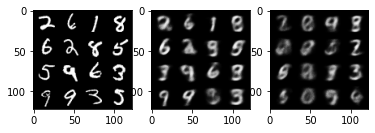

Iter: 04360/50000, Recon loss: 8963.4824, KL div loss: 880.9086, Total loss: 9844.3906
Iter: 04370/50000, Recon loss: 8751.8164, KL div loss: 913.9261, Total loss: 9665.7422
Iter: 04380/50000, Recon loss: 9445.9238, KL div loss: 974.7509, Total loss: 10420.6748
Iter: 04390/50000, Recon loss: 8789.5684, KL div loss: 964.7213, Total loss: 9754.2900
Iter: 04400/50000, Recon loss: 8195.2217, KL div loss: 926.6984, Total loss: 9121.9199


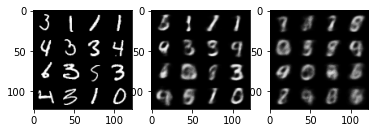

Iter: 04410/50000, Recon loss: 8908.8320, KL div loss: 997.3575, Total loss: 9906.1895
Iter: 04420/50000, Recon loss: 8338.9902, KL div loss: 949.0544, Total loss: 9288.0449
Iter: 04430/50000, Recon loss: 8679.6055, KL div loss: 952.8184, Total loss: 9632.4238
Iter: 04440/50000, Recon loss: 9072.2969, KL div loss: 999.2039, Total loss: 10071.5010
Iter: 04450/50000, Recon loss: 8794.3223, KL div loss: 972.6820, Total loss: 9767.0039


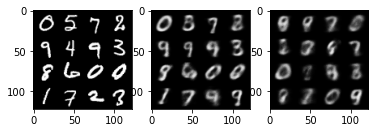

Iter: 04460/50000, Recon loss: 8331.9258, KL div loss: 940.4993, Total loss: 9272.4248
Iter: 04470/50000, Recon loss: 8742.6387, KL div loss: 924.8398, Total loss: 9667.4785
Iter: 04480/50000, Recon loss: 8576.7969, KL div loss: 944.9385, Total loss: 9521.7354
Iter: 04490/50000, Recon loss: 8431.4229, KL div loss: 1006.0059, Total loss: 9437.4287
Iter: 04500/50000, Recon loss: 8436.6445, KL div loss: 1020.8837, Total loss: 9457.5283


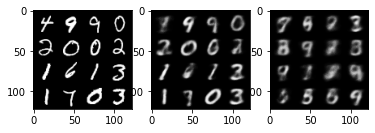

Iter: 04510/50000, Recon loss: 8317.6748, KL div loss: 917.2054, Total loss: 9234.8799
Iter: 04520/50000, Recon loss: 8626.3467, KL div loss: 886.0813, Total loss: 9512.4277
Iter: 04530/50000, Recon loss: 8380.9355, KL div loss: 906.6981, Total loss: 9287.6338
Iter: 04540/50000, Recon loss: 8394.0547, KL div loss: 1033.0966, Total loss: 9427.1514
Iter: 04550/50000, Recon loss: 9003.0205, KL div loss: 938.0111, Total loss: 9941.0312


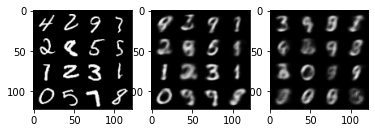

Iter: 04560/50000, Recon loss: 8750.4785, KL div loss: 1008.5695, Total loss: 9759.0479
Iter: 04570/50000, Recon loss: 8753.9102, KL div loss: 968.1917, Total loss: 9722.1016
Iter: 04580/50000, Recon loss: 8583.8750, KL div loss: 998.1714, Total loss: 9582.0469
Iter: 04590/50000, Recon loss: 8493.7305, KL div loss: 977.9067, Total loss: 9471.6367
Iter: 04600/50000, Recon loss: 9073.3535, KL div loss: 965.0534, Total loss: 10038.4072


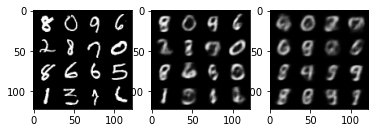

Iter: 04610/50000, Recon loss: 8605.6230, KL div loss: 1060.0160, Total loss: 9665.6387
Iter: 04620/50000, Recon loss: 8982.3164, KL div loss: 985.2007, Total loss: 9967.5176
Iter: 04630/50000, Recon loss: 8707.2188, KL div loss: 1002.8646, Total loss: 9710.0830
Iter: 04640/50000, Recon loss: 8648.9277, KL div loss: 1091.9410, Total loss: 9740.8691
Iter: 04650/50000, Recon loss: 8232.0391, KL div loss: 970.7610, Total loss: 9202.7998


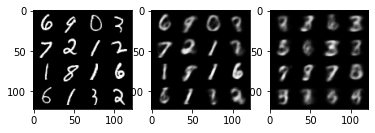

Iter: 04660/50000, Recon loss: 8904.5498, KL div loss: 1086.9558, Total loss: 9991.5059
Iter: 04670/50000, Recon loss: 8173.9702, KL div loss: 1027.0322, Total loss: 9201.0020
Iter: 04680/50000, Recon loss: 8274.6387, KL div loss: 1000.6351, Total loss: 9275.2734
Iter: 04690/50000, Recon loss: 8443.5430, KL div loss: 1005.0190, Total loss: 9448.5615
Iter: 04700/50000, Recon loss: 7983.5586, KL div loss: 1007.8591, Total loss: 8991.4180


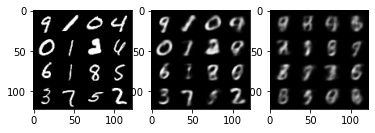

Iter: 04710/50000, Recon loss: 8557.0010, KL div loss: 916.3019, Total loss: 9473.3027
Iter: 04720/50000, Recon loss: 8132.8804, KL div loss: 1120.5793, Total loss: 9253.4600
Iter: 04730/50000, Recon loss: 8364.2695, KL div loss: 1049.0969, Total loss: 9413.3662
Iter: 04740/50000, Recon loss: 8733.3516, KL div loss: 985.3508, Total loss: 9718.7021
Iter: 04750/50000, Recon loss: 8144.9819, KL div loss: 993.3719, Total loss: 9138.3535


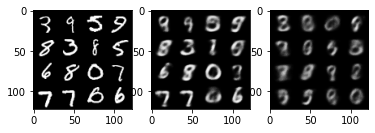

Iter: 04760/50000, Recon loss: 8201.5430, KL div loss: 1002.6300, Total loss: 9204.1729
Iter: 04770/50000, Recon loss: 8246.5742, KL div loss: 1033.8284, Total loss: 9280.4023
Iter: 04780/50000, Recon loss: 8231.7871, KL div loss: 1036.3420, Total loss: 9268.1289
Iter: 04790/50000, Recon loss: 8772.1846, KL div loss: 1046.5964, Total loss: 9818.7812
Iter: 04800/50000, Recon loss: 8273.6816, KL div loss: 1025.4678, Total loss: 9299.1494


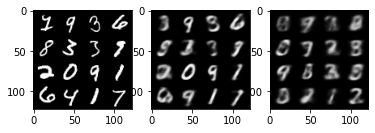

Iter: 04810/50000, Recon loss: 8529.4629, KL div loss: 1012.2536, Total loss: 9541.7168
Iter: 04820/50000, Recon loss: 8780.9736, KL div loss: 916.2667, Total loss: 9697.2402
Iter: 04830/50000, Recon loss: 8183.1499, KL div loss: 966.0690, Total loss: 9149.2188
Iter: 04840/50000, Recon loss: 8559.1094, KL div loss: 982.9543, Total loss: 9542.0635
Iter: 04850/50000, Recon loss: 8468.4980, KL div loss: 1030.6635, Total loss: 9499.1611


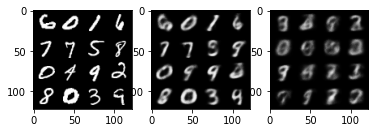

Iter: 04860/50000, Recon loss: 8258.9395, KL div loss: 1003.5217, Total loss: 9262.4609
Iter: 04870/50000, Recon loss: 8472.3711, KL div loss: 969.4434, Total loss: 9441.8145
Iter: 04880/50000, Recon loss: 8365.8857, KL div loss: 1005.5856, Total loss: 9371.4717
Iter: 04890/50000, Recon loss: 8010.2676, KL div loss: 1003.6423, Total loss: 9013.9102
Iter: 04900/50000, Recon loss: 8573.1953, KL div loss: 1032.5607, Total loss: 9605.7559


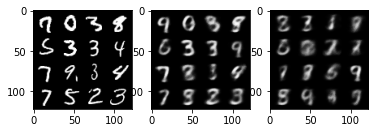

Iter: 04910/50000, Recon loss: 8943.5742, KL div loss: 1009.5042, Total loss: 9953.0781
Iter: 04920/50000, Recon loss: 9062.4160, KL div loss: 946.7052, Total loss: 10009.1211
Iter: 04930/50000, Recon loss: 8599.3262, KL div loss: 969.8785, Total loss: 9569.2051
Iter: 04940/50000, Recon loss: 8811.4082, KL div loss: 1027.5264, Total loss: 9838.9346
Iter: 04950/50000, Recon loss: 8466.0820, KL div loss: 964.7637, Total loss: 9430.8457


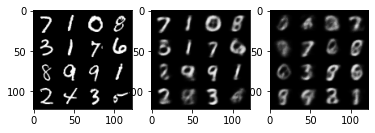

Iter: 04960/50000, Recon loss: 8661.5400, KL div loss: 984.5646, Total loss: 9646.1045
Iter: 04970/50000, Recon loss: 8962.4707, KL div loss: 1017.5132, Total loss: 9979.9844
Iter: 04980/50000, Recon loss: 8241.5674, KL div loss: 983.9095, Total loss: 9225.4766
Iter: 04990/50000, Recon loss: 8564.7051, KL div loss: 1020.5930, Total loss: 9585.2979
Iter: 05000/50000, Recon loss: 8640.7080, KL div loss: 1040.7987, Total loss: 9681.5068


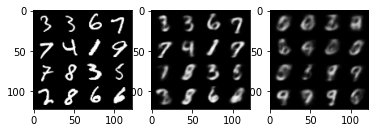

Iter: 05010/50000, Recon loss: 8733.1875, KL div loss: 1069.5564, Total loss: 9802.7441
Iter: 05020/50000, Recon loss: 8408.9355, KL div loss: 1099.0667, Total loss: 9508.0020
Iter: 05030/50000, Recon loss: 8792.3164, KL div loss: 1055.1907, Total loss: 9847.5068
Iter: 05040/50000, Recon loss: 8217.5879, KL div loss: 1121.9379, Total loss: 9339.5254
Iter: 05050/50000, Recon loss: 8125.9697, KL div loss: 1065.8251, Total loss: 9191.7949


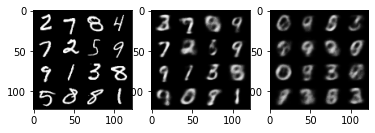

Iter: 05060/50000, Recon loss: 7960.9521, KL div loss: 1034.0159, Total loss: 8994.9678
Iter: 05070/50000, Recon loss: 8375.6826, KL div loss: 998.7286, Total loss: 9374.4111
Iter: 05080/50000, Recon loss: 8581.4121, KL div loss: 1040.4885, Total loss: 9621.9004
Iter: 05090/50000, Recon loss: 8461.7422, KL div loss: 1020.2108, Total loss: 9481.9531
Iter: 05100/50000, Recon loss: 8679.3428, KL div loss: 995.7223, Total loss: 9675.0654


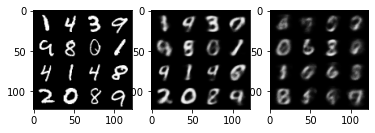

Iter: 05110/50000, Recon loss: 8938.1143, KL div loss: 1052.5837, Total loss: 9990.6982
Iter: 05120/50000, Recon loss: 8259.9619, KL div loss: 1026.7882, Total loss: 9286.7500
Iter: 05130/50000, Recon loss: 7934.6958, KL div loss: 1004.1865, Total loss: 8938.8828
Iter: 05140/50000, Recon loss: 8021.8696, KL div loss: 1036.0964, Total loss: 9057.9658
Iter: 05150/50000, Recon loss: 8155.0249, KL div loss: 968.3445, Total loss: 9123.3691


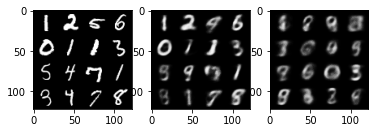

Iter: 05160/50000, Recon loss: 8324.1289, KL div loss: 1105.5891, Total loss: 9429.7178
Iter: 05170/50000, Recon loss: 8321.2725, KL div loss: 1031.1934, Total loss: 9352.4658
Iter: 05180/50000, Recon loss: 8628.0215, KL div loss: 988.7745, Total loss: 9616.7959
Iter: 05190/50000, Recon loss: 8639.9355, KL div loss: 999.6239, Total loss: 9639.5596
Iter: 05200/50000, Recon loss: 8813.4238, KL div loss: 1126.1582, Total loss: 9939.5820


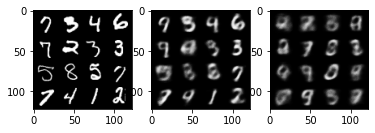

Iter: 05210/50000, Recon loss: 8404.5410, KL div loss: 954.9413, Total loss: 9359.4824
Iter: 05220/50000, Recon loss: 7904.6733, KL div loss: 1079.7191, Total loss: 8984.3926
Iter: 05230/50000, Recon loss: 7955.4219, KL div loss: 989.9294, Total loss: 8945.3516
Iter: 05240/50000, Recon loss: 8305.0176, KL div loss: 1016.8007, Total loss: 9321.8184
Iter: 05250/50000, Recon loss: 8682.8594, KL div loss: 1062.5916, Total loss: 9745.4512


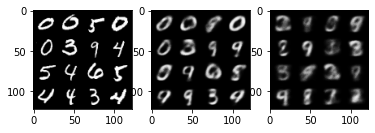

Iter: 05260/50000, Recon loss: 8662.9141, KL div loss: 1027.6687, Total loss: 9690.5830
Iter: 05270/50000, Recon loss: 9319.9922, KL div loss: 1103.9963, Total loss: 10423.9883
Iter: 05280/50000, Recon loss: 9337.0059, KL div loss: 1061.9211, Total loss: 10398.9268
Iter: 05290/50000, Recon loss: 8176.8887, KL div loss: 1038.5759, Total loss: 9215.4648
Iter: 05300/50000, Recon loss: 7893.7437, KL div loss: 1028.4512, Total loss: 8922.1953


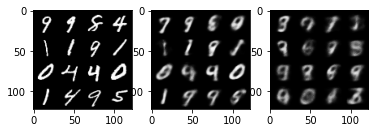

Iter: 05310/50000, Recon loss: 8766.4229, KL div loss: 1047.9076, Total loss: 9814.3301
Iter: 05320/50000, Recon loss: 8359.7705, KL div loss: 1010.8969, Total loss: 9370.6670
Iter: 05330/50000, Recon loss: 8319.2998, KL div loss: 976.7983, Total loss: 9296.0977
Iter: 05340/50000, Recon loss: 8064.3979, KL div loss: 1062.4929, Total loss: 9126.8906
Iter: 05350/50000, Recon loss: 8813.8809, KL div loss: 1076.2058, Total loss: 9890.0869


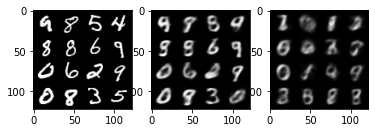

Iter: 05360/50000, Recon loss: 8486.4785, KL div loss: 1051.6167, Total loss: 9538.0957
Iter: 05370/50000, Recon loss: 8719.6777, KL div loss: 1025.5247, Total loss: 9745.2021
Iter: 05380/50000, Recon loss: 8293.3496, KL div loss: 999.4880, Total loss: 9292.8379
Iter: 05390/50000, Recon loss: 8446.1719, KL div loss: 1029.1584, Total loss: 9475.3301
Iter: 05400/50000, Recon loss: 8492.5674, KL div loss: 1088.5504, Total loss: 9581.1182


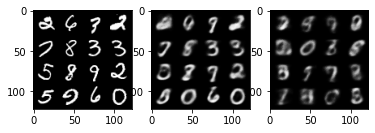

Iter: 05410/50000, Recon loss: 8194.7344, KL div loss: 1005.6185, Total loss: 9200.3525
Iter: 05420/50000, Recon loss: 8247.2510, KL div loss: 1024.4152, Total loss: 9271.6660
Iter: 05430/50000, Recon loss: 8697.0508, KL div loss: 1077.8466, Total loss: 9774.8975
Iter: 05440/50000, Recon loss: 7907.5625, KL div loss: 969.2628, Total loss: 8876.8252
Iter: 05450/50000, Recon loss: 8001.2476, KL div loss: 1054.0537, Total loss: 9055.3008


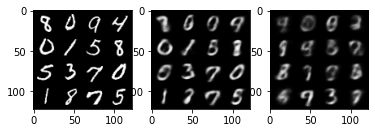

Iter: 05460/50000, Recon loss: 8346.2705, KL div loss: 984.4863, Total loss: 9330.7568
Iter: 05470/50000, Recon loss: 8122.3994, KL div loss: 1053.0596, Total loss: 9175.4590
Iter: 05480/50000, Recon loss: 8104.9268, KL div loss: 1051.4709, Total loss: 9156.3975
Iter: 05490/50000, Recon loss: 8353.3887, KL div loss: 972.0013, Total loss: 9325.3896
Iter: 05500/50000, Recon loss: 7879.6826, KL div loss: 1071.8560, Total loss: 8951.5391


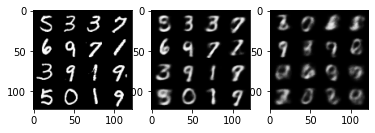

Iter: 05510/50000, Recon loss: 8375.7568, KL div loss: 1077.2278, Total loss: 9452.9844
Iter: 05520/50000, Recon loss: 8377.7021, KL div loss: 993.0657, Total loss: 9370.7676
Iter: 05530/50000, Recon loss: 8096.3037, KL div loss: 1022.7932, Total loss: 9119.0967
Iter: 05540/50000, Recon loss: 8306.8164, KL div loss: 981.6530, Total loss: 9288.4697
Iter: 05550/50000, Recon loss: 7597.8467, KL div loss: 985.5403, Total loss: 8583.3867


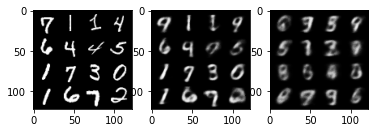

Iter: 05560/50000, Recon loss: 8303.4482, KL div loss: 1003.8854, Total loss: 9307.3340
Iter: 05570/50000, Recon loss: 8442.3994, KL div loss: 1056.6597, Total loss: 9499.0586
Iter: 05580/50000, Recon loss: 8749.4258, KL div loss: 1082.3905, Total loss: 9831.8164
Iter: 05590/50000, Recon loss: 9100.8760, KL div loss: 1059.0375, Total loss: 10159.9131
Iter: 05600/50000, Recon loss: 8769.4688, KL div loss: 1094.0154, Total loss: 9863.4844


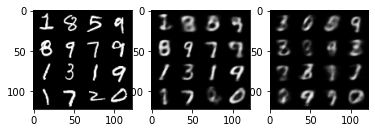

Iter: 05610/50000, Recon loss: 8620.3926, KL div loss: 1041.1406, Total loss: 9661.5332
Iter: 05620/50000, Recon loss: 8044.8574, KL div loss: 1081.0638, Total loss: 9125.9209
Iter: 05630/50000, Recon loss: 8100.5771, KL div loss: 1087.4890, Total loss: 9188.0664
Iter: 05640/50000, Recon loss: 8228.5918, KL div loss: 1080.8290, Total loss: 9309.4209
Iter: 05650/50000, Recon loss: 7946.0850, KL div loss: 1143.1765, Total loss: 9089.2617


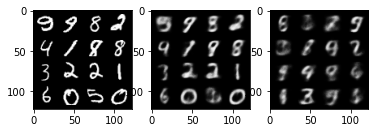

Iter: 05660/50000, Recon loss: 8098.9951, KL div loss: 1037.3651, Total loss: 9136.3604
Iter: 05670/50000, Recon loss: 8223.6846, KL div loss: 1055.5193, Total loss: 9279.2041
Iter: 05680/50000, Recon loss: 8478.8594, KL div loss: 1016.5193, Total loss: 9495.3789
Iter: 05690/50000, Recon loss: 8436.0596, KL div loss: 1093.7158, Total loss: 9529.7754
Iter: 05700/50000, Recon loss: 8205.0723, KL div loss: 1088.5547, Total loss: 9293.6270


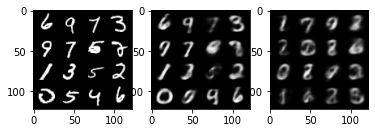

Iter: 05710/50000, Recon loss: 8435.0293, KL div loss: 1055.9229, Total loss: 9490.9521
Iter: 05720/50000, Recon loss: 8313.3594, KL div loss: 1032.8458, Total loss: 9346.2051
Iter: 05730/50000, Recon loss: 8161.1914, KL div loss: 1015.0876, Total loss: 9176.2793
Iter: 05740/50000, Recon loss: 8394.8926, KL div loss: 1069.0973, Total loss: 9463.9902
Iter: 05750/50000, Recon loss: 7913.0156, KL div loss: 1082.5234, Total loss: 8995.5391


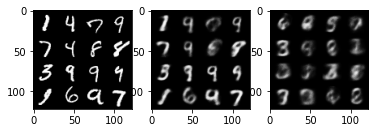

Iter: 05760/50000, Recon loss: 8077.5312, KL div loss: 1050.4990, Total loss: 9128.0303
Iter: 05770/50000, Recon loss: 8405.3633, KL div loss: 1002.3779, Total loss: 9407.7412
Iter: 05780/50000, Recon loss: 8423.6660, KL div loss: 1097.7001, Total loss: 9521.3662
Iter: 05790/50000, Recon loss: 7936.2666, KL div loss: 1029.5273, Total loss: 8965.7939
Iter: 05800/50000, Recon loss: 8097.0732, KL div loss: 1043.3317, Total loss: 9140.4053


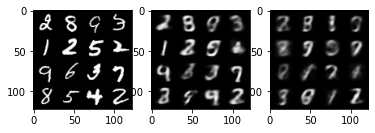

Iter: 05810/50000, Recon loss: 7700.4463, KL div loss: 1048.5734, Total loss: 8749.0195
Iter: 05820/50000, Recon loss: 8029.6982, KL div loss: 1063.8866, Total loss: 9093.5850
Iter: 05830/50000, Recon loss: 8364.1426, KL div loss: 1115.8699, Total loss: 9480.0127
Iter: 05840/50000, Recon loss: 7682.2290, KL div loss: 1128.4348, Total loss: 8810.6641
Iter: 05850/50000, Recon loss: 8313.7363, KL div loss: 1061.1543, Total loss: 9374.8906


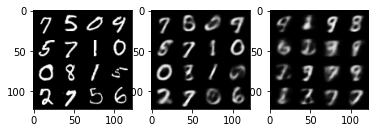

Iter: 05860/50000, Recon loss: 8278.3799, KL div loss: 1133.8090, Total loss: 9412.1885
Iter: 05870/50000, Recon loss: 8070.1885, KL div loss: 1086.4395, Total loss: 9156.6279
Iter: 05880/50000, Recon loss: 8033.8779, KL div loss: 1083.2683, Total loss: 9117.1465
Iter: 05890/50000, Recon loss: 8585.4570, KL div loss: 1040.2241, Total loss: 9625.6816
Iter: 05900/50000, Recon loss: 8182.5322, KL div loss: 1112.8658, Total loss: 9295.3984


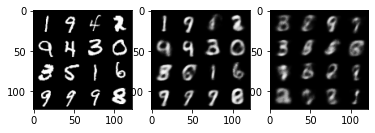

Iter: 05910/50000, Recon loss: 8393.9570, KL div loss: 1080.8463, Total loss: 9474.8037
Iter: 05920/50000, Recon loss: 8545.3848, KL div loss: 1083.8352, Total loss: 9629.2197
Iter: 05930/50000, Recon loss: 8097.5830, KL div loss: 1076.9714, Total loss: 9174.5547
Iter: 05940/50000, Recon loss: 8298.0410, KL div loss: 1113.0770, Total loss: 9411.1182
Iter: 05950/50000, Recon loss: 8886.6260, KL div loss: 1016.1721, Total loss: 9902.7979


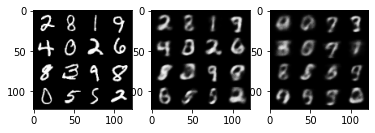

Iter: 05960/50000, Recon loss: 8363.8281, KL div loss: 1071.6700, Total loss: 9435.4980
Iter: 05970/50000, Recon loss: 7887.8936, KL div loss: 1031.2168, Total loss: 8919.1104
Iter: 05980/50000, Recon loss: 8014.1572, KL div loss: 980.1880, Total loss: 8994.3457
Iter: 05990/50000, Recon loss: 7957.7900, KL div loss: 1006.3986, Total loss: 8964.1885
Iter: 06000/50000, Recon loss: 7797.9502, KL div loss: 1087.7516, Total loss: 8885.7021


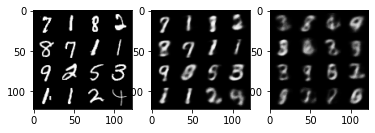

Iter: 06010/50000, Recon loss: 8421.0781, KL div loss: 1014.0795, Total loss: 9435.1572
Iter: 06020/50000, Recon loss: 7632.6494, KL div loss: 1029.9689, Total loss: 8662.6182
Iter: 06030/50000, Recon loss: 7648.6631, KL div loss: 1102.2097, Total loss: 8750.8730
Iter: 06040/50000, Recon loss: 8313.1777, KL div loss: 1103.0599, Total loss: 9416.2373
Iter: 06050/50000, Recon loss: 7985.2930, KL div loss: 955.4567, Total loss: 8940.7500


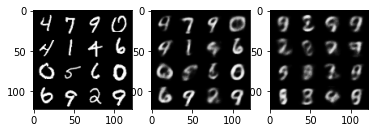

Iter: 06060/50000, Recon loss: 8497.0391, KL div loss: 1068.3428, Total loss: 9565.3818
Iter: 06070/50000, Recon loss: 8325.6719, KL div loss: 1118.1897, Total loss: 9443.8613
Iter: 06080/50000, Recon loss: 8142.6465, KL div loss: 1063.2798, Total loss: 9205.9258
Iter: 06090/50000, Recon loss: 8357.4512, KL div loss: 1083.7756, Total loss: 9441.2266
Iter: 06100/50000, Recon loss: 7289.9683, KL div loss: 1058.3330, Total loss: 8348.3008


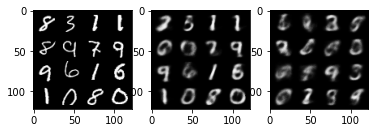

Iter: 06110/50000, Recon loss: 7555.3193, KL div loss: 1019.1319, Total loss: 8574.4512
Iter: 06120/50000, Recon loss: 8140.6338, KL div loss: 1026.8838, Total loss: 9167.5176
Iter: 06130/50000, Recon loss: 7865.7256, KL div loss: 1085.5552, Total loss: 8951.2812
Iter: 06140/50000, Recon loss: 8235.7197, KL div loss: 1098.6345, Total loss: 9334.3545
Iter: 06150/50000, Recon loss: 7914.9844, KL div loss: 1076.0745, Total loss: 8991.0586


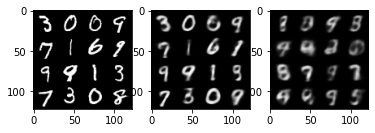

Iter: 06160/50000, Recon loss: 7754.8447, KL div loss: 1025.1589, Total loss: 8780.0039
Iter: 06170/50000, Recon loss: 7915.7012, KL div loss: 1098.5613, Total loss: 9014.2627
Iter: 06180/50000, Recon loss: 7837.6973, KL div loss: 1184.2534, Total loss: 9021.9512
Iter: 06190/50000, Recon loss: 7730.4902, KL div loss: 1130.0637, Total loss: 8860.5537
Iter: 06200/50000, Recon loss: 7959.2383, KL div loss: 1096.4491, Total loss: 9055.6875


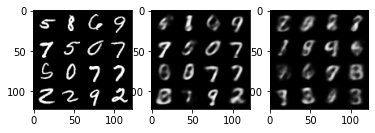

Iter: 06210/50000, Recon loss: 7522.3594, KL div loss: 1080.6543, Total loss: 8603.0137
Iter: 06220/50000, Recon loss: 7812.7417, KL div loss: 1021.0148, Total loss: 8833.7568
Iter: 06230/50000, Recon loss: 7909.7827, KL div loss: 1082.4315, Total loss: 8992.2139
Iter: 06240/50000, Recon loss: 8016.3462, KL div loss: 1004.3574, Total loss: 9020.7031
Iter: 06250/50000, Recon loss: 7913.8149, KL div loss: 1013.1097, Total loss: 8926.9248


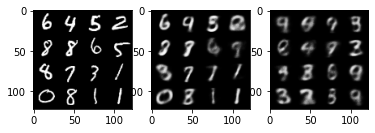

Iter: 06260/50000, Recon loss: 7857.6284, KL div loss: 1057.4967, Total loss: 8915.1250
Iter: 06270/50000, Recon loss: 7749.2617, KL div loss: 1064.7192, Total loss: 8813.9805
Iter: 06280/50000, Recon loss: 7665.5010, KL div loss: 1071.3105, Total loss: 8736.8115
Iter: 06290/50000, Recon loss: 8971.6494, KL div loss: 1155.7500, Total loss: 10127.3994
Iter: 06300/50000, Recon loss: 8363.1953, KL div loss: 1020.4791, Total loss: 9383.6748


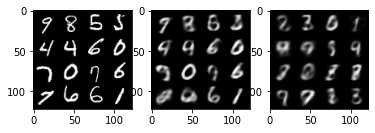

Iter: 06310/50000, Recon loss: 7853.5708, KL div loss: 1018.3633, Total loss: 8871.9346
Iter: 06320/50000, Recon loss: 8098.5361, KL div loss: 1115.9465, Total loss: 9214.4824
Iter: 06330/50000, Recon loss: 7476.2744, KL div loss: 1069.7283, Total loss: 8546.0029
Iter: 06340/50000, Recon loss: 8018.7568, KL div loss: 1041.5383, Total loss: 9060.2949
Iter: 06350/50000, Recon loss: 7946.8975, KL div loss: 1127.1644, Total loss: 9074.0615


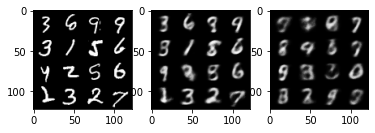

Iter: 06360/50000, Recon loss: 8058.7817, KL div loss: 1074.0928, Total loss: 9132.8750
Iter: 06370/50000, Recon loss: 7526.0942, KL div loss: 1090.9919, Total loss: 8617.0859
Iter: 06380/50000, Recon loss: 7603.9346, KL div loss: 1084.4200, Total loss: 8688.3545
Iter: 06390/50000, Recon loss: 8022.4380, KL div loss: 1135.7065, Total loss: 9158.1445
Iter: 06400/50000, Recon loss: 7848.0898, KL div loss: 1099.4808, Total loss: 8947.5703


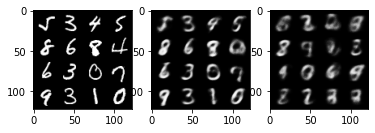

Iter: 06410/50000, Recon loss: 8446.4395, KL div loss: 1121.0056, Total loss: 9567.4453
Iter: 06420/50000, Recon loss: 7600.1616, KL div loss: 1089.5973, Total loss: 8689.7588
Iter: 06430/50000, Recon loss: 7532.3506, KL div loss: 1126.0056, Total loss: 8658.3564
Iter: 06440/50000, Recon loss: 8106.7295, KL div loss: 1105.5220, Total loss: 9212.2520
Iter: 06450/50000, Recon loss: 7635.7900, KL div loss: 1090.5586, Total loss: 8726.3486


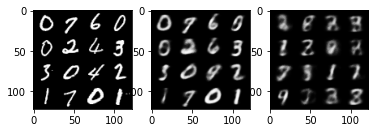

Iter: 06460/50000, Recon loss: 8355.4766, KL div loss: 1109.8820, Total loss: 9465.3584
Iter: 06470/50000, Recon loss: 7952.2603, KL div loss: 1061.7930, Total loss: 9014.0527
Iter: 06480/50000, Recon loss: 7803.1606, KL div loss: 1069.5319, Total loss: 8872.6924
Iter: 06490/50000, Recon loss: 7407.7852, KL div loss: 1092.6416, Total loss: 8500.4268
Iter: 06500/50000, Recon loss: 8832.7129, KL div loss: 1124.9624, Total loss: 9957.6758


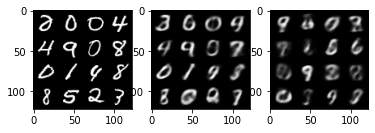

Iter: 06510/50000, Recon loss: 8340.4004, KL div loss: 1116.2670, Total loss: 9456.6670
Iter: 06520/50000, Recon loss: 8326.0967, KL div loss: 1080.8571, Total loss: 9406.9541
Iter: 06530/50000, Recon loss: 7357.9580, KL div loss: 1094.3198, Total loss: 8452.2773
Iter: 06540/50000, Recon loss: 7155.6968, KL div loss: 1091.5869, Total loss: 8247.2832
Iter: 06550/50000, Recon loss: 8639.0352, KL div loss: 1069.8762, Total loss: 9708.9111


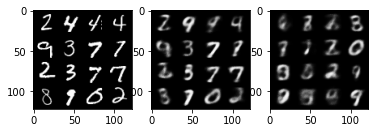

Iter: 06560/50000, Recon loss: 7261.6348, KL div loss: 1123.5499, Total loss: 8385.1846
Iter: 06570/50000, Recon loss: 8103.6533, KL div loss: 1088.4082, Total loss: 9192.0615
Iter: 06580/50000, Recon loss: 8387.5986, KL div loss: 1058.6016, Total loss: 9446.2002
Iter: 06590/50000, Recon loss: 8253.7959, KL div loss: 1131.3014, Total loss: 9385.0977
Iter: 06600/50000, Recon loss: 8001.1562, KL div loss: 1083.4795, Total loss: 9084.6357


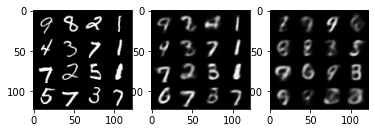

Iter: 06610/50000, Recon loss: 8112.9668, KL div loss: 1126.1732, Total loss: 9239.1396
Iter: 06620/50000, Recon loss: 8084.8008, KL div loss: 1106.0181, Total loss: 9190.8184
Iter: 06630/50000, Recon loss: 8382.5518, KL div loss: 1085.1536, Total loss: 9467.7051
Iter: 06640/50000, Recon loss: 8065.1953, KL div loss: 1093.7190, Total loss: 9158.9141
Iter: 06650/50000, Recon loss: 8091.8262, KL div loss: 1005.6180, Total loss: 9097.4443


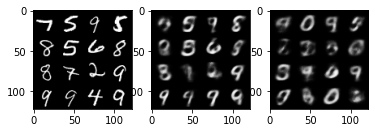

Iter: 06660/50000, Recon loss: 8098.5557, KL div loss: 1083.7158, Total loss: 9182.2715
Iter: 06670/50000, Recon loss: 7926.4502, KL div loss: 1131.1925, Total loss: 9057.6426
Iter: 06680/50000, Recon loss: 7589.3291, KL div loss: 1101.5216, Total loss: 8690.8506
Iter: 06690/50000, Recon loss: 7960.5186, KL div loss: 1162.0430, Total loss: 9122.5615
Iter: 06700/50000, Recon loss: 8567.0605, KL div loss: 1124.5674, Total loss: 9691.6279


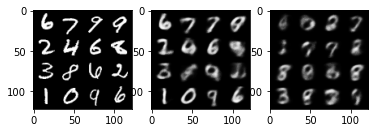

Iter: 06710/50000, Recon loss: 7651.2070, KL div loss: 1109.1378, Total loss: 8760.3447
Iter: 06720/50000, Recon loss: 8341.6211, KL div loss: 1150.2220, Total loss: 9491.8428
Iter: 06730/50000, Recon loss: 7996.6416, KL div loss: 1052.0348, Total loss: 9048.6768
Iter: 06740/50000, Recon loss: 7977.4883, KL div loss: 1135.6345, Total loss: 9113.1230
Iter: 06750/50000, Recon loss: 7614.0889, KL div loss: 1099.9878, Total loss: 8714.0762


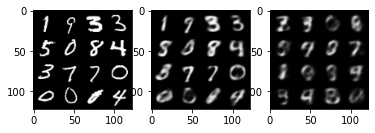

Iter: 06760/50000, Recon loss: 7658.9316, KL div loss: 1093.7495, Total loss: 8752.6816
Iter: 06770/50000, Recon loss: 8391.3105, KL div loss: 1143.2985, Total loss: 9534.6094
Iter: 06780/50000, Recon loss: 7411.3940, KL div loss: 1053.3199, Total loss: 8464.7139
Iter: 06790/50000, Recon loss: 7761.4941, KL div loss: 1112.7880, Total loss: 8874.2822
Iter: 06800/50000, Recon loss: 7788.9536, KL div loss: 990.8902, Total loss: 8779.8438


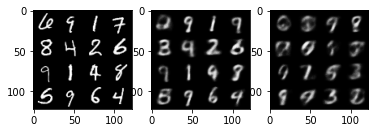

Iter: 06810/50000, Recon loss: 7850.0049, KL div loss: 1152.3022, Total loss: 9002.3066
Iter: 06820/50000, Recon loss: 7582.6948, KL div loss: 1145.6044, Total loss: 8728.2988
Iter: 06830/50000, Recon loss: 7899.1240, KL div loss: 1080.5588, Total loss: 8979.6826
Iter: 06840/50000, Recon loss: 7831.5723, KL div loss: 1136.7344, Total loss: 8968.3066
Iter: 06850/50000, Recon loss: 8096.6035, KL div loss: 1085.1167, Total loss: 9181.7207


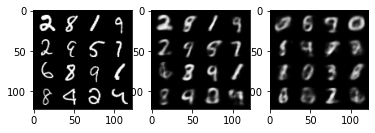

Iter: 06860/50000, Recon loss: 8507.6621, KL div loss: 1141.1079, Total loss: 9648.7695
Iter: 06870/50000, Recon loss: 7675.3301, KL div loss: 1076.7754, Total loss: 8752.1055
Iter: 06880/50000, Recon loss: 7464.4536, KL div loss: 1093.9374, Total loss: 8558.3906
Iter: 06890/50000, Recon loss: 8116.1841, KL div loss: 1090.8354, Total loss: 9207.0195
Iter: 06900/50000, Recon loss: 8668.8516, KL div loss: 1179.4227, Total loss: 9848.2744


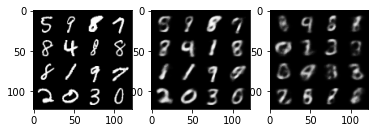

Iter: 06910/50000, Recon loss: 7090.7451, KL div loss: 1116.6689, Total loss: 8207.4141
Iter: 06920/50000, Recon loss: 7497.1582, KL div loss: 1107.9833, Total loss: 8605.1416
Iter: 06930/50000, Recon loss: 7803.0713, KL div loss: 1115.7224, Total loss: 8918.7939
Iter: 06940/50000, Recon loss: 8095.5566, KL div loss: 1100.7709, Total loss: 9196.3271
Iter: 06950/50000, Recon loss: 7591.3364, KL div loss: 1113.4293, Total loss: 8704.7656


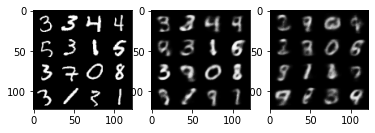

Iter: 06960/50000, Recon loss: 8393.5908, KL div loss: 1196.8171, Total loss: 9590.4082
Iter: 06970/50000, Recon loss: 7958.2070, KL div loss: 1115.0037, Total loss: 9073.2109
Iter: 06980/50000, Recon loss: 7720.3594, KL div loss: 1127.2877, Total loss: 8847.6475
Iter: 06990/50000, Recon loss: 7513.0688, KL div loss: 1002.5142, Total loss: 8515.5830
Iter: 07000/50000, Recon loss: 8055.1172, KL div loss: 1095.9053, Total loss: 9151.0225


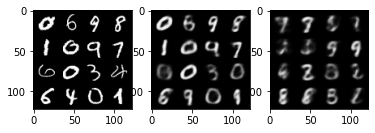

Iter: 07010/50000, Recon loss: 7697.7144, KL div loss: 1090.8295, Total loss: 8788.5439
Iter: 07020/50000, Recon loss: 7351.0449, KL div loss: 1103.4336, Total loss: 8454.4785
Iter: 07030/50000, Recon loss: 7518.4175, KL div loss: 1130.2405, Total loss: 8648.6582
Iter: 07040/50000, Recon loss: 7419.7637, KL div loss: 1116.5248, Total loss: 8536.2881
Iter: 07050/50000, Recon loss: 7642.9355, KL div loss: 1133.1667, Total loss: 8776.1025


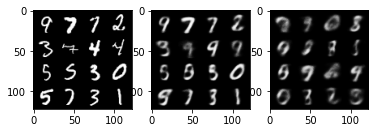

Iter: 07060/50000, Recon loss: 7973.3809, KL div loss: 1083.1156, Total loss: 9056.4961
Iter: 07070/50000, Recon loss: 7599.2227, KL div loss: 1114.6306, Total loss: 8713.8535
Iter: 07080/50000, Recon loss: 7787.4414, KL div loss: 1099.2341, Total loss: 8886.6758
Iter: 07090/50000, Recon loss: 8075.9219, KL div loss: 1120.3934, Total loss: 9196.3154
Iter: 07100/50000, Recon loss: 7977.7041, KL div loss: 1108.2827, Total loss: 9085.9863


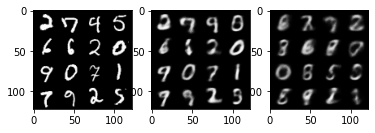

Iter: 07110/50000, Recon loss: 7527.6309, KL div loss: 1194.7864, Total loss: 8722.4170
Iter: 07120/50000, Recon loss: 8320.3398, KL div loss: 1134.9072, Total loss: 9455.2471
Iter: 07130/50000, Recon loss: 7767.9038, KL div loss: 1199.1895, Total loss: 8967.0938
Iter: 07140/50000, Recon loss: 7422.2715, KL div loss: 1112.6021, Total loss: 8534.8730
Iter: 07150/50000, Recon loss: 7797.3682, KL div loss: 1062.2356, Total loss: 8859.6035


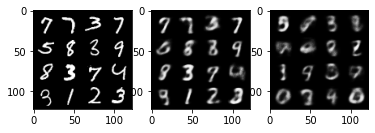

Iter: 07160/50000, Recon loss: 7927.9307, KL div loss: 1167.1929, Total loss: 9095.1230
Iter: 07170/50000, Recon loss: 7709.4683, KL div loss: 1099.9949, Total loss: 8809.4629
Iter: 07180/50000, Recon loss: 8226.3613, KL div loss: 1134.4296, Total loss: 9360.7910
Iter: 07190/50000, Recon loss: 7550.2617, KL div loss: 1138.2823, Total loss: 8688.5439
Iter: 07200/50000, Recon loss: 7689.3750, KL div loss: 1134.4216, Total loss: 8823.7969


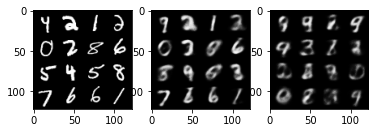

Iter: 07210/50000, Recon loss: 7858.5122, KL div loss: 1143.0593, Total loss: 9001.5713
Iter: 07220/50000, Recon loss: 7540.7891, KL div loss: 1153.6816, Total loss: 8694.4707
Iter: 07230/50000, Recon loss: 6970.1104, KL div loss: 1115.3256, Total loss: 8085.4360
Iter: 07240/50000, Recon loss: 7858.5967, KL div loss: 1182.2383, Total loss: 9040.8350
Iter: 07250/50000, Recon loss: 7992.7686, KL div loss: 1020.8334, Total loss: 9013.6016


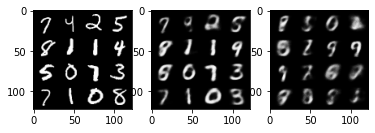

Iter: 07260/50000, Recon loss: 7831.5488, KL div loss: 1093.2139, Total loss: 8924.7627
Iter: 07270/50000, Recon loss: 7597.3584, KL div loss: 1150.6283, Total loss: 8747.9863
Iter: 07280/50000, Recon loss: 7983.8066, KL div loss: 1066.4736, Total loss: 9050.2803
Iter: 07290/50000, Recon loss: 7751.0054, KL div loss: 1094.0515, Total loss: 8845.0566
Iter: 07300/50000, Recon loss: 7472.3354, KL div loss: 1095.6682, Total loss: 8568.0039


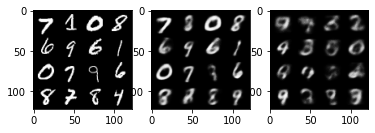

Iter: 07310/50000, Recon loss: 7654.8311, KL div loss: 1134.4451, Total loss: 8789.2764
Iter: 07320/50000, Recon loss: 7645.5654, KL div loss: 1117.1683, Total loss: 8762.7334
Iter: 07330/50000, Recon loss: 7659.6367, KL div loss: 1083.5952, Total loss: 8743.2324
Iter: 07340/50000, Recon loss: 7926.0532, KL div loss: 1186.5654, Total loss: 9112.6191
Iter: 07350/50000, Recon loss: 7590.6562, KL div loss: 1187.4023, Total loss: 8778.0586


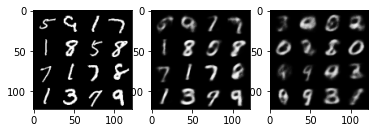

Iter: 07360/50000, Recon loss: 7506.5322, KL div loss: 1157.3256, Total loss: 8663.8574
Iter: 07370/50000, Recon loss: 8394.8789, KL div loss: 1136.2545, Total loss: 9531.1338
Iter: 07380/50000, Recon loss: 8056.8989, KL div loss: 1123.2592, Total loss: 9180.1582
Iter: 07390/50000, Recon loss: 8094.5068, KL div loss: 1121.7203, Total loss: 9216.2275
Iter: 07400/50000, Recon loss: 7470.2148, KL div loss: 1048.0013, Total loss: 8518.2158


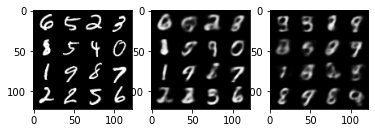

Iter: 07410/50000, Recon loss: 7866.8574, KL div loss: 1163.8105, Total loss: 9030.6680
Iter: 07420/50000, Recon loss: 8106.6914, KL div loss: 1093.0153, Total loss: 9199.7070
Iter: 07430/50000, Recon loss: 7797.4253, KL div loss: 1131.7000, Total loss: 8929.1250
Iter: 07440/50000, Recon loss: 7921.8066, KL div loss: 1176.4128, Total loss: 9098.2197
Iter: 07450/50000, Recon loss: 8154.2109, KL div loss: 1103.8772, Total loss: 9258.0879


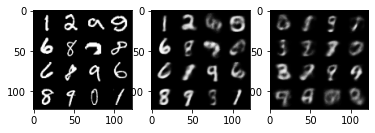

Iter: 07460/50000, Recon loss: 7732.6006, KL div loss: 1143.5681, Total loss: 8876.1689
Iter: 07470/50000, Recon loss: 7810.7842, KL div loss: 1166.0906, Total loss: 8976.8750
Iter: 07480/50000, Recon loss: 7628.7949, KL div loss: 1147.3945, Total loss: 8776.1895
Iter: 07490/50000, Recon loss: 7581.4009, KL div loss: 1119.9971, Total loss: 8701.3984
Iter: 07500/50000, Recon loss: 7794.7710, KL div loss: 1099.3793, Total loss: 8894.1504


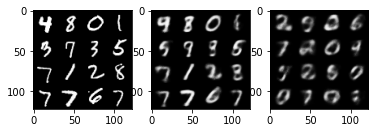

Iter: 07510/50000, Recon loss: 7863.0161, KL div loss: 1135.4564, Total loss: 8998.4727
Iter: 07520/50000, Recon loss: 7644.5479, KL div loss: 1121.7463, Total loss: 8766.2939
Iter: 07530/50000, Recon loss: 7249.6309, KL div loss: 1072.7971, Total loss: 8322.4277
Iter: 07540/50000, Recon loss: 7730.0771, KL div loss: 1133.0889, Total loss: 8863.1660
Iter: 07550/50000, Recon loss: 7757.8252, KL div loss: 1140.4033, Total loss: 8898.2285


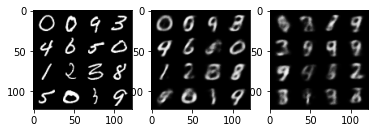

Iter: 07560/50000, Recon loss: 7223.9663, KL div loss: 1126.1650, Total loss: 8350.1309
Iter: 07570/50000, Recon loss: 7426.0923, KL div loss: 1155.6108, Total loss: 8581.7031
Iter: 07580/50000, Recon loss: 7752.6221, KL div loss: 1116.8391, Total loss: 8869.4609
Iter: 07590/50000, Recon loss: 7511.9209, KL div loss: 1134.9849, Total loss: 8646.9062
Iter: 07600/50000, Recon loss: 7934.7314, KL div loss: 1159.7467, Total loss: 9094.4785


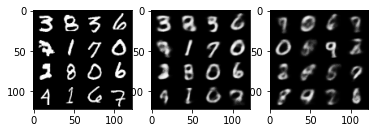

Iter: 07610/50000, Recon loss: 7333.7061, KL div loss: 1162.9989, Total loss: 8496.7051
Iter: 07620/50000, Recon loss: 7215.1475, KL div loss: 1125.2273, Total loss: 8340.3750
Iter: 07630/50000, Recon loss: 7309.6753, KL div loss: 1099.2296, Total loss: 8408.9053
Iter: 07640/50000, Recon loss: 7690.4492, KL div loss: 1164.2186, Total loss: 8854.6680
Iter: 07650/50000, Recon loss: 7822.4883, KL div loss: 1154.4742, Total loss: 8976.9629


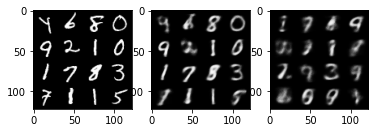

Iter: 07660/50000, Recon loss: 7260.1045, KL div loss: 1124.5005, Total loss: 8384.6055
Iter: 07670/50000, Recon loss: 7371.2500, KL div loss: 1160.3755, Total loss: 8531.6250
Iter: 07680/50000, Recon loss: 8009.7329, KL div loss: 1176.7837, Total loss: 9186.5166
Iter: 07690/50000, Recon loss: 7426.0146, KL div loss: 1106.8163, Total loss: 8532.8311
Iter: 07700/50000, Recon loss: 7175.2104, KL div loss: 1098.7139, Total loss: 8273.9238


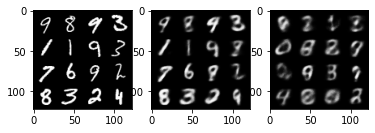

Iter: 07710/50000, Recon loss: 8049.3662, KL div loss: 1172.3521, Total loss: 9221.7188
Iter: 07720/50000, Recon loss: 7633.3286, KL div loss: 1122.0386, Total loss: 8755.3672
Iter: 07730/50000, Recon loss: 7497.6963, KL div loss: 1162.6791, Total loss: 8660.3750
Iter: 07740/50000, Recon loss: 7674.0078, KL div loss: 1149.3064, Total loss: 8823.3145
Iter: 07750/50000, Recon loss: 8131.7998, KL div loss: 1170.2469, Total loss: 9302.0469


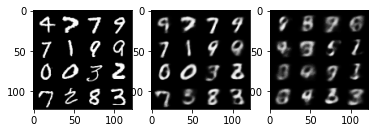

Iter: 07760/50000, Recon loss: 7185.3066, KL div loss: 1119.5386, Total loss: 8304.8457
Iter: 07770/50000, Recon loss: 7746.1475, KL div loss: 1177.4055, Total loss: 8923.5527
Iter: 07780/50000, Recon loss: 7453.1748, KL div loss: 1137.0212, Total loss: 8590.1963
Iter: 07790/50000, Recon loss: 7975.5332, KL div loss: 1111.5121, Total loss: 9087.0449
Iter: 07800/50000, Recon loss: 7726.5264, KL div loss: 1119.8579, Total loss: 8846.3848


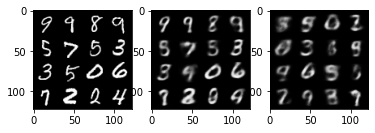

Iter: 07810/50000, Recon loss: 7595.8354, KL div loss: 1139.3972, Total loss: 8735.2324
Iter: 07820/50000, Recon loss: 8267.5244, KL div loss: 1164.6982, Total loss: 9432.2227
Iter: 07830/50000, Recon loss: 7832.3535, KL div loss: 1108.1011, Total loss: 8940.4551
Iter: 07840/50000, Recon loss: 7689.8228, KL div loss: 1095.9308, Total loss: 8785.7539
Iter: 07850/50000, Recon loss: 7598.4121, KL div loss: 1128.4998, Total loss: 8726.9121


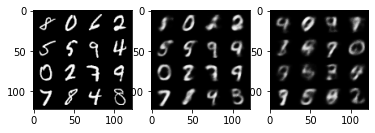

Iter: 07860/50000, Recon loss: 7915.3926, KL div loss: 1133.4037, Total loss: 9048.7959
Iter: 07870/50000, Recon loss: 7859.6953, KL div loss: 1248.1719, Total loss: 9107.8672
Iter: 07880/50000, Recon loss: 7307.9380, KL div loss: 1087.2577, Total loss: 8395.1953
Iter: 07890/50000, Recon loss: 7596.4531, KL div loss: 1136.9788, Total loss: 8733.4316
Iter: 07900/50000, Recon loss: 7716.4619, KL div loss: 1154.5422, Total loss: 8871.0039


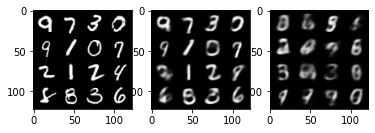

Iter: 07910/50000, Recon loss: 7666.6973, KL div loss: 1142.5552, Total loss: 8809.2520
Iter: 07920/50000, Recon loss: 7844.6367, KL div loss: 1130.6782, Total loss: 8975.3145
Iter: 07930/50000, Recon loss: 7614.3125, KL div loss: 1138.4448, Total loss: 8752.7578
Iter: 07940/50000, Recon loss: 7255.4424, KL div loss: 1099.0278, Total loss: 8354.4707
Iter: 07950/50000, Recon loss: 7180.7905, KL div loss: 1191.4198, Total loss: 8372.2100


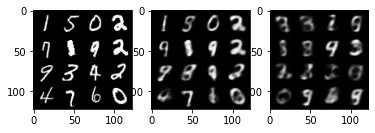

Iter: 07960/50000, Recon loss: 7377.9399, KL div loss: 1156.7595, Total loss: 8534.6992
Iter: 07970/50000, Recon loss: 7794.2905, KL div loss: 1184.8484, Total loss: 8979.1387
Iter: 07980/50000, Recon loss: 7656.1772, KL div loss: 1130.7402, Total loss: 8786.9180
Iter: 07990/50000, Recon loss: 7952.9800, KL div loss: 1137.4313, Total loss: 9090.4111
Iter: 08000/50000, Recon loss: 6916.1797, KL div loss: 1129.0105, Total loss: 8045.1904


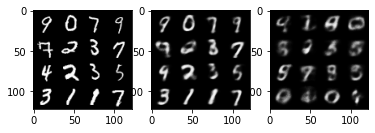

Iter: 08010/50000, Recon loss: 8133.9678, KL div loss: 1223.7839, Total loss: 9357.7520
Iter: 08020/50000, Recon loss: 7837.6523, KL div loss: 1144.1135, Total loss: 8981.7656
Iter: 08030/50000, Recon loss: 7486.8223, KL div loss: 1138.2468, Total loss: 8625.0693
Iter: 08040/50000, Recon loss: 7670.3291, KL div loss: 1176.0128, Total loss: 8846.3418
Iter: 08050/50000, Recon loss: 7800.7725, KL div loss: 1262.4241, Total loss: 9063.1963


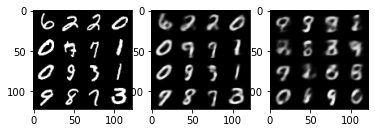

Iter: 08060/50000, Recon loss: 7672.1758, KL div loss: 1094.2743, Total loss: 8766.4502
Iter: 08070/50000, Recon loss: 7470.2993, KL div loss: 1187.3414, Total loss: 8657.6406
Iter: 08080/50000, Recon loss: 7864.8208, KL div loss: 1193.5852, Total loss: 9058.4062
Iter: 08090/50000, Recon loss: 7296.0000, KL div loss: 1177.3523, Total loss: 8473.3525
Iter: 08100/50000, Recon loss: 7759.5498, KL div loss: 1168.1848, Total loss: 8927.7344


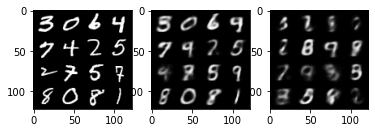

Iter: 08110/50000, Recon loss: 7584.5513, KL div loss: 1161.1018, Total loss: 8745.6533
Iter: 08120/50000, Recon loss: 7520.0005, KL div loss: 1134.0422, Total loss: 8654.0430
Iter: 08130/50000, Recon loss: 7423.5215, KL div loss: 1063.7651, Total loss: 8487.2871
Iter: 08140/50000, Recon loss: 8033.2334, KL div loss: 1162.9733, Total loss: 9196.2070
Iter: 08150/50000, Recon loss: 7463.6299, KL div loss: 1105.7922, Total loss: 8569.4219


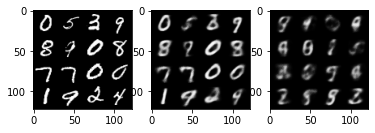

Iter: 08160/50000, Recon loss: 7577.8960, KL div loss: 1124.8044, Total loss: 8702.7002
Iter: 08170/50000, Recon loss: 7463.8428, KL div loss: 1136.6057, Total loss: 8600.4482
Iter: 08180/50000, Recon loss: 7612.9160, KL div loss: 1126.8916, Total loss: 8739.8076
Iter: 08190/50000, Recon loss: 7573.9697, KL div loss: 1185.5638, Total loss: 8759.5332
Iter: 08200/50000, Recon loss: 7756.5981, KL div loss: 1129.2325, Total loss: 8885.8311


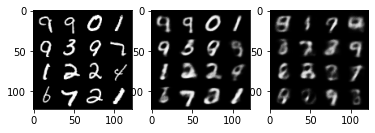

Iter: 08210/50000, Recon loss: 7431.5410, KL div loss: 1176.5482, Total loss: 8608.0889
Iter: 08220/50000, Recon loss: 7492.2227, KL div loss: 1102.9358, Total loss: 8595.1582
Iter: 08230/50000, Recon loss: 7972.9321, KL div loss: 1135.6189, Total loss: 9108.5508
Iter: 08240/50000, Recon loss: 7534.4980, KL div loss: 1111.1836, Total loss: 8645.6816
Iter: 08250/50000, Recon loss: 7721.7734, KL div loss: 1182.6547, Total loss: 8904.4277


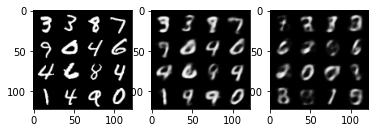

Iter: 08260/50000, Recon loss: 7368.7490, KL div loss: 1166.1672, Total loss: 8534.9160
Iter: 08270/50000, Recon loss: 7856.4521, KL div loss: 1144.8000, Total loss: 9001.2520
Iter: 08280/50000, Recon loss: 7826.8311, KL div loss: 1118.7528, Total loss: 8945.5840
Iter: 08290/50000, Recon loss: 7614.1328, KL div loss: 1174.4331, Total loss: 8788.5664
Iter: 08300/50000, Recon loss: 7106.7319, KL div loss: 1129.1106, Total loss: 8235.8428


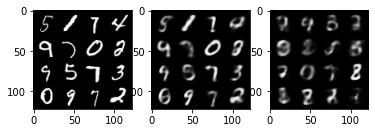

Iter: 08310/50000, Recon loss: 7413.0391, KL div loss: 1153.7812, Total loss: 8566.8203
Iter: 08320/50000, Recon loss: 7591.9644, KL div loss: 1135.7156, Total loss: 8727.6797
Iter: 08330/50000, Recon loss: 7028.2246, KL div loss: 1110.9336, Total loss: 8139.1582
Iter: 08340/50000, Recon loss: 7673.5527, KL div loss: 1212.1318, Total loss: 8885.6846
Iter: 08350/50000, Recon loss: 7517.7832, KL div loss: 1201.3696, Total loss: 8719.1523


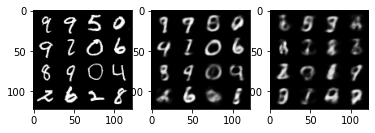

Iter: 08360/50000, Recon loss: 7168.5854, KL div loss: 1074.4861, Total loss: 8243.0713
Iter: 08370/50000, Recon loss: 7044.7036, KL div loss: 1099.1490, Total loss: 8143.8525
Iter: 08380/50000, Recon loss: 7796.8379, KL div loss: 1156.9767, Total loss: 8953.8145
Iter: 08390/50000, Recon loss: 7458.5273, KL div loss: 1199.6260, Total loss: 8658.1533
Iter: 08400/50000, Recon loss: 7204.6426, KL div loss: 1095.6841, Total loss: 8300.3262


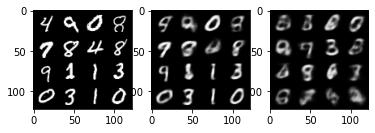

Iter: 08410/50000, Recon loss: 7063.5396, KL div loss: 1145.6543, Total loss: 8209.1934
Iter: 08420/50000, Recon loss: 7923.0303, KL div loss: 1130.8311, Total loss: 9053.8613
Iter: 08430/50000, Recon loss: 6838.9639, KL div loss: 1103.0012, Total loss: 7941.9648
Iter: 08440/50000, Recon loss: 7563.6611, KL div loss: 1206.5680, Total loss: 8770.2295
Iter: 08450/50000, Recon loss: 7494.5771, KL div loss: 1187.4385, Total loss: 8682.0156


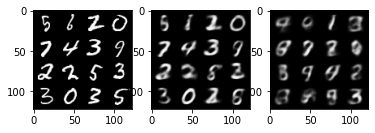

Iter: 08460/50000, Recon loss: 7525.2773, KL div loss: 1149.5166, Total loss: 8674.7939
Iter: 08470/50000, Recon loss: 7427.8701, KL div loss: 1101.1201, Total loss: 8528.9902
Iter: 08480/50000, Recon loss: 7714.1245, KL div loss: 1147.6980, Total loss: 8861.8223
Iter: 08490/50000, Recon loss: 8124.6992, KL div loss: 1199.2473, Total loss: 9323.9463
Iter: 08500/50000, Recon loss: 7754.7168, KL div loss: 1185.1990, Total loss: 8939.9160


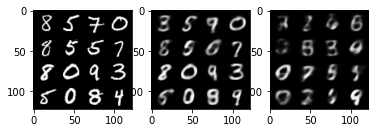

Iter: 08510/50000, Recon loss: 7522.9395, KL div loss: 1143.9030, Total loss: 8666.8428
Iter: 08520/50000, Recon loss: 7691.4248, KL div loss: 1181.7646, Total loss: 8873.1895
Iter: 08530/50000, Recon loss: 7242.8438, KL div loss: 1166.8215, Total loss: 8409.6650
Iter: 08540/50000, Recon loss: 7785.3379, KL div loss: 1180.3687, Total loss: 8965.7070
Iter: 08550/50000, Recon loss: 7422.0391, KL div loss: 1161.4680, Total loss: 8583.5068


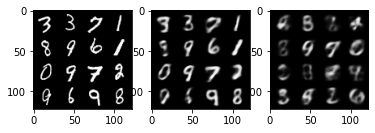

Iter: 08560/50000, Recon loss: 7786.3350, KL div loss: 1164.4478, Total loss: 8950.7832
Iter: 08570/50000, Recon loss: 7382.9404, KL div loss: 1204.1648, Total loss: 8587.1055
Iter: 08580/50000, Recon loss: 7221.8584, KL div loss: 1148.9066, Total loss: 8370.7646
Iter: 08590/50000, Recon loss: 7121.7041, KL div loss: 1181.7007, Total loss: 8303.4043
Iter: 08600/50000, Recon loss: 7365.1533, KL div loss: 1175.3555, Total loss: 8540.5088


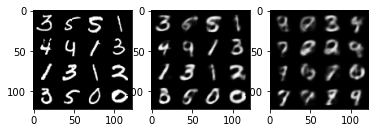

Iter: 08610/50000, Recon loss: 7474.5137, KL div loss: 1133.4395, Total loss: 8607.9531
Iter: 08620/50000, Recon loss: 6924.2358, KL div loss: 1198.9492, Total loss: 8123.1851
Iter: 08630/50000, Recon loss: 7463.6982, KL div loss: 1207.9104, Total loss: 8671.6084
Iter: 08640/50000, Recon loss: 7637.2246, KL div loss: 1108.6807, Total loss: 8745.9053
Iter: 08650/50000, Recon loss: 7334.4268, KL div loss: 1162.6721, Total loss: 8497.0986


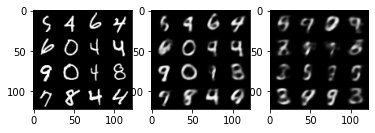

Iter: 08660/50000, Recon loss: 7120.7100, KL div loss: 1146.2017, Total loss: 8266.9121
Iter: 08670/50000, Recon loss: 7745.6079, KL div loss: 1116.5828, Total loss: 8862.1904
Iter: 08680/50000, Recon loss: 7485.5742, KL div loss: 1247.1448, Total loss: 8732.7188
Iter: 08690/50000, Recon loss: 7294.7300, KL div loss: 1081.5903, Total loss: 8376.3203
Iter: 08700/50000, Recon loss: 7114.2329, KL div loss: 1180.8647, Total loss: 8295.0977


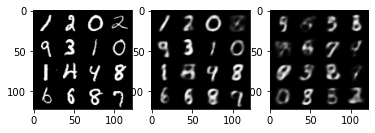

Iter: 08710/50000, Recon loss: 6981.8086, KL div loss: 1115.9878, Total loss: 8097.7964
Iter: 08720/50000, Recon loss: 7028.7729, KL div loss: 1148.0322, Total loss: 8176.8052
Iter: 08730/50000, Recon loss: 6824.3672, KL div loss: 1189.8752, Total loss: 8014.2422
Iter: 08740/50000, Recon loss: 7464.7080, KL div loss: 1096.5990, Total loss: 8561.3066
Iter: 08750/50000, Recon loss: 6805.5264, KL div loss: 1186.8824, Total loss: 7992.4087


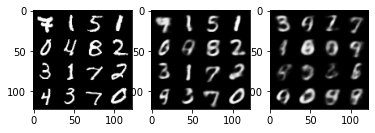

Iter: 08760/50000, Recon loss: 7311.0781, KL div loss: 1138.6445, Total loss: 8449.7227
Iter: 08770/50000, Recon loss: 7104.7588, KL div loss: 1164.9988, Total loss: 8269.7578
Iter: 08780/50000, Recon loss: 7324.2554, KL div loss: 1158.7461, Total loss: 8483.0020
Iter: 08790/50000, Recon loss: 7186.8662, KL div loss: 1166.3447, Total loss: 8353.2109
Iter: 08800/50000, Recon loss: 7213.8232, KL div loss: 1153.0726, Total loss: 8366.8955


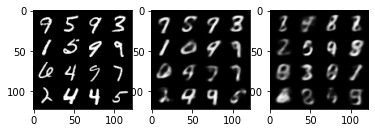

Iter: 08810/50000, Recon loss: 7573.2959, KL div loss: 1243.3247, Total loss: 8816.6211
Iter: 08820/50000, Recon loss: 6932.2476, KL div loss: 1163.7207, Total loss: 8095.9683
Iter: 08830/50000, Recon loss: 7313.2153, KL div loss: 1175.9495, Total loss: 8489.1650
Iter: 08840/50000, Recon loss: 7641.1133, KL div loss: 1156.8077, Total loss: 8797.9209
Iter: 08850/50000, Recon loss: 7131.6143, KL div loss: 1105.9365, Total loss: 8237.5508


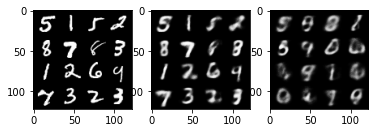

Iter: 08860/50000, Recon loss: 7654.5991, KL div loss: 1165.7080, Total loss: 8820.3066
Iter: 08870/50000, Recon loss: 7361.8433, KL div loss: 1144.1034, Total loss: 8505.9463
Iter: 08880/50000, Recon loss: 7308.9805, KL div loss: 1195.1013, Total loss: 8504.0820
Iter: 08890/50000, Recon loss: 7579.4810, KL div loss: 1184.9658, Total loss: 8764.4473
Iter: 08900/50000, Recon loss: 7306.1270, KL div loss: 1065.0920, Total loss: 8371.2188


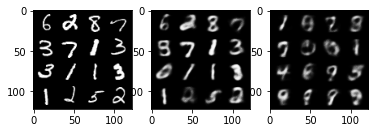

Iter: 08910/50000, Recon loss: 7152.0889, KL div loss: 1158.2705, Total loss: 8310.3594
Iter: 08920/50000, Recon loss: 7312.1660, KL div loss: 1119.5802, Total loss: 8431.7461
Iter: 08930/50000, Recon loss: 7148.5742, KL div loss: 1123.1923, Total loss: 8271.7666
Iter: 08940/50000, Recon loss: 7262.3262, KL div loss: 1150.2498, Total loss: 8412.5762
Iter: 08950/50000, Recon loss: 7530.6650, KL div loss: 1151.9377, Total loss: 8682.6025


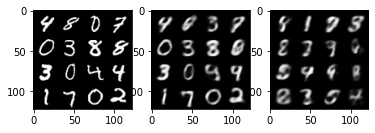

Iter: 08960/50000, Recon loss: 7775.1304, KL div loss: 1175.1957, Total loss: 8950.3262
Iter: 08970/50000, Recon loss: 7936.7412, KL div loss: 1121.4531, Total loss: 9058.1943
Iter: 08980/50000, Recon loss: 7427.2563, KL div loss: 1171.6079, Total loss: 8598.8643
Iter: 08990/50000, Recon loss: 7424.8384, KL div loss: 1173.8877, Total loss: 8598.7266
Iter: 09000/50000, Recon loss: 7139.3633, KL div loss: 1162.4148, Total loss: 8301.7783


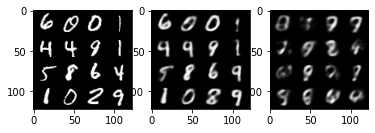

Iter: 09010/50000, Recon loss: 7276.5220, KL div loss: 1192.7771, Total loss: 8469.2988
Iter: 09020/50000, Recon loss: 7253.8438, KL div loss: 1213.4456, Total loss: 8467.2891
Iter: 09030/50000, Recon loss: 7036.9604, KL div loss: 1172.5433, Total loss: 8209.5039
Iter: 09040/50000, Recon loss: 7470.8232, KL div loss: 1181.7203, Total loss: 8652.5439
Iter: 09050/50000, Recon loss: 7160.5576, KL div loss: 1168.0284, Total loss: 8328.5859


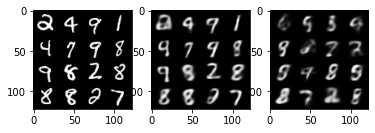

Iter: 09060/50000, Recon loss: 7304.5586, KL div loss: 1125.4695, Total loss: 8430.0283
Iter: 09070/50000, Recon loss: 7678.0332, KL div loss: 1145.6824, Total loss: 8823.7158
Iter: 09080/50000, Recon loss: 7200.5708, KL div loss: 1181.3982, Total loss: 8381.9688
Iter: 09090/50000, Recon loss: 7227.1797, KL div loss: 1122.3317, Total loss: 8349.5117
Iter: 09100/50000, Recon loss: 7032.4570, KL div loss: 1208.8352, Total loss: 8241.2920


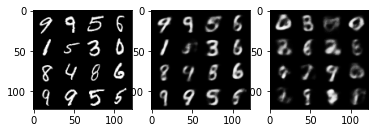

Iter: 09110/50000, Recon loss: 8110.3130, KL div loss: 1155.6826, Total loss: 9265.9961
Iter: 09120/50000, Recon loss: 7358.2725, KL div loss: 1128.7217, Total loss: 8486.9941
Iter: 09130/50000, Recon loss: 7347.9385, KL div loss: 1173.8779, Total loss: 8521.8164
Iter: 09140/50000, Recon loss: 7593.5176, KL div loss: 1113.5177, Total loss: 8707.0352
Iter: 09150/50000, Recon loss: 7398.2197, KL div loss: 1230.2478, Total loss: 8628.4678


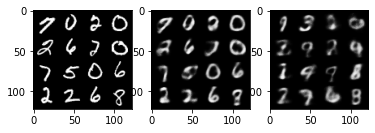

Iter: 09160/50000, Recon loss: 7159.8857, KL div loss: 1165.3878, Total loss: 8325.2734
Iter: 09170/50000, Recon loss: 7419.1392, KL div loss: 1156.4036, Total loss: 8575.5430
Iter: 09180/50000, Recon loss: 6797.1270, KL div loss: 1160.5511, Total loss: 7957.6782
Iter: 09190/50000, Recon loss: 7131.2612, KL div loss: 1122.6733, Total loss: 8253.9346
Iter: 09200/50000, Recon loss: 7331.9043, KL div loss: 1150.5088, Total loss: 8482.4131


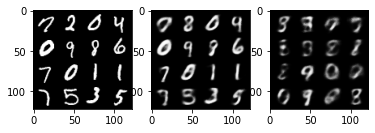

Iter: 09210/50000, Recon loss: 7107.7402, KL div loss: 1214.1284, Total loss: 8321.8691
Iter: 09220/50000, Recon loss: 7371.7344, KL div loss: 1151.4897, Total loss: 8523.2246
Iter: 09230/50000, Recon loss: 7735.1060, KL div loss: 1248.7075, Total loss: 8983.8135
Iter: 09240/50000, Recon loss: 7015.7285, KL div loss: 1191.2557, Total loss: 8206.9844
Iter: 09250/50000, Recon loss: 7398.3184, KL div loss: 1208.2074, Total loss: 8606.5254


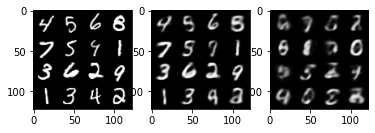

Iter: 09260/50000, Recon loss: 7599.6338, KL div loss: 1229.4814, Total loss: 8829.1152
Iter: 09270/50000, Recon loss: 7060.1904, KL div loss: 1231.5708, Total loss: 8291.7617
Iter: 09280/50000, Recon loss: 7310.9478, KL div loss: 1152.7546, Total loss: 8463.7021
Iter: 09290/50000, Recon loss: 7382.5908, KL div loss: 1154.7489, Total loss: 8537.3398
Iter: 09300/50000, Recon loss: 7251.7139, KL div loss: 1205.2476, Total loss: 8456.9609


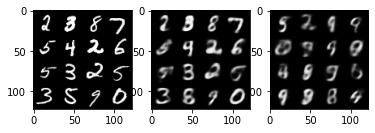

Iter: 09310/50000, Recon loss: 7182.9121, KL div loss: 1190.7129, Total loss: 8373.6250
Iter: 09320/50000, Recon loss: 7295.9746, KL div loss: 1236.2632, Total loss: 8532.2383
Iter: 09330/50000, Recon loss: 6873.8452, KL div loss: 1161.7953, Total loss: 8035.6406
Iter: 09340/50000, Recon loss: 6420.0771, KL div loss: 1155.5793, Total loss: 7575.6562
Iter: 09350/50000, Recon loss: 7160.6885, KL div loss: 1224.4862, Total loss: 8385.1748


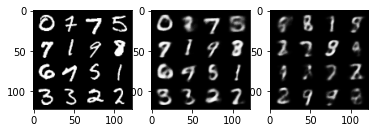

Iter: 09360/50000, Recon loss: 7238.2930, KL div loss: 1190.7942, Total loss: 8429.0869
Iter: 09370/50000, Recon loss: 7753.6738, KL div loss: 1198.3982, Total loss: 8952.0723
Iter: 09380/50000, Recon loss: 7386.1377, KL div loss: 1214.2837, Total loss: 8600.4219
Iter: 09390/50000, Recon loss: 6712.3242, KL div loss: 1163.7716, Total loss: 7876.0957
Iter: 09400/50000, Recon loss: 7237.8350, KL div loss: 1168.0222, Total loss: 8405.8574


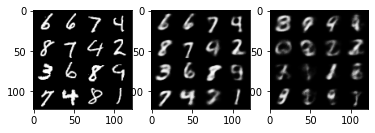

Iter: 09410/50000, Recon loss: 6795.9160, KL div loss: 1160.9011, Total loss: 7956.8174
Iter: 09420/50000, Recon loss: 7388.0586, KL div loss: 1169.1720, Total loss: 8557.2305
Iter: 09430/50000, Recon loss: 7430.7900, KL div loss: 1173.6011, Total loss: 8604.3906
Iter: 09440/50000, Recon loss: 7316.7578, KL div loss: 1233.8667, Total loss: 8550.6250
Iter: 09450/50000, Recon loss: 6904.5039, KL div loss: 1189.9939, Total loss: 8094.4980


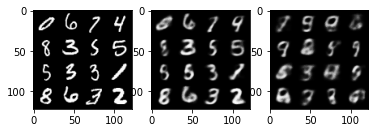

Iter: 09460/50000, Recon loss: 7155.2324, KL div loss: 1137.8348, Total loss: 8293.0674
Iter: 09470/50000, Recon loss: 7392.2964, KL div loss: 1168.0073, Total loss: 8560.3037
Iter: 09480/50000, Recon loss: 7210.9849, KL div loss: 1186.5024, Total loss: 8397.4873
Iter: 09490/50000, Recon loss: 7220.1318, KL div loss: 1210.7048, Total loss: 8430.8369
Iter: 09500/50000, Recon loss: 7237.3174, KL div loss: 1173.5765, Total loss: 8410.8936


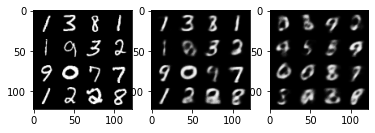

Iter: 09510/50000, Recon loss: 6997.2744, KL div loss: 1167.1450, Total loss: 8164.4194
Iter: 09520/50000, Recon loss: 7152.3169, KL div loss: 1230.5457, Total loss: 8382.8623
Iter: 09530/50000, Recon loss: 7391.1401, KL div loss: 1194.7356, Total loss: 8585.8760
Iter: 09540/50000, Recon loss: 7148.2695, KL div loss: 1148.5442, Total loss: 8296.8135
Iter: 09550/50000, Recon loss: 7022.4868, KL div loss: 1183.9568, Total loss: 8206.4434


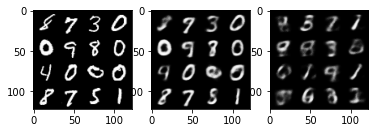

Iter: 09560/50000, Recon loss: 7248.0303, KL div loss: 1226.3379, Total loss: 8474.3682
Iter: 09570/50000, Recon loss: 6972.4048, KL div loss: 1189.9907, Total loss: 8162.3955
Iter: 09580/50000, Recon loss: 6834.3975, KL div loss: 1177.7557, Total loss: 8012.1533
Iter: 09590/50000, Recon loss: 6966.7725, KL div loss: 1157.6414, Total loss: 8124.4141
Iter: 09600/50000, Recon loss: 6934.1519, KL div loss: 1170.0378, Total loss: 8104.1895


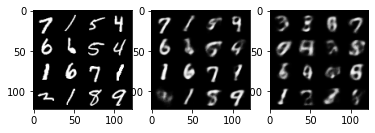

Iter: 09610/50000, Recon loss: 6968.9746, KL div loss: 1156.2898, Total loss: 8125.2646
Iter: 09620/50000, Recon loss: 7773.4570, KL div loss: 1208.0095, Total loss: 8981.4668
Iter: 09630/50000, Recon loss: 7297.4575, KL div loss: 1160.7759, Total loss: 8458.2334
Iter: 09640/50000, Recon loss: 7307.4512, KL div loss: 1171.7781, Total loss: 8479.2295
Iter: 09650/50000, Recon loss: 6908.3076, KL div loss: 1193.2144, Total loss: 8101.5220


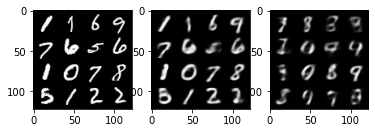

Iter: 09660/50000, Recon loss: 7052.7661, KL div loss: 1188.2627, Total loss: 8241.0293
Iter: 09670/50000, Recon loss: 7401.1846, KL div loss: 1164.7638, Total loss: 8565.9482
Iter: 09680/50000, Recon loss: 7321.3711, KL div loss: 1165.4087, Total loss: 8486.7793
Iter: 09690/50000, Recon loss: 7377.1162, KL div loss: 1156.8729, Total loss: 8533.9893
Iter: 09700/50000, Recon loss: 6513.0830, KL div loss: 1170.0264, Total loss: 7683.1094


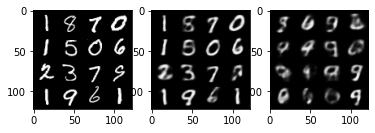

Iter: 09710/50000, Recon loss: 7015.4619, KL div loss: 1195.8171, Total loss: 8211.2793
Iter: 09720/50000, Recon loss: 7189.6611, KL div loss: 1212.3900, Total loss: 8402.0508
Iter: 09730/50000, Recon loss: 6992.3804, KL div loss: 1195.4724, Total loss: 8187.8525
Iter: 09740/50000, Recon loss: 7931.6050, KL div loss: 1249.7224, Total loss: 9181.3271
Iter: 09750/50000, Recon loss: 7271.0234, KL div loss: 1210.9297, Total loss: 8481.9531


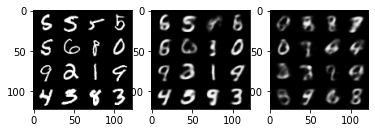

Iter: 09760/50000, Recon loss: 7344.3579, KL div loss: 1168.7947, Total loss: 8513.1523
Iter: 09770/50000, Recon loss: 7323.0596, KL div loss: 1203.6536, Total loss: 8526.7129
Iter: 09780/50000, Recon loss: 7170.9785, KL div loss: 1195.0808, Total loss: 8366.0596
Iter: 09790/50000, Recon loss: 7211.2373, KL div loss: 1198.6907, Total loss: 8409.9277
Iter: 09800/50000, Recon loss: 6841.4209, KL div loss: 1272.7959, Total loss: 8114.2168


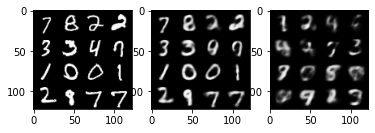

Iter: 09810/50000, Recon loss: 7625.9282, KL div loss: 1216.9902, Total loss: 8842.9180
Iter: 09820/50000, Recon loss: 7190.6812, KL div loss: 1140.2913, Total loss: 8330.9727
Iter: 09830/50000, Recon loss: 6802.6396, KL div loss: 1192.8442, Total loss: 7995.4839
Iter: 09840/50000, Recon loss: 6645.1851, KL div loss: 1191.7190, Total loss: 7836.9043
Iter: 09850/50000, Recon loss: 7083.8877, KL div loss: 1172.0159, Total loss: 8255.9033


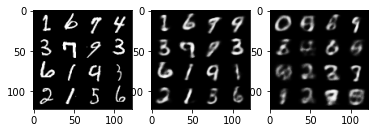

Iter: 09860/50000, Recon loss: 6426.6362, KL div loss: 1184.6704, Total loss: 7611.3066
Iter: 09870/50000, Recon loss: 7332.0898, KL div loss: 1188.9930, Total loss: 8521.0830
Iter: 09880/50000, Recon loss: 7248.4658, KL div loss: 1196.1467, Total loss: 8444.6123
Iter: 09890/50000, Recon loss: 7237.7188, KL div loss: 1217.0682, Total loss: 8454.7871
Iter: 09900/50000, Recon loss: 6675.9727, KL div loss: 1124.8458, Total loss: 7800.8184


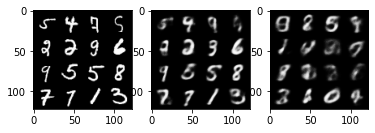

Iter: 09910/50000, Recon loss: 7303.6758, KL div loss: 1237.2097, Total loss: 8540.8857
Iter: 09920/50000, Recon loss: 7746.0903, KL div loss: 1213.1680, Total loss: 8959.2578
Iter: 09930/50000, Recon loss: 7606.1890, KL div loss: 1191.1062, Total loss: 8797.2949
Iter: 09940/50000, Recon loss: 7092.8506, KL div loss: 1223.8079, Total loss: 8316.6582
Iter: 09950/50000, Recon loss: 7159.1592, KL div loss: 1189.3579, Total loss: 8348.5176


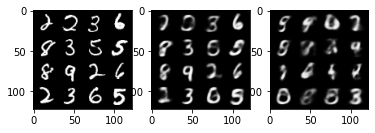

Iter: 09960/50000, Recon loss: 7048.3657, KL div loss: 1162.3730, Total loss: 8210.7383
Iter: 09970/50000, Recon loss: 7348.0166, KL div loss: 1206.0535, Total loss: 8554.0703
Iter: 09980/50000, Recon loss: 7466.5513, KL div loss: 1205.9888, Total loss: 8672.5400
Iter: 09990/50000, Recon loss: 7615.6504, KL div loss: 1182.8920, Total loss: 8798.5420
Iter: 10000/50000, Recon loss: 6929.2051, KL div loss: 1162.8000, Total loss: 8092.0049


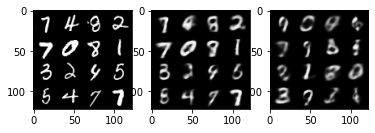

Iter: 10010/50000, Recon loss: 7235.5376, KL div loss: 1217.2793, Total loss: 8452.8164
Iter: 10020/50000, Recon loss: 7403.6113, KL div loss: 1200.2769, Total loss: 8603.8887
Iter: 10030/50000, Recon loss: 7059.4663, KL div loss: 1166.4988, Total loss: 8225.9648
Iter: 10040/50000, Recon loss: 7416.3438, KL div loss: 1140.3990, Total loss: 8556.7432
Iter: 10050/50000, Recon loss: 6814.4507, KL div loss: 1163.7500, Total loss: 7978.2007


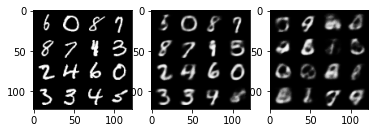

Iter: 10060/50000, Recon loss: 7351.6982, KL div loss: 1175.5842, Total loss: 8527.2822
Iter: 10070/50000, Recon loss: 7234.3613, KL div loss: 1184.9043, Total loss: 8419.2656
Iter: 10080/50000, Recon loss: 7128.3687, KL div loss: 1169.5552, Total loss: 8297.9238
Iter: 10090/50000, Recon loss: 6964.6050, KL div loss: 1194.6519, Total loss: 8159.2568
Iter: 10100/50000, Recon loss: 6365.0762, KL div loss: 1194.1268, Total loss: 7559.2031


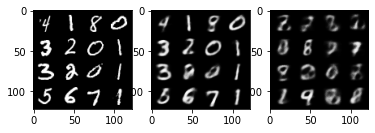

Iter: 10110/50000, Recon loss: 7191.6670, KL div loss: 1166.4326, Total loss: 8358.0996
Iter: 10120/50000, Recon loss: 7102.5498, KL div loss: 1197.0560, Total loss: 8299.6055
Iter: 10130/50000, Recon loss: 6858.5615, KL div loss: 1165.2914, Total loss: 8023.8530
Iter: 10140/50000, Recon loss: 7279.3281, KL div loss: 1216.5911, Total loss: 8495.9189
Iter: 10150/50000, Recon loss: 7103.2241, KL div loss: 1160.3391, Total loss: 8263.5635


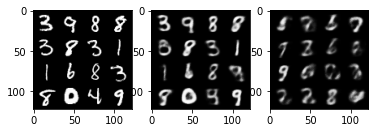

Iter: 10160/50000, Recon loss: 7307.1514, KL div loss: 1255.3418, Total loss: 8562.4932
Iter: 10170/50000, Recon loss: 6993.2295, KL div loss: 1197.1902, Total loss: 8190.4199
Iter: 10180/50000, Recon loss: 6762.5435, KL div loss: 1174.9885, Total loss: 7937.5322
Iter: 10190/50000, Recon loss: 7293.4614, KL div loss: 1210.8293, Total loss: 8504.2910
Iter: 10200/50000, Recon loss: 6809.8335, KL div loss: 1182.3320, Total loss: 7992.1655


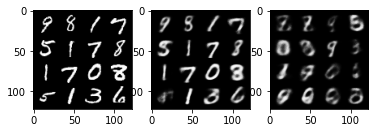

Iter: 10210/50000, Recon loss: 7499.1938, KL div loss: 1178.3372, Total loss: 8677.5312
Iter: 10220/50000, Recon loss: 6920.6572, KL div loss: 1117.3876, Total loss: 8038.0449
Iter: 10230/50000, Recon loss: 6781.8818, KL div loss: 1146.6887, Total loss: 7928.5703
Iter: 10240/50000, Recon loss: 7426.8711, KL div loss: 1208.0872, Total loss: 8634.9580
Iter: 10250/50000, Recon loss: 6735.0991, KL div loss: 1182.7795, Total loss: 7917.8789


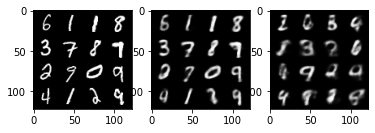

Iter: 10260/50000, Recon loss: 7247.2627, KL div loss: 1250.3733, Total loss: 8497.6357
Iter: 10270/50000, Recon loss: 7259.1377, KL div loss: 1205.7267, Total loss: 8464.8643
Iter: 10280/50000, Recon loss: 6825.5674, KL div loss: 1186.0425, Total loss: 8011.6099
Iter: 10290/50000, Recon loss: 6996.5229, KL div loss: 1192.1143, Total loss: 8188.6372
Iter: 10300/50000, Recon loss: 7124.9180, KL div loss: 1191.8953, Total loss: 8316.8135


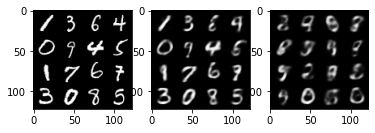

Iter: 10310/50000, Recon loss: 7034.6890, KL div loss: 1222.8394, Total loss: 8257.5283
Iter: 10320/50000, Recon loss: 6738.6514, KL div loss: 1132.6162, Total loss: 7871.2676
Iter: 10330/50000, Recon loss: 6993.3330, KL div loss: 1182.9900, Total loss: 8176.3232
Iter: 10340/50000, Recon loss: 7000.3252, KL div loss: 1216.5068, Total loss: 8216.8320
Iter: 10350/50000, Recon loss: 6994.9873, KL div loss: 1193.0054, Total loss: 8187.9927


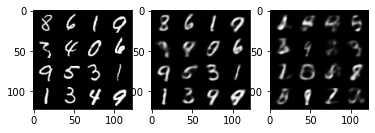

Iter: 10360/50000, Recon loss: 6955.2964, KL div loss: 1148.8491, Total loss: 8104.1455
Iter: 10370/50000, Recon loss: 7145.6338, KL div loss: 1217.3943, Total loss: 8363.0283
Iter: 10380/50000, Recon loss: 6911.2705, KL div loss: 1214.9847, Total loss: 8126.2554
Iter: 10390/50000, Recon loss: 6967.6538, KL div loss: 1185.4769, Total loss: 8153.1309
Iter: 10400/50000, Recon loss: 6700.9731, KL div loss: 1210.8689, Total loss: 7911.8418


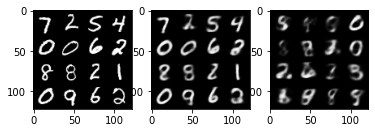

Iter: 10410/50000, Recon loss: 7330.0098, KL div loss: 1210.6194, Total loss: 8540.6289
Iter: 10420/50000, Recon loss: 6789.6396, KL div loss: 1208.9043, Total loss: 7998.5439
Iter: 10430/50000, Recon loss: 7089.7446, KL div loss: 1169.7363, Total loss: 8259.4805
Iter: 10440/50000, Recon loss: 6775.6333, KL div loss: 1204.0570, Total loss: 7979.6904
Iter: 10450/50000, Recon loss: 7270.9492, KL div loss: 1280.7759, Total loss: 8551.7246


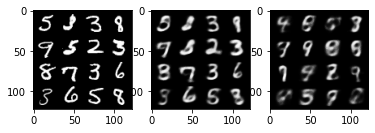

Iter: 10460/50000, Recon loss: 6999.2651, KL div loss: 1195.4039, Total loss: 8194.6689
Iter: 10470/50000, Recon loss: 6812.6187, KL div loss: 1228.5372, Total loss: 8041.1558
Iter: 10480/50000, Recon loss: 7414.6973, KL div loss: 1190.4674, Total loss: 8605.1650
Iter: 10490/50000, Recon loss: 6667.7627, KL div loss: 1173.9463, Total loss: 7841.7090
Iter: 10500/50000, Recon loss: 7353.1426, KL div loss: 1252.3057, Total loss: 8605.4482


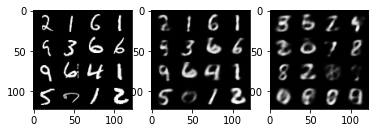

Iter: 10510/50000, Recon loss: 7290.1484, KL div loss: 1190.0243, Total loss: 8480.1729
Iter: 10520/50000, Recon loss: 7278.9385, KL div loss: 1202.4388, Total loss: 8481.3770
Iter: 10530/50000, Recon loss: 7184.5654, KL div loss: 1238.7461, Total loss: 8423.3115
Iter: 10540/50000, Recon loss: 6779.9473, KL div loss: 1134.4810, Total loss: 7914.4282
Iter: 10550/50000, Recon loss: 6720.1333, KL div loss: 1173.7725, Total loss: 7893.9058


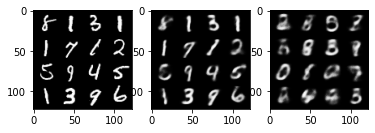

Iter: 10560/50000, Recon loss: 7184.8135, KL div loss: 1166.9963, Total loss: 8351.8096
Iter: 10570/50000, Recon loss: 6839.9648, KL div loss: 1185.2957, Total loss: 8025.2607
Iter: 10580/50000, Recon loss: 7021.1406, KL div loss: 1220.2794, Total loss: 8241.4199
Iter: 10590/50000, Recon loss: 7487.6079, KL div loss: 1223.6061, Total loss: 8711.2139
Iter: 10600/50000, Recon loss: 6917.5049, KL div loss: 1202.0898, Total loss: 8119.5947


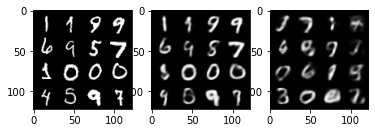

Iter: 10610/50000, Recon loss: 7458.5059, KL div loss: 1178.1241, Total loss: 8636.6299
Iter: 10620/50000, Recon loss: 7271.6104, KL div loss: 1170.1998, Total loss: 8441.8105
Iter: 10630/50000, Recon loss: 7127.6558, KL div loss: 1253.9355, Total loss: 8381.5918
Iter: 10640/50000, Recon loss: 6819.1597, KL div loss: 1229.6025, Total loss: 8048.7622
Iter: 10650/50000, Recon loss: 7375.9131, KL div loss: 1238.0784, Total loss: 8613.9912


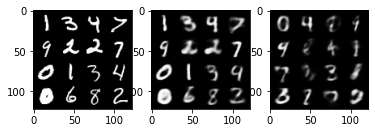

Iter: 10660/50000, Recon loss: 7407.5469, KL div loss: 1267.6841, Total loss: 8675.2305
Iter: 10670/50000, Recon loss: 6742.0112, KL div loss: 1184.0818, Total loss: 7926.0928
Iter: 10680/50000, Recon loss: 7212.1948, KL div loss: 1220.4310, Total loss: 8432.6260
Iter: 10690/50000, Recon loss: 7220.7100, KL div loss: 1194.7793, Total loss: 8415.4893
Iter: 10700/50000, Recon loss: 6651.4062, KL div loss: 1198.9481, Total loss: 7850.3545


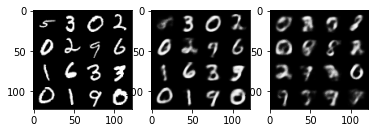

Iter: 10710/50000, Recon loss: 6689.5205, KL div loss: 1163.9310, Total loss: 7853.4517
Iter: 10720/50000, Recon loss: 6675.3179, KL div loss: 1262.9282, Total loss: 7938.2461
Iter: 10730/50000, Recon loss: 6794.7070, KL div loss: 1197.0884, Total loss: 7991.7954
Iter: 10740/50000, Recon loss: 7050.7915, KL div loss: 1243.9255, Total loss: 8294.7168
Iter: 10750/50000, Recon loss: 7037.2798, KL div loss: 1253.6836, Total loss: 8290.9629


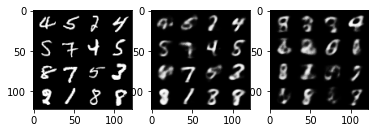

Iter: 10760/50000, Recon loss: 7109.9863, KL div loss: 1187.3695, Total loss: 8297.3555
Iter: 10770/50000, Recon loss: 6889.5684, KL div loss: 1184.0615, Total loss: 8073.6299
Iter: 10780/50000, Recon loss: 6790.4395, KL div loss: 1230.3788, Total loss: 8020.8184
Iter: 10790/50000, Recon loss: 6831.8740, KL div loss: 1178.3274, Total loss: 8010.2012
Iter: 10800/50000, Recon loss: 7065.5317, KL div loss: 1199.1506, Total loss: 8264.6826


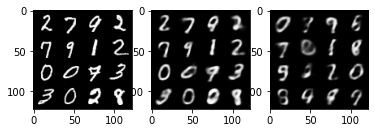

Iter: 10810/50000, Recon loss: 7037.0537, KL div loss: 1238.0753, Total loss: 8275.1289
Iter: 10820/50000, Recon loss: 6620.5312, KL div loss: 1219.1960, Total loss: 7839.7275
Iter: 10830/50000, Recon loss: 6599.9321, KL div loss: 1176.2185, Total loss: 7776.1504
Iter: 10840/50000, Recon loss: 7117.8203, KL div loss: 1216.8315, Total loss: 8334.6523
Iter: 10850/50000, Recon loss: 6891.8838, KL div loss: 1214.2999, Total loss: 8106.1836


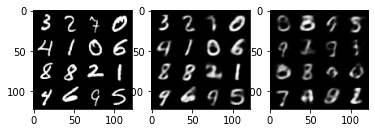

Iter: 10860/50000, Recon loss: 7306.3599, KL div loss: 1179.1117, Total loss: 8485.4717
Iter: 10870/50000, Recon loss: 7156.8018, KL div loss: 1194.6812, Total loss: 8351.4824
Iter: 10880/50000, Recon loss: 6994.4033, KL div loss: 1213.2771, Total loss: 8207.6807
Iter: 10890/50000, Recon loss: 6788.2651, KL div loss: 1231.9128, Total loss: 8020.1777
Iter: 10900/50000, Recon loss: 6907.0674, KL div loss: 1229.7148, Total loss: 8136.7822


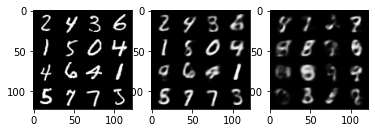

Iter: 10910/50000, Recon loss: 6528.2168, KL div loss: 1274.2531, Total loss: 7802.4697
Iter: 10920/50000, Recon loss: 7018.8140, KL div loss: 1206.8513, Total loss: 8225.6650
Iter: 10930/50000, Recon loss: 6951.8623, KL div loss: 1162.7158, Total loss: 8114.5781
Iter: 10940/50000, Recon loss: 6749.6582, KL div loss: 1164.7535, Total loss: 7914.4116
Iter: 10950/50000, Recon loss: 6360.3354, KL div loss: 1246.4702, Total loss: 7606.8057


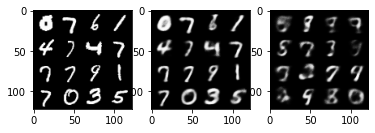

Iter: 10960/50000, Recon loss: 7334.0713, KL div loss: 1279.6086, Total loss: 8613.6797
Iter: 10970/50000, Recon loss: 6932.2334, KL div loss: 1178.4370, Total loss: 8110.6704
Iter: 10980/50000, Recon loss: 6847.0068, KL div loss: 1193.7402, Total loss: 8040.7471
Iter: 10990/50000, Recon loss: 6589.5991, KL div loss: 1217.4862, Total loss: 7807.0854
Iter: 11000/50000, Recon loss: 7183.2695, KL div loss: 1221.7744, Total loss: 8405.0439


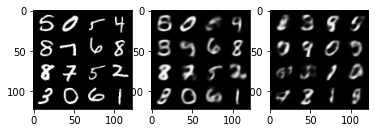

Iter: 11010/50000, Recon loss: 7324.1279, KL div loss: 1163.1956, Total loss: 8487.3232
Iter: 11020/50000, Recon loss: 6837.5664, KL div loss: 1227.4373, Total loss: 8065.0039
Iter: 11030/50000, Recon loss: 6899.2544, KL div loss: 1205.9375, Total loss: 8105.1919
Iter: 11040/50000, Recon loss: 6602.8730, KL div loss: 1221.5703, Total loss: 7824.4434
Iter: 11050/50000, Recon loss: 6942.9365, KL div loss: 1168.9465, Total loss: 8111.8828


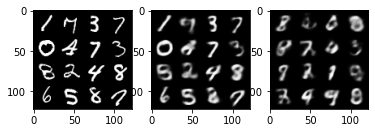

Iter: 11060/50000, Recon loss: 6360.6948, KL div loss: 1255.1080, Total loss: 7615.8027
Iter: 11070/50000, Recon loss: 6737.5288, KL div loss: 1230.7529, Total loss: 7968.2817
Iter: 11080/50000, Recon loss: 7241.6064, KL div loss: 1190.3905, Total loss: 8431.9971
Iter: 11090/50000, Recon loss: 6770.9150, KL div loss: 1203.7356, Total loss: 7974.6504
Iter: 11100/50000, Recon loss: 6762.6553, KL div loss: 1262.3541, Total loss: 8025.0093


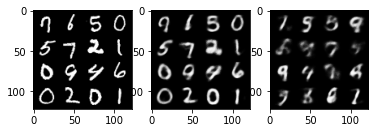

Iter: 11110/50000, Recon loss: 7265.2065, KL div loss: 1240.7947, Total loss: 8506.0010
Iter: 11120/50000, Recon loss: 6751.9150, KL div loss: 1163.1615, Total loss: 7915.0767
Iter: 11130/50000, Recon loss: 6726.4102, KL div loss: 1159.9158, Total loss: 7886.3262
Iter: 11140/50000, Recon loss: 6770.8105, KL div loss: 1247.1597, Total loss: 8017.9702
Iter: 11150/50000, Recon loss: 7055.5249, KL div loss: 1214.7013, Total loss: 8270.2266


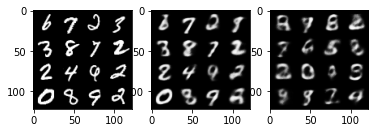

Iter: 11160/50000, Recon loss: 7275.0225, KL div loss: 1280.7688, Total loss: 8555.7910
Iter: 11170/50000, Recon loss: 6571.1855, KL div loss: 1205.3352, Total loss: 7776.5205
Iter: 11180/50000, Recon loss: 6916.1143, KL div loss: 1221.2480, Total loss: 8137.3623
Iter: 11190/50000, Recon loss: 7352.6006, KL div loss: 1255.2046, Total loss: 8607.8047
Iter: 11200/50000, Recon loss: 6894.5835, KL div loss: 1239.6855, Total loss: 8134.2690


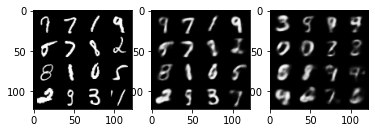

Iter: 11210/50000, Recon loss: 6566.6514, KL div loss: 1187.6755, Total loss: 7754.3271
Iter: 11220/50000, Recon loss: 6828.3940, KL div loss: 1259.9159, Total loss: 8088.3101
Iter: 11230/50000, Recon loss: 6630.8213, KL div loss: 1154.4296, Total loss: 7785.2510
Iter: 11240/50000, Recon loss: 7250.0654, KL div loss: 1202.3220, Total loss: 8452.3877
Iter: 11250/50000, Recon loss: 6720.7568, KL div loss: 1256.8923, Total loss: 7977.6494


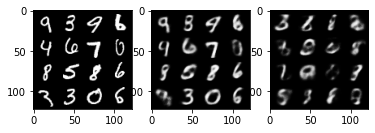

Iter: 11260/50000, Recon loss: 6762.9941, KL div loss: 1199.4948, Total loss: 7962.4888
Iter: 11270/50000, Recon loss: 7050.4517, KL div loss: 1167.7720, Total loss: 8218.2236
Iter: 11280/50000, Recon loss: 6360.6436, KL div loss: 1225.6313, Total loss: 7586.2749
Iter: 11290/50000, Recon loss: 6958.0239, KL div loss: 1204.1387, Total loss: 8162.1626
Iter: 11300/50000, Recon loss: 6479.0815, KL div loss: 1172.0723, Total loss: 7651.1538


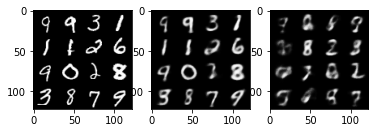

Iter: 11310/50000, Recon loss: 6542.8359, KL div loss: 1174.1083, Total loss: 7716.9443
Iter: 11320/50000, Recon loss: 6811.7710, KL div loss: 1201.6208, Total loss: 8013.3916
Iter: 11330/50000, Recon loss: 6792.9678, KL div loss: 1254.3907, Total loss: 8047.3584
Iter: 11340/50000, Recon loss: 7578.2271, KL div loss: 1229.8677, Total loss: 8808.0947
Iter: 11350/50000, Recon loss: 6577.9775, KL div loss: 1254.1737, Total loss: 7832.1514


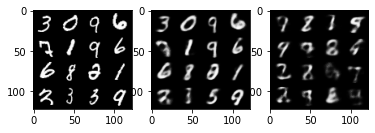

Iter: 11360/50000, Recon loss: 7171.7109, KL div loss: 1241.2212, Total loss: 8412.9316
Iter: 11370/50000, Recon loss: 7044.0508, KL div loss: 1197.7599, Total loss: 8241.8105
Iter: 11380/50000, Recon loss: 7287.3896, KL div loss: 1224.1550, Total loss: 8511.5449
Iter: 11390/50000, Recon loss: 7153.6426, KL div loss: 1211.6809, Total loss: 8365.3232
Iter: 11400/50000, Recon loss: 6657.1079, KL div loss: 1235.6364, Total loss: 7892.7441


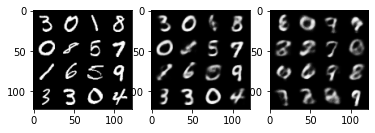

Iter: 11410/50000, Recon loss: 7119.0244, KL div loss: 1228.8074, Total loss: 8347.8320
Iter: 11420/50000, Recon loss: 6317.4922, KL div loss: 1246.0186, Total loss: 7563.5107
Iter: 11430/50000, Recon loss: 6718.1260, KL div loss: 1227.5698, Total loss: 7945.6958
Iter: 11440/50000, Recon loss: 6999.7690, KL div loss: 1224.8291, Total loss: 8224.5977
Iter: 11450/50000, Recon loss: 6644.0645, KL div loss: 1173.1964, Total loss: 7817.2607


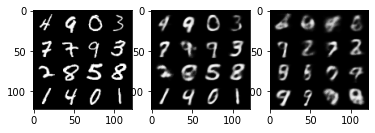

Iter: 11460/50000, Recon loss: 6911.7266, KL div loss: 1232.9838, Total loss: 8144.7104
Iter: 11470/50000, Recon loss: 6989.8828, KL div loss: 1227.6907, Total loss: 8217.5732
Iter: 11480/50000, Recon loss: 7154.5361, KL div loss: 1217.5112, Total loss: 8372.0469
Iter: 11490/50000, Recon loss: 6524.3750, KL div loss: 1207.5984, Total loss: 7731.9736
Iter: 11500/50000, Recon loss: 6870.2773, KL div loss: 1197.3326, Total loss: 8067.6099


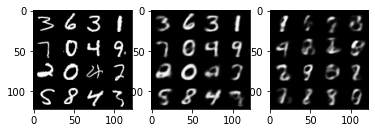

Iter: 11510/50000, Recon loss: 6527.9629, KL div loss: 1194.4016, Total loss: 7722.3643
Iter: 11520/50000, Recon loss: 6423.4990, KL div loss: 1195.7318, Total loss: 7619.2310
Iter: 11530/50000, Recon loss: 6635.7490, KL div loss: 1228.2349, Total loss: 7863.9839
Iter: 11540/50000, Recon loss: 7068.9854, KL div loss: 1213.1589, Total loss: 8282.1445
Iter: 11550/50000, Recon loss: 6724.8784, KL div loss: 1222.0929, Total loss: 7946.9712


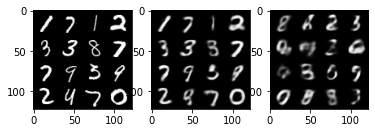

Iter: 11560/50000, Recon loss: 6429.0923, KL div loss: 1176.5498, Total loss: 7605.6421
Iter: 11570/50000, Recon loss: 6409.4585, KL div loss: 1233.9634, Total loss: 7643.4219
Iter: 11580/50000, Recon loss: 6435.1074, KL div loss: 1186.1829, Total loss: 7621.2900
Iter: 11590/50000, Recon loss: 6981.4199, KL div loss: 1184.9778, Total loss: 8166.3975
Iter: 11600/50000, Recon loss: 6766.7446, KL div loss: 1230.8116, Total loss: 7997.5562


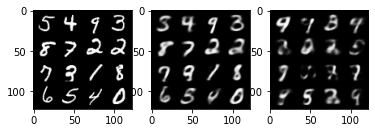

Iter: 11610/50000, Recon loss: 6990.5742, KL div loss: 1209.2000, Total loss: 8199.7744
Iter: 11620/50000, Recon loss: 7249.5254, KL div loss: 1259.4531, Total loss: 8508.9785
Iter: 11630/50000, Recon loss: 6309.4453, KL div loss: 1211.1272, Total loss: 7520.5723
Iter: 11640/50000, Recon loss: 6597.9624, KL div loss: 1248.7327, Total loss: 7846.6953
Iter: 11650/50000, Recon loss: 7060.7686, KL div loss: 1199.7065, Total loss: 8260.4746


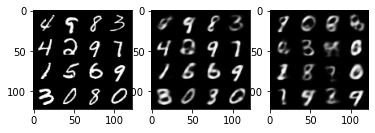

Iter: 11660/50000, Recon loss: 6852.4668, KL div loss: 1234.7668, Total loss: 8087.2334
Iter: 11670/50000, Recon loss: 6719.7686, KL div loss: 1234.9911, Total loss: 7954.7598
Iter: 11680/50000, Recon loss: 6753.4883, KL div loss: 1255.0883, Total loss: 8008.5767
Iter: 11690/50000, Recon loss: 6713.2559, KL div loss: 1229.9473, Total loss: 7943.2031
Iter: 11700/50000, Recon loss: 6431.8633, KL div loss: 1195.0972, Total loss: 7626.9604


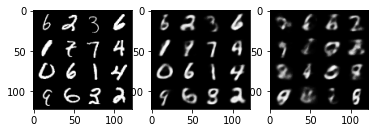

Iter: 11710/50000, Recon loss: 6882.0869, KL div loss: 1263.0411, Total loss: 8145.1279
Iter: 11720/50000, Recon loss: 6639.1963, KL div loss: 1199.9094, Total loss: 7839.1055
Iter: 11730/50000, Recon loss: 7033.0117, KL div loss: 1248.6298, Total loss: 8281.6416
Iter: 11740/50000, Recon loss: 6584.3862, KL div loss: 1197.6920, Total loss: 7782.0781
Iter: 11750/50000, Recon loss: 6876.5664, KL div loss: 1215.3831, Total loss: 8091.9492


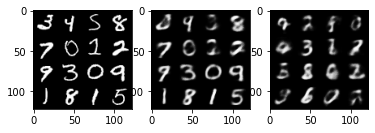

Iter: 11760/50000, Recon loss: 7041.1250, KL div loss: 1242.3708, Total loss: 8283.4961
Iter: 11770/50000, Recon loss: 6925.3608, KL div loss: 1195.1873, Total loss: 8120.5479
Iter: 11780/50000, Recon loss: 7143.9009, KL div loss: 1245.9083, Total loss: 8389.8096
Iter: 11790/50000, Recon loss: 6633.7446, KL div loss: 1134.5626, Total loss: 7768.3071
Iter: 11800/50000, Recon loss: 7257.9106, KL div loss: 1248.8553, Total loss: 8506.7656


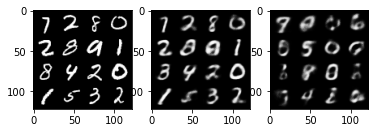

Iter: 11810/50000, Recon loss: 6650.2129, KL div loss: 1242.3420, Total loss: 7892.5547
Iter: 11820/50000, Recon loss: 6708.0488, KL div loss: 1181.5670, Total loss: 7889.6157
Iter: 11830/50000, Recon loss: 6404.8511, KL div loss: 1187.1522, Total loss: 7592.0034
Iter: 11840/50000, Recon loss: 6592.8926, KL div loss: 1186.4531, Total loss: 7779.3457
Iter: 11850/50000, Recon loss: 6805.0068, KL div loss: 1179.7256, Total loss: 7984.7324


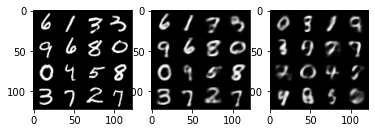

Iter: 11860/50000, Recon loss: 6478.1143, KL div loss: 1221.5283, Total loss: 7699.6426
Iter: 11870/50000, Recon loss: 6484.3794, KL div loss: 1197.3063, Total loss: 7681.6855
Iter: 11880/50000, Recon loss: 6848.6626, KL div loss: 1212.9985, Total loss: 8061.6611
Iter: 11890/50000, Recon loss: 6603.1196, KL div loss: 1202.3597, Total loss: 7805.4795
Iter: 11900/50000, Recon loss: 6702.9316, KL div loss: 1187.7252, Total loss: 7890.6567


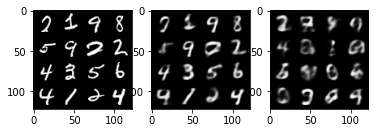

Iter: 11910/50000, Recon loss: 7168.1279, KL div loss: 1191.3857, Total loss: 8359.5137
Iter: 11920/50000, Recon loss: 6642.6953, KL div loss: 1252.5740, Total loss: 7895.2695
Iter: 11930/50000, Recon loss: 6571.7627, KL div loss: 1277.7173, Total loss: 7849.4800
Iter: 11940/50000, Recon loss: 6520.9629, KL div loss: 1225.2747, Total loss: 7746.2373
Iter: 11950/50000, Recon loss: 7175.8164, KL div loss: 1217.9580, Total loss: 8393.7744


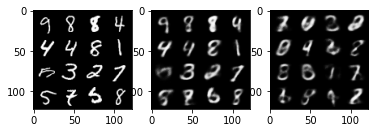

Iter: 11960/50000, Recon loss: 7314.7568, KL div loss: 1259.6180, Total loss: 8574.3750
Iter: 11970/50000, Recon loss: 7153.8472, KL div loss: 1234.4163, Total loss: 8388.2637
Iter: 11980/50000, Recon loss: 7041.1943, KL div loss: 1281.5546, Total loss: 8322.7490
Iter: 11990/50000, Recon loss: 6924.3203, KL div loss: 1222.4600, Total loss: 8146.7803
Iter: 12000/50000, Recon loss: 6553.2939, KL div loss: 1214.9467, Total loss: 7768.2407


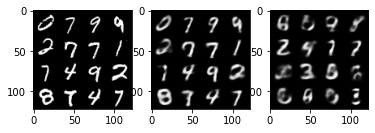

Iter: 12010/50000, Recon loss: 6928.5391, KL div loss: 1187.1552, Total loss: 8115.6943
Iter: 12020/50000, Recon loss: 7217.5127, KL div loss: 1236.4709, Total loss: 8453.9834
Iter: 12030/50000, Recon loss: 6640.1489, KL div loss: 1196.6101, Total loss: 7836.7588
Iter: 12040/50000, Recon loss: 6572.3486, KL div loss: 1168.5208, Total loss: 7740.8691
Iter: 12050/50000, Recon loss: 6421.2822, KL div loss: 1224.5037, Total loss: 7645.7861


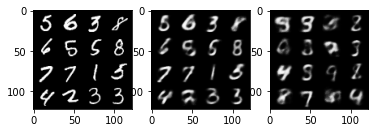

Iter: 12060/50000, Recon loss: 6952.2910, KL div loss: 1273.1027, Total loss: 8225.3936
Iter: 12070/50000, Recon loss: 6234.7798, KL div loss: 1154.7133, Total loss: 7389.4932
Iter: 12080/50000, Recon loss: 6358.1553, KL div loss: 1216.4572, Total loss: 7574.6123
Iter: 12090/50000, Recon loss: 7098.4927, KL div loss: 1234.1716, Total loss: 8332.6641
Iter: 12100/50000, Recon loss: 6877.3882, KL div loss: 1228.2195, Total loss: 8105.6074


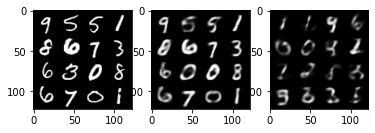

Iter: 12110/50000, Recon loss: 6256.9575, KL div loss: 1201.2666, Total loss: 7458.2241
Iter: 12120/50000, Recon loss: 6847.3027, KL div loss: 1259.5171, Total loss: 8106.8198
Iter: 12130/50000, Recon loss: 7035.5581, KL div loss: 1256.7429, Total loss: 8292.3008
Iter: 12140/50000, Recon loss: 6975.2041, KL div loss: 1218.8555, Total loss: 8194.0596
Iter: 12150/50000, Recon loss: 6555.3584, KL div loss: 1211.3716, Total loss: 7766.7300


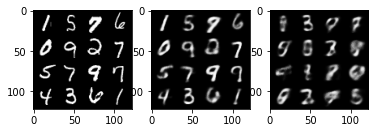

Iter: 12160/50000, Recon loss: 6583.6768, KL div loss: 1160.1333, Total loss: 7743.8101
Iter: 12170/50000, Recon loss: 6217.3511, KL div loss: 1200.8445, Total loss: 7418.1953
Iter: 12180/50000, Recon loss: 6428.0713, KL div loss: 1242.6233, Total loss: 7670.6943
Iter: 12190/50000, Recon loss: 6493.7173, KL div loss: 1168.0811, Total loss: 7661.7983
Iter: 12200/50000, Recon loss: 7093.6699, KL div loss: 1298.6217, Total loss: 8392.2920


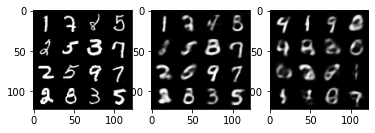

Iter: 12210/50000, Recon loss: 6523.6865, KL div loss: 1218.4678, Total loss: 7742.1543
Iter: 12220/50000, Recon loss: 7066.5039, KL div loss: 1217.1409, Total loss: 8283.6445
Iter: 12230/50000, Recon loss: 6503.6187, KL div loss: 1209.0081, Total loss: 7712.6270
Iter: 12240/50000, Recon loss: 6967.4004, KL div loss: 1237.9619, Total loss: 8205.3623
Iter: 12250/50000, Recon loss: 6665.7441, KL div loss: 1255.2185, Total loss: 7920.9629


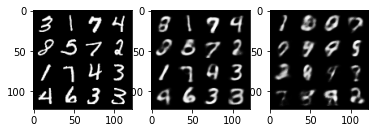

Iter: 12260/50000, Recon loss: 6670.1597, KL div loss: 1252.3783, Total loss: 7922.5381
Iter: 12270/50000, Recon loss: 6560.4766, KL div loss: 1234.1531, Total loss: 7794.6299
Iter: 12280/50000, Recon loss: 6471.5381, KL div loss: 1202.1465, Total loss: 7673.6846
Iter: 12290/50000, Recon loss: 6437.3545, KL div loss: 1188.6592, Total loss: 7626.0137
Iter: 12300/50000, Recon loss: 7029.2012, KL div loss: 1264.5698, Total loss: 8293.7715


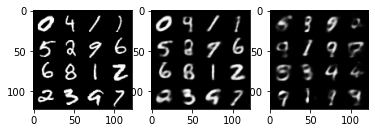

Iter: 12310/50000, Recon loss: 6975.2822, KL div loss: 1206.5256, Total loss: 8181.8076
Iter: 12320/50000, Recon loss: 6751.1689, KL div loss: 1243.2750, Total loss: 7994.4438
Iter: 12330/50000, Recon loss: 6587.9878, KL div loss: 1223.0786, Total loss: 7811.0664
Iter: 12340/50000, Recon loss: 6558.3730, KL div loss: 1183.5287, Total loss: 7741.9019
Iter: 12350/50000, Recon loss: 6759.8848, KL div loss: 1286.3318, Total loss: 8046.2168


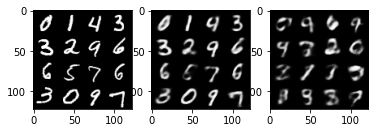

Iter: 12360/50000, Recon loss: 6991.6416, KL div loss: 1160.4772, Total loss: 8152.1187
Iter: 12370/50000, Recon loss: 6452.4600, KL div loss: 1182.4683, Total loss: 7634.9282
Iter: 12380/50000, Recon loss: 6759.3877, KL div loss: 1189.9695, Total loss: 7949.3574
Iter: 12390/50000, Recon loss: 6616.1650, KL div loss: 1263.3198, Total loss: 7879.4849
Iter: 12400/50000, Recon loss: 6805.3765, KL div loss: 1278.7914, Total loss: 8084.1680


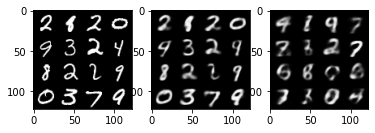

Iter: 12410/50000, Recon loss: 6610.7524, KL div loss: 1209.2263, Total loss: 7819.9785
Iter: 12420/50000, Recon loss: 7085.0967, KL div loss: 1268.7249, Total loss: 8353.8213
Iter: 12430/50000, Recon loss: 6842.8701, KL div loss: 1256.2179, Total loss: 8099.0879
Iter: 12440/50000, Recon loss: 6415.0898, KL div loss: 1222.0292, Total loss: 7637.1191
Iter: 12450/50000, Recon loss: 7062.2129, KL div loss: 1253.5540, Total loss: 8315.7666


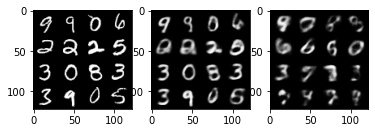

Iter: 12460/50000, Recon loss: 6137.5493, KL div loss: 1188.1685, Total loss: 7325.7178
Iter: 12470/50000, Recon loss: 7075.3359, KL div loss: 1227.1414, Total loss: 8302.4775
Iter: 12480/50000, Recon loss: 6533.6904, KL div loss: 1165.4237, Total loss: 7699.1143
Iter: 12490/50000, Recon loss: 6457.8818, KL div loss: 1204.8850, Total loss: 7662.7666
Iter: 12500/50000, Recon loss: 7047.1226, KL div loss: 1246.7102, Total loss: 8293.8330


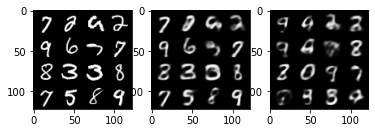

Iter: 12510/50000, Recon loss: 6684.4507, KL div loss: 1231.9408, Total loss: 7916.3916
Iter: 12520/50000, Recon loss: 6766.2222, KL div loss: 1265.8170, Total loss: 8032.0391
Iter: 12530/50000, Recon loss: 6199.2979, KL div loss: 1178.4600, Total loss: 7377.7578
Iter: 12540/50000, Recon loss: 6584.3262, KL div loss: 1224.4999, Total loss: 7808.8262
Iter: 12550/50000, Recon loss: 6879.6816, KL div loss: 1263.3225, Total loss: 8143.0039


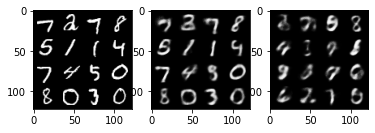

Iter: 12560/50000, Recon loss: 6250.5703, KL div loss: 1187.0731, Total loss: 7437.6436
Iter: 12570/50000, Recon loss: 6843.0889, KL div loss: 1215.1549, Total loss: 8058.2437
Iter: 12580/50000, Recon loss: 6700.0337, KL div loss: 1187.5536, Total loss: 7887.5874
Iter: 12590/50000, Recon loss: 6927.4199, KL div loss: 1265.8538, Total loss: 8193.2734
Iter: 12600/50000, Recon loss: 6713.9932, KL div loss: 1228.2522, Total loss: 7942.2451


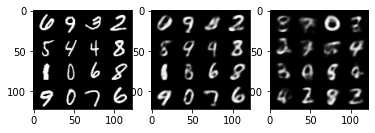

Iter: 12610/50000, Recon loss: 6555.2070, KL div loss: 1230.0934, Total loss: 7785.3003
Iter: 12620/50000, Recon loss: 6434.9121, KL div loss: 1175.9973, Total loss: 7610.9092
Iter: 12630/50000, Recon loss: 6460.8560, KL div loss: 1173.3969, Total loss: 7634.2529
Iter: 12640/50000, Recon loss: 6411.4951, KL div loss: 1234.3542, Total loss: 7645.8496
Iter: 12650/50000, Recon loss: 6921.1680, KL div loss: 1239.1624, Total loss: 8160.3301


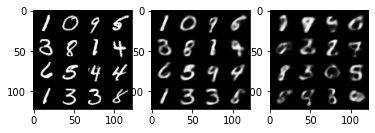

Iter: 12660/50000, Recon loss: 6485.8271, KL div loss: 1176.5823, Total loss: 7662.4092
Iter: 12670/50000, Recon loss: 6235.6514, KL div loss: 1148.8430, Total loss: 7384.4941
Iter: 12680/50000, Recon loss: 7085.1313, KL div loss: 1233.6630, Total loss: 8318.7939
Iter: 12690/50000, Recon loss: 6797.3467, KL div loss: 1228.4709, Total loss: 8025.8174
Iter: 12700/50000, Recon loss: 6359.1152, KL div loss: 1166.4434, Total loss: 7525.5586


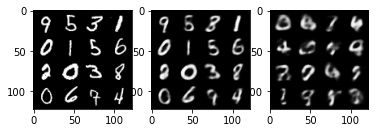

Iter: 12710/50000, Recon loss: 7022.2744, KL div loss: 1206.7057, Total loss: 8228.9805
Iter: 12720/50000, Recon loss: 6551.4814, KL div loss: 1269.2980, Total loss: 7820.7793
Iter: 12730/50000, Recon loss: 6694.5146, KL div loss: 1222.4121, Total loss: 7916.9268
Iter: 12740/50000, Recon loss: 6556.4473, KL div loss: 1268.8538, Total loss: 7825.3008
Iter: 12750/50000, Recon loss: 6559.4365, KL div loss: 1204.7358, Total loss: 7764.1724


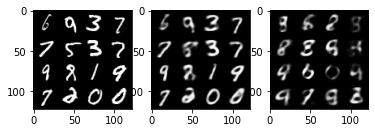

Iter: 12760/50000, Recon loss: 6375.8574, KL div loss: 1195.5836, Total loss: 7571.4409
Iter: 12770/50000, Recon loss: 6357.5840, KL div loss: 1202.3132, Total loss: 7559.8975
Iter: 12780/50000, Recon loss: 6487.3740, KL div loss: 1220.9666, Total loss: 7708.3408
Iter: 12790/50000, Recon loss: 7077.3789, KL div loss: 1211.6382, Total loss: 8289.0176
Iter: 12800/50000, Recon loss: 6552.8687, KL div loss: 1203.1772, Total loss: 7756.0459


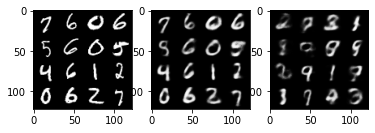

Iter: 12810/50000, Recon loss: 6727.9971, KL div loss: 1173.5842, Total loss: 7901.5811
Iter: 12820/50000, Recon loss: 6803.5483, KL div loss: 1267.9337, Total loss: 8071.4819
Iter: 12830/50000, Recon loss: 6673.0342, KL div loss: 1224.1215, Total loss: 7897.1558
Iter: 12840/50000, Recon loss: 6713.7803, KL div loss: 1219.1570, Total loss: 7932.9375
Iter: 12850/50000, Recon loss: 6529.0137, KL div loss: 1234.0219, Total loss: 7763.0356


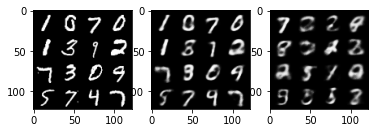

Iter: 12860/50000, Recon loss: 6433.6006, KL div loss: 1182.5698, Total loss: 7616.1704
Iter: 12870/50000, Recon loss: 6521.6147, KL div loss: 1247.3557, Total loss: 7768.9707
Iter: 12880/50000, Recon loss: 6670.3193, KL div loss: 1250.6533, Total loss: 7920.9727
Iter: 12890/50000, Recon loss: 6484.1182, KL div loss: 1244.8622, Total loss: 7728.9805
Iter: 12900/50000, Recon loss: 6597.3340, KL div loss: 1222.1041, Total loss: 7819.4380


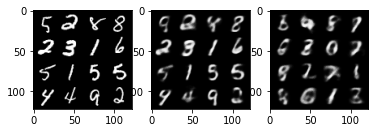

Iter: 12910/50000, Recon loss: 6378.5713, KL div loss: 1239.0339, Total loss: 7617.6055
Iter: 12920/50000, Recon loss: 6990.5645, KL div loss: 1275.3250, Total loss: 8265.8896
Iter: 12930/50000, Recon loss: 6248.9766, KL div loss: 1188.1422, Total loss: 7437.1187
Iter: 12940/50000, Recon loss: 6640.6143, KL div loss: 1265.0461, Total loss: 7905.6602
Iter: 12950/50000, Recon loss: 6608.0752, KL div loss: 1261.1819, Total loss: 7869.2568


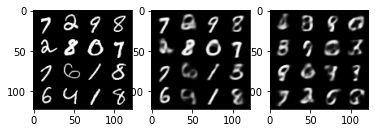

Iter: 12960/50000, Recon loss: 6952.8213, KL div loss: 1231.3667, Total loss: 8184.1880
Iter: 12970/50000, Recon loss: 6722.1338, KL div loss: 1260.0201, Total loss: 7982.1538
Iter: 12980/50000, Recon loss: 6810.2842, KL div loss: 1188.1702, Total loss: 7998.4541
Iter: 12990/50000, Recon loss: 6692.0264, KL div loss: 1196.1079, Total loss: 7888.1343
Iter: 13000/50000, Recon loss: 6810.1265, KL div loss: 1198.8401, Total loss: 8008.9668


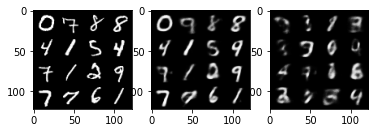

Iter: 13010/50000, Recon loss: 6787.0391, KL div loss: 1209.2595, Total loss: 7996.2988
Iter: 13020/50000, Recon loss: 6951.5708, KL div loss: 1242.1414, Total loss: 8193.7119
Iter: 13030/50000, Recon loss: 6657.3721, KL div loss: 1160.0652, Total loss: 7817.4375
Iter: 13040/50000, Recon loss: 6572.6836, KL div loss: 1143.5598, Total loss: 7716.2432
Iter: 13050/50000, Recon loss: 6340.4033, KL div loss: 1246.0310, Total loss: 7586.4346


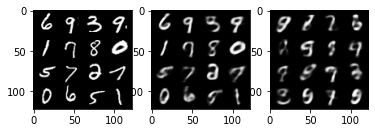

Iter: 13060/50000, Recon loss: 6876.0703, KL div loss: 1226.2771, Total loss: 8102.3477
Iter: 13070/50000, Recon loss: 6530.9258, KL div loss: 1231.7759, Total loss: 7762.7017
Iter: 13080/50000, Recon loss: 6980.4360, KL div loss: 1232.5460, Total loss: 8212.9824
Iter: 13090/50000, Recon loss: 6519.1743, KL div loss: 1239.0721, Total loss: 7758.2466
Iter: 13100/50000, Recon loss: 6858.9092, KL div loss: 1240.3594, Total loss: 8099.2686


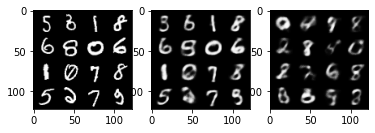

Iter: 13110/50000, Recon loss: 6846.0742, KL div loss: 1254.7200, Total loss: 8100.7939
Iter: 13120/50000, Recon loss: 6527.0532, KL div loss: 1216.1038, Total loss: 7743.1572
Iter: 13130/50000, Recon loss: 6584.5767, KL div loss: 1202.9089, Total loss: 7787.4854
Iter: 13140/50000, Recon loss: 6614.1895, KL div loss: 1221.9102, Total loss: 7836.0996
Iter: 13150/50000, Recon loss: 6343.0928, KL div loss: 1228.0383, Total loss: 7571.1309


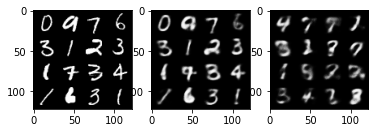

Iter: 13160/50000, Recon loss: 6940.1865, KL div loss: 1242.9941, Total loss: 8183.1807
Iter: 13170/50000, Recon loss: 5978.4639, KL div loss: 1236.1577, Total loss: 7214.6216
Iter: 13180/50000, Recon loss: 6854.5083, KL div loss: 1206.4272, Total loss: 8060.9355
Iter: 13190/50000, Recon loss: 6562.1855, KL div loss: 1270.5869, Total loss: 7832.7725
Iter: 13200/50000, Recon loss: 6919.7695, KL div loss: 1200.7812, Total loss: 8120.5508


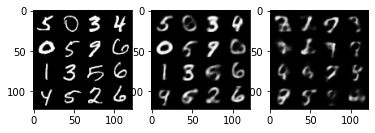

Iter: 13210/50000, Recon loss: 6471.2104, KL div loss: 1233.3734, Total loss: 7704.5840
Iter: 13220/50000, Recon loss: 6437.4082, KL div loss: 1243.6748, Total loss: 7681.0830
Iter: 13230/50000, Recon loss: 6710.0430, KL div loss: 1212.2263, Total loss: 7922.2695
Iter: 13240/50000, Recon loss: 6731.2715, KL div loss: 1244.8999, Total loss: 7976.1714
Iter: 13250/50000, Recon loss: 6574.8325, KL div loss: 1271.3875, Total loss: 7846.2197


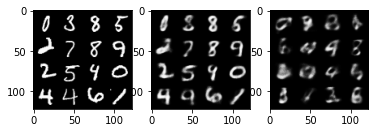

Iter: 13260/50000, Recon loss: 6687.2334, KL div loss: 1272.4824, Total loss: 7959.7158
Iter: 13270/50000, Recon loss: 6662.9102, KL div loss: 1271.4016, Total loss: 7934.3115
Iter: 13280/50000, Recon loss: 6281.1758, KL div loss: 1242.9199, Total loss: 7524.0957
Iter: 13290/50000, Recon loss: 6842.2319, KL div loss: 1220.0498, Total loss: 8062.2817
Iter: 13300/50000, Recon loss: 6069.4229, KL div loss: 1221.2264, Total loss: 7290.6494


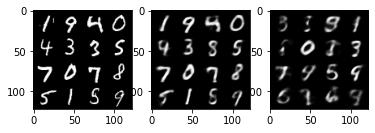

Iter: 13310/50000, Recon loss: 6610.6768, KL div loss: 1268.0795, Total loss: 7878.7563
Iter: 13320/50000, Recon loss: 6231.3711, KL div loss: 1238.3611, Total loss: 7469.7324
Iter: 13330/50000, Recon loss: 6588.5728, KL div loss: 1242.3762, Total loss: 7830.9492
Iter: 13340/50000, Recon loss: 6501.9971, KL div loss: 1202.1450, Total loss: 7704.1421
Iter: 13350/50000, Recon loss: 6932.3574, KL div loss: 1256.2712, Total loss: 8188.6289


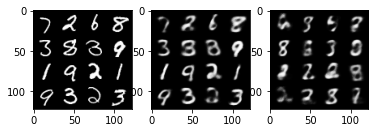

Iter: 13360/50000, Recon loss: 6773.1025, KL div loss: 1247.5964, Total loss: 8020.6992
Iter: 13370/50000, Recon loss: 6570.2178, KL div loss: 1225.5752, Total loss: 7795.7930
Iter: 13380/50000, Recon loss: 6740.1211, KL div loss: 1210.6501, Total loss: 7950.7715
Iter: 13390/50000, Recon loss: 6797.5674, KL div loss: 1283.6169, Total loss: 8081.1846
Iter: 13400/50000, Recon loss: 6744.9653, KL div loss: 1231.7587, Total loss: 7976.7241


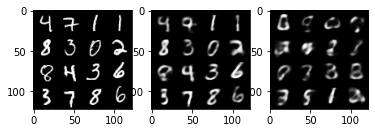

Iter: 13410/50000, Recon loss: 6547.8945, KL div loss: 1239.4387, Total loss: 7787.3330
Iter: 13420/50000, Recon loss: 6812.9297, KL div loss: 1235.7690, Total loss: 8048.6987
Iter: 13430/50000, Recon loss: 6405.9043, KL div loss: 1219.7366, Total loss: 7625.6406
Iter: 13440/50000, Recon loss: 6687.7705, KL div loss: 1194.3315, Total loss: 7882.1021
Iter: 13450/50000, Recon loss: 6611.4092, KL div loss: 1236.2295, Total loss: 7847.6387


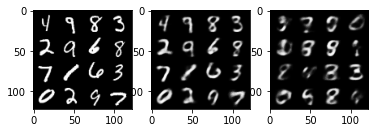

Iter: 13460/50000, Recon loss: 6946.5430, KL div loss: 1242.9792, Total loss: 8189.5225
Iter: 13470/50000, Recon loss: 6143.8057, KL div loss: 1228.4041, Total loss: 7372.2100
Iter: 13480/50000, Recon loss: 6721.7002, KL div loss: 1229.7726, Total loss: 7951.4727
Iter: 13490/50000, Recon loss: 6226.1777, KL div loss: 1204.2996, Total loss: 7430.4775
Iter: 13500/50000, Recon loss: 6550.4727, KL div loss: 1218.8591, Total loss: 7769.3320


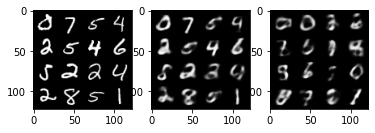

Iter: 13510/50000, Recon loss: 6582.2227, KL div loss: 1262.6245, Total loss: 7844.8472
Iter: 13520/50000, Recon loss: 6607.8618, KL div loss: 1172.6077, Total loss: 7780.4697
Iter: 13530/50000, Recon loss: 6529.6592, KL div loss: 1182.2876, Total loss: 7711.9468
Iter: 13540/50000, Recon loss: 6419.6406, KL div loss: 1209.4022, Total loss: 7629.0430
Iter: 13550/50000, Recon loss: 6777.9658, KL div loss: 1219.3191, Total loss: 7997.2852


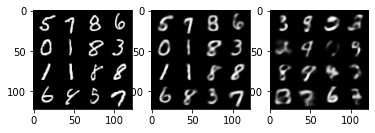

Iter: 13560/50000, Recon loss: 6474.0186, KL div loss: 1239.5291, Total loss: 7713.5479
Iter: 13570/50000, Recon loss: 6977.0840, KL div loss: 1272.8873, Total loss: 8249.9717
Iter: 13580/50000, Recon loss: 6324.5547, KL div loss: 1259.4656, Total loss: 7584.0205
Iter: 13590/50000, Recon loss: 6714.8779, KL div loss: 1213.6221, Total loss: 7928.5000
Iter: 13600/50000, Recon loss: 7150.6489, KL div loss: 1214.1626, Total loss: 8364.8115


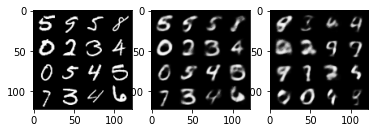

Iter: 13610/50000, Recon loss: 6369.1255, KL div loss: 1236.9598, Total loss: 7606.0854
Iter: 13620/50000, Recon loss: 6565.9473, KL div loss: 1234.0332, Total loss: 7799.9805
Iter: 13630/50000, Recon loss: 6728.7695, KL div loss: 1236.6230, Total loss: 7965.3926
Iter: 13640/50000, Recon loss: 6581.8198, KL div loss: 1260.3431, Total loss: 7842.1631
Iter: 13650/50000, Recon loss: 6252.4390, KL div loss: 1255.1597, Total loss: 7507.5986


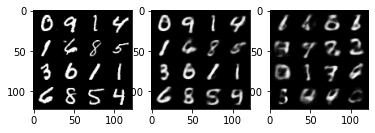

Iter: 13660/50000, Recon loss: 6286.9365, KL div loss: 1208.2936, Total loss: 7495.2300
Iter: 13670/50000, Recon loss: 6689.2900, KL div loss: 1194.3672, Total loss: 7883.6572
Iter: 13680/50000, Recon loss: 6821.4146, KL div loss: 1193.1970, Total loss: 8014.6113
Iter: 13690/50000, Recon loss: 6213.5601, KL div loss: 1250.0779, Total loss: 7463.6377
Iter: 13700/50000, Recon loss: 6324.8999, KL div loss: 1219.2047, Total loss: 7544.1045


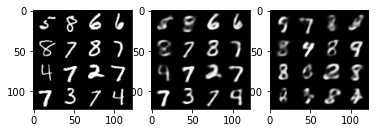

Iter: 13710/50000, Recon loss: 6179.9282, KL div loss: 1214.6189, Total loss: 7394.5469
Iter: 13720/50000, Recon loss: 6437.2373, KL div loss: 1200.7390, Total loss: 7637.9766
Iter: 13730/50000, Recon loss: 6319.1846, KL div loss: 1219.5797, Total loss: 7538.7642
Iter: 13740/50000, Recon loss: 6706.8032, KL div loss: 1283.0220, Total loss: 7989.8252
Iter: 13750/50000, Recon loss: 7136.3823, KL div loss: 1280.1721, Total loss: 8416.5547


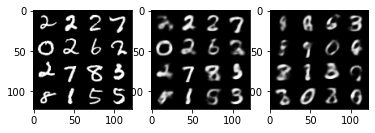

Iter: 13760/50000, Recon loss: 6797.3848, KL div loss: 1252.8816, Total loss: 8050.2666
Iter: 13770/50000, Recon loss: 6646.1582, KL div loss: 1240.6682, Total loss: 7886.8262
Iter: 13780/50000, Recon loss: 6644.2563, KL div loss: 1224.8186, Total loss: 7869.0752
Iter: 13790/50000, Recon loss: 6490.5107, KL div loss: 1222.8767, Total loss: 7713.3877
Iter: 13800/50000, Recon loss: 6310.1802, KL div loss: 1200.6215, Total loss: 7510.8018


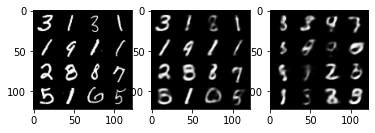

Iter: 13810/50000, Recon loss: 6722.8516, KL div loss: 1228.0005, Total loss: 7950.8521
Iter: 13820/50000, Recon loss: 6348.1973, KL div loss: 1259.1670, Total loss: 7607.3643
Iter: 13830/50000, Recon loss: 6585.6523, KL div loss: 1231.5720, Total loss: 7817.2246
Iter: 13840/50000, Recon loss: 6845.5166, KL div loss: 1234.9346, Total loss: 8080.4512
Iter: 13850/50000, Recon loss: 7080.1396, KL div loss: 1285.5466, Total loss: 8365.6865


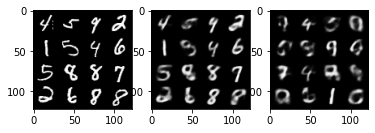

Iter: 13860/50000, Recon loss: 6520.3398, KL div loss: 1330.5105, Total loss: 7850.8506
Iter: 13870/50000, Recon loss: 6308.9932, KL div loss: 1268.2852, Total loss: 7577.2783
Iter: 13880/50000, Recon loss: 6554.6445, KL div loss: 1251.2136, Total loss: 7805.8584
Iter: 13890/50000, Recon loss: 6419.4736, KL div loss: 1232.4294, Total loss: 7651.9033
Iter: 13900/50000, Recon loss: 6543.7803, KL div loss: 1217.7861, Total loss: 7761.5664


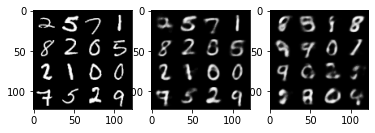

Iter: 13910/50000, Recon loss: 6588.8555, KL div loss: 1278.0703, Total loss: 7866.9258
Iter: 13920/50000, Recon loss: 6266.0762, KL div loss: 1217.9712, Total loss: 7484.0474
Iter: 13930/50000, Recon loss: 6299.6494, KL div loss: 1200.5320, Total loss: 7500.1816
Iter: 13940/50000, Recon loss: 6832.0938, KL div loss: 1243.4523, Total loss: 8075.5459
Iter: 13950/50000, Recon loss: 6660.4502, KL div loss: 1272.0071, Total loss: 7932.4570


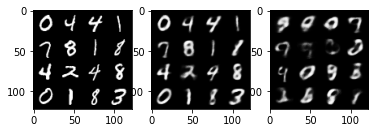

Iter: 13960/50000, Recon loss: 6387.0449, KL div loss: 1235.0175, Total loss: 7622.0625
Iter: 13970/50000, Recon loss: 5902.5366, KL div loss: 1224.0804, Total loss: 7126.6172
Iter: 13980/50000, Recon loss: 6604.5444, KL div loss: 1277.0972, Total loss: 7881.6416
Iter: 13990/50000, Recon loss: 6863.0801, KL div loss: 1224.8254, Total loss: 8087.9053
Iter: 14000/50000, Recon loss: 6576.0518, KL div loss: 1220.1389, Total loss: 7796.1904


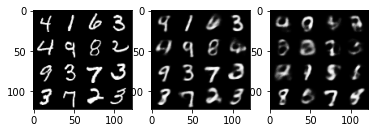

Iter: 14010/50000, Recon loss: 6536.7129, KL div loss: 1214.3838, Total loss: 7751.0967
Iter: 14020/50000, Recon loss: 6431.4927, KL div loss: 1232.0784, Total loss: 7663.5713
Iter: 14030/50000, Recon loss: 6485.1328, KL div loss: 1217.7209, Total loss: 7702.8535
Iter: 14040/50000, Recon loss: 6639.4155, KL div loss: 1199.9653, Total loss: 7839.3809
Iter: 14050/50000, Recon loss: 6439.1602, KL div loss: 1217.0920, Total loss: 7656.2520


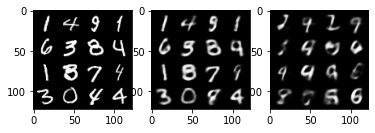

Iter: 14060/50000, Recon loss: 6935.5654, KL div loss: 1192.0159, Total loss: 8127.5811
Iter: 14070/50000, Recon loss: 6437.7852, KL div loss: 1280.1465, Total loss: 7717.9316
Iter: 14080/50000, Recon loss: 6809.2188, KL div loss: 1253.4022, Total loss: 8062.6211
Iter: 14090/50000, Recon loss: 6810.3340, KL div loss: 1217.6864, Total loss: 8028.0205
Iter: 14100/50000, Recon loss: 6581.5771, KL div loss: 1200.8757, Total loss: 7782.4531


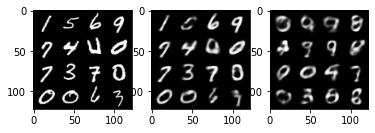

Iter: 14110/50000, Recon loss: 6544.6675, KL div loss: 1269.8243, Total loss: 7814.4917
Iter: 14120/50000, Recon loss: 6892.9146, KL div loss: 1198.2843, Total loss: 8091.1987
Iter: 14130/50000, Recon loss: 6624.6357, KL div loss: 1272.9821, Total loss: 7897.6177
Iter: 14140/50000, Recon loss: 6566.4800, KL div loss: 1231.1276, Total loss: 7797.6074
Iter: 14150/50000, Recon loss: 6666.2207, KL div loss: 1259.4763, Total loss: 7925.6973


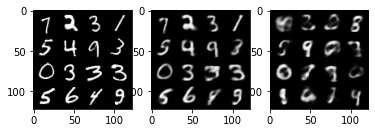

Iter: 14160/50000, Recon loss: 6840.9092, KL div loss: 1236.7040, Total loss: 8077.6133
Iter: 14170/50000, Recon loss: 6151.8315, KL div loss: 1258.2372, Total loss: 7410.0688
Iter: 14180/50000, Recon loss: 6465.0557, KL div loss: 1216.5405, Total loss: 7681.5962
Iter: 14190/50000, Recon loss: 7009.2402, KL div loss: 1237.8274, Total loss: 8247.0674
Iter: 14200/50000, Recon loss: 6182.5981, KL div loss: 1185.2297, Total loss: 7367.8281


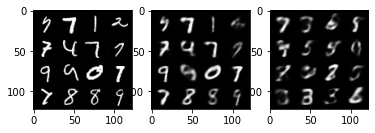

Iter: 14210/50000, Recon loss: 6110.5078, KL div loss: 1177.0055, Total loss: 7287.5132
Iter: 14220/50000, Recon loss: 6450.8105, KL div loss: 1241.8188, Total loss: 7692.6294
Iter: 14230/50000, Recon loss: 6262.9277, KL div loss: 1225.3197, Total loss: 7488.2476
Iter: 14240/50000, Recon loss: 6366.5625, KL div loss: 1233.5884, Total loss: 7600.1509
Iter: 14250/50000, Recon loss: 6534.9385, KL div loss: 1248.4287, Total loss: 7783.3672


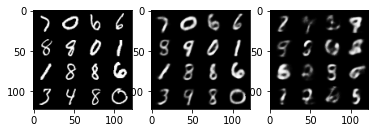

Iter: 14260/50000, Recon loss: 6337.2090, KL div loss: 1181.4358, Total loss: 7518.6445
Iter: 14270/50000, Recon loss: 6807.8389, KL div loss: 1255.3740, Total loss: 8063.2129
Iter: 14280/50000, Recon loss: 6080.6479, KL div loss: 1258.3932, Total loss: 7339.0410
Iter: 14290/50000, Recon loss: 6358.9072, KL div loss: 1273.8529, Total loss: 7632.7603
Iter: 14300/50000, Recon loss: 6675.8999, KL div loss: 1278.1187, Total loss: 7954.0186


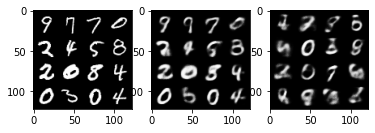

Iter: 14310/50000, Recon loss: 6499.2393, KL div loss: 1215.3821, Total loss: 7714.6211
Iter: 14320/50000, Recon loss: 6624.7773, KL div loss: 1249.3828, Total loss: 7874.1602
Iter: 14330/50000, Recon loss: 6950.0767, KL div loss: 1214.4026, Total loss: 8164.4795
Iter: 14340/50000, Recon loss: 6274.1533, KL div loss: 1202.4773, Total loss: 7476.6309
Iter: 14350/50000, Recon loss: 6673.5391, KL div loss: 1195.3837, Total loss: 7868.9229


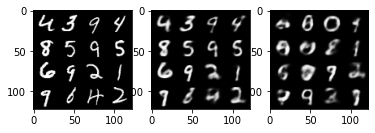

Iter: 14360/50000, Recon loss: 6506.1260, KL div loss: 1235.4869, Total loss: 7741.6128
Iter: 14370/50000, Recon loss: 6757.7983, KL div loss: 1238.8610, Total loss: 7996.6592
Iter: 14380/50000, Recon loss: 6227.2529, KL div loss: 1209.1230, Total loss: 7436.3760
Iter: 14390/50000, Recon loss: 6812.0898, KL div loss: 1252.6350, Total loss: 8064.7246
Iter: 14400/50000, Recon loss: 6373.0967, KL div loss: 1228.2006, Total loss: 7601.2974


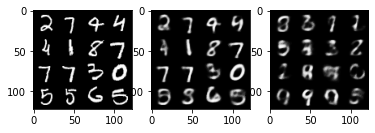

Iter: 14410/50000, Recon loss: 6702.3086, KL div loss: 1310.1191, Total loss: 8012.4277
Iter: 14420/50000, Recon loss: 6578.1851, KL div loss: 1239.6965, Total loss: 7817.8818
Iter: 14430/50000, Recon loss: 6949.8682, KL div loss: 1286.2175, Total loss: 8236.0859
Iter: 14440/50000, Recon loss: 6484.3105, KL div loss: 1270.5208, Total loss: 7754.8311
Iter: 14450/50000, Recon loss: 6396.9702, KL div loss: 1233.4548, Total loss: 7630.4248


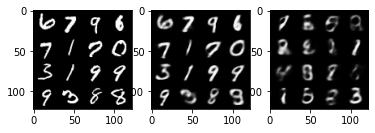

Iter: 14460/50000, Recon loss: 6294.6079, KL div loss: 1215.3871, Total loss: 7509.9951
Iter: 14470/50000, Recon loss: 6628.5557, KL div loss: 1214.0415, Total loss: 7842.5972
Iter: 14480/50000, Recon loss: 6276.7256, KL div loss: 1246.9429, Total loss: 7523.6685
Iter: 14490/50000, Recon loss: 6620.0928, KL div loss: 1247.5198, Total loss: 7867.6123
Iter: 14500/50000, Recon loss: 6510.4053, KL div loss: 1259.5115, Total loss: 7769.9170


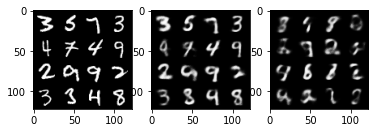

Iter: 14510/50000, Recon loss: 6397.2271, KL div loss: 1229.4326, Total loss: 7626.6597
Iter: 14520/50000, Recon loss: 6333.7646, KL div loss: 1175.0662, Total loss: 7508.8311
Iter: 14530/50000, Recon loss: 6677.9023, KL div loss: 1314.1047, Total loss: 7992.0068
Iter: 14540/50000, Recon loss: 6077.3877, KL div loss: 1174.7983, Total loss: 7252.1860
Iter: 14550/50000, Recon loss: 6086.5522, KL div loss: 1279.7760, Total loss: 7366.3281


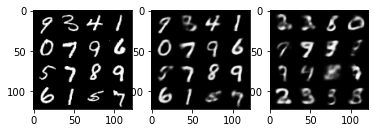

Iter: 14560/50000, Recon loss: 6574.4287, KL div loss: 1215.6794, Total loss: 7790.1084
Iter: 14570/50000, Recon loss: 6204.4727, KL div loss: 1235.8906, Total loss: 7440.3633
Iter: 14580/50000, Recon loss: 6247.2148, KL div loss: 1256.7854, Total loss: 7504.0000
Iter: 14590/50000, Recon loss: 6050.1836, KL div loss: 1280.8866, Total loss: 7331.0703
Iter: 14600/50000, Recon loss: 6838.7778, KL div loss: 1275.7911, Total loss: 8114.5688


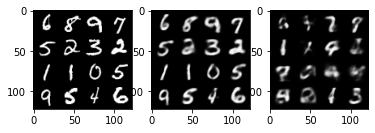

Iter: 14610/50000, Recon loss: 6297.9136, KL div loss: 1217.8392, Total loss: 7515.7529
Iter: 14620/50000, Recon loss: 6481.9487, KL div loss: 1196.2207, Total loss: 7678.1694
Iter: 14630/50000, Recon loss: 5879.3193, KL div loss: 1215.3601, Total loss: 7094.6797
Iter: 14640/50000, Recon loss: 6008.5913, KL div loss: 1211.5016, Total loss: 7220.0928
Iter: 14650/50000, Recon loss: 7168.6064, KL div loss: 1262.4299, Total loss: 8431.0361


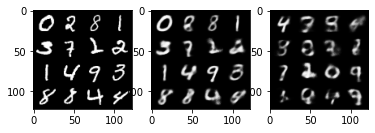

Iter: 14660/50000, Recon loss: 6200.7617, KL div loss: 1278.8683, Total loss: 7479.6299
Iter: 14670/50000, Recon loss: 6474.4893, KL div loss: 1243.0568, Total loss: 7717.5459
Iter: 14680/50000, Recon loss: 6810.3008, KL div loss: 1262.0602, Total loss: 8072.3608
Iter: 14690/50000, Recon loss: 6751.2827, KL div loss: 1250.1481, Total loss: 8001.4307
Iter: 14700/50000, Recon loss: 6486.2651, KL div loss: 1248.1433, Total loss: 7734.4082


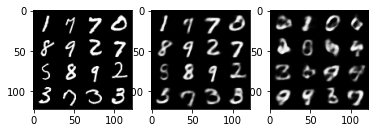

Iter: 14710/50000, Recon loss: 6654.7559, KL div loss: 1252.6954, Total loss: 7907.4512
Iter: 14720/50000, Recon loss: 6008.0205, KL div loss: 1244.6257, Total loss: 7252.6465
Iter: 14730/50000, Recon loss: 6406.2568, KL div loss: 1232.6909, Total loss: 7638.9478
Iter: 14740/50000, Recon loss: 6892.7393, KL div loss: 1280.0024, Total loss: 8172.7417
Iter: 14750/50000, Recon loss: 6814.6416, KL div loss: 1237.0447, Total loss: 8051.6865


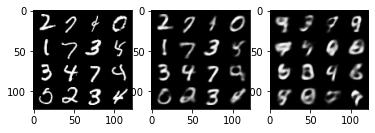

Iter: 14760/50000, Recon loss: 6121.2485, KL div loss: 1209.9705, Total loss: 7331.2188
Iter: 14770/50000, Recon loss: 6522.5156, KL div loss: 1240.6199, Total loss: 7763.1357
Iter: 14780/50000, Recon loss: 6595.3970, KL div loss: 1263.7025, Total loss: 7859.0996
Iter: 14790/50000, Recon loss: 6566.2373, KL div loss: 1261.1057, Total loss: 7827.3428
Iter: 14800/50000, Recon loss: 6497.9590, KL div loss: 1218.8438, Total loss: 7716.8027


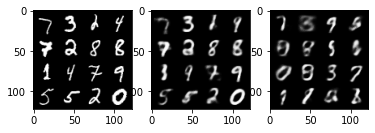

Iter: 14810/50000, Recon loss: 6603.6494, KL div loss: 1192.9843, Total loss: 7796.6338
Iter: 14820/50000, Recon loss: 6844.3911, KL div loss: 1239.8807, Total loss: 8084.2720
Iter: 14830/50000, Recon loss: 6405.1143, KL div loss: 1238.0674, Total loss: 7643.1816
Iter: 14840/50000, Recon loss: 6545.6426, KL div loss: 1293.4984, Total loss: 7839.1411
Iter: 14850/50000, Recon loss: 6271.3145, KL div loss: 1272.4525, Total loss: 7543.7671


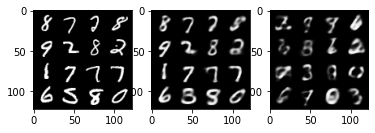

Iter: 14860/50000, Recon loss: 6339.6577, KL div loss: 1251.1023, Total loss: 7590.7598
Iter: 14870/50000, Recon loss: 6659.3721, KL div loss: 1274.6066, Total loss: 7933.9785
Iter: 14880/50000, Recon loss: 6183.1748, KL div loss: 1225.9340, Total loss: 7409.1089
Iter: 14890/50000, Recon loss: 6206.0986, KL div loss: 1227.5061, Total loss: 7433.6045
Iter: 14900/50000, Recon loss: 6711.9355, KL div loss: 1305.4246, Total loss: 8017.3604


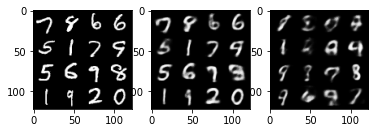

Iter: 14910/50000, Recon loss: 6219.3838, KL div loss: 1209.2773, Total loss: 7428.6611
Iter: 14920/50000, Recon loss: 6147.2852, KL div loss: 1202.1764, Total loss: 7349.4614
Iter: 14930/50000, Recon loss: 6493.6934, KL div loss: 1242.4264, Total loss: 7736.1196
Iter: 14940/50000, Recon loss: 6130.2515, KL div loss: 1187.3356, Total loss: 7317.5869
Iter: 14950/50000, Recon loss: 6491.2139, KL div loss: 1202.6301, Total loss: 7693.8438


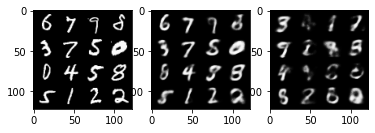

Iter: 14960/50000, Recon loss: 6441.3091, KL div loss: 1232.8793, Total loss: 7674.1885
Iter: 14970/50000, Recon loss: 6449.4717, KL div loss: 1252.0571, Total loss: 7701.5288
Iter: 14980/50000, Recon loss: 5901.5630, KL div loss: 1246.9119, Total loss: 7148.4746
Iter: 14990/50000, Recon loss: 6450.4258, KL div loss: 1262.2111, Total loss: 7712.6367
Iter: 15000/50000, Recon loss: 6799.5522, KL div loss: 1256.5228, Total loss: 8056.0752


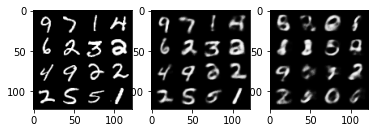

Iter: 15010/50000, Recon loss: 6320.8276, KL div loss: 1272.6211, Total loss: 7593.4487
Iter: 15020/50000, Recon loss: 6285.8140, KL div loss: 1257.0720, Total loss: 7542.8857
Iter: 15030/50000, Recon loss: 6655.1367, KL div loss: 1277.8453, Total loss: 7932.9819
Iter: 15040/50000, Recon loss: 5787.8945, KL div loss: 1220.4282, Total loss: 7008.3228
Iter: 15050/50000, Recon loss: 6488.8237, KL div loss: 1199.6404, Total loss: 7688.4639


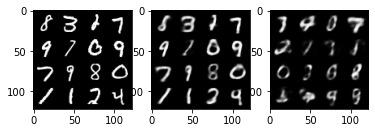

Iter: 15060/50000, Recon loss: 6396.8047, KL div loss: 1223.7661, Total loss: 7620.5708
Iter: 15070/50000, Recon loss: 6407.9126, KL div loss: 1212.9120, Total loss: 7620.8247
Iter: 15080/50000, Recon loss: 6414.2930, KL div loss: 1247.7520, Total loss: 7662.0449
Iter: 15090/50000, Recon loss: 5947.2773, KL div loss: 1214.0483, Total loss: 7161.3257
Iter: 15100/50000, Recon loss: 6396.8735, KL div loss: 1251.0647, Total loss: 7647.9385


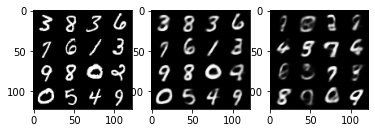

Iter: 15110/50000, Recon loss: 6386.3550, KL div loss: 1313.0657, Total loss: 7699.4209
Iter: 15120/50000, Recon loss: 6560.7559, KL div loss: 1262.3921, Total loss: 7823.1479
Iter: 15130/50000, Recon loss: 6675.3760, KL div loss: 1235.2393, Total loss: 7910.6152
Iter: 15140/50000, Recon loss: 6425.9033, KL div loss: 1234.5872, Total loss: 7660.4902
Iter: 15150/50000, Recon loss: 6765.2329, KL div loss: 1277.7333, Total loss: 8042.9663


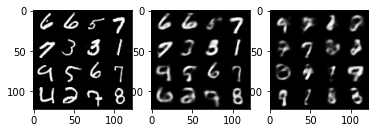

Iter: 15160/50000, Recon loss: 6253.4575, KL div loss: 1240.0547, Total loss: 7493.5122
Iter: 15170/50000, Recon loss: 6648.8291, KL div loss: 1267.9158, Total loss: 7916.7451
Iter: 15180/50000, Recon loss: 6965.6465, KL div loss: 1301.4900, Total loss: 8267.1367
Iter: 15190/50000, Recon loss: 6509.0029, KL div loss: 1219.0016, Total loss: 7728.0044
Iter: 15200/50000, Recon loss: 6489.8389, KL div loss: 1312.3604, Total loss: 7802.1992


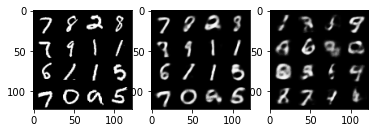

Iter: 15210/50000, Recon loss: 6491.7715, KL div loss: 1226.7510, Total loss: 7718.5225
Iter: 15220/50000, Recon loss: 5889.9438, KL div loss: 1211.3955, Total loss: 7101.3394
Iter: 15230/50000, Recon loss: 6590.8306, KL div loss: 1236.7096, Total loss: 7827.5400
Iter: 15240/50000, Recon loss: 6607.1899, KL div loss: 1249.0681, Total loss: 7856.2578
Iter: 15250/50000, Recon loss: 6967.1509, KL div loss: 1263.0898, Total loss: 8230.2402


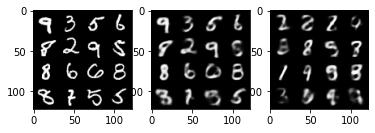

Iter: 15260/50000, Recon loss: 6779.8794, KL div loss: 1288.9978, Total loss: 8068.8770
Iter: 15270/50000, Recon loss: 6651.2329, KL div loss: 1276.2600, Total loss: 7927.4932
Iter: 15280/50000, Recon loss: 6506.6172, KL div loss: 1261.0314, Total loss: 7767.6484
Iter: 15290/50000, Recon loss: 6470.3530, KL div loss: 1272.2565, Total loss: 7742.6094
Iter: 15300/50000, Recon loss: 6002.7773, KL div loss: 1222.1743, Total loss: 7224.9517


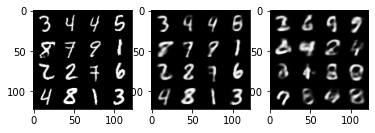

Iter: 15310/50000, Recon loss: 6955.3608, KL div loss: 1315.8801, Total loss: 8271.2412
Iter: 15320/50000, Recon loss: 5921.0454, KL div loss: 1242.5044, Total loss: 7163.5498
Iter: 15330/50000, Recon loss: 6193.8594, KL div loss: 1244.6445, Total loss: 7438.5039
Iter: 15340/50000, Recon loss: 6687.1201, KL div loss: 1286.9775, Total loss: 7974.0977
Iter: 15350/50000, Recon loss: 6031.8213, KL div loss: 1246.0381, Total loss: 7277.8594


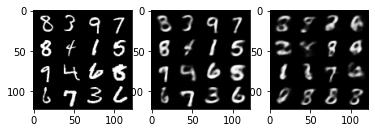

Iter: 15360/50000, Recon loss: 6718.2861, KL div loss: 1265.2698, Total loss: 7983.5557
Iter: 15370/50000, Recon loss: 6274.9438, KL div loss: 1256.7992, Total loss: 7531.7432
Iter: 15380/50000, Recon loss: 6480.9292, KL div loss: 1283.8818, Total loss: 7764.8110
Iter: 15390/50000, Recon loss: 6107.8467, KL div loss: 1210.2678, Total loss: 7318.1143
Iter: 15400/50000, Recon loss: 6355.2349, KL div loss: 1237.7334, Total loss: 7592.9683


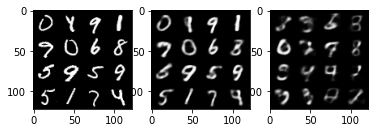

Iter: 15410/50000, Recon loss: 6441.3350, KL div loss: 1248.2944, Total loss: 7689.6294
Iter: 15420/50000, Recon loss: 6522.3931, KL div loss: 1273.8234, Total loss: 7796.2163
Iter: 15430/50000, Recon loss: 6692.8159, KL div loss: 1228.3187, Total loss: 7921.1348
Iter: 15440/50000, Recon loss: 6716.9390, KL div loss: 1279.9508, Total loss: 7996.8896
Iter: 15450/50000, Recon loss: 5999.0928, KL div loss: 1208.9558, Total loss: 7208.0488


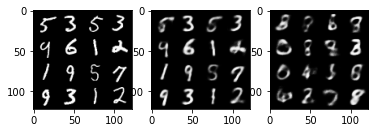

Iter: 15460/50000, Recon loss: 6290.9644, KL div loss: 1275.4438, Total loss: 7566.4082
Iter: 15470/50000, Recon loss: 6406.6475, KL div loss: 1207.5914, Total loss: 7614.2388
Iter: 15480/50000, Recon loss: 6693.2803, KL div loss: 1252.6921, Total loss: 7945.9727
Iter: 15490/50000, Recon loss: 6510.2725, KL div loss: 1267.8057, Total loss: 7778.0781
Iter: 15500/50000, Recon loss: 6317.4531, KL div loss: 1247.2186, Total loss: 7564.6719


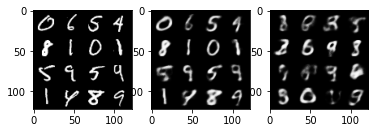

Iter: 15510/50000, Recon loss: 6493.6235, KL div loss: 1297.8140, Total loss: 7791.4375
Iter: 15520/50000, Recon loss: 6423.0537, KL div loss: 1249.1001, Total loss: 7672.1538
Iter: 15530/50000, Recon loss: 6256.3789, KL div loss: 1259.2837, Total loss: 7515.6626
Iter: 15540/50000, Recon loss: 6522.8682, KL div loss: 1276.2471, Total loss: 7799.1152
Iter: 15550/50000, Recon loss: 6373.8232, KL div loss: 1242.9554, Total loss: 7616.7788


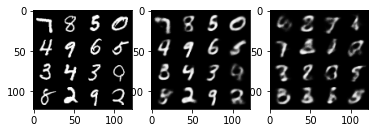

Iter: 15560/50000, Recon loss: 6007.9443, KL div loss: 1230.9027, Total loss: 7238.8472
Iter: 15570/50000, Recon loss: 6220.2266, KL div loss: 1242.9507, Total loss: 7463.1772
Iter: 15580/50000, Recon loss: 6239.6094, KL div loss: 1245.2856, Total loss: 7484.8950
Iter: 15590/50000, Recon loss: 6128.5015, KL div loss: 1201.7771, Total loss: 7330.2783
Iter: 15600/50000, Recon loss: 5967.4419, KL div loss: 1246.2776, Total loss: 7213.7197


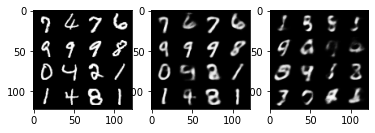

Iter: 15610/50000, Recon loss: 6507.6260, KL div loss: 1279.6722, Total loss: 7787.2983
Iter: 15620/50000, Recon loss: 6333.3501, KL div loss: 1241.2479, Total loss: 7574.5981
Iter: 15630/50000, Recon loss: 6819.9170, KL div loss: 1244.5010, Total loss: 8064.4180
Iter: 15640/50000, Recon loss: 6601.7939, KL div loss: 1273.6973, Total loss: 7875.4912
Iter: 15650/50000, Recon loss: 6747.3062, KL div loss: 1264.1714, Total loss: 8011.4775


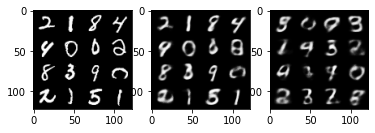

Iter: 15660/50000, Recon loss: 6443.2241, KL div loss: 1291.2371, Total loss: 7734.4609
Iter: 15670/50000, Recon loss: 6665.2905, KL div loss: 1269.4617, Total loss: 7934.7520
Iter: 15680/50000, Recon loss: 6556.4932, KL div loss: 1279.8846, Total loss: 7836.3779
Iter: 15690/50000, Recon loss: 6468.0986, KL div loss: 1263.5394, Total loss: 7731.6382
Iter: 15700/50000, Recon loss: 6225.1270, KL div loss: 1203.0828, Total loss: 7428.2100


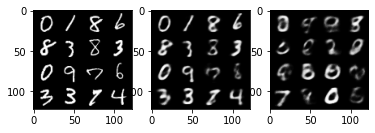

Iter: 15710/50000, Recon loss: 6107.3955, KL div loss: 1232.1654, Total loss: 7339.5610
Iter: 15720/50000, Recon loss: 6520.2520, KL div loss: 1270.6794, Total loss: 7790.9316
Iter: 15730/50000, Recon loss: 6548.9834, KL div loss: 1248.7725, Total loss: 7797.7559
Iter: 15740/50000, Recon loss: 6586.0332, KL div loss: 1268.4532, Total loss: 7854.4863
Iter: 15750/50000, Recon loss: 6381.6792, KL div loss: 1305.8708, Total loss: 7687.5498


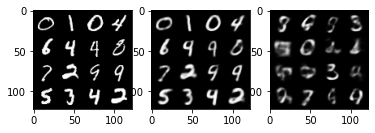

Iter: 15760/50000, Recon loss: 6849.7031, KL div loss: 1230.2354, Total loss: 8079.9385
Iter: 15770/50000, Recon loss: 6593.9775, KL div loss: 1222.6271, Total loss: 7816.6045
Iter: 15780/50000, Recon loss: 6333.2197, KL div loss: 1295.9623, Total loss: 7629.1821
Iter: 15790/50000, Recon loss: 6351.0908, KL div loss: 1255.8979, Total loss: 7606.9888
Iter: 15800/50000, Recon loss: 6213.8447, KL div loss: 1251.7002, Total loss: 7465.5449


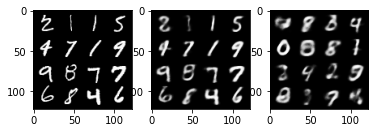

Iter: 15810/50000, Recon loss: 6325.8501, KL div loss: 1294.7977, Total loss: 7620.6479
Iter: 15820/50000, Recon loss: 6504.6104, KL div loss: 1300.2600, Total loss: 7804.8701
Iter: 15830/50000, Recon loss: 6392.4023, KL div loss: 1224.9615, Total loss: 7617.3638
Iter: 15840/50000, Recon loss: 6188.6846, KL div loss: 1274.1355, Total loss: 7462.8203
Iter: 15850/50000, Recon loss: 6339.3760, KL div loss: 1277.4536, Total loss: 7616.8296


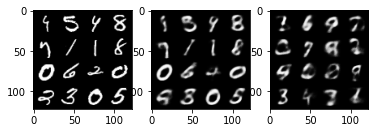

Iter: 15860/50000, Recon loss: 6224.1221, KL div loss: 1251.8335, Total loss: 7475.9556
Iter: 15870/50000, Recon loss: 6490.1538, KL div loss: 1223.8745, Total loss: 7714.0283
Iter: 15880/50000, Recon loss: 6695.3857, KL div loss: 1249.5850, Total loss: 7944.9707
Iter: 15890/50000, Recon loss: 6302.7568, KL div loss: 1207.1820, Total loss: 7509.9390
Iter: 15900/50000, Recon loss: 6484.3569, KL div loss: 1238.3125, Total loss: 7722.6694


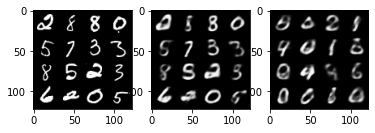

Iter: 15910/50000, Recon loss: 6147.4009, KL div loss: 1272.5562, Total loss: 7419.9570
Iter: 15920/50000, Recon loss: 6230.7026, KL div loss: 1249.2686, Total loss: 7479.9712
Iter: 15930/50000, Recon loss: 6387.4990, KL div loss: 1289.0597, Total loss: 7676.5586
Iter: 15940/50000, Recon loss: 6354.3330, KL div loss: 1285.9780, Total loss: 7640.3110
Iter: 15950/50000, Recon loss: 6155.4014, KL div loss: 1269.2244, Total loss: 7424.6260


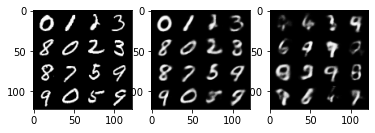

Iter: 15960/50000, Recon loss: 6134.2637, KL div loss: 1283.8829, Total loss: 7418.1465
Iter: 15970/50000, Recon loss: 6210.0391, KL div loss: 1221.7996, Total loss: 7431.8389
Iter: 15980/50000, Recon loss: 6686.8071, KL div loss: 1239.0129, Total loss: 7925.8203
Iter: 15990/50000, Recon loss: 6294.5659, KL div loss: 1268.3936, Total loss: 7562.9595
Iter: 16000/50000, Recon loss: 6982.8755, KL div loss: 1278.8789, Total loss: 8261.7539


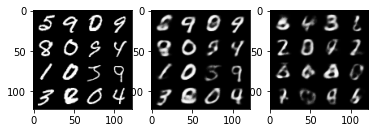

Iter: 16010/50000, Recon loss: 6107.2671, KL div loss: 1255.2488, Total loss: 7362.5156
Iter: 16020/50000, Recon loss: 6182.6729, KL div loss: 1250.1223, Total loss: 7432.7949
Iter: 16030/50000, Recon loss: 5952.6216, KL div loss: 1213.3547, Total loss: 7165.9766
Iter: 16040/50000, Recon loss: 6552.9854, KL div loss: 1250.4674, Total loss: 7803.4526
Iter: 16050/50000, Recon loss: 6546.5801, KL div loss: 1310.4521, Total loss: 7857.0322


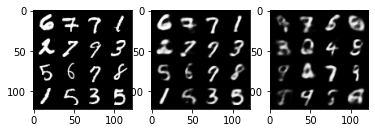

Iter: 16060/50000, Recon loss: 6047.0312, KL div loss: 1263.5927, Total loss: 7310.6240
Iter: 16070/50000, Recon loss: 6161.7314, KL div loss: 1248.7871, Total loss: 7410.5186
Iter: 16080/50000, Recon loss: 6169.2114, KL div loss: 1259.4678, Total loss: 7428.6792
Iter: 16090/50000, Recon loss: 6378.6226, KL div loss: 1239.5908, Total loss: 7618.2134
Iter: 16100/50000, Recon loss: 6266.1455, KL div loss: 1309.7693, Total loss: 7575.9150


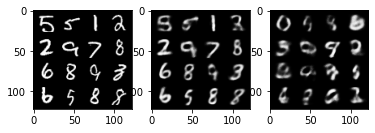

Iter: 16110/50000, Recon loss: 6156.3887, KL div loss: 1267.3494, Total loss: 7423.7383
Iter: 16120/50000, Recon loss: 6288.2070, KL div loss: 1262.9568, Total loss: 7551.1641
Iter: 16130/50000, Recon loss: 6048.8242, KL div loss: 1290.3702, Total loss: 7339.1943
Iter: 16140/50000, Recon loss: 6009.8760, KL div loss: 1214.9459, Total loss: 7224.8218
Iter: 16150/50000, Recon loss: 6140.0112, KL div loss: 1247.6194, Total loss: 7387.6309


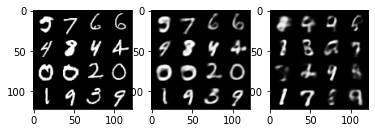

Iter: 16160/50000, Recon loss: 6265.7007, KL div loss: 1248.6310, Total loss: 7514.3315
Iter: 16170/50000, Recon loss: 5924.5322, KL div loss: 1248.5387, Total loss: 7173.0708
Iter: 16180/50000, Recon loss: 6411.0469, KL div loss: 1224.9756, Total loss: 7636.0225
Iter: 16190/50000, Recon loss: 6358.9312, KL div loss: 1249.4017, Total loss: 7608.3330
Iter: 16200/50000, Recon loss: 6761.0010, KL div loss: 1242.1989, Total loss: 8003.1997


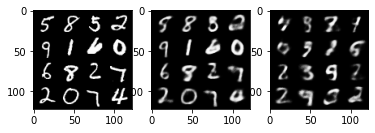

Iter: 16210/50000, Recon loss: 6150.0742, KL div loss: 1233.4177, Total loss: 7383.4922
Iter: 16220/50000, Recon loss: 6238.1733, KL div loss: 1258.3677, Total loss: 7496.5410
Iter: 16230/50000, Recon loss: 6277.8105, KL div loss: 1271.1902, Total loss: 7549.0010
Iter: 16240/50000, Recon loss: 6630.4375, KL div loss: 1299.8555, Total loss: 7930.2930
Iter: 16250/50000, Recon loss: 6721.7715, KL div loss: 1237.2971, Total loss: 7959.0684


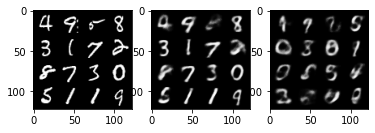

Iter: 16260/50000, Recon loss: 6173.1807, KL div loss: 1227.4912, Total loss: 7400.6719
Iter: 16270/50000, Recon loss: 6444.6338, KL div loss: 1253.7471, Total loss: 7698.3809
Iter: 16280/50000, Recon loss: 6187.7510, KL div loss: 1231.9962, Total loss: 7419.7471
Iter: 16290/50000, Recon loss: 6492.6191, KL div loss: 1237.8956, Total loss: 7730.5146
Iter: 16300/50000, Recon loss: 6497.3413, KL div loss: 1273.4817, Total loss: 7770.8232


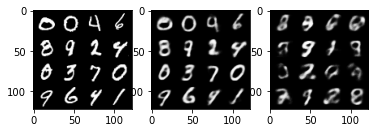

Iter: 16310/50000, Recon loss: 6549.3574, KL div loss: 1269.1458, Total loss: 7818.5029
Iter: 16320/50000, Recon loss: 6687.1621, KL div loss: 1259.2837, Total loss: 7946.4458
Iter: 16330/50000, Recon loss: 6720.7905, KL div loss: 1284.7501, Total loss: 8005.5405
Iter: 16340/50000, Recon loss: 6503.7109, KL div loss: 1228.3492, Total loss: 7732.0601
Iter: 16350/50000, Recon loss: 6288.9580, KL div loss: 1288.9006, Total loss: 7577.8584


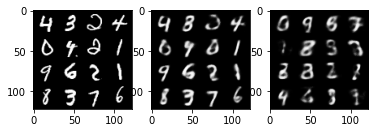

Iter: 16360/50000, Recon loss: 6237.1465, KL div loss: 1234.5667, Total loss: 7471.7129
Iter: 16370/50000, Recon loss: 6274.6465, KL div loss: 1239.3573, Total loss: 7514.0039
Iter: 16380/50000, Recon loss: 6212.0913, KL div loss: 1320.5756, Total loss: 7532.6670
Iter: 16390/50000, Recon loss: 6460.2529, KL div loss: 1264.0615, Total loss: 7724.3145
Iter: 16400/50000, Recon loss: 6593.3784, KL div loss: 1292.1172, Total loss: 7885.4956


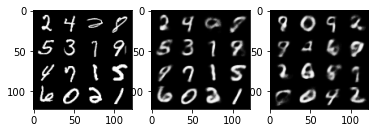

Iter: 16410/50000, Recon loss: 5938.5693, KL div loss: 1215.6907, Total loss: 7154.2598
Iter: 16420/50000, Recon loss: 6170.3203, KL div loss: 1285.9816, Total loss: 7456.3018
Iter: 16430/50000, Recon loss: 6129.5605, KL div loss: 1252.8335, Total loss: 7382.3940
Iter: 16440/50000, Recon loss: 6191.6992, KL div loss: 1243.6167, Total loss: 7435.3159
Iter: 16450/50000, Recon loss: 6084.3535, KL div loss: 1254.2141, Total loss: 7338.5674


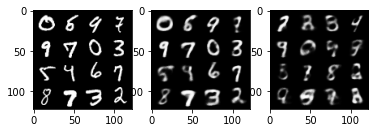

Iter: 16460/50000, Recon loss: 6099.0879, KL div loss: 1254.2290, Total loss: 7353.3169
Iter: 16470/50000, Recon loss: 5921.6240, KL div loss: 1241.4795, Total loss: 7163.1035
Iter: 16480/50000, Recon loss: 6427.2793, KL div loss: 1298.9812, Total loss: 7726.2607
Iter: 16490/50000, Recon loss: 6413.4482, KL div loss: 1255.8218, Total loss: 7669.2700
Iter: 16500/50000, Recon loss: 6583.1772, KL div loss: 1289.5386, Total loss: 7872.7158


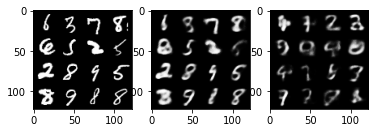

Iter: 16510/50000, Recon loss: 6330.1304, KL div loss: 1246.0796, Total loss: 7576.2100
Iter: 16520/50000, Recon loss: 6260.3018, KL div loss: 1265.8069, Total loss: 7526.1084
Iter: 16530/50000, Recon loss: 6319.4873, KL div loss: 1290.6348, Total loss: 7610.1221
Iter: 16540/50000, Recon loss: 5625.3467, KL div loss: 1191.9014, Total loss: 6817.2480
Iter: 16550/50000, Recon loss: 6295.1348, KL div loss: 1218.3555, Total loss: 7513.4902


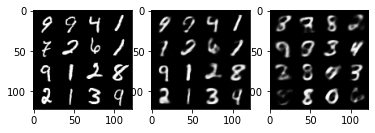

Iter: 16560/50000, Recon loss: 6237.6191, KL div loss: 1292.8184, Total loss: 7530.4375
Iter: 16570/50000, Recon loss: 6299.7490, KL div loss: 1213.5134, Total loss: 7513.2627
Iter: 16580/50000, Recon loss: 6412.1890, KL div loss: 1305.7825, Total loss: 7717.9717
Iter: 16590/50000, Recon loss: 6056.1968, KL div loss: 1261.6855, Total loss: 7317.8823
Iter: 16600/50000, Recon loss: 6288.3633, KL div loss: 1232.9822, Total loss: 7521.3457


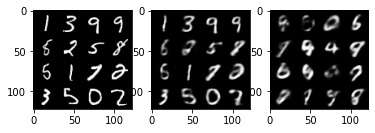

Iter: 16610/50000, Recon loss: 6216.9482, KL div loss: 1243.3893, Total loss: 7460.3374
Iter: 16620/50000, Recon loss: 5957.4888, KL div loss: 1235.3584, Total loss: 7192.8472
Iter: 16630/50000, Recon loss: 6421.0786, KL div loss: 1289.6001, Total loss: 7710.6787
Iter: 16640/50000, Recon loss: 5891.4341, KL div loss: 1254.1372, Total loss: 7145.5713
Iter: 16650/50000, Recon loss: 6115.8701, KL div loss: 1225.0333, Total loss: 7340.9033


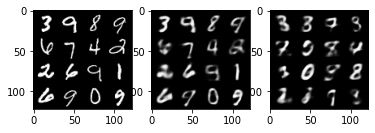

Iter: 16660/50000, Recon loss: 5997.4795, KL div loss: 1241.9609, Total loss: 7239.4404
Iter: 16670/50000, Recon loss: 6333.7192, KL div loss: 1266.3857, Total loss: 7600.1050
Iter: 16680/50000, Recon loss: 6487.7832, KL div loss: 1232.9766, Total loss: 7720.7598
Iter: 16690/50000, Recon loss: 6142.5781, KL div loss: 1277.1570, Total loss: 7419.7354
Iter: 16700/50000, Recon loss: 6753.9595, KL div loss: 1259.2190, Total loss: 8013.1787


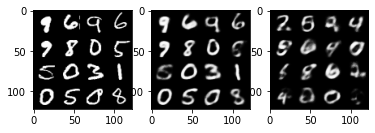

Iter: 16710/50000, Recon loss: 6355.2686, KL div loss: 1270.4302, Total loss: 7625.6987
Iter: 16720/50000, Recon loss: 6579.6094, KL div loss: 1276.6056, Total loss: 7856.2148
Iter: 16730/50000, Recon loss: 6314.6665, KL div loss: 1262.5920, Total loss: 7577.2588
Iter: 16740/50000, Recon loss: 6305.6812, KL div loss: 1233.3450, Total loss: 7539.0264
Iter: 16750/50000, Recon loss: 6364.6953, KL div loss: 1282.2108, Total loss: 7646.9062


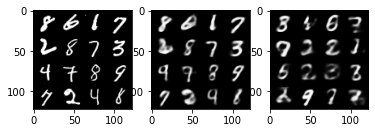

Iter: 16760/50000, Recon loss: 6074.0957, KL div loss: 1290.0981, Total loss: 7364.1938
Iter: 16770/50000, Recon loss: 5857.5977, KL div loss: 1219.0355, Total loss: 7076.6333
Iter: 16780/50000, Recon loss: 6325.2617, KL div loss: 1275.2313, Total loss: 7600.4932
Iter: 16790/50000, Recon loss: 6397.7539, KL div loss: 1284.3477, Total loss: 7682.1016
Iter: 16800/50000, Recon loss: 6211.0674, KL div loss: 1270.9651, Total loss: 7482.0322


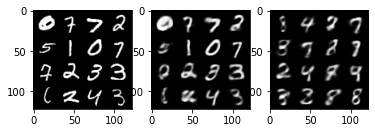

Iter: 16810/50000, Recon loss: 6254.8374, KL div loss: 1247.3181, Total loss: 7502.1553
Iter: 16820/50000, Recon loss: 6078.3164, KL div loss: 1279.4059, Total loss: 7357.7222
Iter: 16830/50000, Recon loss: 6241.5996, KL div loss: 1253.5693, Total loss: 7495.1689
Iter: 16840/50000, Recon loss: 6345.2031, KL div loss: 1263.0012, Total loss: 7608.2041
Iter: 16850/50000, Recon loss: 6196.7217, KL div loss: 1303.8953, Total loss: 7500.6172


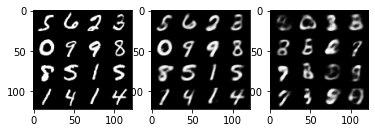

Iter: 16860/50000, Recon loss: 6083.6436, KL div loss: 1266.5223, Total loss: 7350.1660
Iter: 16870/50000, Recon loss: 6405.3735, KL div loss: 1279.7952, Total loss: 7685.1689
Iter: 16880/50000, Recon loss: 6434.5640, KL div loss: 1263.7854, Total loss: 7698.3496
Iter: 16890/50000, Recon loss: 6126.5288, KL div loss: 1191.7471, Total loss: 7318.2759
Iter: 16900/50000, Recon loss: 6330.3066, KL div loss: 1327.4451, Total loss: 7657.7520


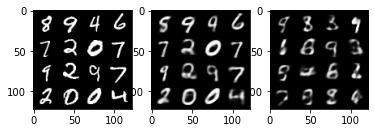

Iter: 16910/50000, Recon loss: 5780.7183, KL div loss: 1245.8301, Total loss: 7026.5483
Iter: 16920/50000, Recon loss: 6683.3291, KL div loss: 1252.7097, Total loss: 7936.0391
Iter: 16930/50000, Recon loss: 6340.3218, KL div loss: 1300.8923, Total loss: 7641.2139
Iter: 16940/50000, Recon loss: 6101.1377, KL div loss: 1284.9229, Total loss: 7386.0605
Iter: 16950/50000, Recon loss: 6145.2437, KL div loss: 1240.5154, Total loss: 7385.7588


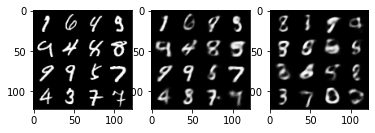

Iter: 16960/50000, Recon loss: 5678.7476, KL div loss: 1245.5984, Total loss: 6924.3457
Iter: 16970/50000, Recon loss: 6023.2588, KL div loss: 1273.0190, Total loss: 7296.2778
Iter: 16980/50000, Recon loss: 6096.4941, KL div loss: 1204.2808, Total loss: 7300.7749
Iter: 16990/50000, Recon loss: 6083.4854, KL div loss: 1216.7820, Total loss: 7300.2676
Iter: 17000/50000, Recon loss: 5895.3975, KL div loss: 1257.8152, Total loss: 7153.2129


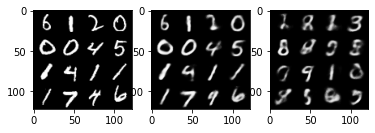

Iter: 17010/50000, Recon loss: 5976.6650, KL div loss: 1233.7664, Total loss: 7210.4316
Iter: 17020/50000, Recon loss: 6181.8740, KL div loss: 1268.1357, Total loss: 7450.0098
Iter: 17030/50000, Recon loss: 6361.1006, KL div loss: 1319.9517, Total loss: 7681.0522
Iter: 17040/50000, Recon loss: 6228.3682, KL div loss: 1262.7111, Total loss: 7491.0791
Iter: 17050/50000, Recon loss: 6348.6768, KL div loss: 1265.6672, Total loss: 7614.3438


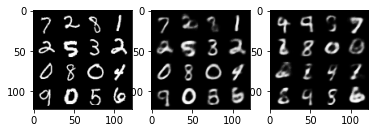

Iter: 17060/50000, Recon loss: 6469.2266, KL div loss: 1253.5894, Total loss: 7722.8159
Iter: 17070/50000, Recon loss: 6057.3525, KL div loss: 1219.5546, Total loss: 7276.9072
Iter: 17080/50000, Recon loss: 6523.3066, KL div loss: 1254.2977, Total loss: 7777.6045
Iter: 17090/50000, Recon loss: 6524.3711, KL div loss: 1291.1667, Total loss: 7815.5381
Iter: 17100/50000, Recon loss: 6457.5493, KL div loss: 1297.1196, Total loss: 7754.6689


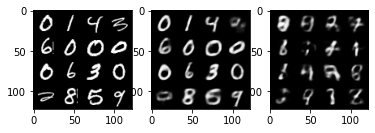

Iter: 17110/50000, Recon loss: 6033.0063, KL div loss: 1290.5817, Total loss: 7323.5879
Iter: 17120/50000, Recon loss: 6632.8032, KL div loss: 1280.8291, Total loss: 7913.6323
Iter: 17130/50000, Recon loss: 6558.7856, KL div loss: 1259.4230, Total loss: 7818.2085
Iter: 17140/50000, Recon loss: 6210.4453, KL div loss: 1264.1333, Total loss: 7474.5786
Iter: 17150/50000, Recon loss: 6318.3970, KL div loss: 1296.3009, Total loss: 7614.6978


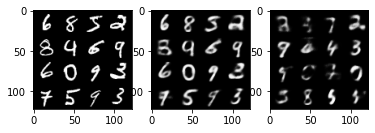

Iter: 17160/50000, Recon loss: 6124.4448, KL div loss: 1252.8853, Total loss: 7377.3301
Iter: 17170/50000, Recon loss: 6349.2676, KL div loss: 1322.6458, Total loss: 7671.9131
Iter: 17180/50000, Recon loss: 6003.6924, KL div loss: 1227.8594, Total loss: 7231.5518
Iter: 17190/50000, Recon loss: 6222.8818, KL div loss: 1240.4302, Total loss: 7463.3120
Iter: 17200/50000, Recon loss: 6264.4453, KL div loss: 1288.0601, Total loss: 7552.5054


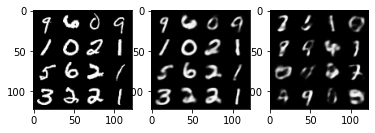

Iter: 17210/50000, Recon loss: 6171.3770, KL div loss: 1278.8578, Total loss: 7450.2349
Iter: 17220/50000, Recon loss: 6229.7910, KL div loss: 1256.5156, Total loss: 7486.3066
Iter: 17230/50000, Recon loss: 6453.8008, KL div loss: 1293.1090, Total loss: 7746.9097
Iter: 17240/50000, Recon loss: 6357.2295, KL div loss: 1252.9365, Total loss: 7610.1660
Iter: 17250/50000, Recon loss: 6129.0791, KL div loss: 1272.9900, Total loss: 7402.0693


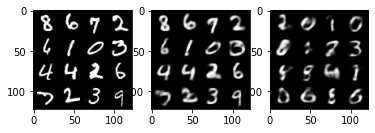

Iter: 17260/50000, Recon loss: 6133.2842, KL div loss: 1248.3682, Total loss: 7381.6523
Iter: 17270/50000, Recon loss: 6466.6836, KL div loss: 1268.5216, Total loss: 7735.2051
Iter: 17280/50000, Recon loss: 6386.7500, KL div loss: 1276.7195, Total loss: 7663.4697
Iter: 17290/50000, Recon loss: 6188.7803, KL div loss: 1268.0828, Total loss: 7456.8633
Iter: 17300/50000, Recon loss: 6531.2051, KL div loss: 1299.9767, Total loss: 7831.1816


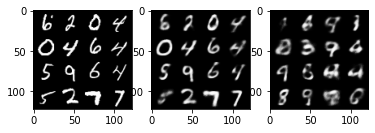

Iter: 17310/50000, Recon loss: 5997.3516, KL div loss: 1268.4795, Total loss: 7265.8311
Iter: 17320/50000, Recon loss: 6220.2202, KL div loss: 1237.3232, Total loss: 7457.5435
Iter: 17330/50000, Recon loss: 6184.2959, KL div loss: 1271.3489, Total loss: 7455.6445
Iter: 17340/50000, Recon loss: 6406.9023, KL div loss: 1303.9745, Total loss: 7710.8770
Iter: 17350/50000, Recon loss: 5966.2793, KL div loss: 1196.5219, Total loss: 7162.8013


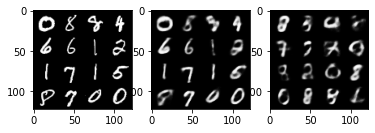

Iter: 17360/50000, Recon loss: 6238.3682, KL div loss: 1252.5378, Total loss: 7490.9062
Iter: 17370/50000, Recon loss: 6193.8975, KL div loss: 1252.5494, Total loss: 7446.4468
Iter: 17380/50000, Recon loss: 6101.9814, KL div loss: 1262.9012, Total loss: 7364.8828
Iter: 17390/50000, Recon loss: 6312.9121, KL div loss: 1276.6626, Total loss: 7589.5747
Iter: 17400/50000, Recon loss: 5925.8008, KL div loss: 1281.1387, Total loss: 7206.9395


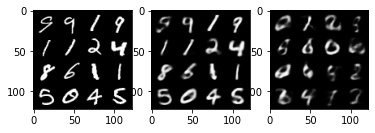

Iter: 17410/50000, Recon loss: 6825.5889, KL div loss: 1283.0588, Total loss: 8108.6475
Iter: 17420/50000, Recon loss: 6226.4155, KL div loss: 1233.4248, Total loss: 7459.8403
Iter: 17430/50000, Recon loss: 6256.9893, KL div loss: 1249.2820, Total loss: 7506.2715
Iter: 17440/50000, Recon loss: 6743.8809, KL div loss: 1286.1305, Total loss: 8030.0112
Iter: 17450/50000, Recon loss: 6359.5967, KL div loss: 1276.1405, Total loss: 7635.7373


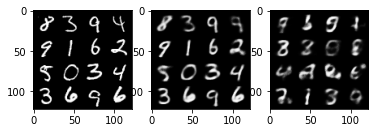

Iter: 17460/50000, Recon loss: 6241.5986, KL div loss: 1293.7465, Total loss: 7535.3452
Iter: 17470/50000, Recon loss: 6181.7358, KL div loss: 1206.2197, Total loss: 7387.9556
Iter: 17480/50000, Recon loss: 6519.4395, KL div loss: 1297.9653, Total loss: 7817.4048
Iter: 17490/50000, Recon loss: 6301.3232, KL div loss: 1220.5295, Total loss: 7521.8525
Iter: 17500/50000, Recon loss: 6034.8711, KL div loss: 1281.5416, Total loss: 7316.4126


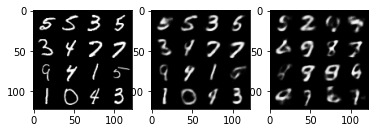

Iter: 17510/50000, Recon loss: 6386.6548, KL div loss: 1347.9534, Total loss: 7734.6084
Iter: 17520/50000, Recon loss: 6168.0957, KL div loss: 1325.5494, Total loss: 7493.6450
Iter: 17530/50000, Recon loss: 6026.8149, KL div loss: 1247.2356, Total loss: 7274.0508
Iter: 17540/50000, Recon loss: 6013.0073, KL div loss: 1262.8973, Total loss: 7275.9048
Iter: 17550/50000, Recon loss: 6466.7803, KL div loss: 1236.6313, Total loss: 7703.4116


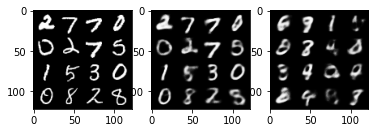

Iter: 17560/50000, Recon loss: 5849.8584, KL div loss: 1297.4419, Total loss: 7147.3003
Iter: 17570/50000, Recon loss: 5849.3311, KL div loss: 1241.3289, Total loss: 7090.6602
Iter: 17580/50000, Recon loss: 5903.6924, KL div loss: 1294.1082, Total loss: 7197.8008
Iter: 17590/50000, Recon loss: 6269.8232, KL div loss: 1233.8616, Total loss: 7503.6846
Iter: 17600/50000, Recon loss: 6199.6992, KL div loss: 1245.0686, Total loss: 7444.7676


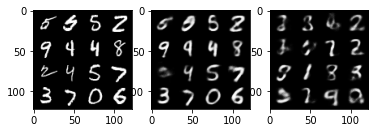

Iter: 17610/50000, Recon loss: 6421.9644, KL div loss: 1260.7302, Total loss: 7682.6943
Iter: 17620/50000, Recon loss: 5904.3940, KL div loss: 1265.5476, Total loss: 7169.9414
Iter: 17630/50000, Recon loss: 6442.6191, KL div loss: 1260.4919, Total loss: 7703.1113
Iter: 17640/50000, Recon loss: 6171.8008, KL div loss: 1218.2887, Total loss: 7390.0894
Iter: 17650/50000, Recon loss: 6296.0127, KL div loss: 1209.0273, Total loss: 7505.0400


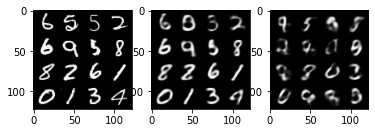

Iter: 17660/50000, Recon loss: 6158.9629, KL div loss: 1260.6483, Total loss: 7419.6113
Iter: 17670/50000, Recon loss: 6029.8770, KL div loss: 1225.2678, Total loss: 7255.1445
Iter: 17680/50000, Recon loss: 6085.2842, KL div loss: 1227.0615, Total loss: 7312.3457
Iter: 17690/50000, Recon loss: 6433.8271, KL div loss: 1270.3345, Total loss: 7704.1616
Iter: 17700/50000, Recon loss: 6084.1543, KL div loss: 1290.6377, Total loss: 7374.7920


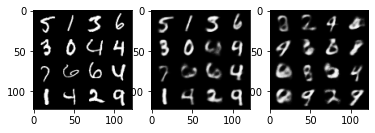

Iter: 17710/50000, Recon loss: 6068.8125, KL div loss: 1235.3436, Total loss: 7304.1562
Iter: 17720/50000, Recon loss: 6072.6133, KL div loss: 1269.6409, Total loss: 7342.2539
Iter: 17730/50000, Recon loss: 6326.6191, KL div loss: 1320.8644, Total loss: 7647.4834
Iter: 17740/50000, Recon loss: 6509.8135, KL div loss: 1317.3579, Total loss: 7827.1714
Iter: 17750/50000, Recon loss: 6213.8848, KL div loss: 1347.4647, Total loss: 7561.3496


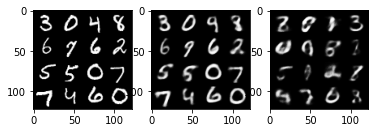

Iter: 17760/50000, Recon loss: 6440.6021, KL div loss: 1300.5425, Total loss: 7741.1445
Iter: 17770/50000, Recon loss: 6234.3154, KL div loss: 1312.0247, Total loss: 7546.3398
Iter: 17780/50000, Recon loss: 5972.9370, KL div loss: 1297.4097, Total loss: 7270.3467
Iter: 17790/50000, Recon loss: 5973.5156, KL div loss: 1297.4847, Total loss: 7271.0005
Iter: 17800/50000, Recon loss: 6327.5981, KL div loss: 1289.3651, Total loss: 7616.9634


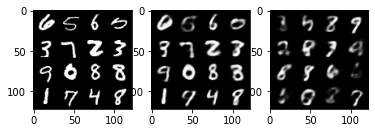

Iter: 17810/50000, Recon loss: 6244.8076, KL div loss: 1273.9475, Total loss: 7518.7549
Iter: 17820/50000, Recon loss: 6644.5703, KL div loss: 1303.9250, Total loss: 7948.4951
Iter: 17830/50000, Recon loss: 6017.4170, KL div loss: 1245.2300, Total loss: 7262.6470
Iter: 17840/50000, Recon loss: 6178.1338, KL div loss: 1290.3173, Total loss: 7468.4512
Iter: 17850/50000, Recon loss: 6151.1035, KL div loss: 1240.5940, Total loss: 7391.6973


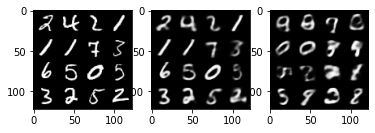

Iter: 17860/50000, Recon loss: 5805.6675, KL div loss: 1273.6459, Total loss: 7079.3135
Iter: 17870/50000, Recon loss: 6100.4126, KL div loss: 1277.1475, Total loss: 7377.5601
Iter: 17880/50000, Recon loss: 6254.7334, KL div loss: 1275.0903, Total loss: 7529.8237
Iter: 17890/50000, Recon loss: 6601.9336, KL div loss: 1351.9954, Total loss: 7953.9287
Iter: 17900/50000, Recon loss: 6124.6099, KL div loss: 1229.6833, Total loss: 7354.2930


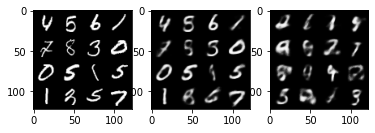

Iter: 17910/50000, Recon loss: 6213.1045, KL div loss: 1270.4932, Total loss: 7483.5977
Iter: 17920/50000, Recon loss: 6403.9443, KL div loss: 1263.6499, Total loss: 7667.5942
Iter: 17930/50000, Recon loss: 5711.1299, KL div loss: 1256.2119, Total loss: 6967.3418
Iter: 17940/50000, Recon loss: 5913.2119, KL div loss: 1250.7327, Total loss: 7163.9443
Iter: 17950/50000, Recon loss: 6145.9990, KL div loss: 1261.6899, Total loss: 7407.6890


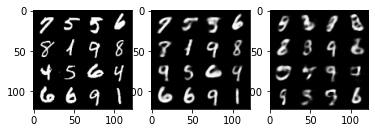

Iter: 17960/50000, Recon loss: 6095.5264, KL div loss: 1294.9463, Total loss: 7390.4727
Iter: 17970/50000, Recon loss: 5945.4619, KL div loss: 1213.8113, Total loss: 7159.2734
Iter: 17980/50000, Recon loss: 6202.3521, KL div loss: 1263.2959, Total loss: 7465.6479
Iter: 17990/50000, Recon loss: 6518.9854, KL div loss: 1302.8367, Total loss: 7821.8223
Iter: 18000/50000, Recon loss: 5958.8203, KL div loss: 1264.3745, Total loss: 7223.1948


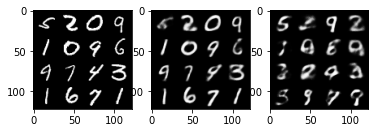

Iter: 18010/50000, Recon loss: 6371.6162, KL div loss: 1267.6700, Total loss: 7639.2861
Iter: 18020/50000, Recon loss: 5831.2549, KL div loss: 1259.3252, Total loss: 7090.5801
Iter: 18030/50000, Recon loss: 6516.0869, KL div loss: 1262.6992, Total loss: 7778.7861
Iter: 18040/50000, Recon loss: 5798.5142, KL div loss: 1232.5249, Total loss: 7031.0391
Iter: 18050/50000, Recon loss: 6264.4419, KL div loss: 1322.1240, Total loss: 7586.5659


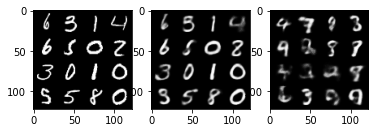

Iter: 18060/50000, Recon loss: 6542.0205, KL div loss: 1401.3586, Total loss: 7943.3789
Iter: 18070/50000, Recon loss: 6067.4819, KL div loss: 1260.8901, Total loss: 7328.3721
Iter: 18080/50000, Recon loss: 6588.8164, KL div loss: 1344.5522, Total loss: 7933.3687
Iter: 18090/50000, Recon loss: 6526.2881, KL div loss: 1321.4280, Total loss: 7847.7158
Iter: 18100/50000, Recon loss: 6112.4414, KL div loss: 1284.6318, Total loss: 7397.0732


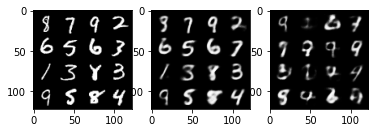

Iter: 18110/50000, Recon loss: 5925.3916, KL div loss: 1271.8254, Total loss: 7197.2168
Iter: 18120/50000, Recon loss: 6115.7734, KL div loss: 1225.2238, Total loss: 7340.9971
Iter: 18130/50000, Recon loss: 6459.6338, KL div loss: 1298.3868, Total loss: 7758.0205
Iter: 18140/50000, Recon loss: 6219.1289, KL div loss: 1268.2493, Total loss: 7487.3779
Iter: 18150/50000, Recon loss: 6224.8164, KL div loss: 1323.8928, Total loss: 7548.7090


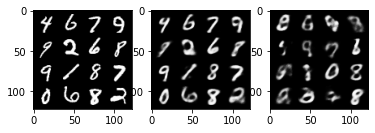

Iter: 18160/50000, Recon loss: 5861.1182, KL div loss: 1270.9702, Total loss: 7132.0884
Iter: 18170/50000, Recon loss: 6216.4199, KL div loss: 1291.8416, Total loss: 7508.2617
Iter: 18180/50000, Recon loss: 6045.6328, KL div loss: 1291.0575, Total loss: 7336.6904
Iter: 18190/50000, Recon loss: 6016.1978, KL div loss: 1279.1062, Total loss: 7295.3037
Iter: 18200/50000, Recon loss: 6498.0703, KL div loss: 1348.2285, Total loss: 7846.2988


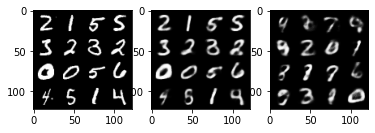

Iter: 18210/50000, Recon loss: 6331.1763, KL div loss: 1289.3091, Total loss: 7620.4854
Iter: 18220/50000, Recon loss: 5767.3115, KL div loss: 1238.6078, Total loss: 7005.9194
Iter: 18230/50000, Recon loss: 6148.7383, KL div loss: 1309.1062, Total loss: 7457.8447
Iter: 18240/50000, Recon loss: 6460.0850, KL div loss: 1299.6426, Total loss: 7759.7275
Iter: 18250/50000, Recon loss: 6219.2979, KL div loss: 1291.1639, Total loss: 7510.4619


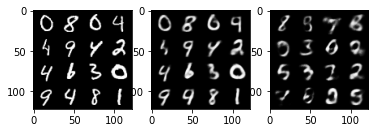

Iter: 18260/50000, Recon loss: 6202.0200, KL div loss: 1296.9065, Total loss: 7498.9268
Iter: 18270/50000, Recon loss: 5810.1104, KL div loss: 1241.4791, Total loss: 7051.5894
Iter: 18280/50000, Recon loss: 6219.4551, KL div loss: 1245.6572, Total loss: 7465.1123
Iter: 18290/50000, Recon loss: 6127.1636, KL div loss: 1277.3982, Total loss: 7404.5615
Iter: 18300/50000, Recon loss: 6539.8135, KL div loss: 1292.5784, Total loss: 7832.3916


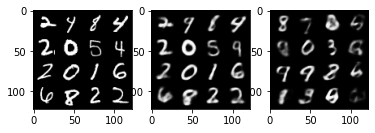

Iter: 18310/50000, Recon loss: 5941.6455, KL div loss: 1221.1981, Total loss: 7162.8438
Iter: 18320/50000, Recon loss: 6098.4561, KL div loss: 1295.6162, Total loss: 7394.0723
Iter: 18330/50000, Recon loss: 5920.9268, KL div loss: 1302.5752, Total loss: 7223.5020
Iter: 18340/50000, Recon loss: 6135.7480, KL div loss: 1255.3037, Total loss: 7391.0518
Iter: 18350/50000, Recon loss: 6196.9189, KL div loss: 1282.8860, Total loss: 7479.8047


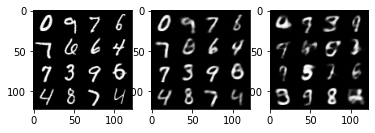

Iter: 18360/50000, Recon loss: 6095.3457, KL div loss: 1295.1460, Total loss: 7390.4917
Iter: 18370/50000, Recon loss: 5730.7422, KL div loss: 1268.4368, Total loss: 6999.1787
Iter: 18380/50000, Recon loss: 6015.4443, KL div loss: 1256.4191, Total loss: 7271.8633
Iter: 18390/50000, Recon loss: 6154.0830, KL div loss: 1271.4481, Total loss: 7425.5312
Iter: 18400/50000, Recon loss: 6165.9673, KL div loss: 1257.4786, Total loss: 7423.4458


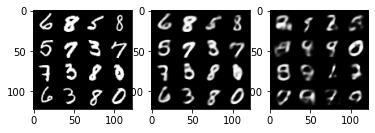

Iter: 18410/50000, Recon loss: 6066.0898, KL div loss: 1258.5352, Total loss: 7324.6250
Iter: 18420/50000, Recon loss: 6127.7778, KL div loss: 1271.6321, Total loss: 7399.4102
Iter: 18430/50000, Recon loss: 6187.7402, KL div loss: 1275.7952, Total loss: 7463.5352
Iter: 18440/50000, Recon loss: 6718.2510, KL div loss: 1375.2213, Total loss: 8093.4722
Iter: 18450/50000, Recon loss: 6298.6484, KL div loss: 1276.5455, Total loss: 7575.1938


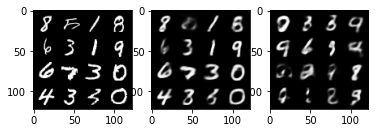

Iter: 18460/50000, Recon loss: 5807.4849, KL div loss: 1228.5750, Total loss: 7036.0596
Iter: 18470/50000, Recon loss: 5694.6475, KL div loss: 1260.5203, Total loss: 6955.1680
Iter: 18480/50000, Recon loss: 5761.5156, KL div loss: 1250.6940, Total loss: 7012.2095
Iter: 18490/50000, Recon loss: 6184.1562, KL div loss: 1238.9230, Total loss: 7423.0791
Iter: 18500/50000, Recon loss: 6219.6143, KL div loss: 1326.9045, Total loss: 7546.5186


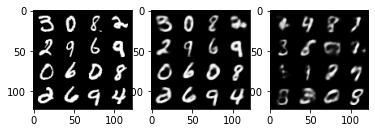

Iter: 18510/50000, Recon loss: 6427.5078, KL div loss: 1293.5336, Total loss: 7721.0415
Iter: 18520/50000, Recon loss: 5987.7505, KL div loss: 1248.1826, Total loss: 7235.9331
Iter: 18530/50000, Recon loss: 6046.6543, KL div loss: 1267.8280, Total loss: 7314.4824
Iter: 18540/50000, Recon loss: 6024.6133, KL div loss: 1331.7612, Total loss: 7356.3745
Iter: 18550/50000, Recon loss: 6711.6133, KL div loss: 1284.9799, Total loss: 7996.5933


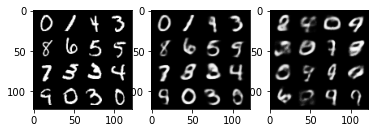

Iter: 18560/50000, Recon loss: 5673.1260, KL div loss: 1241.7103, Total loss: 6914.8364
Iter: 18570/50000, Recon loss: 6552.8745, KL div loss: 1333.7087, Total loss: 7886.5830
Iter: 18580/50000, Recon loss: 6111.8574, KL div loss: 1318.4963, Total loss: 7430.3535
Iter: 18590/50000, Recon loss: 6204.8770, KL div loss: 1285.4631, Total loss: 7490.3398
Iter: 18600/50000, Recon loss: 6485.3398, KL div loss: 1260.0546, Total loss: 7745.3945


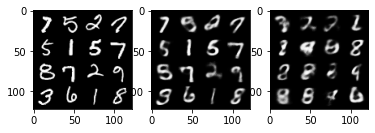

Iter: 18610/50000, Recon loss: 5712.8496, KL div loss: 1270.2357, Total loss: 6983.0854
Iter: 18620/50000, Recon loss: 6333.3457, KL div loss: 1315.8264, Total loss: 7649.1719
Iter: 18630/50000, Recon loss: 6411.9209, KL div loss: 1312.3813, Total loss: 7724.3022
Iter: 18640/50000, Recon loss: 5774.6855, KL div loss: 1289.9739, Total loss: 7064.6592
Iter: 18650/50000, Recon loss: 6185.2524, KL div loss: 1285.1421, Total loss: 7470.3945


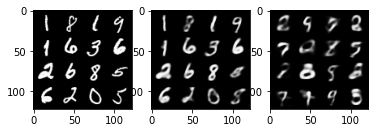

Iter: 18660/50000, Recon loss: 6287.3799, KL div loss: 1275.3174, Total loss: 7562.6973
Iter: 18670/50000, Recon loss: 6094.1763, KL div loss: 1320.5039, Total loss: 7414.6802
Iter: 18680/50000, Recon loss: 6452.5195, KL div loss: 1255.3987, Total loss: 7707.9180
Iter: 18690/50000, Recon loss: 6245.5635, KL div loss: 1264.4019, Total loss: 7509.9653
Iter: 18700/50000, Recon loss: 6611.9009, KL div loss: 1303.0004, Total loss: 7914.9014


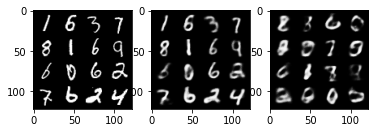

Iter: 18710/50000, Recon loss: 6062.2480, KL div loss: 1352.4972, Total loss: 7414.7451
Iter: 18720/50000, Recon loss: 6265.0972, KL div loss: 1259.1296, Total loss: 7524.2266
Iter: 18730/50000, Recon loss: 5798.1636, KL div loss: 1238.0037, Total loss: 7036.1670
Iter: 18740/50000, Recon loss: 6126.0356, KL div loss: 1249.0365, Total loss: 7375.0723
Iter: 18750/50000, Recon loss: 6350.2568, KL div loss: 1344.3528, Total loss: 7694.6094


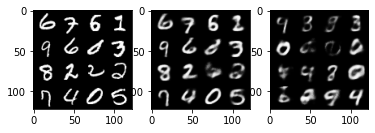

Iter: 18760/50000, Recon loss: 5966.9404, KL div loss: 1267.0000, Total loss: 7233.9404
Iter: 18770/50000, Recon loss: 6405.2764, KL div loss: 1317.1179, Total loss: 7722.3945
Iter: 18780/50000, Recon loss: 6181.2593, KL div loss: 1272.2539, Total loss: 7453.5132
Iter: 18790/50000, Recon loss: 5952.4209, KL div loss: 1277.9756, Total loss: 7230.3965
Iter: 18800/50000, Recon loss: 5908.6772, KL div loss: 1277.2705, Total loss: 7185.9478


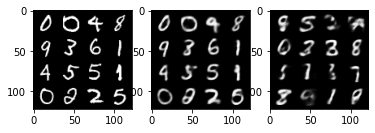

Iter: 18810/50000, Recon loss: 5809.8291, KL div loss: 1277.5630, Total loss: 7087.3921
Iter: 18820/50000, Recon loss: 6182.8247, KL div loss: 1286.9292, Total loss: 7469.7539
Iter: 18830/50000, Recon loss: 5972.9204, KL div loss: 1252.7631, Total loss: 7225.6836
Iter: 18840/50000, Recon loss: 6093.2842, KL div loss: 1255.3781, Total loss: 7348.6621
Iter: 18850/50000, Recon loss: 6015.2817, KL div loss: 1276.8777, Total loss: 7292.1592


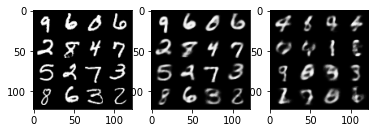

Iter: 18860/50000, Recon loss: 6473.4946, KL div loss: 1341.5758, Total loss: 7815.0703
Iter: 18870/50000, Recon loss: 6170.5889, KL div loss: 1317.8513, Total loss: 7488.4404
Iter: 18880/50000, Recon loss: 6294.4170, KL div loss: 1270.2302, Total loss: 7564.6475
Iter: 18890/50000, Recon loss: 6247.6006, KL div loss: 1316.5605, Total loss: 7564.1611
Iter: 18900/50000, Recon loss: 5993.3281, KL div loss: 1261.8684, Total loss: 7255.1963


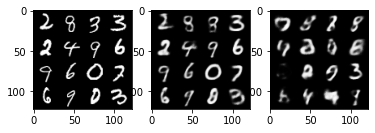

Iter: 18910/50000, Recon loss: 6167.7373, KL div loss: 1289.3580, Total loss: 7457.0952
Iter: 18920/50000, Recon loss: 5948.5889, KL div loss: 1304.6381, Total loss: 7253.2271
Iter: 18930/50000, Recon loss: 6204.2148, KL div loss: 1286.9396, Total loss: 7491.1543
Iter: 18940/50000, Recon loss: 5936.5049, KL div loss: 1256.4993, Total loss: 7193.0039
Iter: 18950/50000, Recon loss: 5884.1519, KL div loss: 1266.4518, Total loss: 7150.6035


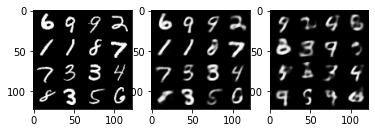

Iter: 18960/50000, Recon loss: 6502.2930, KL div loss: 1245.3455, Total loss: 7747.6387
Iter: 18970/50000, Recon loss: 6238.2964, KL div loss: 1269.3378, Total loss: 7507.6343
Iter: 18980/50000, Recon loss: 6277.4082, KL div loss: 1232.1443, Total loss: 7509.5527
Iter: 18990/50000, Recon loss: 6087.4287, KL div loss: 1278.6329, Total loss: 7366.0615
Iter: 19000/50000, Recon loss: 5787.8076, KL div loss: 1316.1177, Total loss: 7103.9253


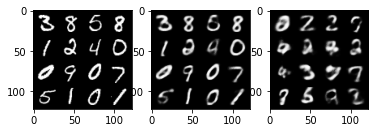

Iter: 19010/50000, Recon loss: 6229.4893, KL div loss: 1334.1951, Total loss: 7563.6846
Iter: 19020/50000, Recon loss: 6053.1787, KL div loss: 1304.7966, Total loss: 7357.9756
Iter: 19030/50000, Recon loss: 6116.0684, KL div loss: 1281.7926, Total loss: 7397.8608
Iter: 19040/50000, Recon loss: 6301.0986, KL div loss: 1290.8145, Total loss: 7591.9131
Iter: 19050/50000, Recon loss: 6088.5400, KL div loss: 1299.1809, Total loss: 7387.7207


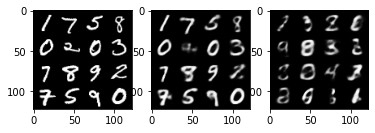

Iter: 19060/50000, Recon loss: 6375.5229, KL div loss: 1305.3138, Total loss: 7680.8369
Iter: 19070/50000, Recon loss: 6069.6641, KL div loss: 1295.4214, Total loss: 7365.0854
Iter: 19080/50000, Recon loss: 6158.2266, KL div loss: 1326.2531, Total loss: 7484.4795
Iter: 19090/50000, Recon loss: 6141.9375, KL div loss: 1276.2957, Total loss: 7418.2334
Iter: 19100/50000, Recon loss: 6491.3418, KL div loss: 1333.9741, Total loss: 7825.3159


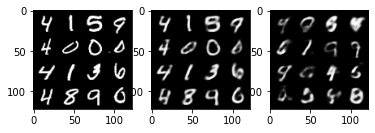

Iter: 19110/50000, Recon loss: 6174.9399, KL div loss: 1284.3182, Total loss: 7459.2583
Iter: 19120/50000, Recon loss: 5616.3281, KL div loss: 1238.5443, Total loss: 6854.8726
Iter: 19130/50000, Recon loss: 6110.2285, KL div loss: 1281.5863, Total loss: 7391.8149
Iter: 19140/50000, Recon loss: 5852.3247, KL div loss: 1287.9567, Total loss: 7140.2812
Iter: 19150/50000, Recon loss: 6400.2842, KL div loss: 1286.5709, Total loss: 7686.8550


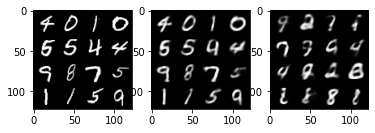

Iter: 19160/50000, Recon loss: 5662.6978, KL div loss: 1254.7474, Total loss: 6917.4453
Iter: 19170/50000, Recon loss: 5901.4062, KL div loss: 1249.8472, Total loss: 7151.2534
Iter: 19180/50000, Recon loss: 5956.0776, KL div loss: 1266.7065, Total loss: 7222.7842
Iter: 19190/50000, Recon loss: 6650.3916, KL div loss: 1317.9351, Total loss: 7968.3267
Iter: 19200/50000, Recon loss: 5713.6309, KL div loss: 1306.4291, Total loss: 7020.0601


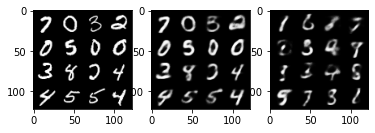

Iter: 19210/50000, Recon loss: 6402.8472, KL div loss: 1349.1097, Total loss: 7751.9570
Iter: 19220/50000, Recon loss: 6164.2715, KL div loss: 1278.3735, Total loss: 7442.6450
Iter: 19230/50000, Recon loss: 6519.9272, KL div loss: 1333.4939, Total loss: 7853.4209
Iter: 19240/50000, Recon loss: 5761.8701, KL div loss: 1327.1086, Total loss: 7088.9785
Iter: 19250/50000, Recon loss: 6180.9512, KL div loss: 1239.6180, Total loss: 7420.5693


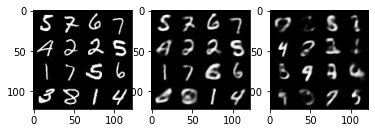

Iter: 19260/50000, Recon loss: 5945.7227, KL div loss: 1295.4675, Total loss: 7241.1904
Iter: 19270/50000, Recon loss: 6029.2725, KL div loss: 1316.3433, Total loss: 7345.6157
Iter: 19280/50000, Recon loss: 6229.4238, KL div loss: 1309.1207, Total loss: 7538.5444
Iter: 19290/50000, Recon loss: 6265.0654, KL div loss: 1314.6726, Total loss: 7579.7383
Iter: 19300/50000, Recon loss: 6113.4980, KL div loss: 1271.4907, Total loss: 7384.9888


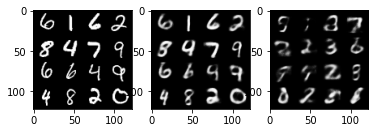

Iter: 19310/50000, Recon loss: 6189.5586, KL div loss: 1229.5942, Total loss: 7419.1528
Iter: 19320/50000, Recon loss: 6120.5615, KL div loss: 1276.7083, Total loss: 7397.2695
Iter: 19330/50000, Recon loss: 6017.8442, KL div loss: 1233.4753, Total loss: 7251.3193
Iter: 19340/50000, Recon loss: 5953.2314, KL div loss: 1297.1686, Total loss: 7250.3999
Iter: 19350/50000, Recon loss: 5750.0977, KL div loss: 1254.6375, Total loss: 7004.7354


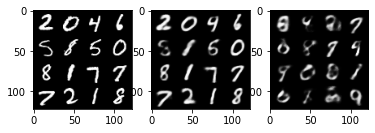

Iter: 19360/50000, Recon loss: 6371.2041, KL div loss: 1278.5388, Total loss: 7649.7432
Iter: 19370/50000, Recon loss: 5742.0454, KL div loss: 1279.8915, Total loss: 7021.9370
Iter: 19380/50000, Recon loss: 6152.3774, KL div loss: 1309.6543, Total loss: 7462.0317
Iter: 19390/50000, Recon loss: 5683.4873, KL div loss: 1246.8883, Total loss: 6930.3755
Iter: 19400/50000, Recon loss: 6207.6289, KL div loss: 1256.7296, Total loss: 7464.3584


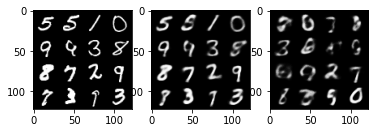

Iter: 19410/50000, Recon loss: 6139.8291, KL div loss: 1301.3854, Total loss: 7441.2144
Iter: 19420/50000, Recon loss: 6251.4121, KL div loss: 1331.6042, Total loss: 7583.0166
Iter: 19430/50000, Recon loss: 5693.4951, KL div loss: 1242.2122, Total loss: 6935.7070
Iter: 19440/50000, Recon loss: 6057.2959, KL div loss: 1321.1604, Total loss: 7378.4561
Iter: 19450/50000, Recon loss: 6356.9492, KL div loss: 1290.2563, Total loss: 7647.2056


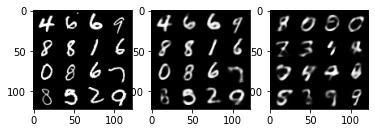

Iter: 19460/50000, Recon loss: 5945.0166, KL div loss: 1303.2952, Total loss: 7248.3115
Iter: 19470/50000, Recon loss: 5989.2729, KL div loss: 1280.6880, Total loss: 7269.9609
Iter: 19480/50000, Recon loss: 5805.5342, KL div loss: 1326.2288, Total loss: 7131.7627
Iter: 19490/50000, Recon loss: 5926.4829, KL div loss: 1272.4264, Total loss: 7198.9092
Iter: 19500/50000, Recon loss: 5963.6338, KL div loss: 1307.6906, Total loss: 7271.3242


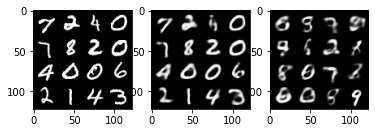

Iter: 19510/50000, Recon loss: 6062.1035, KL div loss: 1297.2849, Total loss: 7359.3887
Iter: 19520/50000, Recon loss: 6155.6880, KL div loss: 1286.1470, Total loss: 7441.8350
Iter: 19530/50000, Recon loss: 5486.2021, KL div loss: 1272.2616, Total loss: 6758.4639
Iter: 19540/50000, Recon loss: 5835.7412, KL div loss: 1276.8308, Total loss: 7112.5723
Iter: 19550/50000, Recon loss: 5668.2490, KL div loss: 1274.9888, Total loss: 6943.2378


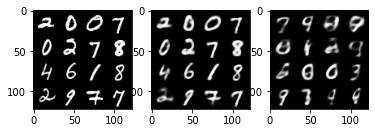

Iter: 19560/50000, Recon loss: 5748.8447, KL div loss: 1302.1012, Total loss: 7050.9458
Iter: 19570/50000, Recon loss: 6382.3242, KL div loss: 1302.3654, Total loss: 7684.6895
Iter: 19580/50000, Recon loss: 6205.6489, KL div loss: 1288.2744, Total loss: 7493.9233
Iter: 19590/50000, Recon loss: 6380.7397, KL div loss: 1332.9144, Total loss: 7713.6543
Iter: 19600/50000, Recon loss: 6126.1777, KL div loss: 1295.8280, Total loss: 7422.0059


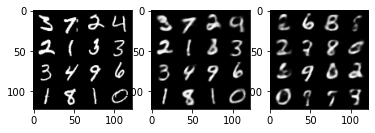

Iter: 19610/50000, Recon loss: 5595.4902, KL div loss: 1281.8511, Total loss: 6877.3413
Iter: 19620/50000, Recon loss: 5951.9644, KL div loss: 1292.9216, Total loss: 7244.8857
Iter: 19630/50000, Recon loss: 6017.8394, KL div loss: 1285.4299, Total loss: 7303.2695
Iter: 19640/50000, Recon loss: 6648.9365, KL div loss: 1349.5005, Total loss: 7998.4370
Iter: 19650/50000, Recon loss: 6016.3750, KL div loss: 1288.7153, Total loss: 7305.0903


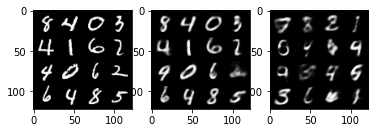

Iter: 19660/50000, Recon loss: 6172.8691, KL div loss: 1238.1199, Total loss: 7410.9893
Iter: 19670/50000, Recon loss: 6208.2197, KL div loss: 1301.7280, Total loss: 7509.9478
Iter: 19680/50000, Recon loss: 5943.4570, KL div loss: 1318.5803, Total loss: 7262.0371
Iter: 19690/50000, Recon loss: 6022.9160, KL div loss: 1305.0404, Total loss: 7327.9565
Iter: 19700/50000, Recon loss: 5909.4365, KL div loss: 1276.1674, Total loss: 7185.6040


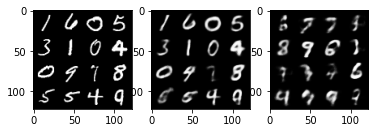

Iter: 19710/50000, Recon loss: 6019.0557, KL div loss: 1311.8242, Total loss: 7330.8799
Iter: 19720/50000, Recon loss: 6059.9756, KL div loss: 1299.1727, Total loss: 7359.1484
Iter: 19730/50000, Recon loss: 6275.5459, KL div loss: 1328.3373, Total loss: 7603.8833
Iter: 19740/50000, Recon loss: 6102.0391, KL div loss: 1320.5786, Total loss: 7422.6177
Iter: 19750/50000, Recon loss: 5861.4927, KL div loss: 1257.6306, Total loss: 7119.1230


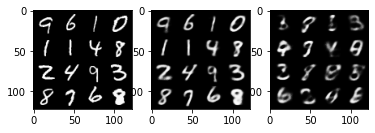

Iter: 19760/50000, Recon loss: 6030.7539, KL div loss: 1291.9596, Total loss: 7322.7134
Iter: 19770/50000, Recon loss: 6056.4077, KL div loss: 1265.6785, Total loss: 7322.0859
Iter: 19780/50000, Recon loss: 6146.0508, KL div loss: 1251.8770, Total loss: 7397.9277
Iter: 19790/50000, Recon loss: 6178.4585, KL div loss: 1343.8247, Total loss: 7522.2832
Iter: 19800/50000, Recon loss: 6244.1875, KL div loss: 1308.5928, Total loss: 7552.7803


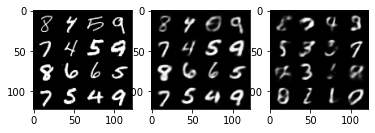

Iter: 19810/50000, Recon loss: 6333.3726, KL div loss: 1337.6654, Total loss: 7671.0381
Iter: 19820/50000, Recon loss: 5828.5073, KL div loss: 1336.2324, Total loss: 7164.7397
Iter: 19830/50000, Recon loss: 5975.6963, KL div loss: 1269.4984, Total loss: 7245.1948
Iter: 19840/50000, Recon loss: 5773.6660, KL div loss: 1246.1085, Total loss: 7019.7744
Iter: 19850/50000, Recon loss: 6194.9932, KL div loss: 1265.0017, Total loss: 7459.9951


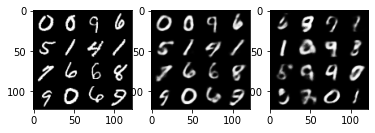

Iter: 19860/50000, Recon loss: 6252.0293, KL div loss: 1355.1703, Total loss: 7607.1997
Iter: 19870/50000, Recon loss: 5988.0762, KL div loss: 1285.0508, Total loss: 7273.1270
Iter: 19880/50000, Recon loss: 5492.6582, KL div loss: 1259.3521, Total loss: 6752.0103
Iter: 19890/50000, Recon loss: 6106.6348, KL div loss: 1265.7384, Total loss: 7372.3730
Iter: 19900/50000, Recon loss: 6258.6001, KL div loss: 1297.3949, Total loss: 7555.9951


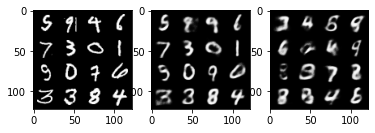

Iter: 19910/50000, Recon loss: 5773.0840, KL div loss: 1280.0754, Total loss: 7053.1592
Iter: 19920/50000, Recon loss: 6086.1553, KL div loss: 1327.7183, Total loss: 7413.8735
Iter: 19930/50000, Recon loss: 6531.7593, KL div loss: 1348.7471, Total loss: 7880.5063
Iter: 19940/50000, Recon loss: 5774.4370, KL div loss: 1307.2920, Total loss: 7081.7290
Iter: 19950/50000, Recon loss: 5944.3569, KL div loss: 1328.7209, Total loss: 7273.0781


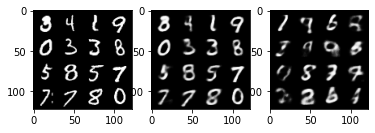

Iter: 19960/50000, Recon loss: 6045.5088, KL div loss: 1326.6995, Total loss: 7372.2080
Iter: 19970/50000, Recon loss: 5734.4346, KL div loss: 1292.5121, Total loss: 7026.9468
Iter: 19980/50000, Recon loss: 6114.1938, KL div loss: 1289.4130, Total loss: 7403.6069
Iter: 19990/50000, Recon loss: 5886.4473, KL div loss: 1265.1110, Total loss: 7151.5581
Iter: 20000/50000, Recon loss: 5879.7920, KL div loss: 1328.0336, Total loss: 7207.8257


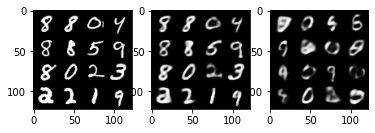

Iter: 20010/50000, Recon loss: 6106.0664, KL div loss: 1292.6450, Total loss: 7398.7114
Iter: 20020/50000, Recon loss: 5783.8965, KL div loss: 1279.4961, Total loss: 7063.3926
Iter: 20030/50000, Recon loss: 6320.1113, KL div loss: 1308.1101, Total loss: 7628.2217
Iter: 20040/50000, Recon loss: 5953.3911, KL div loss: 1277.5427, Total loss: 7230.9336
Iter: 20050/50000, Recon loss: 6064.0312, KL div loss: 1310.0625, Total loss: 7374.0938


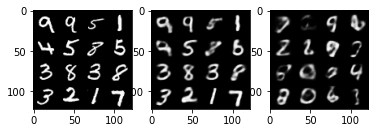

Iter: 20060/50000, Recon loss: 6164.9521, KL div loss: 1317.7762, Total loss: 7482.7285
Iter: 20070/50000, Recon loss: 6059.5215, KL div loss: 1344.6326, Total loss: 7404.1543
Iter: 20080/50000, Recon loss: 5964.0513, KL div loss: 1295.1666, Total loss: 7259.2178
Iter: 20090/50000, Recon loss: 6163.0488, KL div loss: 1295.6451, Total loss: 7458.6938
Iter: 20100/50000, Recon loss: 5956.5654, KL div loss: 1294.0330, Total loss: 7250.5986


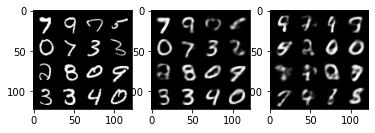

Iter: 20110/50000, Recon loss: 5957.9609, KL div loss: 1280.7987, Total loss: 7238.7598
Iter: 20120/50000, Recon loss: 6007.8755, KL div loss: 1344.0740, Total loss: 7351.9492
Iter: 20130/50000, Recon loss: 5964.3921, KL div loss: 1322.3113, Total loss: 7286.7031
Iter: 20140/50000, Recon loss: 6006.3477, KL div loss: 1295.2629, Total loss: 7301.6104
Iter: 20150/50000, Recon loss: 6016.2485, KL div loss: 1330.8274, Total loss: 7347.0762


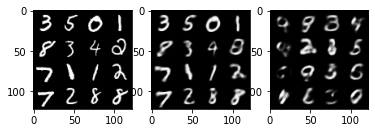

Iter: 20160/50000, Recon loss: 5904.2246, KL div loss: 1304.6758, Total loss: 7208.9004
Iter: 20170/50000, Recon loss: 5786.8618, KL div loss: 1263.0974, Total loss: 7049.9590
Iter: 20180/50000, Recon loss: 5922.1143, KL div loss: 1281.3195, Total loss: 7203.4336
Iter: 20190/50000, Recon loss: 5847.6211, KL div loss: 1328.7305, Total loss: 7176.3516
Iter: 20200/50000, Recon loss: 5634.3906, KL div loss: 1257.6907, Total loss: 6892.0811


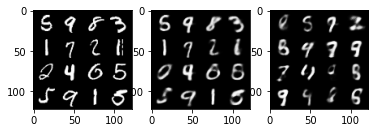

Iter: 20210/50000, Recon loss: 6176.0781, KL div loss: 1296.4191, Total loss: 7472.4971
Iter: 20220/50000, Recon loss: 7021.0215, KL div loss: 1348.5250, Total loss: 8369.5469
Iter: 20230/50000, Recon loss: 6071.7515, KL div loss: 1295.2900, Total loss: 7367.0415
Iter: 20240/50000, Recon loss: 5486.3252, KL div loss: 1262.0271, Total loss: 6748.3525
Iter: 20250/50000, Recon loss: 6290.8096, KL div loss: 1347.6975, Total loss: 7638.5068


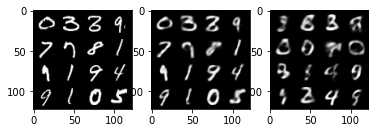

Iter: 20260/50000, Recon loss: 6294.3481, KL div loss: 1295.1173, Total loss: 7589.4653
Iter: 20270/50000, Recon loss: 5990.9546, KL div loss: 1311.1917, Total loss: 7302.1465
Iter: 20280/50000, Recon loss: 6070.9951, KL div loss: 1318.3623, Total loss: 7389.3574
Iter: 20290/50000, Recon loss: 6265.5317, KL div loss: 1306.8361, Total loss: 7572.3677
Iter: 20300/50000, Recon loss: 6104.0342, KL div loss: 1315.1580, Total loss: 7419.1924


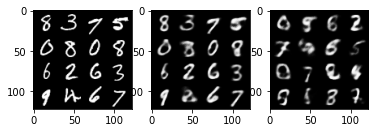

Iter: 20310/50000, Recon loss: 5951.3369, KL div loss: 1352.4432, Total loss: 7303.7803
Iter: 20320/50000, Recon loss: 6111.2739, KL div loss: 1325.0969, Total loss: 7436.3711
Iter: 20330/50000, Recon loss: 5956.1104, KL div loss: 1319.9932, Total loss: 7276.1035
Iter: 20340/50000, Recon loss: 6186.2178, KL div loss: 1275.0159, Total loss: 7461.2334
Iter: 20350/50000, Recon loss: 6004.6406, KL div loss: 1333.8850, Total loss: 7338.5254


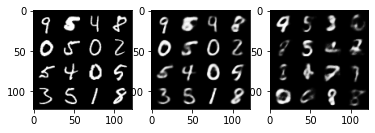

Iter: 20360/50000, Recon loss: 5872.6709, KL div loss: 1316.8621, Total loss: 7189.5332
Iter: 20370/50000, Recon loss: 5871.6641, KL div loss: 1319.1992, Total loss: 7190.8633
Iter: 20380/50000, Recon loss: 5766.1045, KL div loss: 1276.3156, Total loss: 7042.4199
Iter: 20390/50000, Recon loss: 6148.9258, KL div loss: 1278.9387, Total loss: 7427.8643
Iter: 20400/50000, Recon loss: 5971.9858, KL div loss: 1296.2964, Total loss: 7268.2822


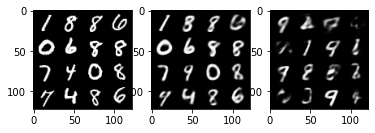

Iter: 20410/50000, Recon loss: 6285.3877, KL div loss: 1341.9850, Total loss: 7627.3726
Iter: 20420/50000, Recon loss: 5940.8140, KL div loss: 1314.6433, Total loss: 7255.4570
Iter: 20430/50000, Recon loss: 5820.9141, KL div loss: 1292.4385, Total loss: 7113.3525
Iter: 20440/50000, Recon loss: 5593.8638, KL div loss: 1315.0105, Total loss: 6908.8740
Iter: 20450/50000, Recon loss: 5903.7505, KL div loss: 1329.2834, Total loss: 7233.0342


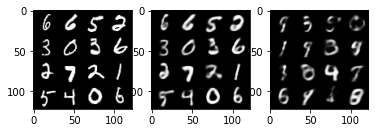

Iter: 20460/50000, Recon loss: 5789.7158, KL div loss: 1288.5168, Total loss: 7078.2324
Iter: 20470/50000, Recon loss: 5776.8862, KL div loss: 1246.1372, Total loss: 7023.0234
Iter: 20480/50000, Recon loss: 6181.1235, KL div loss: 1299.9214, Total loss: 7481.0449
Iter: 20490/50000, Recon loss: 6219.4531, KL div loss: 1282.4266, Total loss: 7501.8799
Iter: 20500/50000, Recon loss: 6302.5088, KL div loss: 1345.2107, Total loss: 7647.7197


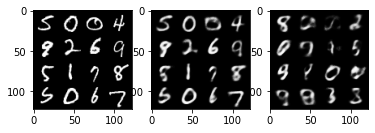

Iter: 20510/50000, Recon loss: 6020.6963, KL div loss: 1322.9812, Total loss: 7343.6777
Iter: 20520/50000, Recon loss: 6185.7900, KL div loss: 1295.0571, Total loss: 7480.8472
Iter: 20530/50000, Recon loss: 6031.2119, KL div loss: 1304.1770, Total loss: 7335.3887
Iter: 20540/50000, Recon loss: 6145.7227, KL div loss: 1339.0305, Total loss: 7484.7529
Iter: 20550/50000, Recon loss: 6001.6094, KL div loss: 1318.7826, Total loss: 7320.3921


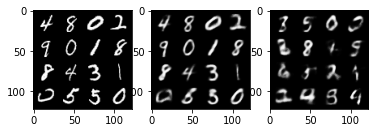

Iter: 20560/50000, Recon loss: 6199.2275, KL div loss: 1317.6361, Total loss: 7516.8638
Iter: 20570/50000, Recon loss: 5904.6680, KL div loss: 1308.1648, Total loss: 7212.8330
Iter: 20580/50000, Recon loss: 5728.6191, KL div loss: 1234.6626, Total loss: 6963.2817
Iter: 20590/50000, Recon loss: 6366.8389, KL div loss: 1301.9199, Total loss: 7668.7588
Iter: 20600/50000, Recon loss: 6289.9893, KL div loss: 1356.8894, Total loss: 7646.8789


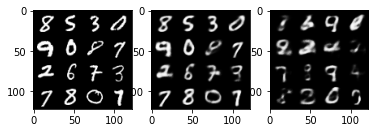

Iter: 20610/50000, Recon loss: 6115.6201, KL div loss: 1279.3616, Total loss: 7394.9814
Iter: 20620/50000, Recon loss: 6370.0708, KL div loss: 1312.5253, Total loss: 7682.5962
Iter: 20630/50000, Recon loss: 5913.4932, KL div loss: 1292.2484, Total loss: 7205.7417
Iter: 20640/50000, Recon loss: 5902.6230, KL div loss: 1295.2871, Total loss: 7197.9102
Iter: 20650/50000, Recon loss: 5817.4980, KL div loss: 1320.0856, Total loss: 7137.5835


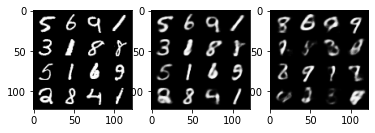

Iter: 20660/50000, Recon loss: 6018.1758, KL div loss: 1305.7585, Total loss: 7323.9346
Iter: 20670/50000, Recon loss: 5390.0894, KL div loss: 1253.4105, Total loss: 6643.5000
Iter: 20680/50000, Recon loss: 5439.9727, KL div loss: 1284.0474, Total loss: 6724.0200
Iter: 20690/50000, Recon loss: 6070.6963, KL div loss: 1307.7432, Total loss: 7378.4395
Iter: 20700/50000, Recon loss: 6268.8994, KL div loss: 1300.5591, Total loss: 7569.4585


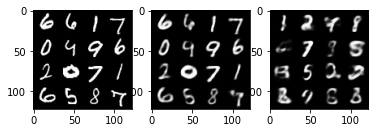

Iter: 20710/50000, Recon loss: 5809.6104, KL div loss: 1304.8357, Total loss: 7114.4463
Iter: 20720/50000, Recon loss: 6363.7622, KL div loss: 1356.1255, Total loss: 7719.8877
Iter: 20730/50000, Recon loss: 5893.6943, KL div loss: 1289.2847, Total loss: 7182.9790
Iter: 20740/50000, Recon loss: 6370.0215, KL div loss: 1335.9358, Total loss: 7705.9570
Iter: 20750/50000, Recon loss: 5857.5859, KL div loss: 1321.5852, Total loss: 7179.1709


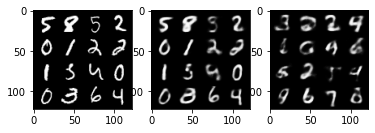

Iter: 20760/50000, Recon loss: 6129.1934, KL div loss: 1337.2725, Total loss: 7466.4658
Iter: 20770/50000, Recon loss: 6007.8740, KL div loss: 1300.0267, Total loss: 7307.9009
Iter: 20780/50000, Recon loss: 5905.0269, KL div loss: 1229.2543, Total loss: 7134.2812
Iter: 20790/50000, Recon loss: 6089.8047, KL div loss: 1281.1632, Total loss: 7370.9678
Iter: 20800/50000, Recon loss: 6199.3188, KL div loss: 1299.7188, Total loss: 7499.0376


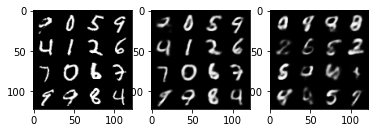

Iter: 20810/50000, Recon loss: 5896.8071, KL div loss: 1324.9753, Total loss: 7221.7822
Iter: 20820/50000, Recon loss: 6133.8975, KL div loss: 1312.6237, Total loss: 7446.5210
Iter: 20830/50000, Recon loss: 5910.7739, KL div loss: 1302.6494, Total loss: 7213.4233
Iter: 20840/50000, Recon loss: 6064.6924, KL div loss: 1304.7407, Total loss: 7369.4331
Iter: 20850/50000, Recon loss: 6513.6016, KL div loss: 1290.1665, Total loss: 7803.7681


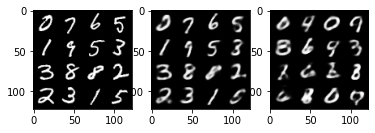

Iter: 20860/50000, Recon loss: 6079.7104, KL div loss: 1316.2979, Total loss: 7396.0083
Iter: 20870/50000, Recon loss: 6238.3921, KL div loss: 1322.2656, Total loss: 7560.6577
Iter: 20880/50000, Recon loss: 5932.5303, KL div loss: 1350.0819, Total loss: 7282.6123
Iter: 20890/50000, Recon loss: 6342.3384, KL div loss: 1366.8401, Total loss: 7709.1787
Iter: 20900/50000, Recon loss: 6112.8184, KL div loss: 1273.4651, Total loss: 7386.2832


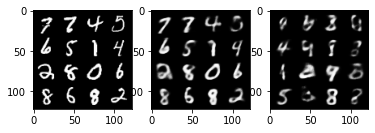

Iter: 20910/50000, Recon loss: 6337.0264, KL div loss: 1338.0754, Total loss: 7675.1016
Iter: 20920/50000, Recon loss: 6112.7778, KL div loss: 1298.9049, Total loss: 7411.6826
Iter: 20930/50000, Recon loss: 5932.2651, KL div loss: 1336.8859, Total loss: 7269.1509
Iter: 20940/50000, Recon loss: 5979.8926, KL div loss: 1274.9380, Total loss: 7254.8306
Iter: 20950/50000, Recon loss: 5963.4673, KL div loss: 1348.7103, Total loss: 7312.1777


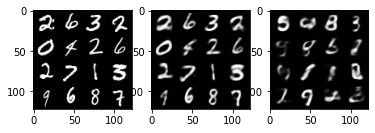

Iter: 20960/50000, Recon loss: 6005.3838, KL div loss: 1286.7134, Total loss: 7292.0972
Iter: 20970/50000, Recon loss: 6499.0161, KL div loss: 1358.5244, Total loss: 7857.5405
Iter: 20980/50000, Recon loss: 5832.8462, KL div loss: 1317.4420, Total loss: 7150.2881
Iter: 20990/50000, Recon loss: 5824.6733, KL div loss: 1296.1174, Total loss: 7120.7910
Iter: 21000/50000, Recon loss: 5846.7642, KL div loss: 1278.2360, Total loss: 7125.0000


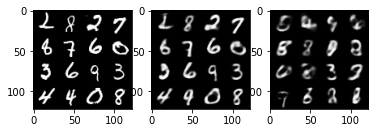

Iter: 21010/50000, Recon loss: 6095.7534, KL div loss: 1341.2932, Total loss: 7437.0469
Iter: 21020/50000, Recon loss: 6198.7637, KL div loss: 1374.1335, Total loss: 7572.8975
Iter: 21030/50000, Recon loss: 5665.5791, KL div loss: 1278.3707, Total loss: 6943.9497
Iter: 21040/50000, Recon loss: 5935.2031, KL div loss: 1328.5602, Total loss: 7263.7632
Iter: 21050/50000, Recon loss: 6188.1650, KL div loss: 1271.1010, Total loss: 7459.2661


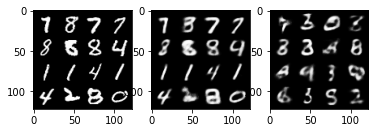

Iter: 21060/50000, Recon loss: 6012.1406, KL div loss: 1322.5977, Total loss: 7334.7383
Iter: 21070/50000, Recon loss: 6051.4106, KL div loss: 1307.8567, Total loss: 7359.2676
Iter: 21080/50000, Recon loss: 6315.1426, KL div loss: 1348.0115, Total loss: 7663.1543
Iter: 21090/50000, Recon loss: 6155.5918, KL div loss: 1327.0012, Total loss: 7482.5928
Iter: 21100/50000, Recon loss: 5925.0420, KL div loss: 1317.6263, Total loss: 7242.6685


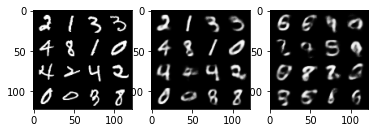

Iter: 21110/50000, Recon loss: 6112.9346, KL div loss: 1314.6461, Total loss: 7427.5806
Iter: 21120/50000, Recon loss: 6151.3818, KL div loss: 1351.3640, Total loss: 7502.7461
Iter: 21130/50000, Recon loss: 6031.1577, KL div loss: 1308.4265, Total loss: 7339.5840
Iter: 21140/50000, Recon loss: 5923.2207, KL div loss: 1278.8108, Total loss: 7202.0312
Iter: 21150/50000, Recon loss: 6181.0439, KL div loss: 1333.6719, Total loss: 7514.7158


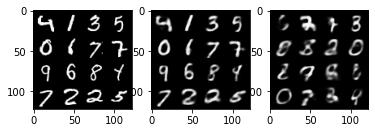

Iter: 21160/50000, Recon loss: 5984.6748, KL div loss: 1318.2791, Total loss: 7302.9541
Iter: 21170/50000, Recon loss: 5863.3364, KL div loss: 1288.7953, Total loss: 7152.1318
Iter: 21180/50000, Recon loss: 6450.6133, KL div loss: 1316.5582, Total loss: 7767.1714
Iter: 21190/50000, Recon loss: 5759.3135, KL div loss: 1278.4563, Total loss: 7037.7695
Iter: 21200/50000, Recon loss: 6191.9487, KL div loss: 1324.6379, Total loss: 7516.5869


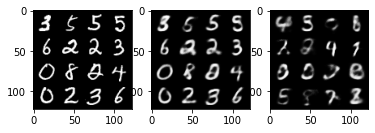

Iter: 21210/50000, Recon loss: 5801.9473, KL div loss: 1304.0212, Total loss: 7105.9688
Iter: 21220/50000, Recon loss: 5673.8496, KL div loss: 1268.6804, Total loss: 6942.5303
Iter: 21230/50000, Recon loss: 6214.0596, KL div loss: 1318.1033, Total loss: 7532.1631
Iter: 21240/50000, Recon loss: 6285.6250, KL div loss: 1354.9954, Total loss: 7640.6201
Iter: 21250/50000, Recon loss: 5720.3291, KL div loss: 1287.6548, Total loss: 7007.9839


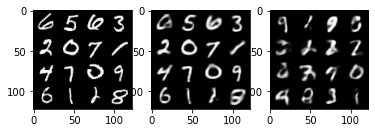

Iter: 21260/50000, Recon loss: 5942.4204, KL div loss: 1295.6403, Total loss: 7238.0605
Iter: 21270/50000, Recon loss: 6164.5508, KL div loss: 1332.1169, Total loss: 7496.6680
Iter: 21280/50000, Recon loss: 5924.1553, KL div loss: 1271.3502, Total loss: 7195.5054
Iter: 21290/50000, Recon loss: 6321.0854, KL div loss: 1335.0803, Total loss: 7656.1660
Iter: 21300/50000, Recon loss: 6042.8569, KL div loss: 1306.3900, Total loss: 7349.2471


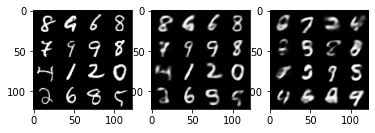

Iter: 21310/50000, Recon loss: 6548.0234, KL div loss: 1326.8682, Total loss: 7874.8916
Iter: 21320/50000, Recon loss: 5649.7173, KL div loss: 1301.1614, Total loss: 6950.8789
Iter: 21330/50000, Recon loss: 6151.4814, KL div loss: 1354.0236, Total loss: 7505.5049
Iter: 21340/50000, Recon loss: 6093.1074, KL div loss: 1305.5099, Total loss: 7398.6172
Iter: 21350/50000, Recon loss: 6087.0244, KL div loss: 1364.4912, Total loss: 7451.5156


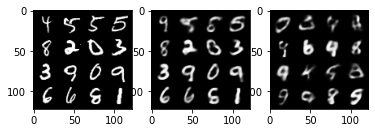

Iter: 21360/50000, Recon loss: 6162.5781, KL div loss: 1312.2689, Total loss: 7474.8472
Iter: 21370/50000, Recon loss: 5841.2559, KL div loss: 1308.1919, Total loss: 7149.4478
Iter: 21380/50000, Recon loss: 6081.0928, KL div loss: 1299.5508, Total loss: 7380.6436
Iter: 21390/50000, Recon loss: 5689.0479, KL div loss: 1270.8567, Total loss: 6959.9043
Iter: 21400/50000, Recon loss: 6151.0957, KL div loss: 1319.3274, Total loss: 7470.4229


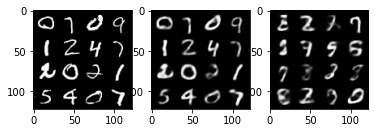

Iter: 21410/50000, Recon loss: 5746.9839, KL div loss: 1281.2024, Total loss: 7028.1865
Iter: 21420/50000, Recon loss: 6238.8574, KL div loss: 1368.5854, Total loss: 7607.4429
Iter: 21430/50000, Recon loss: 6239.1562, KL div loss: 1387.6182, Total loss: 7626.7744
Iter: 21440/50000, Recon loss: 5858.1729, KL div loss: 1364.5209, Total loss: 7222.6938
Iter: 21450/50000, Recon loss: 6110.9683, KL div loss: 1325.1686, Total loss: 7436.1367


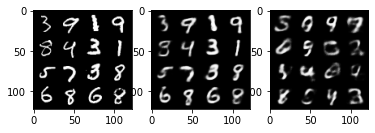

Iter: 21460/50000, Recon loss: 6126.6963, KL div loss: 1311.8242, Total loss: 7438.5205
Iter: 21470/50000, Recon loss: 5890.7588, KL div loss: 1279.6936, Total loss: 7170.4521
Iter: 21480/50000, Recon loss: 6084.7783, KL div loss: 1322.4951, Total loss: 7407.2734
Iter: 21490/50000, Recon loss: 6111.0981, KL div loss: 1327.9683, Total loss: 7439.0664
Iter: 21500/50000, Recon loss: 5870.9053, KL div loss: 1295.6321, Total loss: 7166.5371


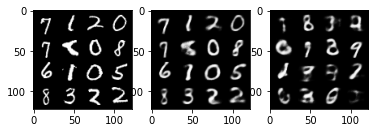

Iter: 21510/50000, Recon loss: 6001.6943, KL div loss: 1349.4818, Total loss: 7351.1763
Iter: 21520/50000, Recon loss: 5885.7822, KL div loss: 1302.6890, Total loss: 7188.4712
Iter: 21530/50000, Recon loss: 6060.6890, KL div loss: 1289.6157, Total loss: 7350.3047
Iter: 21540/50000, Recon loss: 5850.8545, KL div loss: 1313.6798, Total loss: 7164.5342
Iter: 21550/50000, Recon loss: 5861.0791, KL div loss: 1271.9297, Total loss: 7133.0088


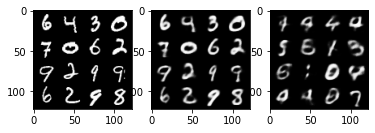

Iter: 21560/50000, Recon loss: 5948.8125, KL div loss: 1291.3413, Total loss: 7240.1538
Iter: 21570/50000, Recon loss: 6248.4365, KL div loss: 1287.0142, Total loss: 7535.4507
Iter: 21580/50000, Recon loss: 6043.7104, KL div loss: 1276.8566, Total loss: 7320.5669
Iter: 21590/50000, Recon loss: 5870.9883, KL div loss: 1333.6722, Total loss: 7204.6606
Iter: 21600/50000, Recon loss: 6101.7666, KL div loss: 1312.2551, Total loss: 7414.0215


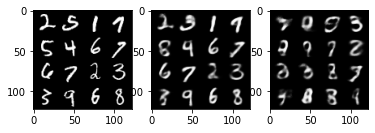

Iter: 21610/50000, Recon loss: 5676.1621, KL div loss: 1270.6440, Total loss: 6946.8062
Iter: 21620/50000, Recon loss: 6137.9961, KL div loss: 1347.1097, Total loss: 7485.1060
Iter: 21630/50000, Recon loss: 5603.0244, KL div loss: 1311.3367, Total loss: 6914.3613
Iter: 21640/50000, Recon loss: 5790.4546, KL div loss: 1312.1704, Total loss: 7102.6250
Iter: 21650/50000, Recon loss: 5839.0625, KL div loss: 1336.9437, Total loss: 7176.0063


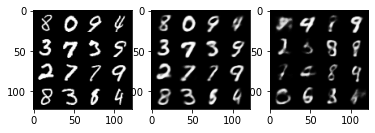

Iter: 21660/50000, Recon loss: 5732.9648, KL div loss: 1343.4744, Total loss: 7076.4395
Iter: 21670/50000, Recon loss: 5717.6826, KL div loss: 1302.2517, Total loss: 7019.9346
Iter: 21680/50000, Recon loss: 6073.3867, KL div loss: 1332.7734, Total loss: 7406.1602
Iter: 21690/50000, Recon loss: 5714.9922, KL div loss: 1316.7114, Total loss: 7031.7036
Iter: 21700/50000, Recon loss: 5926.4033, KL div loss: 1323.6257, Total loss: 7250.0293


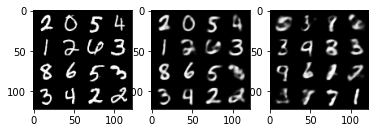

Iter: 21710/50000, Recon loss: 6193.3398, KL div loss: 1318.9824, Total loss: 7512.3223
Iter: 21720/50000, Recon loss: 6185.8994, KL div loss: 1314.7159, Total loss: 7500.6152
Iter: 21730/50000, Recon loss: 6124.4360, KL div loss: 1363.7870, Total loss: 7488.2231
Iter: 21740/50000, Recon loss: 6197.3965, KL div loss: 1331.9230, Total loss: 7529.3193
Iter: 21750/50000, Recon loss: 5576.1992, KL div loss: 1283.3147, Total loss: 6859.5137


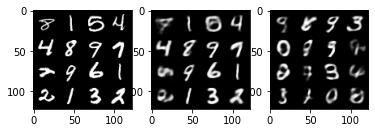

Iter: 21760/50000, Recon loss: 5602.9468, KL div loss: 1265.6422, Total loss: 6868.5889
Iter: 21770/50000, Recon loss: 5406.9170, KL div loss: 1221.9382, Total loss: 6628.8555
Iter: 21780/50000, Recon loss: 5671.3525, KL div loss: 1269.1194, Total loss: 6940.4717
Iter: 21790/50000, Recon loss: 6171.1885, KL div loss: 1320.1259, Total loss: 7491.3145
Iter: 21800/50000, Recon loss: 6161.5508, KL div loss: 1377.1270, Total loss: 7538.6777


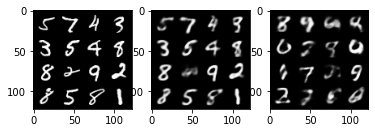

Iter: 21810/50000, Recon loss: 6135.8188, KL div loss: 1335.8477, Total loss: 7471.6665
Iter: 21820/50000, Recon loss: 6138.1387, KL div loss: 1392.3821, Total loss: 7530.5205
Iter: 21830/50000, Recon loss: 6024.2783, KL div loss: 1325.7050, Total loss: 7349.9834
Iter: 21840/50000, Recon loss: 5815.3652, KL div loss: 1295.8838, Total loss: 7111.2490
Iter: 21850/50000, Recon loss: 5675.0205, KL div loss: 1240.5707, Total loss: 6915.5913


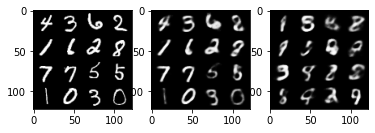

Iter: 21860/50000, Recon loss: 6014.6577, KL div loss: 1341.7211, Total loss: 7356.3789
Iter: 21870/50000, Recon loss: 6044.8896, KL div loss: 1300.6740, Total loss: 7345.5635
Iter: 21880/50000, Recon loss: 5897.1348, KL div loss: 1334.4681, Total loss: 7231.6030
Iter: 21890/50000, Recon loss: 6206.1494, KL div loss: 1344.9896, Total loss: 7551.1392
Iter: 21900/50000, Recon loss: 6001.4277, KL div loss: 1310.1075, Total loss: 7311.5352


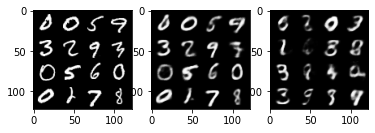

Iter: 21910/50000, Recon loss: 5731.8496, KL div loss: 1309.9089, Total loss: 7041.7588
Iter: 21920/50000, Recon loss: 6095.7324, KL div loss: 1351.8970, Total loss: 7447.6294
Iter: 21930/50000, Recon loss: 6613.7754, KL div loss: 1343.8806, Total loss: 7957.6562
Iter: 21940/50000, Recon loss: 5637.3735, KL div loss: 1328.7546, Total loss: 6966.1279
Iter: 21950/50000, Recon loss: 5459.8315, KL div loss: 1293.9406, Total loss: 6753.7720


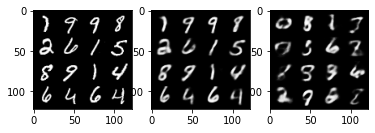

Iter: 21960/50000, Recon loss: 5736.2773, KL div loss: 1323.5151, Total loss: 7059.7925
Iter: 21970/50000, Recon loss: 5817.5996, KL div loss: 1312.8657, Total loss: 7130.4653
Iter: 21980/50000, Recon loss: 5699.6821, KL div loss: 1322.5210, Total loss: 7022.2031
Iter: 21990/50000, Recon loss: 6019.5781, KL div loss: 1332.9534, Total loss: 7352.5312
Iter: 22000/50000, Recon loss: 6060.1875, KL div loss: 1316.6636, Total loss: 7376.8511


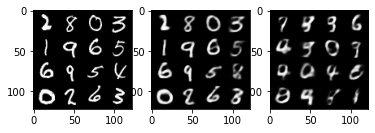

Iter: 22010/50000, Recon loss: 5788.4131, KL div loss: 1312.9291, Total loss: 7101.3423
Iter: 22020/50000, Recon loss: 6234.4077, KL div loss: 1343.0469, Total loss: 7577.4546
Iter: 22030/50000, Recon loss: 5998.7803, KL div loss: 1315.9274, Total loss: 7314.7075
Iter: 22040/50000, Recon loss: 6469.5332, KL div loss: 1357.1011, Total loss: 7826.6343
Iter: 22050/50000, Recon loss: 6073.6108, KL div loss: 1317.2264, Total loss: 7390.8374


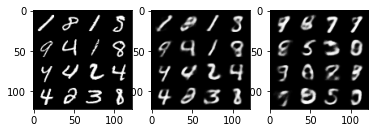

Iter: 22060/50000, Recon loss: 5842.2168, KL div loss: 1253.4941, Total loss: 7095.7109
Iter: 22070/50000, Recon loss: 5656.0806, KL div loss: 1305.3531, Total loss: 6961.4336
Iter: 22080/50000, Recon loss: 5993.6572, KL div loss: 1299.0905, Total loss: 7292.7476
Iter: 22090/50000, Recon loss: 5910.7393, KL div loss: 1351.1765, Total loss: 7261.9160
Iter: 22100/50000, Recon loss: 5962.7939, KL div loss: 1291.0205, Total loss: 7253.8145


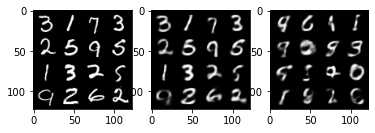

Iter: 22110/50000, Recon loss: 6264.0176, KL div loss: 1300.9988, Total loss: 7565.0166
Iter: 22120/50000, Recon loss: 5816.2964, KL div loss: 1321.2642, Total loss: 7137.5605
Iter: 22130/50000, Recon loss: 6019.9297, KL div loss: 1351.5123, Total loss: 7371.4419
Iter: 22140/50000, Recon loss: 6001.1089, KL div loss: 1342.2252, Total loss: 7343.3340
Iter: 22150/50000, Recon loss: 5289.8818, KL div loss: 1261.7346, Total loss: 6551.6162


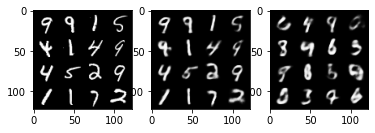

Iter: 22160/50000, Recon loss: 6001.2695, KL div loss: 1295.2999, Total loss: 7296.5693
Iter: 22170/50000, Recon loss: 6092.0601, KL div loss: 1325.4302, Total loss: 7417.4902
Iter: 22180/50000, Recon loss: 6079.0664, KL div loss: 1361.3955, Total loss: 7440.4619
Iter: 22190/50000, Recon loss: 5848.8481, KL div loss: 1359.4536, Total loss: 7208.3018
Iter: 22200/50000, Recon loss: 5857.7578, KL div loss: 1304.4060, Total loss: 7162.1641


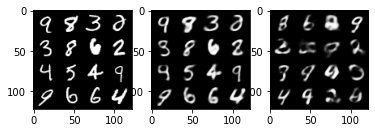

Iter: 22210/50000, Recon loss: 5569.0078, KL div loss: 1328.5291, Total loss: 6897.5371
Iter: 22220/50000, Recon loss: 5675.7061, KL div loss: 1296.0388, Total loss: 6971.7451
Iter: 22230/50000, Recon loss: 5964.8691, KL div loss: 1303.1506, Total loss: 7268.0195
Iter: 22240/50000, Recon loss: 5802.3096, KL div loss: 1280.3525, Total loss: 7082.6621
Iter: 22250/50000, Recon loss: 6312.1040, KL div loss: 1385.0522, Total loss: 7697.1562


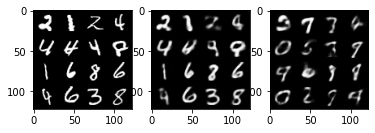

Iter: 22260/50000, Recon loss: 6193.0195, KL div loss: 1337.6875, Total loss: 7530.7070
Iter: 22270/50000, Recon loss: 5968.8628, KL div loss: 1315.5017, Total loss: 7284.3643
Iter: 22280/50000, Recon loss: 5894.9336, KL div loss: 1360.5166, Total loss: 7255.4502
Iter: 22290/50000, Recon loss: 5831.5391, KL div loss: 1316.3967, Total loss: 7147.9355
Iter: 22300/50000, Recon loss: 5799.7080, KL div loss: 1340.1492, Total loss: 7139.8574


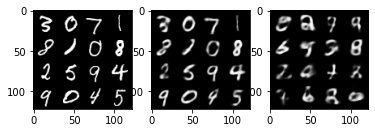

Iter: 22310/50000, Recon loss: 5526.7324, KL div loss: 1327.3843, Total loss: 6854.1167
Iter: 22320/50000, Recon loss: 5419.9272, KL div loss: 1305.8212, Total loss: 6725.7485
Iter: 22330/50000, Recon loss: 5721.2124, KL div loss: 1339.4724, Total loss: 7060.6846
Iter: 22340/50000, Recon loss: 5806.7036, KL div loss: 1314.6177, Total loss: 7121.3213
Iter: 22350/50000, Recon loss: 6156.2402, KL div loss: 1419.2487, Total loss: 7575.4888


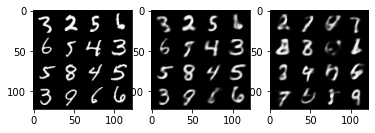

Iter: 22360/50000, Recon loss: 5598.5645, KL div loss: 1307.4703, Total loss: 6906.0347
Iter: 22370/50000, Recon loss: 5825.3872, KL div loss: 1331.0239, Total loss: 7156.4111
Iter: 22380/50000, Recon loss: 6163.0127, KL div loss: 1319.6086, Total loss: 7482.6211
Iter: 22390/50000, Recon loss: 5728.5479, KL div loss: 1327.0034, Total loss: 7055.5513
Iter: 22400/50000, Recon loss: 6012.9531, KL div loss: 1299.2864, Total loss: 7312.2393


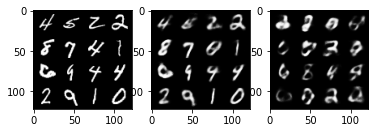

Iter: 22410/50000, Recon loss: 5731.7607, KL div loss: 1270.7119, Total loss: 7002.4727
Iter: 22420/50000, Recon loss: 6024.9756, KL div loss: 1351.7288, Total loss: 7376.7041
Iter: 22430/50000, Recon loss: 6183.5498, KL div loss: 1364.5220, Total loss: 7548.0718
Iter: 22440/50000, Recon loss: 5575.4697, KL div loss: 1319.0286, Total loss: 6894.4980
Iter: 22450/50000, Recon loss: 5866.0806, KL div loss: 1334.4648, Total loss: 7200.5454


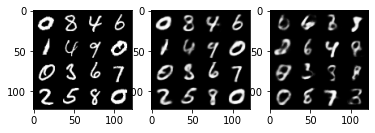

Iter: 22460/50000, Recon loss: 5821.3779, KL div loss: 1266.1536, Total loss: 7087.5312
Iter: 22470/50000, Recon loss: 6064.7163, KL div loss: 1350.6382, Total loss: 7415.3545
Iter: 22480/50000, Recon loss: 5658.9580, KL div loss: 1304.7621, Total loss: 6963.7202
Iter: 22490/50000, Recon loss: 5831.1216, KL div loss: 1285.5884, Total loss: 7116.7100
Iter: 22500/50000, Recon loss: 5813.0068, KL div loss: 1328.7019, Total loss: 7141.7090


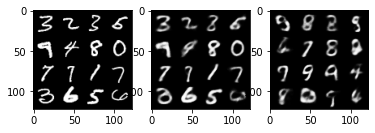

Iter: 22510/50000, Recon loss: 6137.0947, KL div loss: 1344.0291, Total loss: 7481.1240
Iter: 22520/50000, Recon loss: 5664.8428, KL div loss: 1291.8733, Total loss: 6956.7158
Iter: 22530/50000, Recon loss: 5602.8423, KL div loss: 1330.2312, Total loss: 6933.0732
Iter: 22540/50000, Recon loss: 5834.8911, KL div loss: 1327.8774, Total loss: 7162.7686
Iter: 22550/50000, Recon loss: 5439.6914, KL div loss: 1266.1958, Total loss: 6705.8872


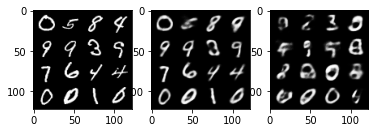

Iter: 22560/50000, Recon loss: 6041.5850, KL div loss: 1345.7712, Total loss: 7387.3564
Iter: 22570/50000, Recon loss: 5591.3550, KL div loss: 1303.4709, Total loss: 6894.8262
Iter: 22580/50000, Recon loss: 5920.5791, KL div loss: 1396.2271, Total loss: 7316.8062
Iter: 22590/50000, Recon loss: 6371.0156, KL div loss: 1331.3212, Total loss: 7702.3369
Iter: 22600/50000, Recon loss: 5968.1699, KL div loss: 1319.4740, Total loss: 7287.6440


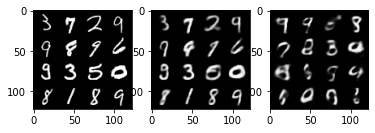

Iter: 22610/50000, Recon loss: 6014.3608, KL div loss: 1295.7148, Total loss: 7310.0757
Iter: 22620/50000, Recon loss: 5823.2935, KL div loss: 1329.6494, Total loss: 7152.9429
Iter: 22630/50000, Recon loss: 6064.1851, KL div loss: 1360.5361, Total loss: 7424.7212
Iter: 22640/50000, Recon loss: 6084.1426, KL div loss: 1335.1167, Total loss: 7419.2593
Iter: 22650/50000, Recon loss: 5643.2568, KL div loss: 1295.3513, Total loss: 6938.6084


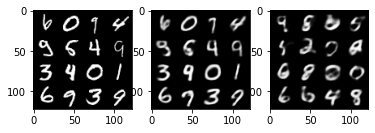

Iter: 22660/50000, Recon loss: 5843.9897, KL div loss: 1327.4166, Total loss: 7171.4062
Iter: 22670/50000, Recon loss: 5910.0137, KL div loss: 1316.5831, Total loss: 7226.5967
Iter: 22680/50000, Recon loss: 5587.3145, KL div loss: 1328.1477, Total loss: 6915.4619
Iter: 22690/50000, Recon loss: 5845.0146, KL div loss: 1355.9220, Total loss: 7200.9365
Iter: 22700/50000, Recon loss: 5589.9702, KL div loss: 1312.3939, Total loss: 6902.3643


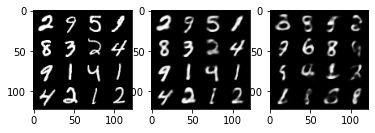

Iter: 22710/50000, Recon loss: 6289.8076, KL div loss: 1375.2637, Total loss: 7665.0713
Iter: 22720/50000, Recon loss: 6021.4287, KL div loss: 1344.8925, Total loss: 7366.3213
Iter: 22730/50000, Recon loss: 6284.9712, KL div loss: 1352.8877, Total loss: 7637.8589
Iter: 22740/50000, Recon loss: 6034.7349, KL div loss: 1320.4702, Total loss: 7355.2051
Iter: 22750/50000, Recon loss: 6087.7349, KL div loss: 1323.2864, Total loss: 7411.0215


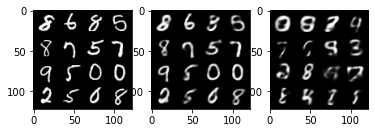

Iter: 22760/50000, Recon loss: 5855.6343, KL div loss: 1315.6614, Total loss: 7171.2959
Iter: 22770/50000, Recon loss: 5837.1895, KL div loss: 1317.5734, Total loss: 7154.7627
Iter: 22780/50000, Recon loss: 5682.0771, KL div loss: 1297.3024, Total loss: 6979.3794
Iter: 22790/50000, Recon loss: 5928.5645, KL div loss: 1341.0930, Total loss: 7269.6572
Iter: 22800/50000, Recon loss: 5766.7666, KL div loss: 1314.3062, Total loss: 7081.0728


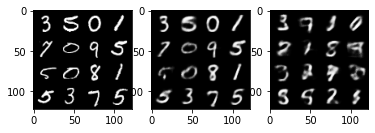

Iter: 22810/50000, Recon loss: 6062.3452, KL div loss: 1365.3562, Total loss: 7427.7012
Iter: 22820/50000, Recon loss: 6467.3369, KL div loss: 1370.4888, Total loss: 7837.8257
Iter: 22830/50000, Recon loss: 5599.6992, KL div loss: 1297.0626, Total loss: 6896.7617
Iter: 22840/50000, Recon loss: 6018.5391, KL div loss: 1356.4017, Total loss: 7374.9409
Iter: 22850/50000, Recon loss: 5824.2227, KL div loss: 1287.6904, Total loss: 7111.9131


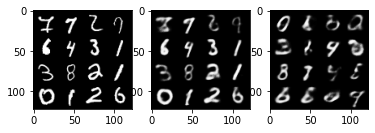

Iter: 22860/50000, Recon loss: 6142.0200, KL div loss: 1372.8322, Total loss: 7514.8521
Iter: 22870/50000, Recon loss: 5959.6729, KL div loss: 1318.7839, Total loss: 7278.4570
Iter: 22880/50000, Recon loss: 5723.4600, KL div loss: 1331.8167, Total loss: 7055.2764
Iter: 22890/50000, Recon loss: 5871.9795, KL div loss: 1357.1980, Total loss: 7229.1777
Iter: 22900/50000, Recon loss: 5851.0596, KL div loss: 1368.5193, Total loss: 7219.5791


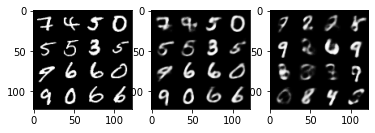

Iter: 22910/50000, Recon loss: 5593.9741, KL div loss: 1315.5403, Total loss: 6909.5146
Iter: 22920/50000, Recon loss: 5644.3936, KL div loss: 1326.1467, Total loss: 6970.5400
Iter: 22930/50000, Recon loss: 6459.7505, KL div loss: 1370.8555, Total loss: 7830.6060
Iter: 22940/50000, Recon loss: 5436.4766, KL div loss: 1299.8621, Total loss: 6736.3389
Iter: 22950/50000, Recon loss: 5629.4351, KL div loss: 1299.3230, Total loss: 6928.7578


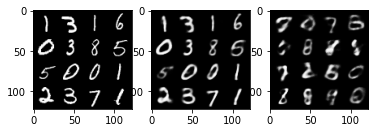

Iter: 22960/50000, Recon loss: 5950.5688, KL div loss: 1361.4276, Total loss: 7311.9966
Iter: 22970/50000, Recon loss: 6047.7798, KL div loss: 1350.1116, Total loss: 7397.8916
Iter: 22980/50000, Recon loss: 5907.7163, KL div loss: 1378.8865, Total loss: 7286.6025
Iter: 22990/50000, Recon loss: 6326.6685, KL div loss: 1374.3549, Total loss: 7701.0234
Iter: 23000/50000, Recon loss: 6512.7949, KL div loss: 1358.0187, Total loss: 7870.8135


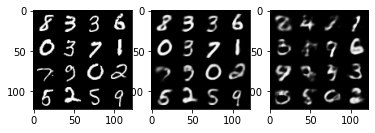

Iter: 23010/50000, Recon loss: 5481.8462, KL div loss: 1291.4357, Total loss: 6773.2817
Iter: 23020/50000, Recon loss: 5949.0850, KL div loss: 1362.6838, Total loss: 7311.7686
Iter: 23030/50000, Recon loss: 5916.1221, KL div loss: 1371.1589, Total loss: 7287.2812
Iter: 23040/50000, Recon loss: 5523.7969, KL div loss: 1307.2559, Total loss: 6831.0527
Iter: 23050/50000, Recon loss: 6156.8970, KL div loss: 1351.8413, Total loss: 7508.7383


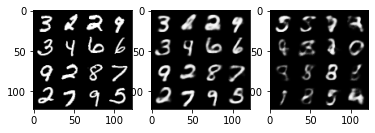

Iter: 23060/50000, Recon loss: 6052.3848, KL div loss: 1356.2896, Total loss: 7408.6743
Iter: 23070/50000, Recon loss: 6133.7676, KL div loss: 1357.0428, Total loss: 7490.8105
Iter: 23080/50000, Recon loss: 6014.0918, KL div loss: 1390.7596, Total loss: 7404.8516
Iter: 23090/50000, Recon loss: 5876.2471, KL div loss: 1339.9590, Total loss: 7216.2061
Iter: 23100/50000, Recon loss: 5442.1211, KL div loss: 1324.5305, Total loss: 6766.6514


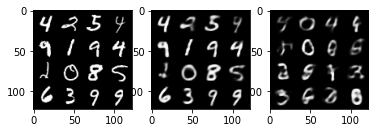

Iter: 23110/50000, Recon loss: 5665.4551, KL div loss: 1327.4087, Total loss: 6992.8638
Iter: 23120/50000, Recon loss: 6233.9380, KL div loss: 1362.7981, Total loss: 7596.7363
Iter: 23130/50000, Recon loss: 5816.3325, KL div loss: 1343.3926, Total loss: 7159.7251
Iter: 23140/50000, Recon loss: 6038.7603, KL div loss: 1341.3348, Total loss: 7380.0952
Iter: 23150/50000, Recon loss: 6053.9531, KL div loss: 1415.1509, Total loss: 7469.1040


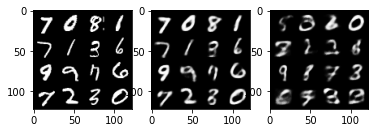

Iter: 23160/50000, Recon loss: 5636.4077, KL div loss: 1312.0732, Total loss: 6948.4810
Iter: 23170/50000, Recon loss: 6207.4692, KL div loss: 1406.6072, Total loss: 7614.0762
Iter: 23180/50000, Recon loss: 5965.9873, KL div loss: 1381.3796, Total loss: 7347.3672
Iter: 23190/50000, Recon loss: 5622.2896, KL div loss: 1335.3940, Total loss: 6957.6836
Iter: 23200/50000, Recon loss: 5878.8618, KL div loss: 1365.3347, Total loss: 7244.1963


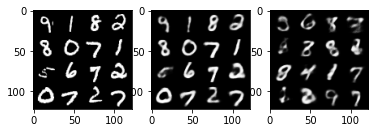

Iter: 23210/50000, Recon loss: 5856.0386, KL div loss: 1328.7443, Total loss: 7184.7827
Iter: 23220/50000, Recon loss: 5958.4912, KL div loss: 1359.1824, Total loss: 7317.6738
Iter: 23230/50000, Recon loss: 5861.3818, KL div loss: 1327.6533, Total loss: 7189.0352
Iter: 23240/50000, Recon loss: 5936.1895, KL div loss: 1350.1390, Total loss: 7286.3286
Iter: 23250/50000, Recon loss: 5617.3291, KL div loss: 1308.2407, Total loss: 6925.5698


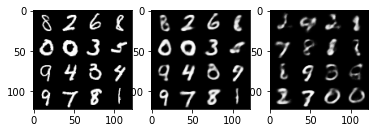

Iter: 23260/50000, Recon loss: 6143.2095, KL div loss: 1330.4783, Total loss: 7473.6875
Iter: 23270/50000, Recon loss: 5511.4570, KL div loss: 1320.8826, Total loss: 6832.3398
Iter: 23280/50000, Recon loss: 6270.8672, KL div loss: 1369.4868, Total loss: 7640.3540
Iter: 23290/50000, Recon loss: 5896.5381, KL div loss: 1324.8071, Total loss: 7221.3452
Iter: 23300/50000, Recon loss: 5814.9009, KL div loss: 1357.1141, Total loss: 7172.0151


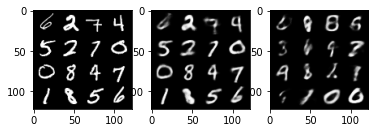

Iter: 23310/50000, Recon loss: 5547.8896, KL div loss: 1301.0898, Total loss: 6848.9795
Iter: 23320/50000, Recon loss: 5982.5830, KL div loss: 1374.8940, Total loss: 7357.4771
Iter: 23330/50000, Recon loss: 6071.0464, KL div loss: 1393.9324, Total loss: 7464.9785
Iter: 23340/50000, Recon loss: 5867.5752, KL div loss: 1319.3904, Total loss: 7186.9658
Iter: 23350/50000, Recon loss: 5890.2891, KL div loss: 1341.4885, Total loss: 7231.7773


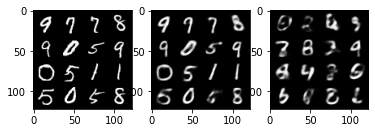

Iter: 23360/50000, Recon loss: 5938.4600, KL div loss: 1330.1462, Total loss: 7268.6064
Iter: 23370/50000, Recon loss: 5985.2139, KL div loss: 1327.3979, Total loss: 7312.6118
Iter: 23380/50000, Recon loss: 5662.6748, KL div loss: 1365.9712, Total loss: 7028.6460
Iter: 23390/50000, Recon loss: 6083.1030, KL div loss: 1384.7474, Total loss: 7467.8506
Iter: 23400/50000, Recon loss: 6088.3477, KL div loss: 1361.5947, Total loss: 7449.9424


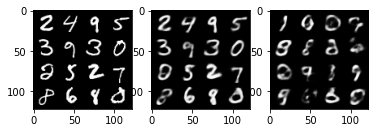

Iter: 23410/50000, Recon loss: 5980.7969, KL div loss: 1318.3483, Total loss: 7299.1450
Iter: 23420/50000, Recon loss: 5794.1504, KL div loss: 1321.1163, Total loss: 7115.2666
Iter: 23430/50000, Recon loss: 5333.8262, KL div loss: 1303.4528, Total loss: 6637.2788
Iter: 23440/50000, Recon loss: 5438.9834, KL div loss: 1307.6227, Total loss: 6746.6060
Iter: 23450/50000, Recon loss: 6112.8203, KL div loss: 1352.4673, Total loss: 7465.2876


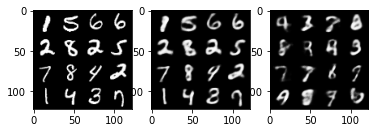

Iter: 23460/50000, Recon loss: 5601.6895, KL div loss: 1301.7950, Total loss: 6903.4844
Iter: 23470/50000, Recon loss: 5863.7417, KL div loss: 1303.3829, Total loss: 7167.1245
Iter: 23480/50000, Recon loss: 5613.0557, KL div loss: 1318.4232, Total loss: 6931.4790
Iter: 23490/50000, Recon loss: 6073.3662, KL div loss: 1353.2529, Total loss: 7426.6191
Iter: 23500/50000, Recon loss: 5804.5156, KL div loss: 1390.2463, Total loss: 7194.7617


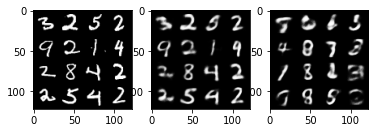

Iter: 23510/50000, Recon loss: 6317.7354, KL div loss: 1335.7378, Total loss: 7653.4731
Iter: 23520/50000, Recon loss: 5601.0195, KL div loss: 1327.4824, Total loss: 6928.5020
Iter: 23530/50000, Recon loss: 5865.6528, KL div loss: 1357.3423, Total loss: 7222.9951
Iter: 23540/50000, Recon loss: 5744.3447, KL div loss: 1325.4636, Total loss: 7069.8086
Iter: 23550/50000, Recon loss: 5668.0166, KL div loss: 1375.5013, Total loss: 7043.5181


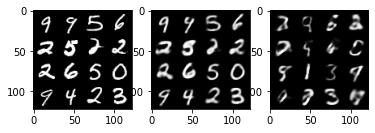

Iter: 23560/50000, Recon loss: 5777.7373, KL div loss: 1305.6082, Total loss: 7083.3457
Iter: 23570/50000, Recon loss: 5976.6226, KL div loss: 1315.4070, Total loss: 7292.0293
Iter: 23580/50000, Recon loss: 5923.1733, KL div loss: 1358.8026, Total loss: 7281.9761
Iter: 23590/50000, Recon loss: 6182.0752, KL div loss: 1342.0621, Total loss: 7524.1372
Iter: 23600/50000, Recon loss: 5939.7939, KL div loss: 1368.5137, Total loss: 7308.3076


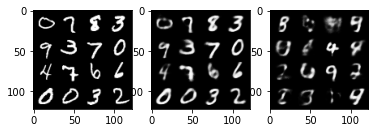

Iter: 23610/50000, Recon loss: 5551.3398, KL div loss: 1322.6555, Total loss: 6873.9951
Iter: 23620/50000, Recon loss: 5606.3701, KL div loss: 1351.3662, Total loss: 6957.7363
Iter: 23630/50000, Recon loss: 5523.3135, KL div loss: 1347.2037, Total loss: 6870.5171
Iter: 23640/50000, Recon loss: 5788.6304, KL div loss: 1370.4888, Total loss: 7159.1191
Iter: 23650/50000, Recon loss: 6061.7637, KL div loss: 1368.6699, Total loss: 7430.4336


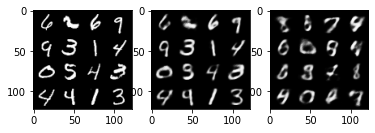

Iter: 23660/50000, Recon loss: 5963.8486, KL div loss: 1393.7649, Total loss: 7357.6133
Iter: 23670/50000, Recon loss: 5836.1265, KL div loss: 1390.6224, Total loss: 7226.7490
Iter: 23680/50000, Recon loss: 6026.3232, KL div loss: 1336.8567, Total loss: 7363.1797
Iter: 23690/50000, Recon loss: 6140.5835, KL div loss: 1355.6116, Total loss: 7496.1953
Iter: 23700/50000, Recon loss: 6088.8257, KL div loss: 1374.3669, Total loss: 7463.1924


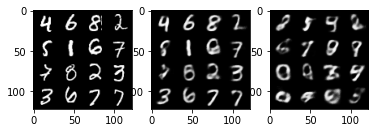

Iter: 23710/50000, Recon loss: 5416.3721, KL div loss: 1319.6375, Total loss: 6736.0098
Iter: 23720/50000, Recon loss: 6000.9893, KL div loss: 1328.8628, Total loss: 7329.8521
Iter: 23730/50000, Recon loss: 5959.5762, KL div loss: 1400.8044, Total loss: 7360.3809
Iter: 23740/50000, Recon loss: 6032.3813, KL div loss: 1400.7310, Total loss: 7433.1123
Iter: 23750/50000, Recon loss: 6081.0835, KL div loss: 1299.9136, Total loss: 7380.9971


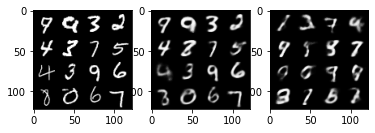

Iter: 23760/50000, Recon loss: 5947.2690, KL div loss: 1370.0798, Total loss: 7317.3486
Iter: 23770/50000, Recon loss: 6103.0781, KL div loss: 1329.6565, Total loss: 7432.7344
Iter: 23780/50000, Recon loss: 5695.6836, KL div loss: 1323.1316, Total loss: 7018.8154
Iter: 23790/50000, Recon loss: 5864.4712, KL div loss: 1313.8738, Total loss: 7178.3447
Iter: 23800/50000, Recon loss: 5661.2197, KL div loss: 1330.4181, Total loss: 6991.6377


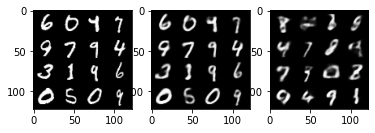

Iter: 23810/50000, Recon loss: 6012.8579, KL div loss: 1357.4425, Total loss: 7370.3003
Iter: 23820/50000, Recon loss: 5823.5771, KL div loss: 1370.5304, Total loss: 7194.1074
Iter: 23830/50000, Recon loss: 5669.3320, KL div loss: 1303.8890, Total loss: 6973.2212
Iter: 23840/50000, Recon loss: 5549.8872, KL div loss: 1310.5360, Total loss: 6860.4233
Iter: 23850/50000, Recon loss: 5648.8364, KL div loss: 1314.3286, Total loss: 6963.1650


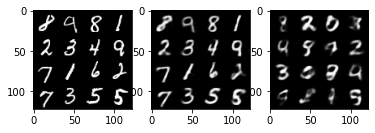

Iter: 23860/50000, Recon loss: 5274.4688, KL div loss: 1263.7473, Total loss: 6538.2158
Iter: 23870/50000, Recon loss: 5923.1895, KL div loss: 1386.6660, Total loss: 7309.8555
Iter: 23880/50000, Recon loss: 5822.0176, KL div loss: 1347.0281, Total loss: 7169.0459
Iter: 23890/50000, Recon loss: 5756.2446, KL div loss: 1321.2227, Total loss: 7077.4673
Iter: 23900/50000, Recon loss: 5897.6221, KL div loss: 1358.3442, Total loss: 7255.9663


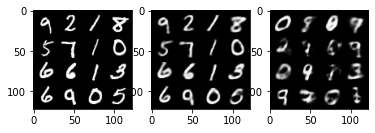

Iter: 23910/50000, Recon loss: 5737.0312, KL div loss: 1339.3003, Total loss: 7076.3315
Iter: 23920/50000, Recon loss: 6033.9150, KL div loss: 1348.8401, Total loss: 7382.7549
Iter: 23930/50000, Recon loss: 6133.7754, KL div loss: 1326.7686, Total loss: 7460.5439
Iter: 23940/50000, Recon loss: 5382.3408, KL div loss: 1332.7063, Total loss: 6715.0469
Iter: 23950/50000, Recon loss: 5685.5557, KL div loss: 1350.0541, Total loss: 7035.6099


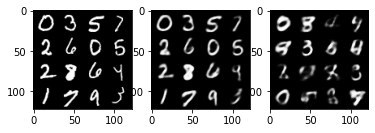

Iter: 23960/50000, Recon loss: 5873.6084, KL div loss: 1379.0570, Total loss: 7252.6655
Iter: 23970/50000, Recon loss: 5661.5371, KL div loss: 1335.6536, Total loss: 6997.1904
Iter: 23980/50000, Recon loss: 6005.6938, KL div loss: 1344.9902, Total loss: 7350.6841
Iter: 23990/50000, Recon loss: 6054.1260, KL div loss: 1364.8206, Total loss: 7418.9463
Iter: 24000/50000, Recon loss: 5645.1338, KL div loss: 1339.9121, Total loss: 6985.0459


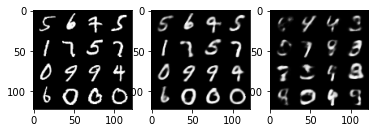

Iter: 24010/50000, Recon loss: 5973.8267, KL div loss: 1349.9862, Total loss: 7323.8130
Iter: 24020/50000, Recon loss: 6182.6118, KL div loss: 1347.5413, Total loss: 7530.1533
Iter: 24030/50000, Recon loss: 5998.0176, KL div loss: 1362.3118, Total loss: 7360.3291
Iter: 24040/50000, Recon loss: 5689.1270, KL div loss: 1332.9224, Total loss: 7022.0493
Iter: 24050/50000, Recon loss: 5802.7256, KL div loss: 1335.8336, Total loss: 7138.5591


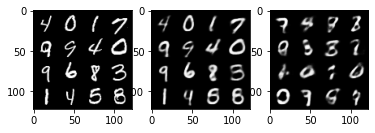

Iter: 24060/50000, Recon loss: 5841.7480, KL div loss: 1345.0205, Total loss: 7186.7686
Iter: 24070/50000, Recon loss: 5674.5430, KL div loss: 1304.8992, Total loss: 6979.4424
Iter: 24080/50000, Recon loss: 6319.9375, KL div loss: 1374.1583, Total loss: 7694.0957
Iter: 24090/50000, Recon loss: 5818.4004, KL div loss: 1337.1067, Total loss: 7155.5068
Iter: 24100/50000, Recon loss: 5756.4639, KL div loss: 1320.6636, Total loss: 7077.1274


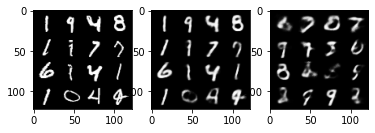

Iter: 24110/50000, Recon loss: 5737.6602, KL div loss: 1325.9932, Total loss: 7063.6533
Iter: 24120/50000, Recon loss: 5321.3550, KL div loss: 1312.3613, Total loss: 6633.7163
Iter: 24130/50000, Recon loss: 6120.1514, KL div loss: 1317.9656, Total loss: 7438.1172
Iter: 24140/50000, Recon loss: 5717.4385, KL div loss: 1285.9977, Total loss: 7003.4360
Iter: 24150/50000, Recon loss: 6191.1997, KL div loss: 1384.4113, Total loss: 7575.6108


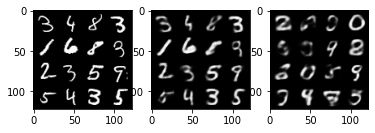

Iter: 24160/50000, Recon loss: 5407.7700, KL div loss: 1313.6912, Total loss: 6721.4609
Iter: 24170/50000, Recon loss: 5764.0347, KL div loss: 1314.0206, Total loss: 7078.0552
Iter: 24180/50000, Recon loss: 5762.1885, KL div loss: 1340.7642, Total loss: 7102.9526
Iter: 24190/50000, Recon loss: 5454.3423, KL div loss: 1260.1559, Total loss: 6714.4980
Iter: 24200/50000, Recon loss: 5675.8042, KL div loss: 1338.8319, Total loss: 7014.6362


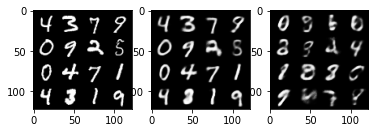

Iter: 24210/50000, Recon loss: 5862.1187, KL div loss: 1305.6515, Total loss: 7167.7700
Iter: 24220/50000, Recon loss: 6128.9658, KL div loss: 1430.2656, Total loss: 7559.2314
Iter: 24230/50000, Recon loss: 5958.7734, KL div loss: 1337.5408, Total loss: 7296.3145
Iter: 24240/50000, Recon loss: 5608.4863, KL div loss: 1325.9844, Total loss: 6934.4707
Iter: 24250/50000, Recon loss: 5903.8657, KL div loss: 1388.4734, Total loss: 7292.3389


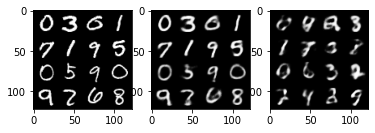

Iter: 24260/50000, Recon loss: 6117.2739, KL div loss: 1362.2051, Total loss: 7479.4790
Iter: 24270/50000, Recon loss: 5143.2983, KL div loss: 1308.9241, Total loss: 6452.2227
Iter: 24280/50000, Recon loss: 5501.6670, KL div loss: 1309.6204, Total loss: 6811.2871
Iter: 24290/50000, Recon loss: 5791.1313, KL div loss: 1355.4899, Total loss: 7146.6211
Iter: 24300/50000, Recon loss: 5636.3262, KL div loss: 1310.6539, Total loss: 6946.9800


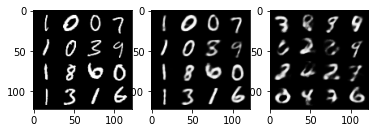

Iter: 24310/50000, Recon loss: 6100.1304, KL div loss: 1377.3800, Total loss: 7477.5103
Iter: 24320/50000, Recon loss: 5543.7954, KL div loss: 1392.7788, Total loss: 6936.5742
Iter: 24330/50000, Recon loss: 5643.0962, KL div loss: 1323.2329, Total loss: 6966.3291
Iter: 24340/50000, Recon loss: 5887.7520, KL div loss: 1363.9434, Total loss: 7251.6953
Iter: 24350/50000, Recon loss: 5955.4795, KL div loss: 1355.4504, Total loss: 7310.9297


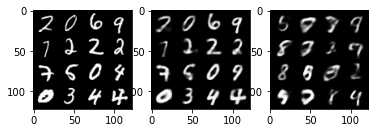

Iter: 24360/50000, Recon loss: 6095.1289, KL div loss: 1360.0062, Total loss: 7455.1353
Iter: 24370/50000, Recon loss: 5767.2080, KL div loss: 1355.4661, Total loss: 7122.6738
Iter: 24380/50000, Recon loss: 5556.5156, KL div loss: 1323.9581, Total loss: 6880.4736
Iter: 24390/50000, Recon loss: 5672.4189, KL div loss: 1359.7102, Total loss: 7032.1289
Iter: 24400/50000, Recon loss: 5675.6465, KL div loss: 1334.0273, Total loss: 7009.6738


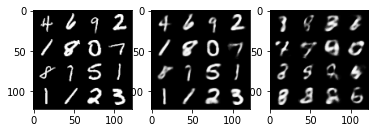

Iter: 24410/50000, Recon loss: 5650.7788, KL div loss: 1332.8860, Total loss: 6983.6650
Iter: 24420/50000, Recon loss: 5721.3506, KL div loss: 1360.8721, Total loss: 7082.2227
Iter: 24430/50000, Recon loss: 5723.0039, KL div loss: 1328.3677, Total loss: 7051.3716
Iter: 24440/50000, Recon loss: 5832.3906, KL div loss: 1341.7302, Total loss: 7174.1211
Iter: 24450/50000, Recon loss: 6027.0898, KL div loss: 1348.8643, Total loss: 7375.9541


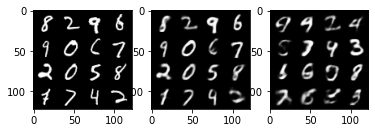

Iter: 24460/50000, Recon loss: 5782.0659, KL div loss: 1325.2935, Total loss: 7107.3594
Iter: 24470/50000, Recon loss: 5752.0459, KL div loss: 1330.5040, Total loss: 7082.5498
Iter: 24480/50000, Recon loss: 5860.5229, KL div loss: 1333.8196, Total loss: 7194.3428
Iter: 24490/50000, Recon loss: 5701.6406, KL div loss: 1371.5720, Total loss: 7073.2129
Iter: 24500/50000, Recon loss: 5624.4707, KL div loss: 1331.0548, Total loss: 6955.5254


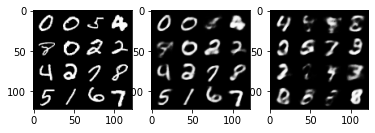

Iter: 24510/50000, Recon loss: 5577.0723, KL div loss: 1330.5417, Total loss: 6907.6143
Iter: 24520/50000, Recon loss: 5800.9243, KL div loss: 1319.8508, Total loss: 7120.7754
Iter: 24530/50000, Recon loss: 5667.6157, KL div loss: 1357.0354, Total loss: 7024.6514
Iter: 24540/50000, Recon loss: 5799.1074, KL div loss: 1292.1819, Total loss: 7091.2891
Iter: 24550/50000, Recon loss: 5854.6177, KL div loss: 1348.5687, Total loss: 7203.1865


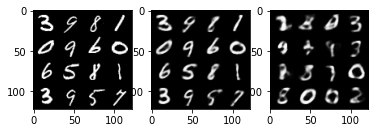

Iter: 24560/50000, Recon loss: 6096.2046, KL div loss: 1424.0646, Total loss: 7520.2690
Iter: 24570/50000, Recon loss: 5978.4922, KL div loss: 1393.4224, Total loss: 7371.9146
Iter: 24580/50000, Recon loss: 6055.1328, KL div loss: 1395.2605, Total loss: 7450.3936
Iter: 24590/50000, Recon loss: 5424.9766, KL div loss: 1282.2939, Total loss: 6707.2705
Iter: 24600/50000, Recon loss: 5435.5635, KL div loss: 1302.2433, Total loss: 6737.8066


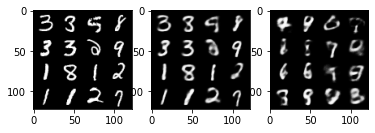

Iter: 24610/50000, Recon loss: 5910.4370, KL div loss: 1431.4521, Total loss: 7341.8892
Iter: 24620/50000, Recon loss: 6040.2246, KL div loss: 1379.4966, Total loss: 7419.7212
Iter: 24630/50000, Recon loss: 5705.7480, KL div loss: 1355.5942, Total loss: 7061.3423
Iter: 24640/50000, Recon loss: 5575.7539, KL div loss: 1324.8374, Total loss: 6900.5913
Iter: 24650/50000, Recon loss: 5892.7388, KL div loss: 1374.6416, Total loss: 7267.3804


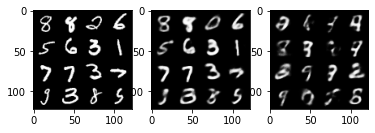

Iter: 24660/50000, Recon loss: 6034.4492, KL div loss: 1364.6117, Total loss: 7399.0610
Iter: 24670/50000, Recon loss: 6067.1045, KL div loss: 1362.8564, Total loss: 7429.9609
Iter: 24680/50000, Recon loss: 5663.4541, KL div loss: 1322.8130, Total loss: 6986.2671
Iter: 24690/50000, Recon loss: 5757.4307, KL div loss: 1351.7573, Total loss: 7109.1880
Iter: 24700/50000, Recon loss: 6037.4990, KL div loss: 1407.2646, Total loss: 7444.7637


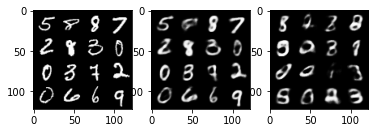

Iter: 24710/50000, Recon loss: 5760.5254, KL div loss: 1309.5088, Total loss: 7070.0342
Iter: 24720/50000, Recon loss: 5910.1133, KL div loss: 1324.5704, Total loss: 7234.6836
Iter: 24730/50000, Recon loss: 5836.1079, KL div loss: 1343.4697, Total loss: 7179.5776
Iter: 24740/50000, Recon loss: 5756.6943, KL div loss: 1375.4170, Total loss: 7132.1113
Iter: 24750/50000, Recon loss: 5654.4946, KL div loss: 1313.2766, Total loss: 6967.7715


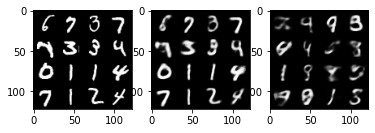

Iter: 24760/50000, Recon loss: 5267.7988, KL div loss: 1282.7246, Total loss: 6550.5234
Iter: 24770/50000, Recon loss: 5632.6387, KL div loss: 1359.5083, Total loss: 6992.1470
Iter: 24780/50000, Recon loss: 6100.9189, KL div loss: 1367.9036, Total loss: 7468.8223
Iter: 24790/50000, Recon loss: 5433.4541, KL div loss: 1329.2495, Total loss: 6762.7036
Iter: 24800/50000, Recon loss: 5854.5942, KL div loss: 1407.3008, Total loss: 7261.8950


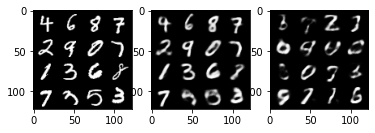

Iter: 24810/50000, Recon loss: 5841.0288, KL div loss: 1382.2021, Total loss: 7223.2310
Iter: 24820/50000, Recon loss: 5741.0947, KL div loss: 1347.2456, Total loss: 7088.3403
Iter: 24830/50000, Recon loss: 6023.6196, KL div loss: 1382.2185, Total loss: 7405.8379
Iter: 24840/50000, Recon loss: 5388.1621, KL div loss: 1275.6951, Total loss: 6663.8574
Iter: 24850/50000, Recon loss: 5227.1724, KL div loss: 1336.5710, Total loss: 6563.7432


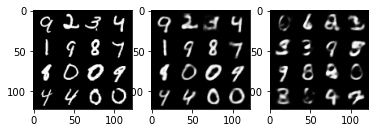

Iter: 24860/50000, Recon loss: 5429.8745, KL div loss: 1332.7234, Total loss: 6762.5977
Iter: 24870/50000, Recon loss: 5579.9287, KL div loss: 1315.2775, Total loss: 6895.2061
Iter: 24880/50000, Recon loss: 5743.4297, KL div loss: 1352.1846, Total loss: 7095.6143
Iter: 24890/50000, Recon loss: 6153.4858, KL div loss: 1361.3268, Total loss: 7514.8125
Iter: 24900/50000, Recon loss: 5988.0000, KL div loss: 1349.8707, Total loss: 7337.8706


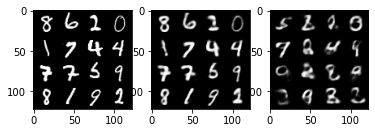

Iter: 24910/50000, Recon loss: 6032.2168, KL div loss: 1370.8621, Total loss: 7403.0791
Iter: 24920/50000, Recon loss: 5678.7627, KL div loss: 1350.5642, Total loss: 7029.3271
Iter: 24930/50000, Recon loss: 5557.2192, KL div loss: 1328.3530, Total loss: 6885.5723
Iter: 24940/50000, Recon loss: 5803.0088, KL div loss: 1326.3259, Total loss: 7129.3350
Iter: 24950/50000, Recon loss: 6122.9541, KL div loss: 1401.3610, Total loss: 7524.3149


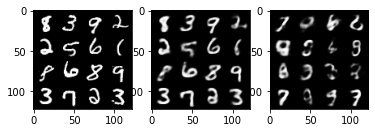

Iter: 24960/50000, Recon loss: 5605.6484, KL div loss: 1309.3292, Total loss: 6914.9775
Iter: 24970/50000, Recon loss: 5929.2305, KL div loss: 1302.7213, Total loss: 7231.9517
Iter: 24980/50000, Recon loss: 5811.4131, KL div loss: 1329.9839, Total loss: 7141.3970
Iter: 24990/50000, Recon loss: 5800.7744, KL div loss: 1392.6840, Total loss: 7193.4585
Iter: 25000/50000, Recon loss: 5926.9355, KL div loss: 1331.2902, Total loss: 7258.2256


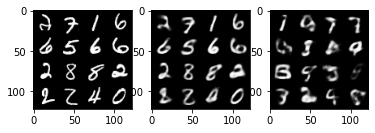

Iter: 25010/50000, Recon loss: 5985.2041, KL div loss: 1328.6772, Total loss: 7313.8813
Iter: 25020/50000, Recon loss: 5485.2510, KL div loss: 1313.3094, Total loss: 6798.5605
Iter: 25030/50000, Recon loss: 5838.0864, KL div loss: 1361.0532, Total loss: 7199.1396
Iter: 25040/50000, Recon loss: 5912.0869, KL div loss: 1313.5438, Total loss: 7225.6309
Iter: 25050/50000, Recon loss: 5836.6538, KL div loss: 1344.7410, Total loss: 7181.3945


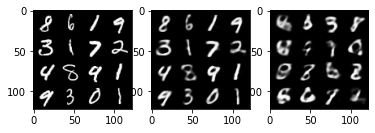

Iter: 25060/50000, Recon loss: 5412.1328, KL div loss: 1349.7667, Total loss: 6761.8994
Iter: 25070/50000, Recon loss: 5409.8042, KL div loss: 1349.5071, Total loss: 6759.3115
Iter: 25080/50000, Recon loss: 5494.5757, KL div loss: 1351.5461, Total loss: 6846.1221
Iter: 25090/50000, Recon loss: 5936.5571, KL div loss: 1342.2745, Total loss: 7278.8315
Iter: 25100/50000, Recon loss: 5989.7036, KL div loss: 1337.8749, Total loss: 7327.5786


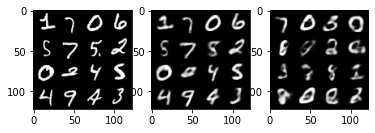

Iter: 25110/50000, Recon loss: 6104.6162, KL div loss: 1408.6732, Total loss: 7513.2896
Iter: 25120/50000, Recon loss: 5499.2266, KL div loss: 1343.3425, Total loss: 6842.5693
Iter: 25130/50000, Recon loss: 5885.3955, KL div loss: 1342.6445, Total loss: 7228.0400
Iter: 25140/50000, Recon loss: 6012.0718, KL div loss: 1364.2856, Total loss: 7376.3574
Iter: 25150/50000, Recon loss: 5836.9658, KL div loss: 1333.0833, Total loss: 7170.0488


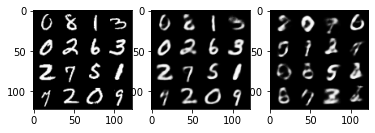

Iter: 25160/50000, Recon loss: 5755.2349, KL div loss: 1366.7502, Total loss: 7121.9854
Iter: 25170/50000, Recon loss: 5927.0781, KL div loss: 1334.9595, Total loss: 7262.0376
Iter: 25180/50000, Recon loss: 5664.4863, KL div loss: 1350.9276, Total loss: 7015.4141
Iter: 25190/50000, Recon loss: 5559.4585, KL div loss: 1312.7279, Total loss: 6872.1865
Iter: 25200/50000, Recon loss: 5744.8511, KL div loss: 1296.5734, Total loss: 7041.4243


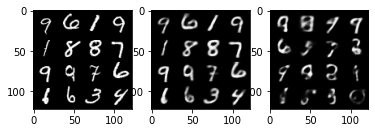

Iter: 25210/50000, Recon loss: 5408.3066, KL div loss: 1284.6301, Total loss: 6692.9365
Iter: 25220/50000, Recon loss: 5162.8926, KL div loss: 1317.7081, Total loss: 6480.6006
Iter: 25230/50000, Recon loss: 5756.3848, KL div loss: 1391.6357, Total loss: 7148.0205
Iter: 25240/50000, Recon loss: 5903.5254, KL div loss: 1318.7744, Total loss: 7222.2998
Iter: 25250/50000, Recon loss: 6161.0225, KL div loss: 1362.1743, Total loss: 7523.1968


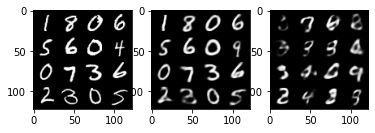

Iter: 25260/50000, Recon loss: 5872.4409, KL div loss: 1391.8657, Total loss: 7264.3066
Iter: 25270/50000, Recon loss: 5888.5371, KL div loss: 1330.7256, Total loss: 7219.2627
Iter: 25280/50000, Recon loss: 5976.9199, KL div loss: 1400.2594, Total loss: 7377.1792
Iter: 25290/50000, Recon loss: 5951.0820, KL div loss: 1321.5647, Total loss: 7272.6465
Iter: 25300/50000, Recon loss: 5753.9253, KL div loss: 1366.7346, Total loss: 7120.6602


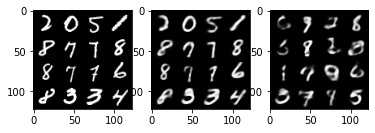

Iter: 25310/50000, Recon loss: 5254.5122, KL div loss: 1326.1008, Total loss: 6580.6133
Iter: 25320/50000, Recon loss: 5800.4009, KL div loss: 1332.0420, Total loss: 7132.4429
Iter: 25330/50000, Recon loss: 5743.4736, KL div loss: 1368.0022, Total loss: 7111.4756
Iter: 25340/50000, Recon loss: 5442.0815, KL div loss: 1318.2855, Total loss: 6760.3672
Iter: 25350/50000, Recon loss: 5679.4043, KL div loss: 1398.5352, Total loss: 7077.9395


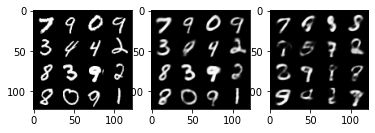

Iter: 25360/50000, Recon loss: 6024.9238, KL div loss: 1326.7739, Total loss: 7351.6978
Iter: 25370/50000, Recon loss: 5616.5400, KL div loss: 1291.8918, Total loss: 6908.4316
Iter: 25380/50000, Recon loss: 6022.6724, KL div loss: 1321.4343, Total loss: 7344.1064
Iter: 25390/50000, Recon loss: 5687.8066, KL div loss: 1348.0076, Total loss: 7035.8145
Iter: 25400/50000, Recon loss: 5623.6396, KL div loss: 1412.3955, Total loss: 7036.0352


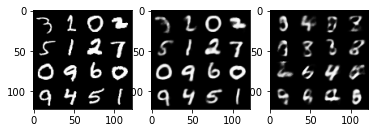

Iter: 25410/50000, Recon loss: 5533.9697, KL div loss: 1336.2605, Total loss: 6870.2305
Iter: 25420/50000, Recon loss: 5470.2900, KL div loss: 1351.8253, Total loss: 6822.1152
Iter: 25430/50000, Recon loss: 5979.9717, KL div loss: 1402.9880, Total loss: 7382.9600
Iter: 25440/50000, Recon loss: 5559.4531, KL div loss: 1329.9480, Total loss: 6889.4014
Iter: 25450/50000, Recon loss: 5508.8760, KL div loss: 1347.4563, Total loss: 6856.3320


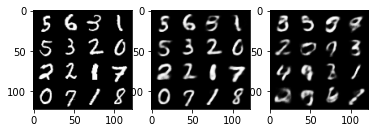

Iter: 25460/50000, Recon loss: 5661.2324, KL div loss: 1317.1915, Total loss: 6978.4238
Iter: 25470/50000, Recon loss: 5880.5474, KL div loss: 1355.5344, Total loss: 7236.0820
Iter: 25480/50000, Recon loss: 5929.4053, KL div loss: 1352.6676, Total loss: 7282.0728
Iter: 25490/50000, Recon loss: 5724.9658, KL div loss: 1358.9976, Total loss: 7083.9634
Iter: 25500/50000, Recon loss: 5729.3008, KL div loss: 1312.1239, Total loss: 7041.4248


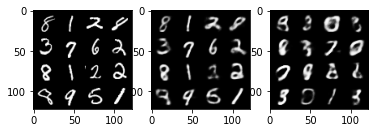

Iter: 25510/50000, Recon loss: 5871.0811, KL div loss: 1345.9077, Total loss: 7216.9888
Iter: 25520/50000, Recon loss: 5629.5254, KL div loss: 1325.3608, Total loss: 6954.8862
Iter: 25530/50000, Recon loss: 5958.2002, KL div loss: 1374.2927, Total loss: 7332.4932
Iter: 25540/50000, Recon loss: 5759.3418, KL div loss: 1335.7646, Total loss: 7095.1064
Iter: 25550/50000, Recon loss: 5449.4639, KL div loss: 1352.4988, Total loss: 6801.9629


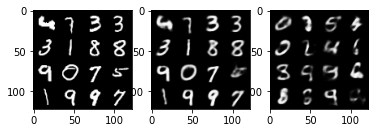

Iter: 25560/50000, Recon loss: 5767.3311, KL div loss: 1356.0148, Total loss: 7123.3457
Iter: 25570/50000, Recon loss: 5825.2524, KL div loss: 1321.5898, Total loss: 7146.8423
Iter: 25580/50000, Recon loss: 5231.4077, KL div loss: 1282.4885, Total loss: 6513.8965
Iter: 25590/50000, Recon loss: 5434.3691, KL div loss: 1345.7332, Total loss: 6780.1025
Iter: 25600/50000, Recon loss: 5658.8506, KL div loss: 1365.5864, Total loss: 7024.4370


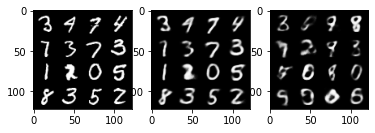

Iter: 25610/50000, Recon loss: 5626.3457, KL div loss: 1341.6338, Total loss: 6967.9795
Iter: 25620/50000, Recon loss: 5533.0371, KL div loss: 1297.0825, Total loss: 6830.1196
Iter: 25630/50000, Recon loss: 5606.4326, KL div loss: 1375.3352, Total loss: 6981.7676
Iter: 25640/50000, Recon loss: 5618.1816, KL div loss: 1319.4082, Total loss: 6937.5898
Iter: 25650/50000, Recon loss: 5386.6206, KL div loss: 1321.2483, Total loss: 6707.8691


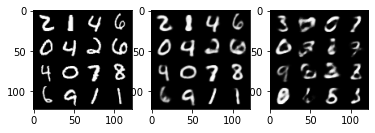

Iter: 25660/50000, Recon loss: 5769.8457, KL div loss: 1364.8264, Total loss: 7134.6719
Iter: 25670/50000, Recon loss: 5862.3071, KL div loss: 1316.1780, Total loss: 7178.4854
Iter: 25680/50000, Recon loss: 5695.4473, KL div loss: 1331.1484, Total loss: 7026.5957
Iter: 25690/50000, Recon loss: 5503.4434, KL div loss: 1346.4493, Total loss: 6849.8926
Iter: 25700/50000, Recon loss: 5728.5820, KL div loss: 1355.0125, Total loss: 7083.5947


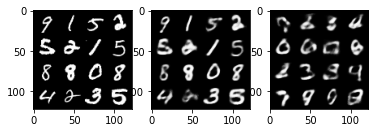

Iter: 25710/50000, Recon loss: 5729.6880, KL div loss: 1334.3083, Total loss: 7063.9961
Iter: 25720/50000, Recon loss: 5520.6245, KL div loss: 1321.0017, Total loss: 6841.6260
Iter: 25730/50000, Recon loss: 5807.5879, KL div loss: 1315.9741, Total loss: 7123.5620
Iter: 25740/50000, Recon loss: 5252.9209, KL div loss: 1340.3270, Total loss: 6593.2480
Iter: 25750/50000, Recon loss: 5464.3916, KL div loss: 1261.9182, Total loss: 6726.3096


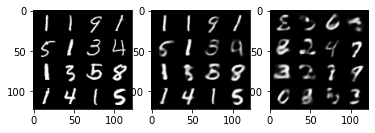

Iter: 25760/50000, Recon loss: 5864.9624, KL div loss: 1316.9529, Total loss: 7181.9150
Iter: 25770/50000, Recon loss: 5772.1597, KL div loss: 1391.0557, Total loss: 7163.2153
Iter: 25780/50000, Recon loss: 5711.7285, KL div loss: 1341.1782, Total loss: 7052.9067
Iter: 25790/50000, Recon loss: 5814.6919, KL div loss: 1346.5712, Total loss: 7161.2632
Iter: 25800/50000, Recon loss: 5830.9243, KL div loss: 1365.4111, Total loss: 7196.3354


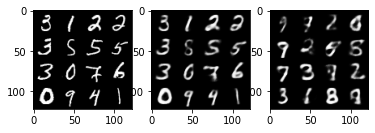

Iter: 25810/50000, Recon loss: 5683.0488, KL div loss: 1359.3538, Total loss: 7042.4023
Iter: 25820/50000, Recon loss: 6170.4355, KL div loss: 1364.8236, Total loss: 7535.2593
Iter: 25830/50000, Recon loss: 5340.1445, KL div loss: 1348.9572, Total loss: 6689.1016
Iter: 25840/50000, Recon loss: 5788.8735, KL div loss: 1361.2550, Total loss: 7150.1284
Iter: 25850/50000, Recon loss: 5387.4551, KL div loss: 1345.6884, Total loss: 6733.1436


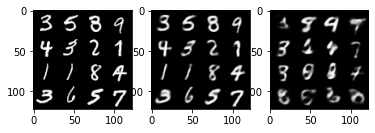

Iter: 25860/50000, Recon loss: 5902.8662, KL div loss: 1356.8337, Total loss: 7259.7002
Iter: 25870/50000, Recon loss: 5704.4277, KL div loss: 1338.0430, Total loss: 7042.4707
Iter: 25880/50000, Recon loss: 5700.2617, KL div loss: 1348.3545, Total loss: 7048.6162
Iter: 25890/50000, Recon loss: 6007.7939, KL div loss: 1345.0604, Total loss: 7352.8545
Iter: 25900/50000, Recon loss: 5614.4009, KL div loss: 1343.0316, Total loss: 6957.4326


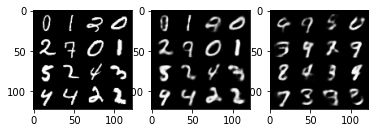

Iter: 25910/50000, Recon loss: 6106.8438, KL div loss: 1390.1555, Total loss: 7496.9990
Iter: 25920/50000, Recon loss: 5574.9624, KL div loss: 1339.3193, Total loss: 6914.2817
Iter: 25930/50000, Recon loss: 5799.8638, KL div loss: 1345.8398, Total loss: 7145.7036
Iter: 25940/50000, Recon loss: 5788.6240, KL div loss: 1394.9863, Total loss: 7183.6104
Iter: 25950/50000, Recon loss: 5864.3955, KL div loss: 1423.4366, Total loss: 7287.8320


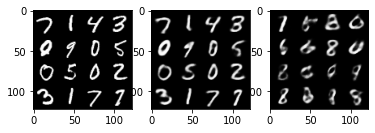

Iter: 25960/50000, Recon loss: 5732.8218, KL div loss: 1375.7842, Total loss: 7108.6060
Iter: 25970/50000, Recon loss: 5701.4790, KL div loss: 1331.2665, Total loss: 7032.7456
Iter: 25980/50000, Recon loss: 5998.3477, KL div loss: 1322.8328, Total loss: 7321.1807
Iter: 25990/50000, Recon loss: 5870.3438, KL div loss: 1348.1010, Total loss: 7218.4448
Iter: 26000/50000, Recon loss: 5251.1309, KL div loss: 1352.2834, Total loss: 6603.4141


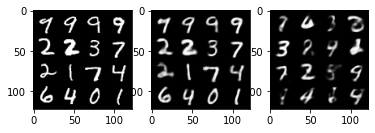

Iter: 26010/50000, Recon loss: 5874.6968, KL div loss: 1347.7418, Total loss: 7222.4385
Iter: 26020/50000, Recon loss: 5930.2964, KL div loss: 1346.3969, Total loss: 7276.6934
Iter: 26030/50000, Recon loss: 5730.2236, KL div loss: 1351.4824, Total loss: 7081.7061
Iter: 26040/50000, Recon loss: 5628.2393, KL div loss: 1351.7473, Total loss: 6979.9863
Iter: 26050/50000, Recon loss: 5894.7139, KL div loss: 1399.4446, Total loss: 7294.1582


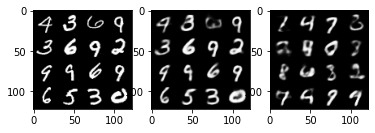

Iter: 26060/50000, Recon loss: 6012.9478, KL div loss: 1367.8623, Total loss: 7380.8101
Iter: 26070/50000, Recon loss: 5737.6982, KL div loss: 1337.9243, Total loss: 7075.6226
Iter: 26080/50000, Recon loss: 5896.6348, KL div loss: 1362.1721, Total loss: 7258.8066
Iter: 26090/50000, Recon loss: 5684.9502, KL div loss: 1373.7479, Total loss: 7058.6982
Iter: 26100/50000, Recon loss: 5430.7490, KL div loss: 1351.4501, Total loss: 6782.1992


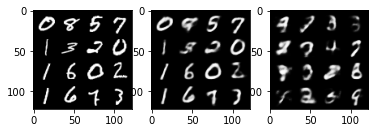

Iter: 26110/50000, Recon loss: 5855.2407, KL div loss: 1345.0479, Total loss: 7200.2886
Iter: 26120/50000, Recon loss: 5540.5420, KL div loss: 1335.7192, Total loss: 6876.2612
Iter: 26130/50000, Recon loss: 6300.8779, KL div loss: 1400.7900, Total loss: 7701.6680
Iter: 26140/50000, Recon loss: 5728.5239, KL div loss: 1366.2651, Total loss: 7094.7891
Iter: 26150/50000, Recon loss: 6120.9780, KL div loss: 1360.5619, Total loss: 7481.5400


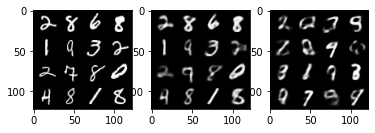

Iter: 26160/50000, Recon loss: 5886.4932, KL div loss: 1329.7292, Total loss: 7216.2227
Iter: 26170/50000, Recon loss: 5451.7617, KL div loss: 1364.5682, Total loss: 6816.3301
Iter: 26180/50000, Recon loss: 5307.0332, KL div loss: 1341.9431, Total loss: 6648.9766
Iter: 26190/50000, Recon loss: 5450.2520, KL div loss: 1334.1069, Total loss: 6784.3589
Iter: 26200/50000, Recon loss: 5890.8760, KL div loss: 1383.2759, Total loss: 7274.1519


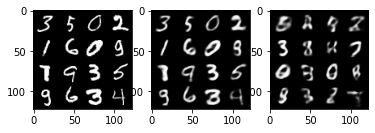

Iter: 26210/50000, Recon loss: 6037.5137, KL div loss: 1389.3160, Total loss: 7426.8296
Iter: 26220/50000, Recon loss: 5598.7178, KL div loss: 1328.2865, Total loss: 6927.0044
Iter: 26230/50000, Recon loss: 5673.6025, KL div loss: 1389.7029, Total loss: 7063.3057
Iter: 26240/50000, Recon loss: 5734.0537, KL div loss: 1315.5676, Total loss: 7049.6211
Iter: 26250/50000, Recon loss: 6060.0898, KL div loss: 1391.8687, Total loss: 7451.9585


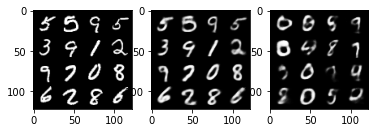

Iter: 26260/50000, Recon loss: 5773.8438, KL div loss: 1391.8184, Total loss: 7165.6621
Iter: 26270/50000, Recon loss: 5634.3623, KL div loss: 1337.3723, Total loss: 6971.7344
Iter: 26280/50000, Recon loss: 5499.9688, KL div loss: 1318.3806, Total loss: 6818.3496
Iter: 26290/50000, Recon loss: 5988.6426, KL div loss: 1420.7415, Total loss: 7409.3838
Iter: 26300/50000, Recon loss: 5717.6699, KL div loss: 1381.9022, Total loss: 7099.5723


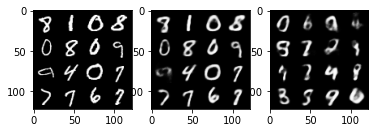

Iter: 26310/50000, Recon loss: 5388.4092, KL div loss: 1326.7091, Total loss: 6715.1182
Iter: 26320/50000, Recon loss: 5760.6152, KL div loss: 1364.1658, Total loss: 7124.7812
Iter: 26330/50000, Recon loss: 5764.5049, KL div loss: 1385.9917, Total loss: 7150.4966
Iter: 26340/50000, Recon loss: 5664.0767, KL div loss: 1370.6271, Total loss: 7034.7036
Iter: 26350/50000, Recon loss: 5623.4653, KL div loss: 1342.5579, Total loss: 6966.0234


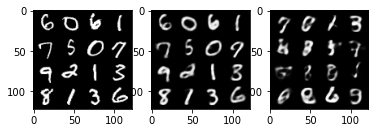

Iter: 26360/50000, Recon loss: 5539.3711, KL div loss: 1305.7830, Total loss: 6845.1543
Iter: 26370/50000, Recon loss: 5881.4678, KL div loss: 1344.8750, Total loss: 7226.3428
Iter: 26380/50000, Recon loss: 5866.1055, KL div loss: 1381.6539, Total loss: 7247.7593
Iter: 26390/50000, Recon loss: 5964.2407, KL div loss: 1390.8433, Total loss: 7355.0840
Iter: 26400/50000, Recon loss: 5598.9829, KL div loss: 1362.9282, Total loss: 6961.9111


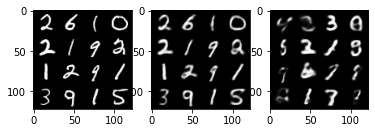

Iter: 26410/50000, Recon loss: 5269.6992, KL div loss: 1322.6670, Total loss: 6592.3662
Iter: 26420/50000, Recon loss: 5641.9033, KL div loss: 1301.9866, Total loss: 6943.8896
Iter: 26430/50000, Recon loss: 5363.0332, KL div loss: 1292.6328, Total loss: 6655.6660
Iter: 26440/50000, Recon loss: 6142.5366, KL div loss: 1401.7975, Total loss: 7544.3340
Iter: 26450/50000, Recon loss: 6056.7358, KL div loss: 1391.2734, Total loss: 7448.0093


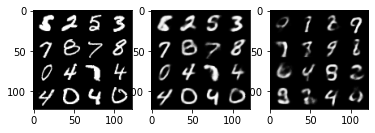

Iter: 26460/50000, Recon loss: 5762.1118, KL div loss: 1363.8574, Total loss: 7125.9692
Iter: 26470/50000, Recon loss: 6237.6050, KL div loss: 1403.4785, Total loss: 7641.0835
Iter: 26480/50000, Recon loss: 5682.1821, KL div loss: 1360.5928, Total loss: 7042.7749
Iter: 26490/50000, Recon loss: 5163.4756, KL div loss: 1344.9365, Total loss: 6508.4121
Iter: 26500/50000, Recon loss: 5274.5703, KL div loss: 1290.2983, Total loss: 6564.8687


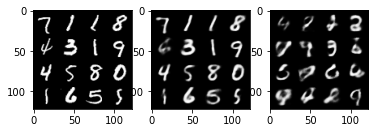

Iter: 26510/50000, Recon loss: 5398.6562, KL div loss: 1341.3430, Total loss: 6739.9990
Iter: 26520/50000, Recon loss: 5283.5791, KL div loss: 1316.4423, Total loss: 6600.0215
Iter: 26530/50000, Recon loss: 5725.9219, KL div loss: 1338.2789, Total loss: 7064.2007
Iter: 26540/50000, Recon loss: 6254.4385, KL div loss: 1398.0056, Total loss: 7652.4443
Iter: 26550/50000, Recon loss: 5492.2373, KL div loss: 1342.7587, Total loss: 6834.9961


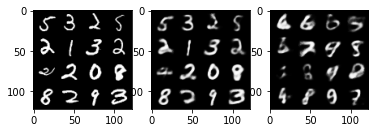

Iter: 26560/50000, Recon loss: 5656.0439, KL div loss: 1363.6509, Total loss: 7019.6948
Iter: 26570/50000, Recon loss: 5626.7822, KL div loss: 1336.0314, Total loss: 6962.8135
Iter: 26580/50000, Recon loss: 5541.9150, KL div loss: 1398.8951, Total loss: 6940.8101
Iter: 26590/50000, Recon loss: 5553.4121, KL div loss: 1406.8142, Total loss: 6960.2266
Iter: 26600/50000, Recon loss: 5874.6655, KL div loss: 1403.2864, Total loss: 7277.9521


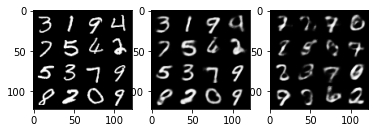

Iter: 26610/50000, Recon loss: 5758.1572, KL div loss: 1334.8558, Total loss: 7093.0132
Iter: 26620/50000, Recon loss: 5319.5898, KL div loss: 1309.3928, Total loss: 6628.9824
Iter: 26630/50000, Recon loss: 5649.8960, KL div loss: 1373.2847, Total loss: 7023.1807
Iter: 26640/50000, Recon loss: 5573.0264, KL div loss: 1351.3718, Total loss: 6924.3984
Iter: 26650/50000, Recon loss: 5825.6831, KL div loss: 1349.9622, Total loss: 7175.6455


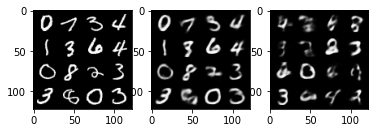

Iter: 26660/50000, Recon loss: 5537.2778, KL div loss: 1303.5914, Total loss: 6840.8691
Iter: 26670/50000, Recon loss: 5857.1113, KL div loss: 1399.6643, Total loss: 7256.7754
Iter: 26680/50000, Recon loss: 5627.6816, KL div loss: 1338.8462, Total loss: 6966.5278
Iter: 26690/50000, Recon loss: 5531.0269, KL div loss: 1306.8523, Total loss: 6837.8789
Iter: 26700/50000, Recon loss: 5342.8677, KL div loss: 1339.6511, Total loss: 6682.5186


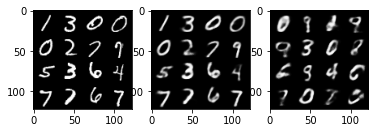

Iter: 26710/50000, Recon loss: 5837.7158, KL div loss: 1353.1537, Total loss: 7190.8696
Iter: 26720/50000, Recon loss: 5404.2207, KL div loss: 1370.0776, Total loss: 6774.2983
Iter: 26730/50000, Recon loss: 5337.5117, KL div loss: 1319.5642, Total loss: 6657.0762
Iter: 26740/50000, Recon loss: 5639.9683, KL div loss: 1343.4027, Total loss: 6983.3711
Iter: 26750/50000, Recon loss: 5729.1309, KL div loss: 1362.5562, Total loss: 7091.6870


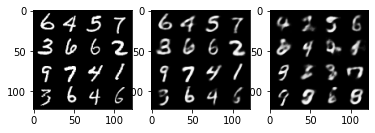

Iter: 26760/50000, Recon loss: 5784.9277, KL div loss: 1401.9153, Total loss: 7186.8428
Iter: 26770/50000, Recon loss: 5642.8970, KL div loss: 1375.2233, Total loss: 7018.1201
Iter: 26780/50000, Recon loss: 5872.0889, KL div loss: 1392.8936, Total loss: 7264.9824
Iter: 26790/50000, Recon loss: 5567.4980, KL div loss: 1350.2114, Total loss: 6917.7095
Iter: 26800/50000, Recon loss: 5652.1045, KL div loss: 1336.8390, Total loss: 6988.9434


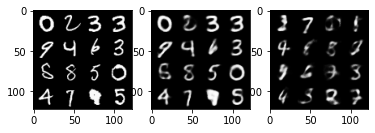

Iter: 26810/50000, Recon loss: 5790.6489, KL div loss: 1400.9465, Total loss: 7191.5957
Iter: 26820/50000, Recon loss: 5504.0605, KL div loss: 1311.2900, Total loss: 6815.3506
Iter: 26830/50000, Recon loss: 6222.3115, KL div loss: 1352.2310, Total loss: 7574.5425
Iter: 26840/50000, Recon loss: 5599.8760, KL div loss: 1371.4698, Total loss: 6971.3457
Iter: 26850/50000, Recon loss: 5938.8472, KL div loss: 1369.2627, Total loss: 7308.1099


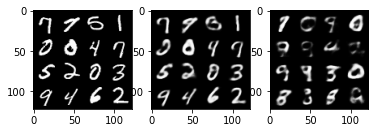

Iter: 26860/50000, Recon loss: 5782.2769, KL div loss: 1393.1628, Total loss: 7175.4395
Iter: 26870/50000, Recon loss: 5800.8936, KL div loss: 1387.0674, Total loss: 7187.9609
Iter: 26880/50000, Recon loss: 5721.9473, KL div loss: 1366.5740, Total loss: 7088.5215
Iter: 26890/50000, Recon loss: 5675.7158, KL div loss: 1320.7158, Total loss: 6996.4316
Iter: 26900/50000, Recon loss: 5541.0293, KL div loss: 1300.1211, Total loss: 6841.1504


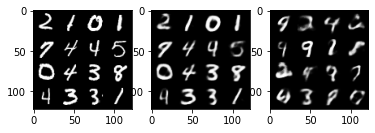

Iter: 26910/50000, Recon loss: 5706.5640, KL div loss: 1402.7614, Total loss: 7109.3252
Iter: 26920/50000, Recon loss: 5440.3433, KL div loss: 1356.6267, Total loss: 6796.9697
Iter: 26930/50000, Recon loss: 5084.9277, KL div loss: 1348.9578, Total loss: 6433.8857
Iter: 26940/50000, Recon loss: 5676.6499, KL div loss: 1313.8811, Total loss: 6990.5312
Iter: 26950/50000, Recon loss: 5695.2358, KL div loss: 1391.5769, Total loss: 7086.8125


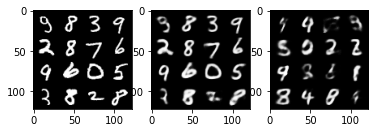

Iter: 26960/50000, Recon loss: 5547.1104, KL div loss: 1337.5389, Total loss: 6884.6494
Iter: 26970/50000, Recon loss: 5861.4761, KL div loss: 1365.5349, Total loss: 7227.0107
Iter: 26980/50000, Recon loss: 5923.1758, KL div loss: 1397.9033, Total loss: 7321.0791
Iter: 26990/50000, Recon loss: 5816.0630, KL div loss: 1370.2961, Total loss: 7186.3594
Iter: 27000/50000, Recon loss: 5723.5620, KL div loss: 1335.9528, Total loss: 7059.5146


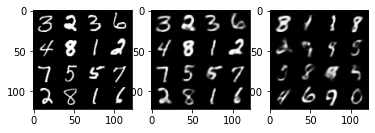

Iter: 27010/50000, Recon loss: 5513.6021, KL div loss: 1338.1622, Total loss: 6851.7642
Iter: 27020/50000, Recon loss: 5861.7319, KL div loss: 1358.1530, Total loss: 7219.8848
Iter: 27030/50000, Recon loss: 5936.6929, KL div loss: 1357.6021, Total loss: 7294.2949
Iter: 27040/50000, Recon loss: 5566.4229, KL div loss: 1346.0204, Total loss: 6912.4434
Iter: 27050/50000, Recon loss: 6049.0073, KL div loss: 1416.2018, Total loss: 7465.2090


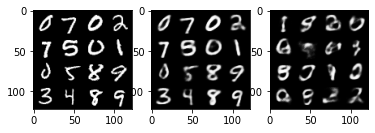

Iter: 27060/50000, Recon loss: 5656.5264, KL div loss: 1317.7100, Total loss: 6974.2363
Iter: 27070/50000, Recon loss: 5754.4624, KL div loss: 1344.4800, Total loss: 7098.9424
Iter: 27080/50000, Recon loss: 5363.1465, KL div loss: 1313.2190, Total loss: 6676.3652
Iter: 27090/50000, Recon loss: 5542.7676, KL div loss: 1384.8268, Total loss: 6927.5942
Iter: 27100/50000, Recon loss: 5627.1543, KL div loss: 1358.5659, Total loss: 6985.7202


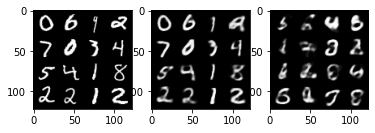

Iter: 27110/50000, Recon loss: 5613.5977, KL div loss: 1375.9673, Total loss: 6989.5649
Iter: 27120/50000, Recon loss: 5408.0391, KL div loss: 1354.4099, Total loss: 6762.4492
Iter: 27130/50000, Recon loss: 5406.1968, KL div loss: 1341.7058, Total loss: 6747.9023
Iter: 27140/50000, Recon loss: 5627.7305, KL div loss: 1375.6658, Total loss: 7003.3965
Iter: 27150/50000, Recon loss: 5708.1631, KL div loss: 1357.2006, Total loss: 7065.3638


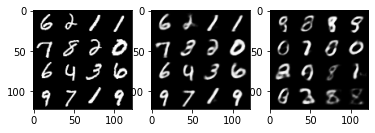

Iter: 27160/50000, Recon loss: 5226.9727, KL div loss: 1304.4076, Total loss: 6531.3804
Iter: 27170/50000, Recon loss: 5589.3428, KL div loss: 1350.4265, Total loss: 6939.7695
Iter: 27180/50000, Recon loss: 5970.7114, KL div loss: 1355.6345, Total loss: 7326.3457
Iter: 27190/50000, Recon loss: 5551.7715, KL div loss: 1352.0408, Total loss: 6903.8125
Iter: 27200/50000, Recon loss: 6246.1377, KL div loss: 1409.3639, Total loss: 7655.5015


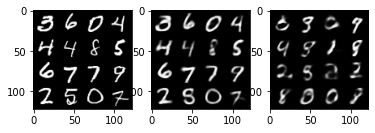

Iter: 27210/50000, Recon loss: 5699.8657, KL div loss: 1317.5544, Total loss: 7017.4199
Iter: 27220/50000, Recon loss: 5852.2617, KL div loss: 1394.6357, Total loss: 7246.8975
Iter: 27230/50000, Recon loss: 5496.0840, KL div loss: 1393.4446, Total loss: 6889.5283
Iter: 27240/50000, Recon loss: 5873.6904, KL div loss: 1380.3459, Total loss: 7254.0361
Iter: 27250/50000, Recon loss: 5939.9653, KL div loss: 1339.2500, Total loss: 7279.2153


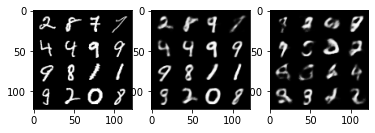

Iter: 27260/50000, Recon loss: 5868.3789, KL div loss: 1343.9758, Total loss: 7212.3545
Iter: 27270/50000, Recon loss: 5637.7739, KL div loss: 1354.2551, Total loss: 6992.0293
Iter: 27280/50000, Recon loss: 5591.2671, KL div loss: 1377.6074, Total loss: 6968.8745
Iter: 27290/50000, Recon loss: 5711.7725, KL div loss: 1395.3386, Total loss: 7107.1113
Iter: 27300/50000, Recon loss: 5684.6074, KL div loss: 1377.0725, Total loss: 7061.6797


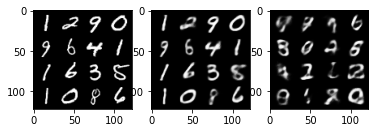

Iter: 27310/50000, Recon loss: 5499.7070, KL div loss: 1347.5652, Total loss: 6847.2725
Iter: 27320/50000, Recon loss: 5474.7051, KL div loss: 1365.9592, Total loss: 6840.6641
Iter: 27330/50000, Recon loss: 5905.8237, KL div loss: 1395.0320, Total loss: 7300.8555
Iter: 27340/50000, Recon loss: 5966.2002, KL div loss: 1387.4072, Total loss: 7353.6074
Iter: 27350/50000, Recon loss: 5617.0771, KL div loss: 1351.7927, Total loss: 6968.8701


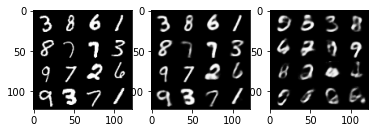

Iter: 27360/50000, Recon loss: 6225.2061, KL div loss: 1365.7872, Total loss: 7590.9932
Iter: 27370/50000, Recon loss: 5849.2637, KL div loss: 1386.4640, Total loss: 7235.7275
Iter: 27380/50000, Recon loss: 5610.6372, KL div loss: 1357.8226, Total loss: 6968.4600
Iter: 27390/50000, Recon loss: 5732.7500, KL div loss: 1389.9177, Total loss: 7122.6680
Iter: 27400/50000, Recon loss: 5749.2695, KL div loss: 1365.7979, Total loss: 7115.0674


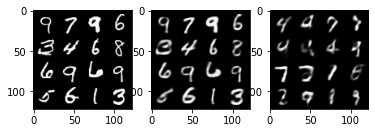

Iter: 27410/50000, Recon loss: 5793.8105, KL div loss: 1385.6044, Total loss: 7179.4150
Iter: 27420/50000, Recon loss: 5498.4175, KL div loss: 1399.1028, Total loss: 6897.5205
Iter: 27430/50000, Recon loss: 5594.3496, KL div loss: 1329.3220, Total loss: 6923.6719
Iter: 27440/50000, Recon loss: 5641.8916, KL div loss: 1404.4087, Total loss: 7046.3003
Iter: 27450/50000, Recon loss: 5961.3521, KL div loss: 1382.2469, Total loss: 7343.5991


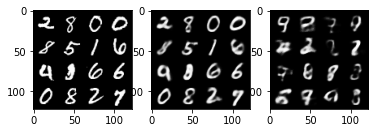

Iter: 27460/50000, Recon loss: 5713.5532, KL div loss: 1405.5538, Total loss: 7119.1069
Iter: 27470/50000, Recon loss: 5636.8262, KL div loss: 1369.5833, Total loss: 7006.4092
Iter: 27480/50000, Recon loss: 5753.9971, KL div loss: 1372.0652, Total loss: 7126.0625
Iter: 27490/50000, Recon loss: 5708.1196, KL div loss: 1397.5232, Total loss: 7105.6426
Iter: 27500/50000, Recon loss: 5432.0039, KL div loss: 1363.6707, Total loss: 6795.6748


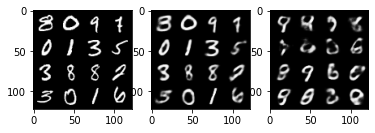

Iter: 27510/50000, Recon loss: 5153.2822, KL div loss: 1307.0183, Total loss: 6460.3008
Iter: 27520/50000, Recon loss: 5261.6504, KL div loss: 1347.4397, Total loss: 6609.0898
Iter: 27530/50000, Recon loss: 5529.0166, KL div loss: 1345.9968, Total loss: 6875.0137
Iter: 27540/50000, Recon loss: 5592.1885, KL div loss: 1346.5583, Total loss: 6938.7471
Iter: 27550/50000, Recon loss: 5804.6846, KL div loss: 1378.2228, Total loss: 7182.9072


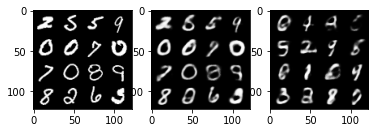

Iter: 27560/50000, Recon loss: 5574.1016, KL div loss: 1355.9884, Total loss: 6930.0898
Iter: 27570/50000, Recon loss: 5507.7017, KL div loss: 1343.0380, Total loss: 6850.7397
Iter: 27580/50000, Recon loss: 5675.5269, KL div loss: 1356.7252, Total loss: 7032.2520
Iter: 27590/50000, Recon loss: 5604.5938, KL div loss: 1392.7937, Total loss: 6997.3877
Iter: 27600/50000, Recon loss: 5341.6226, KL div loss: 1360.5208, Total loss: 6702.1436


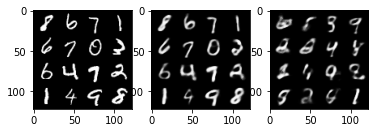

Iter: 27610/50000, Recon loss: 5479.3252, KL div loss: 1325.7544, Total loss: 6805.0796
Iter: 27620/50000, Recon loss: 5545.1318, KL div loss: 1373.0753, Total loss: 6918.2070
Iter: 27630/50000, Recon loss: 5611.6826, KL div loss: 1362.7057, Total loss: 6974.3882
Iter: 27640/50000, Recon loss: 5687.6016, KL div loss: 1408.8986, Total loss: 7096.5000
Iter: 27650/50000, Recon loss: 5659.4536, KL div loss: 1362.7539, Total loss: 7022.2075


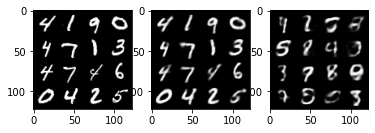

Iter: 27660/50000, Recon loss: 5740.8584, KL div loss: 1354.8970, Total loss: 7095.7554
Iter: 27670/50000, Recon loss: 5731.3418, KL div loss: 1351.4952, Total loss: 7082.8369
Iter: 27680/50000, Recon loss: 5789.6460, KL div loss: 1351.7729, Total loss: 7141.4189
Iter: 27690/50000, Recon loss: 5583.4951, KL div loss: 1379.2189, Total loss: 6962.7139
Iter: 27700/50000, Recon loss: 6016.6504, KL div loss: 1390.8000, Total loss: 7407.4502


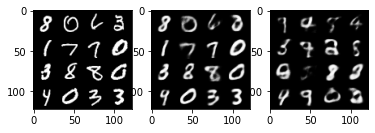

Iter: 27710/50000, Recon loss: 5614.9971, KL div loss: 1346.1982, Total loss: 6961.1953
Iter: 27720/50000, Recon loss: 5378.5879, KL div loss: 1299.2546, Total loss: 6677.8428
Iter: 27730/50000, Recon loss: 5622.4219, KL div loss: 1365.9949, Total loss: 6988.4170
Iter: 27740/50000, Recon loss: 5688.6035, KL div loss: 1382.2565, Total loss: 7070.8599
Iter: 27750/50000, Recon loss: 5672.1465, KL div loss: 1354.3740, Total loss: 7026.5205


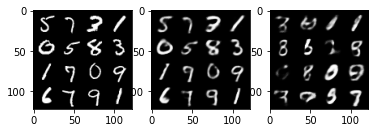

Iter: 27760/50000, Recon loss: 6141.5410, KL div loss: 1380.8456, Total loss: 7522.3867
Iter: 27770/50000, Recon loss: 5455.2646, KL div loss: 1388.5160, Total loss: 6843.7808
Iter: 27780/50000, Recon loss: 5945.8311, KL div loss: 1398.6162, Total loss: 7344.4473
Iter: 27790/50000, Recon loss: 5815.0356, KL div loss: 1365.5649, Total loss: 7180.6006
Iter: 27800/50000, Recon loss: 5728.5098, KL div loss: 1399.5703, Total loss: 7128.0801


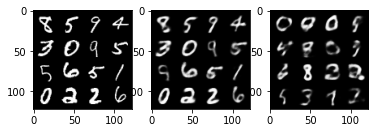

Iter: 27810/50000, Recon loss: 5223.4238, KL div loss: 1348.2084, Total loss: 6571.6323
Iter: 27820/50000, Recon loss: 5522.0166, KL div loss: 1361.7712, Total loss: 6883.7881
Iter: 27830/50000, Recon loss: 5512.5435, KL div loss: 1386.2744, Total loss: 6898.8179
Iter: 27840/50000, Recon loss: 5872.9761, KL div loss: 1379.4158, Total loss: 7252.3916
Iter: 27850/50000, Recon loss: 5541.6484, KL div loss: 1410.6077, Total loss: 6952.2559


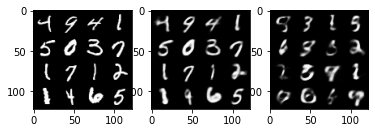

Iter: 27860/50000, Recon loss: 5811.2495, KL div loss: 1403.4065, Total loss: 7214.6562
Iter: 27870/50000, Recon loss: 5503.8496, KL div loss: 1380.5000, Total loss: 6884.3496
Iter: 27880/50000, Recon loss: 5749.5078, KL div loss: 1395.1774, Total loss: 7144.6851
Iter: 27890/50000, Recon loss: 5570.9653, KL div loss: 1332.8701, Total loss: 6903.8354
Iter: 27900/50000, Recon loss: 5580.2969, KL div loss: 1342.2144, Total loss: 6922.5112


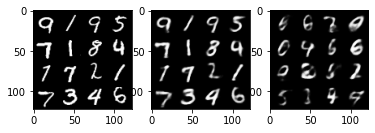

Iter: 27910/50000, Recon loss: 5916.2949, KL div loss: 1377.1584, Total loss: 7293.4531
Iter: 27920/50000, Recon loss: 5370.7041, KL div loss: 1355.3147, Total loss: 6726.0186
Iter: 27930/50000, Recon loss: 5364.9556, KL div loss: 1347.3364, Total loss: 6712.2920
Iter: 27940/50000, Recon loss: 5810.6460, KL div loss: 1384.2498, Total loss: 7194.8955
Iter: 27950/50000, Recon loss: 5465.6768, KL div loss: 1357.4006, Total loss: 6823.0771


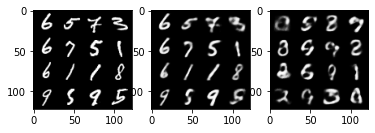

Iter: 27960/50000, Recon loss: 5670.4326, KL div loss: 1378.2373, Total loss: 7048.6699
Iter: 27970/50000, Recon loss: 5887.1670, KL div loss: 1421.4906, Total loss: 7308.6577
Iter: 27980/50000, Recon loss: 6151.0562, KL div loss: 1438.2310, Total loss: 7589.2871
Iter: 27990/50000, Recon loss: 5556.4072, KL div loss: 1378.2626, Total loss: 6934.6699
Iter: 28000/50000, Recon loss: 5752.3799, KL div loss: 1346.3888, Total loss: 7098.7686


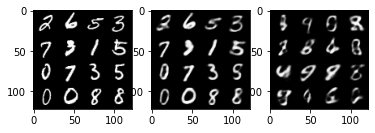

Iter: 28010/50000, Recon loss: 5934.1528, KL div loss: 1432.1027, Total loss: 7366.2554
Iter: 28020/50000, Recon loss: 5794.8203, KL div loss: 1387.1396, Total loss: 7181.9600
Iter: 28030/50000, Recon loss: 5671.2949, KL div loss: 1375.6600, Total loss: 7046.9551
Iter: 28040/50000, Recon loss: 5668.1982, KL div loss: 1380.4343, Total loss: 7048.6328
Iter: 28050/50000, Recon loss: 5984.2637, KL div loss: 1404.5547, Total loss: 7388.8184


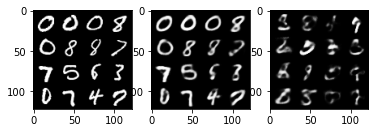

Iter: 28060/50000, Recon loss: 5729.9668, KL div loss: 1392.6493, Total loss: 7122.6162
Iter: 28070/50000, Recon loss: 5658.2690, KL div loss: 1381.0612, Total loss: 7039.3301
Iter: 28080/50000, Recon loss: 5404.6074, KL div loss: 1326.7216, Total loss: 6731.3291
Iter: 28090/50000, Recon loss: 5587.3633, KL div loss: 1337.0701, Total loss: 6924.4336
Iter: 28100/50000, Recon loss: 5444.2100, KL div loss: 1390.1619, Total loss: 6834.3721


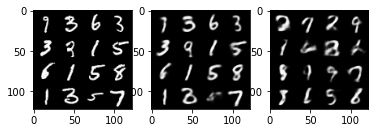

Iter: 28110/50000, Recon loss: 6025.8350, KL div loss: 1411.2793, Total loss: 7437.1143
Iter: 28120/50000, Recon loss: 5897.2417, KL div loss: 1394.9836, Total loss: 7292.2256
Iter: 28130/50000, Recon loss: 5482.4453, KL div loss: 1376.3577, Total loss: 6858.8027
Iter: 28140/50000, Recon loss: 5694.1709, KL div loss: 1370.1067, Total loss: 7064.2773
Iter: 28150/50000, Recon loss: 5624.3672, KL div loss: 1357.7311, Total loss: 6982.0981


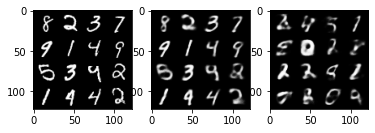

Iter: 28160/50000, Recon loss: 5546.4810, KL div loss: 1406.0920, Total loss: 6952.5732
Iter: 28170/50000, Recon loss: 5670.2876, KL div loss: 1381.2517, Total loss: 7051.5391
Iter: 28180/50000, Recon loss: 5767.8740, KL div loss: 1359.8062, Total loss: 7127.6802
Iter: 28190/50000, Recon loss: 5874.3594, KL div loss: 1396.8198, Total loss: 7271.1792
Iter: 28200/50000, Recon loss: 5569.8716, KL div loss: 1365.0007, Total loss: 6934.8721


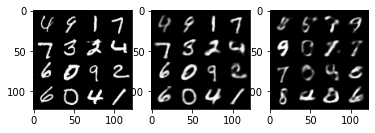

Iter: 28210/50000, Recon loss: 5879.2554, KL div loss: 1386.8065, Total loss: 7266.0620
Iter: 28220/50000, Recon loss: 5952.8491, KL div loss: 1433.0858, Total loss: 7385.9351
Iter: 28230/50000, Recon loss: 5480.1465, KL div loss: 1338.2115, Total loss: 6818.3579
Iter: 28240/50000, Recon loss: 6001.9463, KL div loss: 1394.6138, Total loss: 7396.5601
Iter: 28250/50000, Recon loss: 5543.7046, KL div loss: 1376.6406, Total loss: 6920.3452


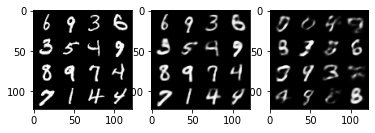

Iter: 28260/50000, Recon loss: 5480.7920, KL div loss: 1402.9617, Total loss: 6883.7539
Iter: 28270/50000, Recon loss: 5398.0820, KL div loss: 1361.2078, Total loss: 6759.2900
Iter: 28280/50000, Recon loss: 5925.3662, KL div loss: 1406.1057, Total loss: 7331.4717
Iter: 28290/50000, Recon loss: 6126.7998, KL div loss: 1434.9412, Total loss: 7561.7412
Iter: 28300/50000, Recon loss: 5703.4834, KL div loss: 1392.5474, Total loss: 7096.0308


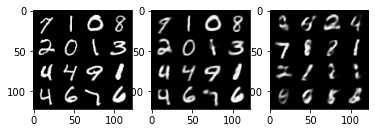

Iter: 28310/50000, Recon loss: 5247.2231, KL div loss: 1334.6636, Total loss: 6581.8867
Iter: 28320/50000, Recon loss: 5414.0859, KL div loss: 1362.5793, Total loss: 6776.6650
Iter: 28330/50000, Recon loss: 5651.3262, KL div loss: 1369.4082, Total loss: 7020.7344
Iter: 28340/50000, Recon loss: 5670.9648, KL div loss: 1384.1143, Total loss: 7055.0791
Iter: 28350/50000, Recon loss: 5302.9331, KL div loss: 1347.5900, Total loss: 6650.5229


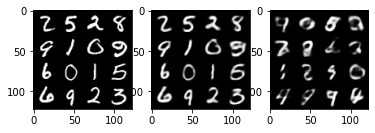

Iter: 28360/50000, Recon loss: 5631.7822, KL div loss: 1377.0815, Total loss: 7008.8638
Iter: 28370/50000, Recon loss: 5825.0142, KL div loss: 1408.6980, Total loss: 7233.7119
Iter: 28380/50000, Recon loss: 5687.4155, KL div loss: 1360.3174, Total loss: 7047.7329
Iter: 28390/50000, Recon loss: 5497.5942, KL div loss: 1387.9912, Total loss: 6885.5854
Iter: 28400/50000, Recon loss: 5786.6455, KL div loss: 1379.6687, Total loss: 7166.3145


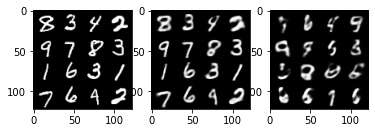

Iter: 28410/50000, Recon loss: 5810.1187, KL div loss: 1366.9661, Total loss: 7177.0850
Iter: 28420/50000, Recon loss: 5785.6729, KL div loss: 1366.7415, Total loss: 7152.4141
Iter: 28430/50000, Recon loss: 5596.8154, KL div loss: 1372.6591, Total loss: 6969.4746
Iter: 28440/50000, Recon loss: 5743.4082, KL div loss: 1303.5239, Total loss: 7046.9321
Iter: 28450/50000, Recon loss: 5500.0713, KL div loss: 1343.6328, Total loss: 6843.7041


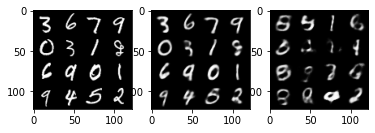

Iter: 28460/50000, Recon loss: 5355.0239, KL div loss: 1341.5635, Total loss: 6696.5874
Iter: 28470/50000, Recon loss: 5950.4302, KL div loss: 1392.3533, Total loss: 7342.7832
Iter: 28480/50000, Recon loss: 5184.7480, KL div loss: 1282.8861, Total loss: 6467.6343
Iter: 28490/50000, Recon loss: 5436.0430, KL div loss: 1397.4277, Total loss: 6833.4707
Iter: 28500/50000, Recon loss: 5779.7456, KL div loss: 1349.7852, Total loss: 7129.5308


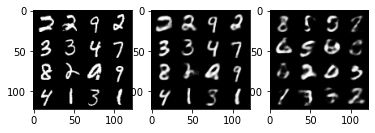

Iter: 28510/50000, Recon loss: 6046.0283, KL div loss: 1390.9626, Total loss: 7436.9912
Iter: 28520/50000, Recon loss: 5534.2642, KL div loss: 1408.5085, Total loss: 6942.7725
Iter: 28530/50000, Recon loss: 6304.9116, KL div loss: 1386.5524, Total loss: 7691.4639
Iter: 28540/50000, Recon loss: 5162.5547, KL div loss: 1290.2563, Total loss: 6452.8110
Iter: 28550/50000, Recon loss: 5303.8438, KL div loss: 1326.5049, Total loss: 6630.3486


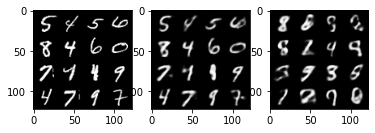

Iter: 28560/50000, Recon loss: 5542.1763, KL div loss: 1384.4282, Total loss: 6926.6045
Iter: 28570/50000, Recon loss: 5607.4873, KL div loss: 1433.4780, Total loss: 7040.9653
Iter: 28580/50000, Recon loss: 5883.3682, KL div loss: 1374.1450, Total loss: 7257.5132
Iter: 28590/50000, Recon loss: 5825.9131, KL div loss: 1387.0021, Total loss: 7212.9150
Iter: 28600/50000, Recon loss: 5785.0991, KL div loss: 1414.3923, Total loss: 7199.4912


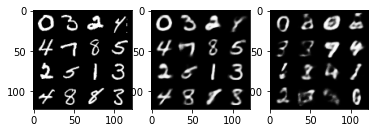

Iter: 28610/50000, Recon loss: 5619.2471, KL div loss: 1417.6836, Total loss: 7036.9307
Iter: 28620/50000, Recon loss: 5510.8936, KL div loss: 1367.4833, Total loss: 6878.3770
Iter: 28630/50000, Recon loss: 5598.4844, KL div loss: 1296.8862, Total loss: 6895.3706
Iter: 28640/50000, Recon loss: 5607.8623, KL div loss: 1387.8369, Total loss: 6995.6992
Iter: 28650/50000, Recon loss: 5372.8057, KL div loss: 1332.3730, Total loss: 6705.1787


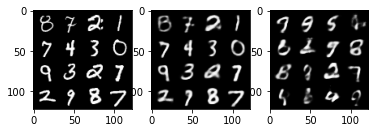

Iter: 28660/50000, Recon loss: 5774.1636, KL div loss: 1423.6699, Total loss: 7197.8335
Iter: 28670/50000, Recon loss: 5631.8086, KL div loss: 1411.6724, Total loss: 7043.4810
Iter: 28680/50000, Recon loss: 5715.3652, KL div loss: 1372.5303, Total loss: 7087.8955
Iter: 28690/50000, Recon loss: 5493.2720, KL div loss: 1345.7402, Total loss: 6839.0122
Iter: 28700/50000, Recon loss: 5357.6475, KL div loss: 1331.3221, Total loss: 6688.9697


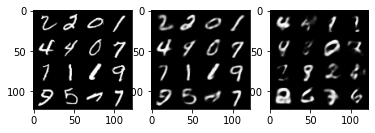

Iter: 28710/50000, Recon loss: 5615.8042, KL div loss: 1364.6165, Total loss: 6980.4209
Iter: 28720/50000, Recon loss: 5318.1904, KL div loss: 1372.8361, Total loss: 6691.0264
Iter: 28730/50000, Recon loss: 5826.0703, KL div loss: 1398.5425, Total loss: 7224.6128
Iter: 28740/50000, Recon loss: 5788.9282, KL div loss: 1394.2638, Total loss: 7183.1919
Iter: 28750/50000, Recon loss: 5307.5029, KL div loss: 1394.9738, Total loss: 6702.4766


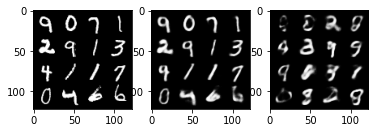

Iter: 28760/50000, Recon loss: 5756.8105, KL div loss: 1364.6277, Total loss: 7121.4385
Iter: 28770/50000, Recon loss: 5397.1406, KL div loss: 1362.3452, Total loss: 6759.4858
Iter: 28780/50000, Recon loss: 5477.0439, KL div loss: 1396.3812, Total loss: 6873.4253
Iter: 28790/50000, Recon loss: 5802.5552, KL div loss: 1382.2429, Total loss: 7184.7979
Iter: 28800/50000, Recon loss: 5645.0088, KL div loss: 1296.9014, Total loss: 6941.9102


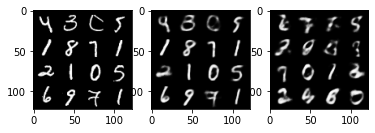

Iter: 28810/50000, Recon loss: 5451.3931, KL div loss: 1361.1996, Total loss: 6812.5928
Iter: 28820/50000, Recon loss: 5715.9883, KL div loss: 1410.6317, Total loss: 7126.6201
Iter: 28830/50000, Recon loss: 5455.9004, KL div loss: 1371.4180, Total loss: 6827.3184
Iter: 28840/50000, Recon loss: 5618.6689, KL div loss: 1392.5641, Total loss: 7011.2329
Iter: 28850/50000, Recon loss: 5711.4727, KL div loss: 1344.2332, Total loss: 7055.7061


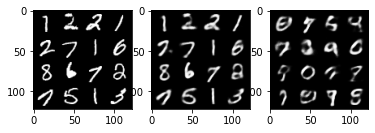

Iter: 28860/50000, Recon loss: 5879.4258, KL div loss: 1336.7100, Total loss: 7216.1357
Iter: 28870/50000, Recon loss: 5457.2959, KL div loss: 1356.7419, Total loss: 6814.0381
Iter: 28880/50000, Recon loss: 5565.0977, KL div loss: 1403.6411, Total loss: 6968.7388
Iter: 28890/50000, Recon loss: 6002.1465, KL div loss: 1369.9111, Total loss: 7372.0576
Iter: 28900/50000, Recon loss: 5425.6504, KL div loss: 1345.0803, Total loss: 6770.7305


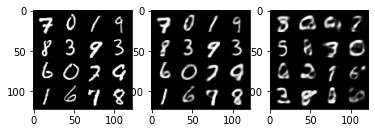

Iter: 28910/50000, Recon loss: 5936.8774, KL div loss: 1420.4106, Total loss: 7357.2881
Iter: 28920/50000, Recon loss: 5582.1602, KL div loss: 1398.8114, Total loss: 6980.9717
Iter: 28930/50000, Recon loss: 5545.5068, KL div loss: 1350.0538, Total loss: 6895.5605
Iter: 28940/50000, Recon loss: 5556.1133, KL div loss: 1325.9926, Total loss: 6882.1060
Iter: 28950/50000, Recon loss: 5374.7031, KL div loss: 1358.8325, Total loss: 6733.5356


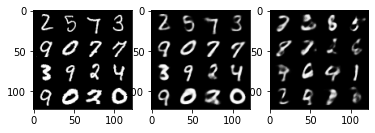

Iter: 28960/50000, Recon loss: 5527.4990, KL div loss: 1350.5182, Total loss: 6878.0171
Iter: 28970/50000, Recon loss: 5338.6870, KL div loss: 1411.3972, Total loss: 6750.0840
Iter: 28980/50000, Recon loss: 5591.2822, KL div loss: 1398.1483, Total loss: 6989.4307
Iter: 28990/50000, Recon loss: 5593.0420, KL div loss: 1364.6689, Total loss: 6957.7109
Iter: 29000/50000, Recon loss: 5365.6250, KL div loss: 1350.1561, Total loss: 6715.7812


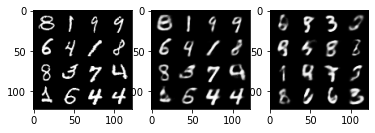

Iter: 29010/50000, Recon loss: 5451.3535, KL div loss: 1397.8876, Total loss: 6849.2412
Iter: 29020/50000, Recon loss: 5572.1489, KL div loss: 1380.0721, Total loss: 6952.2212
Iter: 29030/50000, Recon loss: 5715.8096, KL div loss: 1385.3994, Total loss: 7101.2090
Iter: 29040/50000, Recon loss: 5597.7192, KL div loss: 1362.4601, Total loss: 6960.1792
Iter: 29050/50000, Recon loss: 5878.5801, KL div loss: 1387.6787, Total loss: 7266.2588


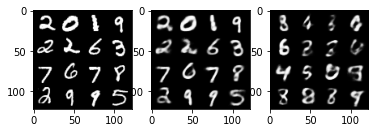

Iter: 29060/50000, Recon loss: 5859.4121, KL div loss: 1390.0493, Total loss: 7249.4614
Iter: 29070/50000, Recon loss: 5595.1333, KL div loss: 1359.9189, Total loss: 6955.0522
Iter: 29080/50000, Recon loss: 5704.4868, KL div loss: 1367.7037, Total loss: 7072.1904
Iter: 29090/50000, Recon loss: 5446.2451, KL div loss: 1323.4368, Total loss: 6769.6816
Iter: 29100/50000, Recon loss: 5481.4180, KL div loss: 1342.2812, Total loss: 6823.6992


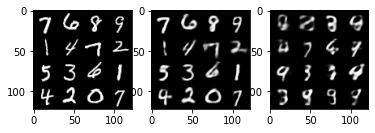

Iter: 29110/50000, Recon loss: 5853.9390, KL div loss: 1419.1030, Total loss: 7273.0420
Iter: 29120/50000, Recon loss: 5243.7744, KL div loss: 1323.0669, Total loss: 6566.8413
Iter: 29130/50000, Recon loss: 5784.1621, KL div loss: 1418.3787, Total loss: 7202.5410
Iter: 29140/50000, Recon loss: 5944.1411, KL div loss: 1395.6147, Total loss: 7339.7559
Iter: 29150/50000, Recon loss: 5647.3516, KL div loss: 1352.0238, Total loss: 6999.3755


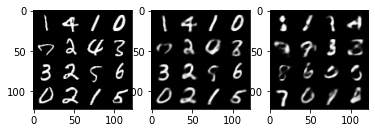

Iter: 29160/50000, Recon loss: 5595.8574, KL div loss: 1375.3342, Total loss: 6971.1914
Iter: 29170/50000, Recon loss: 5891.6836, KL div loss: 1422.2731, Total loss: 7313.9565
Iter: 29180/50000, Recon loss: 5888.9268, KL div loss: 1383.3833, Total loss: 7272.3101
Iter: 29190/50000, Recon loss: 5644.5557, KL div loss: 1355.1440, Total loss: 6999.6997
Iter: 29200/50000, Recon loss: 5744.9971, KL div loss: 1397.6593, Total loss: 7142.6562


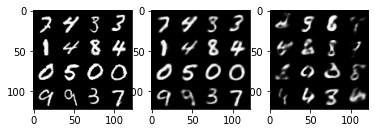

Iter: 29210/50000, Recon loss: 5613.2402, KL div loss: 1388.7073, Total loss: 7001.9473
Iter: 29220/50000, Recon loss: 5698.0430, KL div loss: 1403.4250, Total loss: 7101.4678
Iter: 29230/50000, Recon loss: 5714.9395, KL div loss: 1390.7812, Total loss: 7105.7207
Iter: 29240/50000, Recon loss: 5363.7783, KL div loss: 1335.5967, Total loss: 6699.3750
Iter: 29250/50000, Recon loss: 5654.6621, KL div loss: 1349.8376, Total loss: 7004.5000


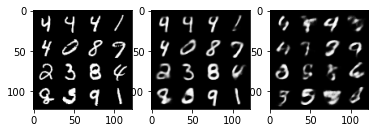

Iter: 29260/50000, Recon loss: 5771.8369, KL div loss: 1415.9243, Total loss: 7187.7612
Iter: 29270/50000, Recon loss: 5143.6943, KL div loss: 1307.5905, Total loss: 6451.2847
Iter: 29280/50000, Recon loss: 5853.9849, KL div loss: 1368.5505, Total loss: 7222.5352
Iter: 29290/50000, Recon loss: 5781.9756, KL div loss: 1392.8435, Total loss: 7174.8193
Iter: 29300/50000, Recon loss: 5759.9937, KL div loss: 1429.2892, Total loss: 7189.2827


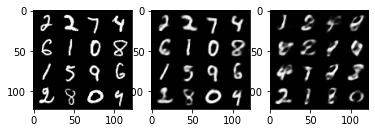

Iter: 29310/50000, Recon loss: 5222.4277, KL div loss: 1364.7319, Total loss: 6587.1597
Iter: 29320/50000, Recon loss: 5528.7461, KL div loss: 1366.1268, Total loss: 6894.8730
Iter: 29330/50000, Recon loss: 5558.6289, KL div loss: 1373.3174, Total loss: 6931.9463
Iter: 29340/50000, Recon loss: 5680.6826, KL div loss: 1367.7828, Total loss: 7048.4653
Iter: 29350/50000, Recon loss: 5341.3359, KL div loss: 1337.5636, Total loss: 6678.8994


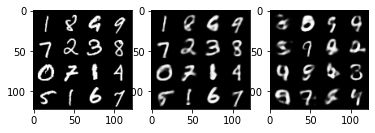

Iter: 29360/50000, Recon loss: 5810.3066, KL div loss: 1363.2395, Total loss: 7173.5459
Iter: 29370/50000, Recon loss: 5480.3555, KL div loss: 1399.0049, Total loss: 6879.3604
Iter: 29380/50000, Recon loss: 5824.3701, KL div loss: 1401.5905, Total loss: 7225.9604
Iter: 29390/50000, Recon loss: 5687.0405, KL div loss: 1386.2115, Total loss: 7073.2520
Iter: 29400/50000, Recon loss: 5585.4424, KL div loss: 1386.5500, Total loss: 6971.9922


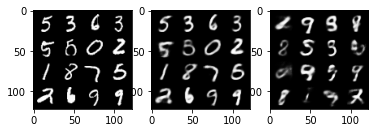

Iter: 29410/50000, Recon loss: 5442.3320, KL div loss: 1383.7334, Total loss: 6826.0654
Iter: 29420/50000, Recon loss: 5705.4893, KL div loss: 1409.2134, Total loss: 7114.7026
Iter: 29430/50000, Recon loss: 5654.5713, KL div loss: 1416.2725, Total loss: 7070.8438
Iter: 29440/50000, Recon loss: 5903.5068, KL div loss: 1395.2700, Total loss: 7298.7769
Iter: 29450/50000, Recon loss: 5597.1802, KL div loss: 1364.0995, Total loss: 6961.2798


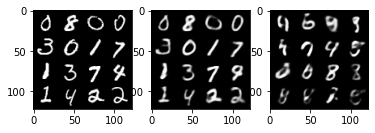

Iter: 29460/50000, Recon loss: 5413.5669, KL div loss: 1370.2179, Total loss: 6783.7847
Iter: 29470/50000, Recon loss: 5307.9595, KL div loss: 1353.3256, Total loss: 6661.2852
Iter: 29480/50000, Recon loss: 5198.9453, KL div loss: 1345.6077, Total loss: 6544.5527
Iter: 29490/50000, Recon loss: 5577.4028, KL div loss: 1364.1592, Total loss: 6941.5620
Iter: 29500/50000, Recon loss: 5521.2578, KL div loss: 1335.1372, Total loss: 6856.3950


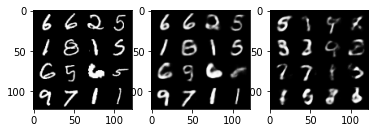

Iter: 29510/50000, Recon loss: 5583.6880, KL div loss: 1369.2002, Total loss: 6952.8882
Iter: 29520/50000, Recon loss: 5562.3008, KL div loss: 1420.8157, Total loss: 6983.1162
Iter: 29530/50000, Recon loss: 5669.5078, KL div loss: 1388.0358, Total loss: 7057.5435
Iter: 29540/50000, Recon loss: 5528.0254, KL div loss: 1321.5095, Total loss: 6849.5352
Iter: 29550/50000, Recon loss: 6073.0342, KL div loss: 1438.2046, Total loss: 7511.2388


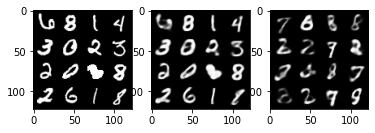

Iter: 29560/50000, Recon loss: 5425.1191, KL div loss: 1408.8689, Total loss: 6833.9883
Iter: 29570/50000, Recon loss: 5720.0381, KL div loss: 1404.3950, Total loss: 7124.4331
Iter: 29580/50000, Recon loss: 5717.6113, KL div loss: 1381.7346, Total loss: 7099.3457
Iter: 29590/50000, Recon loss: 5537.5723, KL div loss: 1371.5272, Total loss: 6909.0996
Iter: 29600/50000, Recon loss: 5613.0566, KL div loss: 1377.1140, Total loss: 6990.1709


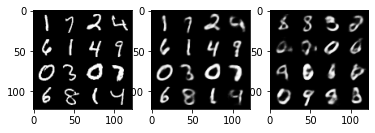

Iter: 29610/50000, Recon loss: 5676.6670, KL div loss: 1382.7888, Total loss: 7059.4561
Iter: 29620/50000, Recon loss: 5539.0918, KL div loss: 1365.2399, Total loss: 6904.3315
Iter: 29630/50000, Recon loss: 5614.9683, KL div loss: 1357.0820, Total loss: 6972.0503
Iter: 29640/50000, Recon loss: 5423.7275, KL div loss: 1326.7456, Total loss: 6750.4731
Iter: 29650/50000, Recon loss: 5903.4492, KL div loss: 1384.7000, Total loss: 7288.1494


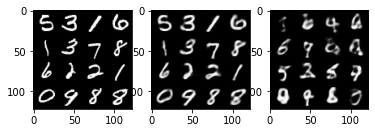

Iter: 29660/50000, Recon loss: 5454.9580, KL div loss: 1335.5388, Total loss: 6790.4971
Iter: 29670/50000, Recon loss: 5585.6182, KL div loss: 1339.7174, Total loss: 6925.3354
Iter: 29680/50000, Recon loss: 5668.5366, KL div loss: 1382.1721, Total loss: 7050.7090
Iter: 29690/50000, Recon loss: 5529.8848, KL div loss: 1370.6304, Total loss: 6900.5151
Iter: 29700/50000, Recon loss: 5381.3027, KL div loss: 1349.3260, Total loss: 6730.6289


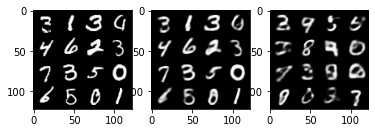

Iter: 29710/50000, Recon loss: 5770.7432, KL div loss: 1412.5005, Total loss: 7183.2437
Iter: 29720/50000, Recon loss: 5330.6387, KL div loss: 1371.8362, Total loss: 6702.4746
Iter: 29730/50000, Recon loss: 5694.7031, KL div loss: 1379.3927, Total loss: 7074.0957
Iter: 29740/50000, Recon loss: 5968.2520, KL div loss: 1373.4242, Total loss: 7341.6763
Iter: 29750/50000, Recon loss: 5589.6836, KL div loss: 1342.0496, Total loss: 6931.7334


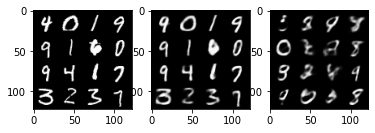

Iter: 29760/50000, Recon loss: 5990.1191, KL div loss: 1391.0017, Total loss: 7381.1211
Iter: 29770/50000, Recon loss: 5537.8545, KL div loss: 1355.7047, Total loss: 6893.5591
Iter: 29780/50000, Recon loss: 5643.4385, KL div loss: 1379.2312, Total loss: 7022.6699
Iter: 29790/50000, Recon loss: 5586.0527, KL div loss: 1373.9036, Total loss: 6959.9561
Iter: 29800/50000, Recon loss: 5504.5688, KL div loss: 1362.9634, Total loss: 6867.5322


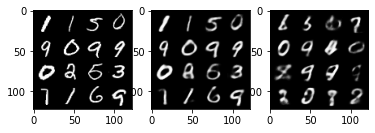

Iter: 29810/50000, Recon loss: 5729.3516, KL div loss: 1390.5271, Total loss: 7119.8789
Iter: 29820/50000, Recon loss: 5484.3394, KL div loss: 1349.9744, Total loss: 6834.3135
Iter: 29830/50000, Recon loss: 5691.2866, KL div loss: 1365.5715, Total loss: 7056.8584
Iter: 29840/50000, Recon loss: 5703.1279, KL div loss: 1364.9263, Total loss: 7068.0542
Iter: 29850/50000, Recon loss: 5939.7998, KL div loss: 1369.6564, Total loss: 7309.4561


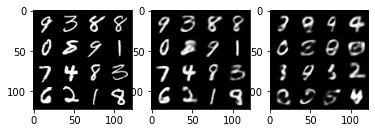

Iter: 29860/50000, Recon loss: 5165.8223, KL div loss: 1344.0011, Total loss: 6509.8232
Iter: 29870/50000, Recon loss: 5844.1641, KL div loss: 1375.1700, Total loss: 7219.3340
Iter: 29880/50000, Recon loss: 5332.7021, KL div loss: 1400.8003, Total loss: 6733.5024
Iter: 29890/50000, Recon loss: 5346.4736, KL div loss: 1393.3740, Total loss: 6739.8477
Iter: 29900/50000, Recon loss: 5704.9868, KL div loss: 1363.0444, Total loss: 7068.0312


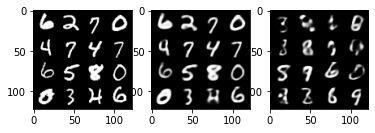

Iter: 29910/50000, Recon loss: 5840.3564, KL div loss: 1416.0630, Total loss: 7256.4194
Iter: 29920/50000, Recon loss: 5579.7788, KL div loss: 1377.6937, Total loss: 6957.4727
Iter: 29930/50000, Recon loss: 5907.3291, KL div loss: 1438.4686, Total loss: 7345.7979
Iter: 29940/50000, Recon loss: 5967.6489, KL div loss: 1410.2844, Total loss: 7377.9336
Iter: 29950/50000, Recon loss: 5795.3315, KL div loss: 1395.8198, Total loss: 7191.1514


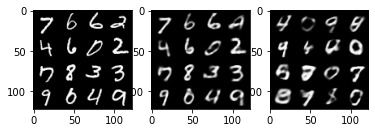

Iter: 29960/50000, Recon loss: 5506.1631, KL div loss: 1384.8608, Total loss: 6891.0239
Iter: 29970/50000, Recon loss: 5511.7979, KL div loss: 1366.3232, Total loss: 6878.1211
Iter: 29980/50000, Recon loss: 5975.1211, KL div loss: 1385.8792, Total loss: 7361.0000
Iter: 29990/50000, Recon loss: 5387.9492, KL div loss: 1346.4160, Total loss: 6734.3652
Iter: 30000/50000, Recon loss: 5563.4585, KL div loss: 1383.4393, Total loss: 6946.8979


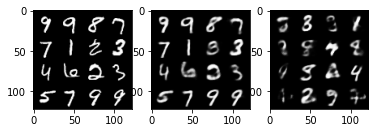

Iter: 30010/50000, Recon loss: 5722.5522, KL div loss: 1369.7004, Total loss: 7092.2529
Iter: 30020/50000, Recon loss: 5754.6724, KL div loss: 1384.0322, Total loss: 7138.7046
Iter: 30030/50000, Recon loss: 5862.5273, KL div loss: 1374.0256, Total loss: 7236.5527
Iter: 30040/50000, Recon loss: 5452.3018, KL div loss: 1341.8026, Total loss: 6794.1045
Iter: 30050/50000, Recon loss: 5604.1328, KL div loss: 1425.5764, Total loss: 7029.7090


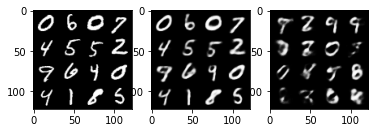

Iter: 30060/50000, Recon loss: 5766.1045, KL div loss: 1458.1895, Total loss: 7224.2939
Iter: 30070/50000, Recon loss: 5719.5049, KL div loss: 1396.5576, Total loss: 7116.0625
Iter: 30080/50000, Recon loss: 5601.2158, KL div loss: 1371.1123, Total loss: 6972.3281
Iter: 30090/50000, Recon loss: 5363.7271, KL div loss: 1339.8669, Total loss: 6703.5938
Iter: 30100/50000, Recon loss: 5315.6475, KL div loss: 1337.4089, Total loss: 6653.0566


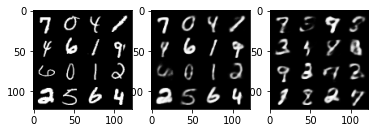

Iter: 30110/50000, Recon loss: 5694.5288, KL div loss: 1381.8286, Total loss: 7076.3574
Iter: 30120/50000, Recon loss: 5433.7119, KL div loss: 1349.6426, Total loss: 6783.3545
Iter: 30130/50000, Recon loss: 4974.9365, KL div loss: 1308.5078, Total loss: 6283.4443
Iter: 30140/50000, Recon loss: 5638.6392, KL div loss: 1412.3157, Total loss: 7050.9551
Iter: 30150/50000, Recon loss: 5367.4326, KL div loss: 1389.7068, Total loss: 6757.1396


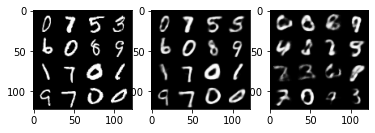

Iter: 30160/50000, Recon loss: 5674.4326, KL div loss: 1376.0029, Total loss: 7050.4355
Iter: 30170/50000, Recon loss: 5601.1265, KL div loss: 1383.7035, Total loss: 6984.8301
Iter: 30180/50000, Recon loss: 5423.6045, KL div loss: 1384.6028, Total loss: 6808.2070
Iter: 30190/50000, Recon loss: 5507.5479, KL div loss: 1375.0232, Total loss: 6882.5713
Iter: 30200/50000, Recon loss: 5326.9883, KL div loss: 1355.6938, Total loss: 6682.6821


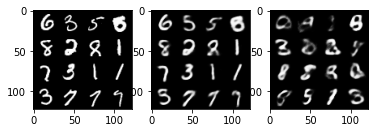

Iter: 30210/50000, Recon loss: 5164.2432, KL div loss: 1326.4651, Total loss: 6490.7080
Iter: 30220/50000, Recon loss: 5334.2212, KL div loss: 1371.3737, Total loss: 6705.5947
Iter: 30230/50000, Recon loss: 5521.1001, KL div loss: 1370.2091, Total loss: 6891.3091
Iter: 30240/50000, Recon loss: 5510.6870, KL div loss: 1406.3831, Total loss: 6917.0703
Iter: 30250/50000, Recon loss: 5284.7832, KL div loss: 1390.6757, Total loss: 6675.4590


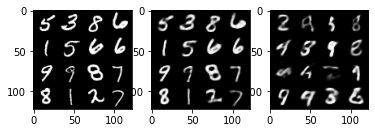

Iter: 30260/50000, Recon loss: 5477.2866, KL div loss: 1356.8942, Total loss: 6834.1807
Iter: 30270/50000, Recon loss: 6038.0005, KL div loss: 1401.7365, Total loss: 7439.7368
Iter: 30280/50000, Recon loss: 5765.4883, KL div loss: 1381.3456, Total loss: 7146.8340
Iter: 30290/50000, Recon loss: 5537.8496, KL div loss: 1357.8401, Total loss: 6895.6895
Iter: 30300/50000, Recon loss: 5767.5767, KL div loss: 1418.5020, Total loss: 7186.0786


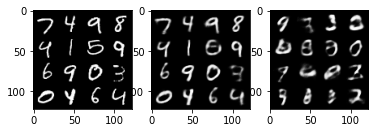

Iter: 30310/50000, Recon loss: 5676.8926, KL div loss: 1384.1726, Total loss: 7061.0654
Iter: 30320/50000, Recon loss: 5484.0557, KL div loss: 1377.5728, Total loss: 6861.6284
Iter: 30330/50000, Recon loss: 5510.9331, KL div loss: 1413.8936, Total loss: 6924.8267
Iter: 30340/50000, Recon loss: 5866.4053, KL div loss: 1415.8844, Total loss: 7282.2896
Iter: 30350/50000, Recon loss: 5500.3291, KL div loss: 1392.6287, Total loss: 6892.9580


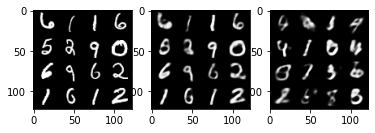

Iter: 30360/50000, Recon loss: 5666.7676, KL div loss: 1421.0674, Total loss: 7087.8350
Iter: 30370/50000, Recon loss: 5384.3882, KL div loss: 1360.6265, Total loss: 6745.0146
Iter: 30380/50000, Recon loss: 5523.8550, KL div loss: 1397.6858, Total loss: 6921.5410
Iter: 30390/50000, Recon loss: 5539.9072, KL div loss: 1358.3711, Total loss: 6898.2783
Iter: 30400/50000, Recon loss: 5264.0845, KL div loss: 1368.4292, Total loss: 6632.5137


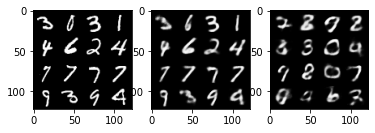

Iter: 30410/50000, Recon loss: 5762.8423, KL div loss: 1404.5342, Total loss: 7167.3765
Iter: 30420/50000, Recon loss: 5730.3047, KL div loss: 1475.3384, Total loss: 7205.6431
Iter: 30430/50000, Recon loss: 5692.1240, KL div loss: 1415.1555, Total loss: 7107.2793
Iter: 30440/50000, Recon loss: 5463.5771, KL div loss: 1341.5471, Total loss: 6805.1240
Iter: 30450/50000, Recon loss: 5904.4004, KL div loss: 1398.8904, Total loss: 7303.2910


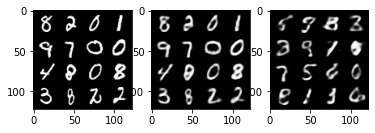

Iter: 30460/50000, Recon loss: 5197.4331, KL div loss: 1365.9695, Total loss: 6563.4023
Iter: 30470/50000, Recon loss: 5820.7109, KL div loss: 1371.9911, Total loss: 7192.7021
Iter: 30480/50000, Recon loss: 5168.9004, KL div loss: 1338.1101, Total loss: 6507.0107
Iter: 30490/50000, Recon loss: 5756.5010, KL div loss: 1407.9091, Total loss: 7164.4102
Iter: 30500/50000, Recon loss: 5616.6792, KL div loss: 1346.5287, Total loss: 6963.2080


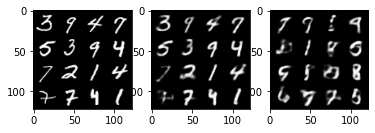

Iter: 30510/50000, Recon loss: 4997.8271, KL div loss: 1306.1812, Total loss: 6304.0083
Iter: 30520/50000, Recon loss: 5480.5571, KL div loss: 1433.7260, Total loss: 6914.2832
Iter: 30530/50000, Recon loss: 5560.4351, KL div loss: 1382.1864, Total loss: 6942.6216
Iter: 30540/50000, Recon loss: 5588.7344, KL div loss: 1365.4395, Total loss: 6954.1738
Iter: 30550/50000, Recon loss: 5854.7285, KL div loss: 1378.0267, Total loss: 7232.7554


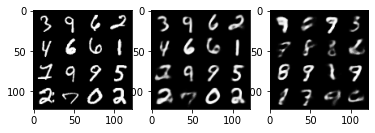

Iter: 30560/50000, Recon loss: 5818.8975, KL div loss: 1387.5746, Total loss: 7206.4722
Iter: 30570/50000, Recon loss: 5636.4199, KL div loss: 1360.3024, Total loss: 6996.7222
Iter: 30580/50000, Recon loss: 5208.1089, KL div loss: 1345.5547, Total loss: 6553.6636
Iter: 30590/50000, Recon loss: 5306.5850, KL div loss: 1348.7954, Total loss: 6655.3804
Iter: 30600/50000, Recon loss: 5689.5454, KL div loss: 1421.3140, Total loss: 7110.8594


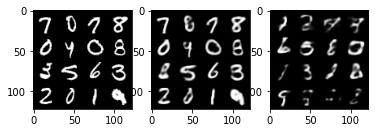

Iter: 30610/50000, Recon loss: 5809.3413, KL div loss: 1390.2448, Total loss: 7199.5859
Iter: 30620/50000, Recon loss: 5826.7354, KL div loss: 1357.9839, Total loss: 7184.7192
Iter: 30630/50000, Recon loss: 5549.7646, KL div loss: 1365.6996, Total loss: 6915.4644
Iter: 30640/50000, Recon loss: 5502.8086, KL div loss: 1394.2697, Total loss: 6897.0781
Iter: 30650/50000, Recon loss: 5895.2666, KL div loss: 1403.2302, Total loss: 7298.4971


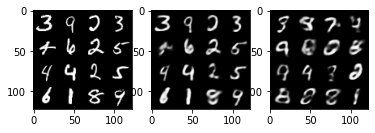

Iter: 30660/50000, Recon loss: 5717.1865, KL div loss: 1391.3352, Total loss: 7108.5215
Iter: 30670/50000, Recon loss: 5204.1387, KL div loss: 1374.6125, Total loss: 6578.7510
Iter: 30680/50000, Recon loss: 5671.9385, KL div loss: 1381.6472, Total loss: 7053.5859
Iter: 30690/50000, Recon loss: 5791.4346, KL div loss: 1450.6332, Total loss: 7242.0679
Iter: 30700/50000, Recon loss: 5596.4062, KL div loss: 1395.1801, Total loss: 6991.5864


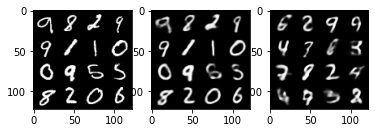

Iter: 30710/50000, Recon loss: 5684.3848, KL div loss: 1367.1123, Total loss: 7051.4971
Iter: 30720/50000, Recon loss: 5820.7529, KL div loss: 1457.0686, Total loss: 7277.8213
Iter: 30730/50000, Recon loss: 5773.2803, KL div loss: 1418.6692, Total loss: 7191.9492
Iter: 30740/50000, Recon loss: 5552.4688, KL div loss: 1325.1786, Total loss: 6877.6475
Iter: 30750/50000, Recon loss: 5569.7964, KL div loss: 1403.0303, Total loss: 6972.8267


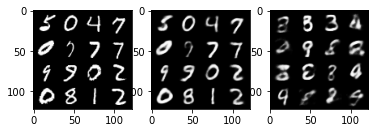

Iter: 30760/50000, Recon loss: 5662.7808, KL div loss: 1454.1616, Total loss: 7116.9424
Iter: 30770/50000, Recon loss: 5788.2075, KL div loss: 1380.5535, Total loss: 7168.7607
Iter: 30780/50000, Recon loss: 5801.9971, KL div loss: 1417.2615, Total loss: 7219.2588
Iter: 30790/50000, Recon loss: 5933.4888, KL div loss: 1379.4856, Total loss: 7312.9746
Iter: 30800/50000, Recon loss: 5440.1387, KL div loss: 1375.4124, Total loss: 6815.5508


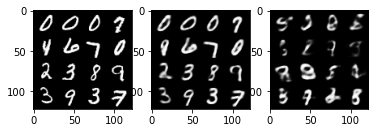

Iter: 30810/50000, Recon loss: 5430.1719, KL div loss: 1397.1151, Total loss: 6827.2871
Iter: 30820/50000, Recon loss: 5479.8511, KL div loss: 1349.6904, Total loss: 6829.5415
Iter: 30830/50000, Recon loss: 5526.9321, KL div loss: 1392.7104, Total loss: 6919.6426
Iter: 30840/50000, Recon loss: 5824.0464, KL div loss: 1417.7324, Total loss: 7241.7788
Iter: 30850/50000, Recon loss: 5580.9014, KL div loss: 1356.2205, Total loss: 6937.1221


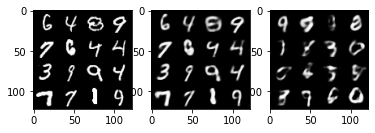

Iter: 30860/50000, Recon loss: 5399.5830, KL div loss: 1380.2920, Total loss: 6779.8750
Iter: 30870/50000, Recon loss: 5402.2695, KL div loss: 1333.1367, Total loss: 6735.4062
Iter: 30880/50000, Recon loss: 5503.1289, KL div loss: 1350.8137, Total loss: 6853.9424
Iter: 30890/50000, Recon loss: 5670.3076, KL div loss: 1368.8938, Total loss: 7039.2012
Iter: 30900/50000, Recon loss: 5959.4502, KL div loss: 1411.0854, Total loss: 7370.5356


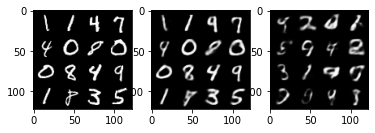

Iter: 30910/50000, Recon loss: 5520.6133, KL div loss: 1402.9261, Total loss: 6923.5396
Iter: 30920/50000, Recon loss: 5970.9336, KL div loss: 1392.5784, Total loss: 7363.5117
Iter: 30930/50000, Recon loss: 5531.7344, KL div loss: 1389.8438, Total loss: 6921.5781
Iter: 30940/50000, Recon loss: 5797.2417, KL div loss: 1395.9213, Total loss: 7193.1631
Iter: 30950/50000, Recon loss: 5498.8555, KL div loss: 1379.7427, Total loss: 6878.5981


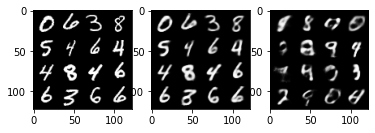

Iter: 30960/50000, Recon loss: 5591.1777, KL div loss: 1378.1936, Total loss: 6969.3711
Iter: 30970/50000, Recon loss: 5321.8979, KL div loss: 1391.1042, Total loss: 6713.0020
Iter: 30980/50000, Recon loss: 5529.0635, KL div loss: 1415.1313, Total loss: 6944.1948
Iter: 30990/50000, Recon loss: 5637.0430, KL div loss: 1390.5713, Total loss: 7027.6143
Iter: 31000/50000, Recon loss: 5399.7759, KL div loss: 1359.1028, Total loss: 6758.8789


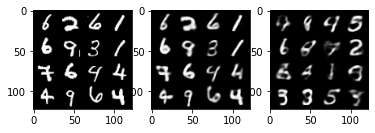

Iter: 31010/50000, Recon loss: 5281.5723, KL div loss: 1335.3665, Total loss: 6616.9385
Iter: 31020/50000, Recon loss: 5372.2686, KL div loss: 1377.3281, Total loss: 6749.5967
Iter: 31030/50000, Recon loss: 5466.1553, KL div loss: 1374.8359, Total loss: 6840.9912
Iter: 31040/50000, Recon loss: 5700.2354, KL div loss: 1436.2738, Total loss: 7136.5093
Iter: 31050/50000, Recon loss: 5654.0498, KL div loss: 1406.5544, Total loss: 7060.6045


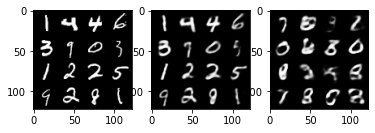

Iter: 31060/50000, Recon loss: 5451.8486, KL div loss: 1406.8098, Total loss: 6858.6582
Iter: 31070/50000, Recon loss: 5462.4521, KL div loss: 1375.4943, Total loss: 6837.9463
Iter: 31080/50000, Recon loss: 5025.0938, KL div loss: 1375.9407, Total loss: 6401.0342
Iter: 31090/50000, Recon loss: 5432.5303, KL div loss: 1340.3009, Total loss: 6772.8311
Iter: 31100/50000, Recon loss: 5493.9868, KL div loss: 1367.6130, Total loss: 6861.5996


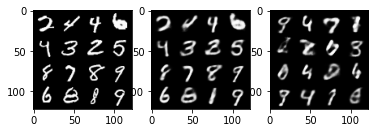

Iter: 31110/50000, Recon loss: 5861.8340, KL div loss: 1383.2737, Total loss: 7245.1074
Iter: 31120/50000, Recon loss: 5290.6479, KL div loss: 1338.1069, Total loss: 6628.7549
Iter: 31130/50000, Recon loss: 5488.1641, KL div loss: 1375.1069, Total loss: 6863.2710
Iter: 31140/50000, Recon loss: 5548.8281, KL div loss: 1393.4547, Total loss: 6942.2827
Iter: 31150/50000, Recon loss: 5387.9453, KL div loss: 1376.1851, Total loss: 6764.1304


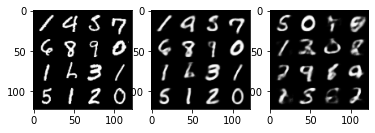

Iter: 31160/50000, Recon loss: 5594.6406, KL div loss: 1382.3214, Total loss: 6976.9619
Iter: 31170/50000, Recon loss: 5658.5913, KL div loss: 1384.1980, Total loss: 7042.7891
Iter: 31180/50000, Recon loss: 5892.4536, KL div loss: 1363.3484, Total loss: 7255.8018
Iter: 31190/50000, Recon loss: 6003.2002, KL div loss: 1387.0118, Total loss: 7390.2119
Iter: 31200/50000, Recon loss: 5802.3740, KL div loss: 1453.2046, Total loss: 7255.5786


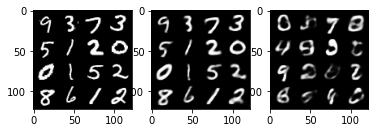

Iter: 31210/50000, Recon loss: 5815.0918, KL div loss: 1430.9973, Total loss: 7246.0889
Iter: 31220/50000, Recon loss: 5455.0996, KL div loss: 1344.6094, Total loss: 6799.7090
Iter: 31230/50000, Recon loss: 5315.3525, KL div loss: 1394.2030, Total loss: 6709.5557
Iter: 31240/50000, Recon loss: 5659.0068, KL div loss: 1389.2157, Total loss: 7048.2227
Iter: 31250/50000, Recon loss: 5433.1255, KL div loss: 1368.8701, Total loss: 6801.9956


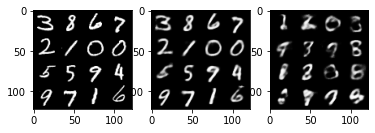

Iter: 31260/50000, Recon loss: 5691.4189, KL div loss: 1430.0272, Total loss: 7121.4463
Iter: 31270/50000, Recon loss: 5568.7529, KL div loss: 1418.1680, Total loss: 6986.9209
Iter: 31280/50000, Recon loss: 5646.7964, KL div loss: 1372.3064, Total loss: 7019.1025
Iter: 31290/50000, Recon loss: 5871.3301, KL div loss: 1395.5330, Total loss: 7266.8633
Iter: 31300/50000, Recon loss: 5385.4902, KL div loss: 1330.6569, Total loss: 6716.1470


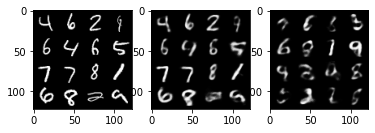

Iter: 31310/50000, Recon loss: 5600.7412, KL div loss: 1367.8444, Total loss: 6968.5854
Iter: 31320/50000, Recon loss: 5552.5659, KL div loss: 1415.8201, Total loss: 6968.3857
Iter: 31330/50000, Recon loss: 5817.5903, KL div loss: 1448.5835, Total loss: 7266.1738
Iter: 31340/50000, Recon loss: 5683.9961, KL div loss: 1393.7305, Total loss: 7077.7266
Iter: 31350/50000, Recon loss: 5342.6602, KL div loss: 1367.6018, Total loss: 6710.2617


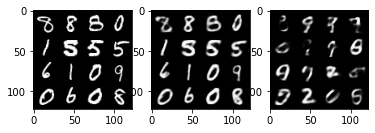

Iter: 31360/50000, Recon loss: 5637.4990, KL div loss: 1421.6968, Total loss: 7059.1958
Iter: 31370/50000, Recon loss: 5686.5352, KL div loss: 1374.8989, Total loss: 7061.4341
Iter: 31380/50000, Recon loss: 5675.4077, KL div loss: 1353.3289, Total loss: 7028.7363
Iter: 31390/50000, Recon loss: 5442.1992, KL div loss: 1405.4834, Total loss: 6847.6826
Iter: 31400/50000, Recon loss: 5359.9229, KL div loss: 1357.0524, Total loss: 6716.9751


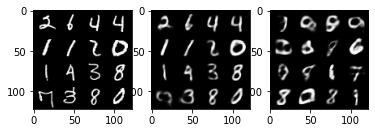

Iter: 31410/50000, Recon loss: 5737.7935, KL div loss: 1359.1117, Total loss: 7096.9053
Iter: 31420/50000, Recon loss: 5369.6270, KL div loss: 1375.9146, Total loss: 6745.5415
Iter: 31430/50000, Recon loss: 5524.1055, KL div loss: 1380.6543, Total loss: 6904.7598
Iter: 31440/50000, Recon loss: 5736.0879, KL div loss: 1439.9447, Total loss: 7176.0327
Iter: 31450/50000, Recon loss: 5672.0391, KL div loss: 1420.0967, Total loss: 7092.1357


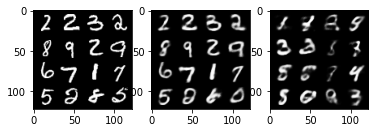

Iter: 31460/50000, Recon loss: 5309.3276, KL div loss: 1345.1841, Total loss: 6654.5117
Iter: 31470/50000, Recon loss: 5317.2280, KL div loss: 1370.1637, Total loss: 6687.3916
Iter: 31480/50000, Recon loss: 5535.7490, KL div loss: 1428.6890, Total loss: 6964.4380
Iter: 31490/50000, Recon loss: 5848.0454, KL div loss: 1423.4910, Total loss: 7271.5361
Iter: 31500/50000, Recon loss: 5526.4502, KL div loss: 1375.6880, Total loss: 6902.1382


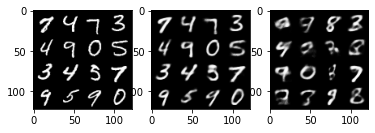

Iter: 31510/50000, Recon loss: 5577.1270, KL div loss: 1416.5676, Total loss: 6993.6943
Iter: 31520/50000, Recon loss: 5518.8286, KL div loss: 1367.6226, Total loss: 6886.4512
Iter: 31530/50000, Recon loss: 5563.1426, KL div loss: 1422.1704, Total loss: 6985.3130
Iter: 31540/50000, Recon loss: 5560.9863, KL div loss: 1387.7747, Total loss: 6948.7607
Iter: 31550/50000, Recon loss: 5606.5190, KL div loss: 1423.7102, Total loss: 7030.2295


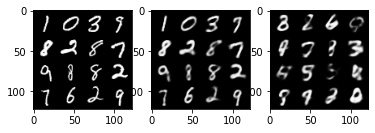

Iter: 31560/50000, Recon loss: 5128.5835, KL div loss: 1362.3972, Total loss: 6490.9805
Iter: 31570/50000, Recon loss: 5317.9932, KL div loss: 1342.0367, Total loss: 6660.0298
Iter: 31580/50000, Recon loss: 5499.7715, KL div loss: 1408.3159, Total loss: 6908.0874
Iter: 31590/50000, Recon loss: 5953.7969, KL div loss: 1429.4669, Total loss: 7383.2637
Iter: 31600/50000, Recon loss: 5762.9092, KL div loss: 1382.4292, Total loss: 7145.3384


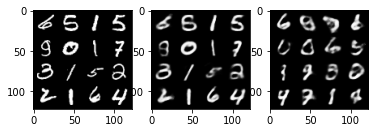

Iter: 31610/50000, Recon loss: 5434.5854, KL div loss: 1378.5703, Total loss: 6813.1558
Iter: 31620/50000, Recon loss: 5529.9263, KL div loss: 1398.3334, Total loss: 6928.2598
Iter: 31630/50000, Recon loss: 5708.6016, KL div loss: 1389.1967, Total loss: 7097.7983
Iter: 31640/50000, Recon loss: 5699.2227, KL div loss: 1383.9103, Total loss: 7083.1328
Iter: 31650/50000, Recon loss: 5562.3228, KL div loss: 1386.7819, Total loss: 6949.1045


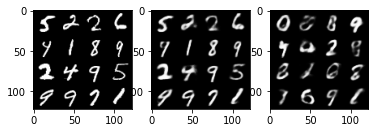

Iter: 31660/50000, Recon loss: 5748.8330, KL div loss: 1451.7631, Total loss: 7200.5962
Iter: 31670/50000, Recon loss: 5449.8848, KL div loss: 1413.8892, Total loss: 6863.7739
Iter: 31680/50000, Recon loss: 5717.9170, KL div loss: 1382.0430, Total loss: 7099.9600
Iter: 31690/50000, Recon loss: 5488.9189, KL div loss: 1319.0800, Total loss: 6807.9990
Iter: 31700/50000, Recon loss: 5562.9487, KL div loss: 1386.6311, Total loss: 6949.5801


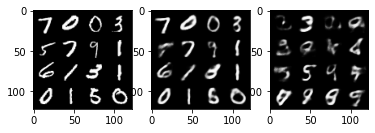

Iter: 31710/50000, Recon loss: 5564.1328, KL div loss: 1417.9834, Total loss: 6982.1162
Iter: 31720/50000, Recon loss: 5243.3862, KL div loss: 1299.8070, Total loss: 6543.1934
Iter: 31730/50000, Recon loss: 5116.5884, KL div loss: 1338.7404, Total loss: 6455.3286
Iter: 31740/50000, Recon loss: 5314.5254, KL div loss: 1340.9724, Total loss: 6655.4980
Iter: 31750/50000, Recon loss: 5579.5601, KL div loss: 1440.5107, Total loss: 7020.0708


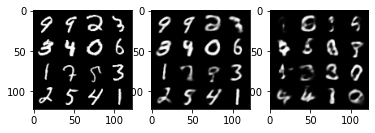

Iter: 31760/50000, Recon loss: 5420.3701, KL div loss: 1390.3796, Total loss: 6810.7500
Iter: 31770/50000, Recon loss: 5390.4473, KL div loss: 1360.5518, Total loss: 6750.9990
Iter: 31780/50000, Recon loss: 5411.5376, KL div loss: 1366.1403, Total loss: 6777.6777
Iter: 31790/50000, Recon loss: 5258.1104, KL div loss: 1294.5996, Total loss: 6552.7100
Iter: 31800/50000, Recon loss: 5938.9258, KL div loss: 1405.8079, Total loss: 7344.7334


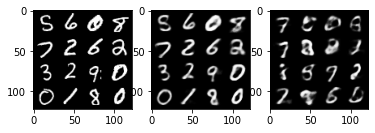

Iter: 31810/50000, Recon loss: 5292.8037, KL div loss: 1376.3721, Total loss: 6669.1758
Iter: 31820/50000, Recon loss: 5554.0771, KL div loss: 1384.7825, Total loss: 6938.8594
Iter: 31830/50000, Recon loss: 5190.5508, KL div loss: 1363.0161, Total loss: 6553.5669
Iter: 31840/50000, Recon loss: 5630.1094, KL div loss: 1390.1682, Total loss: 7020.2773
Iter: 31850/50000, Recon loss: 5236.4395, KL div loss: 1360.6418, Total loss: 6597.0811


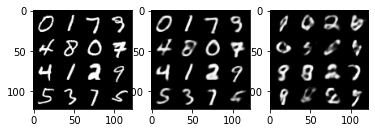

Iter: 31860/50000, Recon loss: 5650.9570, KL div loss: 1365.3035, Total loss: 7016.2607
Iter: 31870/50000, Recon loss: 5782.0068, KL div loss: 1396.6899, Total loss: 7178.6968
Iter: 31880/50000, Recon loss: 5321.1987, KL div loss: 1370.2209, Total loss: 6691.4199
Iter: 31890/50000, Recon loss: 5599.9121, KL div loss: 1405.8519, Total loss: 7005.7642
Iter: 31900/50000, Recon loss: 5197.3711, KL div loss: 1361.7603, Total loss: 6559.1313


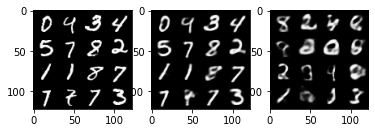

Iter: 31910/50000, Recon loss: 5432.2051, KL div loss: 1379.2778, Total loss: 6811.4829
Iter: 31920/50000, Recon loss: 5322.1030, KL div loss: 1354.7646, Total loss: 6676.8677
Iter: 31930/50000, Recon loss: 5173.4248, KL div loss: 1345.9041, Total loss: 6519.3291
Iter: 31940/50000, Recon loss: 5592.9370, KL div loss: 1398.3325, Total loss: 6991.2695
Iter: 31950/50000, Recon loss: 5402.4360, KL div loss: 1356.3745, Total loss: 6758.8105


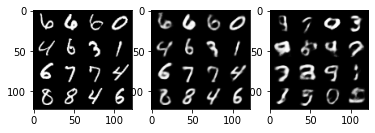

Iter: 31960/50000, Recon loss: 5829.7778, KL div loss: 1436.9769, Total loss: 7266.7549
Iter: 31970/50000, Recon loss: 5518.7764, KL div loss: 1345.9563, Total loss: 6864.7324
Iter: 31980/50000, Recon loss: 5719.9141, KL div loss: 1427.1558, Total loss: 7147.0698
Iter: 31990/50000, Recon loss: 5641.1191, KL div loss: 1395.6619, Total loss: 7036.7812
Iter: 32000/50000, Recon loss: 5601.1304, KL div loss: 1442.6426, Total loss: 7043.7729


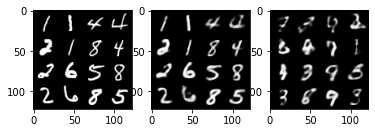

Iter: 32010/50000, Recon loss: 5383.0264, KL div loss: 1367.9838, Total loss: 6751.0103
Iter: 32020/50000, Recon loss: 5692.2749, KL div loss: 1404.1948, Total loss: 7096.4697
Iter: 32030/50000, Recon loss: 5826.8408, KL div loss: 1427.4639, Total loss: 7254.3047
Iter: 32040/50000, Recon loss: 5504.5103, KL div loss: 1408.2070, Total loss: 6912.7173
Iter: 32050/50000, Recon loss: 5313.6279, KL div loss: 1373.7439, Total loss: 6687.3721


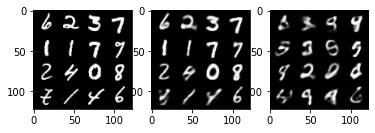

Iter: 32060/50000, Recon loss: 5721.0811, KL div loss: 1390.3474, Total loss: 7111.4287
Iter: 32070/50000, Recon loss: 5468.4023, KL div loss: 1369.5674, Total loss: 6837.9697
Iter: 32080/50000, Recon loss: 6002.0713, KL div loss: 1446.1650, Total loss: 7448.2363
Iter: 32090/50000, Recon loss: 5550.3403, KL div loss: 1379.3380, Total loss: 6929.6782
Iter: 32100/50000, Recon loss: 5338.9004, KL div loss: 1327.2595, Total loss: 6666.1602


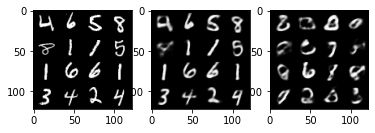

Iter: 32110/50000, Recon loss: 5345.8081, KL div loss: 1379.3313, Total loss: 6725.1396
Iter: 32120/50000, Recon loss: 5501.5000, KL div loss: 1373.4529, Total loss: 6874.9531
Iter: 32130/50000, Recon loss: 5893.7461, KL div loss: 1391.7986, Total loss: 7285.5449
Iter: 32140/50000, Recon loss: 5576.3359, KL div loss: 1364.5922, Total loss: 6940.9282
Iter: 32150/50000, Recon loss: 5463.5679, KL div loss: 1390.4099, Total loss: 6853.9775


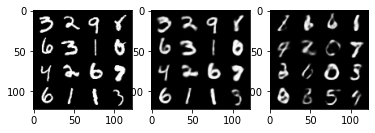

Iter: 32160/50000, Recon loss: 5999.9644, KL div loss: 1354.4464, Total loss: 7354.4106
Iter: 32170/50000, Recon loss: 6002.3223, KL div loss: 1463.6621, Total loss: 7465.9844
Iter: 32180/50000, Recon loss: 5295.9712, KL div loss: 1361.7720, Total loss: 6657.7432
Iter: 32190/50000, Recon loss: 6009.6309, KL div loss: 1432.2874, Total loss: 7441.9180
Iter: 32200/50000, Recon loss: 5474.3096, KL div loss: 1428.0131, Total loss: 6902.3228


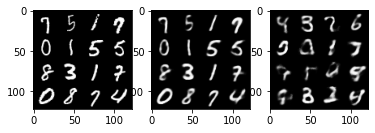

Iter: 32210/50000, Recon loss: 5208.0635, KL div loss: 1364.9573, Total loss: 6573.0205
Iter: 32220/50000, Recon loss: 5804.3428, KL div loss: 1432.7788, Total loss: 7237.1216
Iter: 32230/50000, Recon loss: 5567.9175, KL div loss: 1393.6438, Total loss: 6961.5615
Iter: 32240/50000, Recon loss: 5535.2388, KL div loss: 1410.8716, Total loss: 6946.1104
Iter: 32250/50000, Recon loss: 5562.0029, KL div loss: 1367.2805, Total loss: 6929.2832


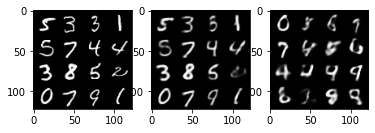

Iter: 32260/50000, Recon loss: 5928.7598, KL div loss: 1414.2402, Total loss: 7343.0000
Iter: 32270/50000, Recon loss: 5402.9644, KL div loss: 1400.3679, Total loss: 6803.3320
Iter: 32280/50000, Recon loss: 5700.9482, KL div loss: 1379.4794, Total loss: 7080.4277
Iter: 32290/50000, Recon loss: 5587.5898, KL div loss: 1423.3929, Total loss: 7010.9829
Iter: 32300/50000, Recon loss: 5588.0581, KL div loss: 1397.3552, Total loss: 6985.4131


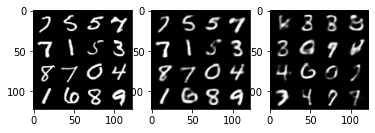

Iter: 32310/50000, Recon loss: 5689.5044, KL div loss: 1461.9600, Total loss: 7151.4644
Iter: 32320/50000, Recon loss: 5531.1260, KL div loss: 1396.8741, Total loss: 6928.0000
Iter: 32330/50000, Recon loss: 5915.4829, KL div loss: 1426.4652, Total loss: 7341.9482
Iter: 32340/50000, Recon loss: 5565.9873, KL div loss: 1351.1328, Total loss: 6917.1201
Iter: 32350/50000, Recon loss: 5199.8789, KL div loss: 1336.4337, Total loss: 6536.3125


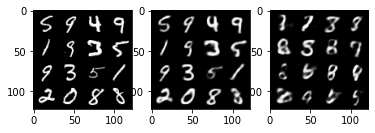

Iter: 32360/50000, Recon loss: 5471.9268, KL div loss: 1404.0516, Total loss: 6875.9785
Iter: 32370/50000, Recon loss: 5113.0752, KL div loss: 1372.0648, Total loss: 6485.1401
Iter: 32380/50000, Recon loss: 5496.1919, KL div loss: 1397.4247, Total loss: 6893.6167
Iter: 32390/50000, Recon loss: 5611.6821, KL div loss: 1351.1174, Total loss: 6962.7998
Iter: 32400/50000, Recon loss: 5824.9702, KL div loss: 1371.6954, Total loss: 7196.6655


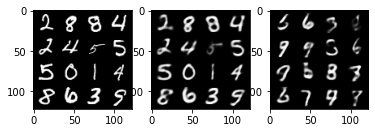

Iter: 32410/50000, Recon loss: 5589.9097, KL div loss: 1412.7583, Total loss: 7002.6680
Iter: 32420/50000, Recon loss: 5616.8037, KL div loss: 1419.0908, Total loss: 7035.8945
Iter: 32430/50000, Recon loss: 5337.4707, KL div loss: 1342.9327, Total loss: 6680.4033
Iter: 32440/50000, Recon loss: 5556.3115, KL div loss: 1375.7747, Total loss: 6932.0859
Iter: 32450/50000, Recon loss: 5277.4746, KL div loss: 1399.1593, Total loss: 6676.6338


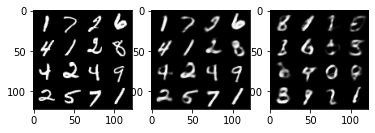

Iter: 32460/50000, Recon loss: 4922.5000, KL div loss: 1382.3782, Total loss: 6304.8779
Iter: 32470/50000, Recon loss: 5582.3750, KL div loss: 1404.7527, Total loss: 6987.1279
Iter: 32480/50000, Recon loss: 5763.7329, KL div loss: 1450.3350, Total loss: 7214.0679
Iter: 32490/50000, Recon loss: 5328.5391, KL div loss: 1363.9008, Total loss: 6692.4399
Iter: 32500/50000, Recon loss: 5525.2500, KL div loss: 1455.7854, Total loss: 6981.0352


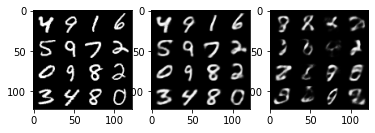

Iter: 32510/50000, Recon loss: 5674.8306, KL div loss: 1401.8806, Total loss: 7076.7109
Iter: 32520/50000, Recon loss: 5620.8550, KL div loss: 1352.0168, Total loss: 6972.8721
Iter: 32530/50000, Recon loss: 5277.0039, KL div loss: 1371.5554, Total loss: 6648.5596
Iter: 32540/50000, Recon loss: 5324.1699, KL div loss: 1348.4705, Total loss: 6672.6406
Iter: 32550/50000, Recon loss: 5597.7964, KL div loss: 1456.9696, Total loss: 7054.7661


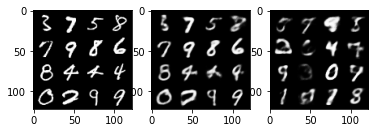

Iter: 32560/50000, Recon loss: 5441.8979, KL div loss: 1343.2305, Total loss: 6785.1284
Iter: 32570/50000, Recon loss: 5913.8936, KL div loss: 1385.7129, Total loss: 7299.6064
Iter: 32580/50000, Recon loss: 5366.6465, KL div loss: 1410.0835, Total loss: 6776.7300
Iter: 32590/50000, Recon loss: 5746.1021, KL div loss: 1422.5757, Total loss: 7168.6777
Iter: 32600/50000, Recon loss: 5790.7163, KL div loss: 1416.9857, Total loss: 7207.7021


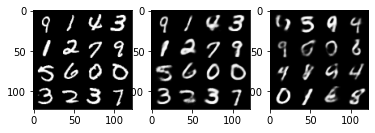

Iter: 32610/50000, Recon loss: 5729.8984, KL div loss: 1388.9738, Total loss: 7118.8721
Iter: 32620/50000, Recon loss: 5382.3101, KL div loss: 1395.3660, Total loss: 6777.6758
Iter: 32630/50000, Recon loss: 5541.3745, KL div loss: 1362.3181, Total loss: 6903.6924
Iter: 32640/50000, Recon loss: 5396.4312, KL div loss: 1404.0662, Total loss: 6800.4971
Iter: 32650/50000, Recon loss: 5695.7949, KL div loss: 1415.9829, Total loss: 7111.7778


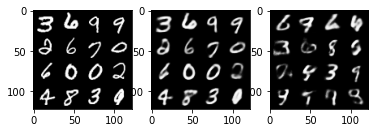

Iter: 32660/50000, Recon loss: 5729.6763, KL div loss: 1421.5427, Total loss: 7151.2188
Iter: 32670/50000, Recon loss: 5730.3120, KL div loss: 1478.8918, Total loss: 7209.2041
Iter: 32680/50000, Recon loss: 5174.0898, KL div loss: 1378.2124, Total loss: 6552.3022
Iter: 32690/50000, Recon loss: 5411.8418, KL div loss: 1362.5315, Total loss: 6774.3730
Iter: 32700/50000, Recon loss: 5664.4497, KL div loss: 1404.4401, Total loss: 7068.8896


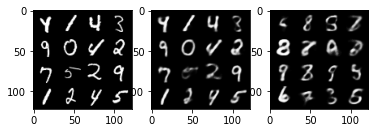

Iter: 32710/50000, Recon loss: 5281.0737, KL div loss: 1405.1880, Total loss: 6686.2617
Iter: 32720/50000, Recon loss: 5534.7261, KL div loss: 1374.5963, Total loss: 6909.3223
Iter: 32730/50000, Recon loss: 5618.0498, KL div loss: 1392.9307, Total loss: 7010.9805
Iter: 32740/50000, Recon loss: 5672.4102, KL div loss: 1394.4122, Total loss: 7066.8223
Iter: 32750/50000, Recon loss: 5748.4678, KL div loss: 1397.6453, Total loss: 7146.1133


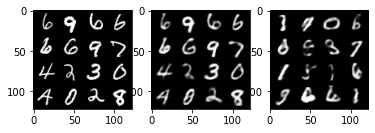

Iter: 32760/50000, Recon loss: 5774.4546, KL div loss: 1433.5430, Total loss: 7207.9976
Iter: 32770/50000, Recon loss: 5506.9219, KL div loss: 1361.8624, Total loss: 6868.7842
Iter: 32780/50000, Recon loss: 5397.5410, KL div loss: 1382.1396, Total loss: 6779.6807
Iter: 32790/50000, Recon loss: 5448.6816, KL div loss: 1423.6437, Total loss: 6872.3252
Iter: 32800/50000, Recon loss: 5598.7881, KL div loss: 1419.7366, Total loss: 7018.5244


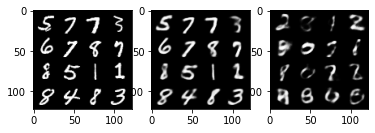

Iter: 32810/50000, Recon loss: 5769.5938, KL div loss: 1415.8469, Total loss: 7185.4404
Iter: 32820/50000, Recon loss: 5130.2969, KL div loss: 1341.2776, Total loss: 6471.5742
Iter: 32830/50000, Recon loss: 5540.9932, KL div loss: 1388.9576, Total loss: 6929.9507
Iter: 32840/50000, Recon loss: 5478.6855, KL div loss: 1375.3052, Total loss: 6853.9907
Iter: 32850/50000, Recon loss: 5419.3516, KL div loss: 1386.4248, Total loss: 6805.7764


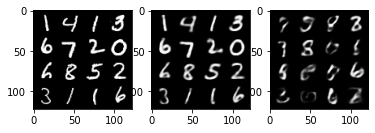

Iter: 32860/50000, Recon loss: 5701.4053, KL div loss: 1400.3589, Total loss: 7101.7642
Iter: 32870/50000, Recon loss: 5713.6064, KL div loss: 1398.1926, Total loss: 7111.7988
Iter: 32880/50000, Recon loss: 5214.5986, KL div loss: 1361.2687, Total loss: 6575.8672
Iter: 32890/50000, Recon loss: 5335.6646, KL div loss: 1393.4067, Total loss: 6729.0713
Iter: 32900/50000, Recon loss: 5584.3506, KL div loss: 1370.8634, Total loss: 6955.2139


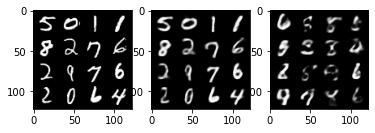

Iter: 32910/50000, Recon loss: 5216.2822, KL div loss: 1346.9017, Total loss: 6563.1841
Iter: 32920/50000, Recon loss: 5110.8667, KL div loss: 1355.7504, Total loss: 6466.6172
Iter: 32930/50000, Recon loss: 5399.2490, KL div loss: 1412.7229, Total loss: 6811.9717
Iter: 32940/50000, Recon loss: 5437.2524, KL div loss: 1387.0229, Total loss: 6824.2754
Iter: 32950/50000, Recon loss: 5645.9634, KL div loss: 1415.9963, Total loss: 7061.9600


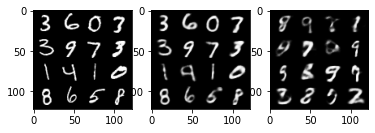

Iter: 32960/50000, Recon loss: 6170.7080, KL div loss: 1454.7073, Total loss: 7625.4150
Iter: 32970/50000, Recon loss: 5372.0220, KL div loss: 1381.7046, Total loss: 6753.7266
Iter: 32980/50000, Recon loss: 5587.5142, KL div loss: 1366.4226, Total loss: 6953.9365
Iter: 32990/50000, Recon loss: 5569.1802, KL div loss: 1384.8716, Total loss: 6954.0518
Iter: 33000/50000, Recon loss: 5481.4297, KL div loss: 1373.5493, Total loss: 6854.9790


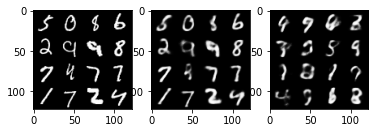

Iter: 33010/50000, Recon loss: 5681.5039, KL div loss: 1386.7074, Total loss: 7068.2114
Iter: 33020/50000, Recon loss: 5502.1426, KL div loss: 1391.1769, Total loss: 6893.3193
Iter: 33030/50000, Recon loss: 5408.2456, KL div loss: 1350.2417, Total loss: 6758.4873
Iter: 33040/50000, Recon loss: 5267.3950, KL div loss: 1325.7061, Total loss: 6593.1011
Iter: 33050/50000, Recon loss: 6226.6211, KL div loss: 1442.6497, Total loss: 7669.2705


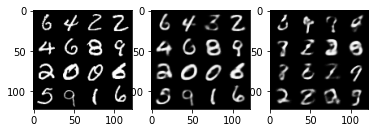

Iter: 33060/50000, Recon loss: 5604.3535, KL div loss: 1393.9824, Total loss: 6998.3359
Iter: 33070/50000, Recon loss: 5374.3926, KL div loss: 1379.0073, Total loss: 6753.3999
Iter: 33080/50000, Recon loss: 5788.6245, KL div loss: 1419.2815, Total loss: 7207.9062
Iter: 33090/50000, Recon loss: 5716.3799, KL div loss: 1434.3862, Total loss: 7150.7661
Iter: 33100/50000, Recon loss: 5545.6675, KL div loss: 1416.1373, Total loss: 6961.8047


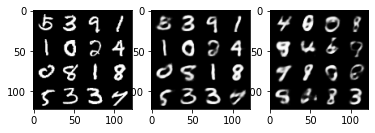

Iter: 33110/50000, Recon loss: 5371.5068, KL div loss: 1358.6000, Total loss: 6730.1069
Iter: 33120/50000, Recon loss: 5288.2900, KL div loss: 1358.2583, Total loss: 6646.5483
Iter: 33130/50000, Recon loss: 5258.9844, KL div loss: 1373.5638, Total loss: 6632.5483
Iter: 33140/50000, Recon loss: 5626.0615, KL div loss: 1422.0533, Total loss: 7048.1147
Iter: 33150/50000, Recon loss: 5581.6172, KL div loss: 1381.3721, Total loss: 6962.9893


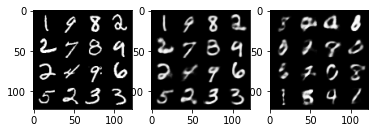

Iter: 33160/50000, Recon loss: 5878.2202, KL div loss: 1441.7354, Total loss: 7319.9556
Iter: 33170/50000, Recon loss: 5735.3486, KL div loss: 1407.7294, Total loss: 7143.0781
Iter: 33180/50000, Recon loss: 5558.0986, KL div loss: 1436.9080, Total loss: 6995.0068
Iter: 33190/50000, Recon loss: 5585.1831, KL div loss: 1440.3466, Total loss: 7025.5298
Iter: 33200/50000, Recon loss: 5964.9316, KL div loss: 1430.8052, Total loss: 7395.7368


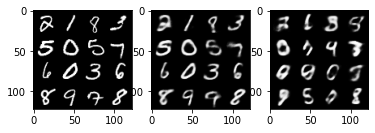

Iter: 33210/50000, Recon loss: 5317.8677, KL div loss: 1372.6936, Total loss: 6690.5615
Iter: 33220/50000, Recon loss: 5664.6855, KL div loss: 1424.0894, Total loss: 7088.7749
Iter: 33230/50000, Recon loss: 5458.1738, KL div loss: 1400.9102, Total loss: 6859.0840
Iter: 33240/50000, Recon loss: 5486.9512, KL div loss: 1378.9039, Total loss: 6865.8550
Iter: 33250/50000, Recon loss: 5456.7520, KL div loss: 1375.1511, Total loss: 6831.9033


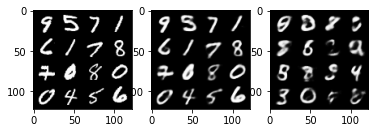

Iter: 33260/50000, Recon loss: 5447.2939, KL div loss: 1406.9172, Total loss: 6854.2109
Iter: 33270/50000, Recon loss: 5659.5352, KL div loss: 1456.5088, Total loss: 7116.0439
Iter: 33280/50000, Recon loss: 5377.0518, KL div loss: 1394.4990, Total loss: 6771.5508
Iter: 33290/50000, Recon loss: 5975.0742, KL div loss: 1401.9961, Total loss: 7377.0703
Iter: 33300/50000, Recon loss: 5168.6221, KL div loss: 1367.1611, Total loss: 6535.7832


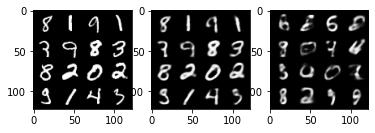

Iter: 33310/50000, Recon loss: 5610.4375, KL div loss: 1413.9468, Total loss: 7024.3843
Iter: 33320/50000, Recon loss: 5358.6279, KL div loss: 1371.9622, Total loss: 6730.5898
Iter: 33330/50000, Recon loss: 5481.9409, KL div loss: 1384.6482, Total loss: 6866.5889
Iter: 33340/50000, Recon loss: 5799.0654, KL div loss: 1454.5559, Total loss: 7253.6211
Iter: 33350/50000, Recon loss: 5436.8184, KL div loss: 1428.1132, Total loss: 6864.9316


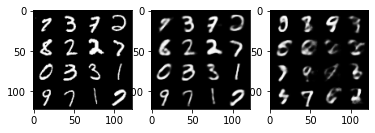

Iter: 33360/50000, Recon loss: 5438.2959, KL div loss: 1418.7083, Total loss: 6857.0039
Iter: 33370/50000, Recon loss: 5399.8765, KL div loss: 1425.5647, Total loss: 6825.4414
Iter: 33380/50000, Recon loss: 5308.7612, KL div loss: 1362.3899, Total loss: 6671.1514
Iter: 33390/50000, Recon loss: 6075.3232, KL div loss: 1440.9424, Total loss: 7516.2656
Iter: 33400/50000, Recon loss: 5416.5791, KL div loss: 1405.5776, Total loss: 6822.1567


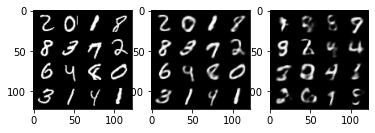

Iter: 33410/50000, Recon loss: 5418.9385, KL div loss: 1404.8916, Total loss: 6823.8301
Iter: 33420/50000, Recon loss: 5641.9941, KL div loss: 1388.5862, Total loss: 7030.5801
Iter: 33430/50000, Recon loss: 5851.2744, KL div loss: 1378.1091, Total loss: 7229.3838
Iter: 33440/50000, Recon loss: 5482.1401, KL div loss: 1388.5933, Total loss: 6870.7334
Iter: 33450/50000, Recon loss: 5394.2817, KL div loss: 1363.1550, Total loss: 6757.4365


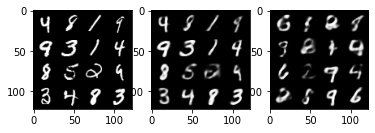

Iter: 33460/50000, Recon loss: 5488.5986, KL div loss: 1396.0967, Total loss: 6884.6953
Iter: 33470/50000, Recon loss: 5585.8105, KL div loss: 1427.8002, Total loss: 7013.6108
Iter: 33480/50000, Recon loss: 5576.7285, KL div loss: 1357.2971, Total loss: 6934.0254
Iter: 33490/50000, Recon loss: 5571.5742, KL div loss: 1425.3273, Total loss: 6996.9014
Iter: 33500/50000, Recon loss: 5267.2422, KL div loss: 1383.5985, Total loss: 6650.8408


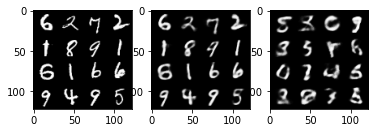

Iter: 33510/50000, Recon loss: 5429.8125, KL div loss: 1406.8323, Total loss: 6836.6445
Iter: 33520/50000, Recon loss: 5608.0479, KL div loss: 1404.5834, Total loss: 7012.6313
Iter: 33530/50000, Recon loss: 5709.2803, KL div loss: 1433.5583, Total loss: 7142.8389
Iter: 33540/50000, Recon loss: 5485.9912, KL div loss: 1422.4197, Total loss: 6908.4111
Iter: 33550/50000, Recon loss: 5163.0098, KL div loss: 1393.5708, Total loss: 6556.5806


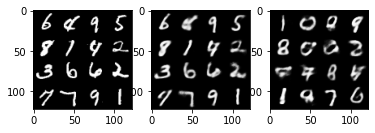

Iter: 33560/50000, Recon loss: 5583.3999, KL div loss: 1374.9976, Total loss: 6958.3975
Iter: 33570/50000, Recon loss: 5558.4551, KL div loss: 1398.7814, Total loss: 6957.2363
Iter: 33580/50000, Recon loss: 5540.7212, KL div loss: 1428.6519, Total loss: 6969.3730
Iter: 33590/50000, Recon loss: 5398.6943, KL div loss: 1374.8988, Total loss: 6773.5933
Iter: 33600/50000, Recon loss: 5672.6626, KL div loss: 1416.6108, Total loss: 7089.2734


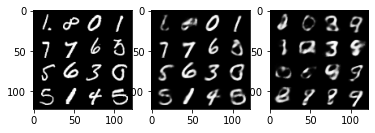

Iter: 33610/50000, Recon loss: 5328.5830, KL div loss: 1357.9238, Total loss: 6686.5068
Iter: 33620/50000, Recon loss: 5534.1758, KL div loss: 1381.3110, Total loss: 6915.4868
Iter: 33630/50000, Recon loss: 5462.1094, KL div loss: 1362.3120, Total loss: 6824.4214
Iter: 33640/50000, Recon loss: 5802.8584, KL div loss: 1416.1132, Total loss: 7218.9717
Iter: 33650/50000, Recon loss: 5811.4883, KL div loss: 1430.7434, Total loss: 7242.2314


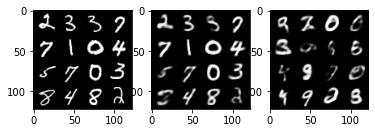

Iter: 33660/50000, Recon loss: 6004.2583, KL div loss: 1408.6167, Total loss: 7412.8750
Iter: 33670/50000, Recon loss: 5064.7705, KL div loss: 1333.4286, Total loss: 6398.1992
Iter: 33680/50000, Recon loss: 5495.3906, KL div loss: 1395.1663, Total loss: 6890.5566
Iter: 33690/50000, Recon loss: 5336.8906, KL div loss: 1393.3262, Total loss: 6730.2168
Iter: 33700/50000, Recon loss: 5552.2520, KL div loss: 1364.9529, Total loss: 6917.2051


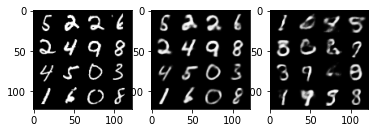

Iter: 33710/50000, Recon loss: 5498.8916, KL div loss: 1409.9495, Total loss: 6908.8408
Iter: 33720/50000, Recon loss: 5720.1909, KL div loss: 1434.8938, Total loss: 7155.0850
Iter: 33730/50000, Recon loss: 4923.9956, KL div loss: 1299.0920, Total loss: 6223.0879
Iter: 33740/50000, Recon loss: 5444.8340, KL div loss: 1395.6956, Total loss: 6840.5293
Iter: 33750/50000, Recon loss: 5643.9414, KL div loss: 1406.4130, Total loss: 7050.3545


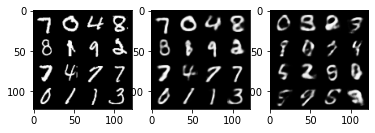

Iter: 33760/50000, Recon loss: 5258.2734, KL div loss: 1334.6707, Total loss: 6592.9443
Iter: 33770/50000, Recon loss: 5083.2065, KL div loss: 1350.0813, Total loss: 6433.2881
Iter: 33780/50000, Recon loss: 5391.3232, KL div loss: 1399.1779, Total loss: 6790.5010
Iter: 33790/50000, Recon loss: 5589.8813, KL div loss: 1404.9659, Total loss: 6994.8472
Iter: 33800/50000, Recon loss: 5278.8467, KL div loss: 1388.4766, Total loss: 6667.3232


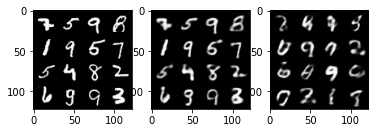

Iter: 33810/50000, Recon loss: 5354.8755, KL div loss: 1382.0752, Total loss: 6736.9507
Iter: 33820/50000, Recon loss: 5579.7207, KL div loss: 1375.9766, Total loss: 6955.6973
Iter: 33830/50000, Recon loss: 5756.0205, KL div loss: 1402.7593, Total loss: 7158.7798
Iter: 33840/50000, Recon loss: 5524.7998, KL div loss: 1432.1808, Total loss: 6956.9805
Iter: 33850/50000, Recon loss: 5285.5381, KL div loss: 1411.9877, Total loss: 6697.5259


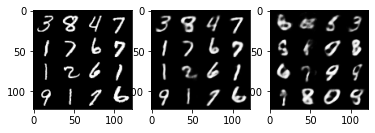

Iter: 33860/50000, Recon loss: 5960.0996, KL div loss: 1464.1421, Total loss: 7424.2417
Iter: 33870/50000, Recon loss: 5324.8018, KL div loss: 1386.2090, Total loss: 6711.0107
Iter: 33880/50000, Recon loss: 5759.9658, KL div loss: 1410.8501, Total loss: 7170.8159
Iter: 33890/50000, Recon loss: 5418.1768, KL div loss: 1384.9946, Total loss: 6803.1714
Iter: 33900/50000, Recon loss: 5856.6343, KL div loss: 1426.1924, Total loss: 7282.8267


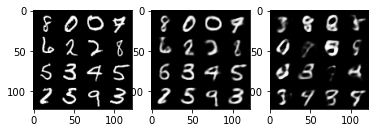

Iter: 33910/50000, Recon loss: 5625.7114, KL div loss: 1415.9927, Total loss: 7041.7041
Iter: 33920/50000, Recon loss: 5654.3711, KL div loss: 1394.2744, Total loss: 7048.6455
Iter: 33930/50000, Recon loss: 5339.6387, KL div loss: 1338.7098, Total loss: 6678.3486
Iter: 33940/50000, Recon loss: 5980.0332, KL div loss: 1419.8950, Total loss: 7399.9282
Iter: 33950/50000, Recon loss: 5057.9238, KL div loss: 1351.6082, Total loss: 6409.5322


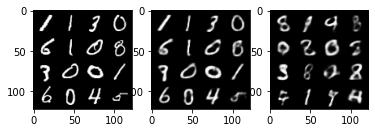

Iter: 33960/50000, Recon loss: 5443.0107, KL div loss: 1413.5758, Total loss: 6856.5864
Iter: 33970/50000, Recon loss: 5171.1074, KL div loss: 1392.0383, Total loss: 6563.1455
Iter: 33980/50000, Recon loss: 5672.3364, KL div loss: 1437.3655, Total loss: 7109.7021
Iter: 33990/50000, Recon loss: 5703.5625, KL div loss: 1393.9728, Total loss: 7097.5352
Iter: 34000/50000, Recon loss: 5728.7476, KL div loss: 1415.2349, Total loss: 7143.9824


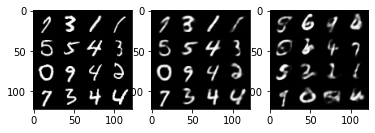

Iter: 34010/50000, Recon loss: 5600.7051, KL div loss: 1431.9447, Total loss: 7032.6499
Iter: 34020/50000, Recon loss: 5821.6016, KL div loss: 1450.3611, Total loss: 7271.9629
Iter: 34030/50000, Recon loss: 5377.2969, KL div loss: 1392.8672, Total loss: 6770.1641
Iter: 34040/50000, Recon loss: 5651.5947, KL div loss: 1415.5708, Total loss: 7067.1655
Iter: 34050/50000, Recon loss: 5647.1118, KL div loss: 1412.6433, Total loss: 7059.7549


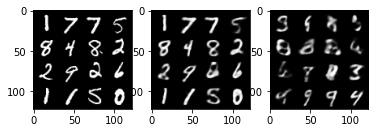

Iter: 34060/50000, Recon loss: 5552.9814, KL div loss: 1371.5728, Total loss: 6924.5542
Iter: 34070/50000, Recon loss: 5680.9219, KL div loss: 1420.8423, Total loss: 7101.7642
Iter: 34080/50000, Recon loss: 5803.2471, KL div loss: 1397.5966, Total loss: 7200.8438
Iter: 34090/50000, Recon loss: 5243.7847, KL div loss: 1402.5819, Total loss: 6646.3667
Iter: 34100/50000, Recon loss: 5802.6646, KL div loss: 1385.9220, Total loss: 7188.5864


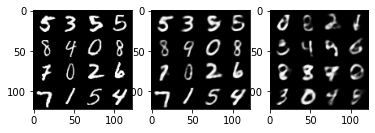

Iter: 34110/50000, Recon loss: 5608.9224, KL div loss: 1402.7898, Total loss: 7011.7119
Iter: 34120/50000, Recon loss: 5843.5298, KL div loss: 1437.3450, Total loss: 7280.8750
Iter: 34130/50000, Recon loss: 5846.4053, KL div loss: 1380.3792, Total loss: 7226.7842
Iter: 34140/50000, Recon loss: 5089.8984, KL div loss: 1308.9779, Total loss: 6398.8765
Iter: 34150/50000, Recon loss: 5330.8467, KL div loss: 1397.4077, Total loss: 6728.2544


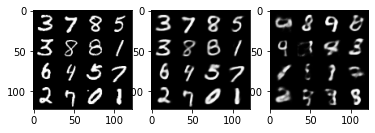

Iter: 34160/50000, Recon loss: 5273.9766, KL div loss: 1376.5698, Total loss: 6650.5464
Iter: 34170/50000, Recon loss: 5355.1255, KL div loss: 1411.5735, Total loss: 6766.6992
Iter: 34180/50000, Recon loss: 5598.1143, KL div loss: 1431.5122, Total loss: 7029.6265
Iter: 34190/50000, Recon loss: 5715.9707, KL div loss: 1371.8899, Total loss: 7087.8604
Iter: 34200/50000, Recon loss: 5590.6948, KL div loss: 1393.0728, Total loss: 6983.7676


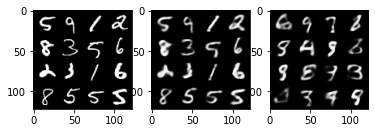

Iter: 34210/50000, Recon loss: 5759.8276, KL div loss: 1387.2515, Total loss: 7147.0791
Iter: 34220/50000, Recon loss: 5514.6191, KL div loss: 1418.4990, Total loss: 6933.1182
Iter: 34230/50000, Recon loss: 5644.2524, KL div loss: 1418.8142, Total loss: 7063.0664
Iter: 34240/50000, Recon loss: 5729.7588, KL div loss: 1440.3147, Total loss: 7170.0732
Iter: 34250/50000, Recon loss: 5557.8662, KL div loss: 1418.0037, Total loss: 6975.8701


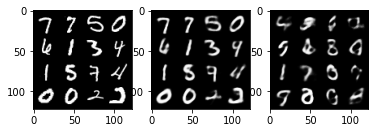

Iter: 34260/50000, Recon loss: 5458.7090, KL div loss: 1367.6919, Total loss: 6826.4009
Iter: 34270/50000, Recon loss: 5651.8018, KL div loss: 1410.0165, Total loss: 7061.8184
Iter: 34280/50000, Recon loss: 5676.5820, KL div loss: 1418.5590, Total loss: 7095.1411
Iter: 34290/50000, Recon loss: 5701.9756, KL div loss: 1412.6296, Total loss: 7114.6055
Iter: 34300/50000, Recon loss: 5492.9658, KL div loss: 1396.0190, Total loss: 6888.9849


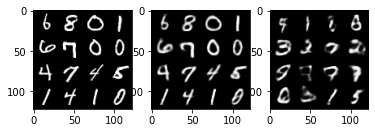

Iter: 34310/50000, Recon loss: 5294.7910, KL div loss: 1373.8021, Total loss: 6668.5933
Iter: 34320/50000, Recon loss: 5490.1826, KL div loss: 1404.1610, Total loss: 6894.3438
Iter: 34330/50000, Recon loss: 5177.4609, KL div loss: 1376.6238, Total loss: 6554.0850
Iter: 34340/50000, Recon loss: 5223.8711, KL div loss: 1365.2522, Total loss: 6589.1230
Iter: 34350/50000, Recon loss: 5829.0205, KL div loss: 1404.6062, Total loss: 7233.6270


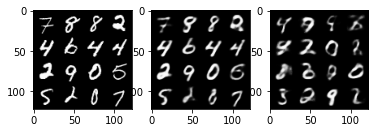

Iter: 34360/50000, Recon loss: 5525.1436, KL div loss: 1420.7090, Total loss: 6945.8525
Iter: 34370/50000, Recon loss: 5311.6865, KL div loss: 1360.9957, Total loss: 6672.6821
Iter: 34380/50000, Recon loss: 5465.5854, KL div loss: 1394.7651, Total loss: 6860.3506
Iter: 34390/50000, Recon loss: 5654.7598, KL div loss: 1362.0718, Total loss: 7016.8315
Iter: 34400/50000, Recon loss: 5466.1475, KL div loss: 1409.8899, Total loss: 6876.0371


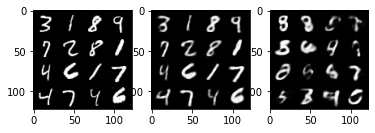

Iter: 34410/50000, Recon loss: 5876.7017, KL div loss: 1412.5706, Total loss: 7289.2725
Iter: 34420/50000, Recon loss: 5371.3374, KL div loss: 1369.9041, Total loss: 6741.2412
Iter: 34430/50000, Recon loss: 5265.4214, KL div loss: 1442.6626, Total loss: 6708.0840
Iter: 34440/50000, Recon loss: 5493.8398, KL div loss: 1361.8848, Total loss: 6855.7246
Iter: 34450/50000, Recon loss: 5473.9224, KL div loss: 1373.2031, Total loss: 6847.1255


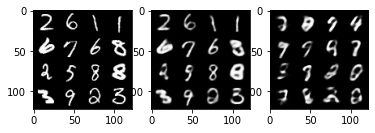

Iter: 34460/50000, Recon loss: 5555.7007, KL div loss: 1372.5225, Total loss: 6928.2231
Iter: 34470/50000, Recon loss: 5196.9219, KL div loss: 1384.9972, Total loss: 6581.9189
Iter: 34480/50000, Recon loss: 5448.2490, KL div loss: 1411.3607, Total loss: 6859.6099
Iter: 34490/50000, Recon loss: 5369.0098, KL div loss: 1365.1190, Total loss: 6734.1289
Iter: 34500/50000, Recon loss: 5553.5186, KL div loss: 1361.3271, Total loss: 6914.8457


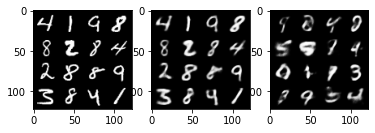

Iter: 34510/50000, Recon loss: 5363.6045, KL div loss: 1361.6658, Total loss: 6725.2705
Iter: 34520/50000, Recon loss: 5661.2979, KL div loss: 1408.5836, Total loss: 7069.8813
Iter: 34530/50000, Recon loss: 5389.9170, KL div loss: 1374.2162, Total loss: 6764.1333
Iter: 34540/50000, Recon loss: 5388.5850, KL div loss: 1433.4495, Total loss: 6822.0342
Iter: 34550/50000, Recon loss: 5456.4443, KL div loss: 1348.9563, Total loss: 6805.4004


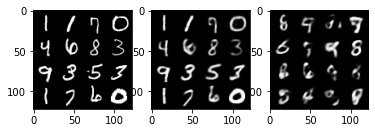

Iter: 34560/50000, Recon loss: 5306.1318, KL div loss: 1377.6448, Total loss: 6683.7764
Iter: 34570/50000, Recon loss: 5485.0312, KL div loss: 1435.0637, Total loss: 6920.0947
Iter: 34580/50000, Recon loss: 5369.2754, KL div loss: 1381.2471, Total loss: 6750.5225
Iter: 34590/50000, Recon loss: 5726.9819, KL div loss: 1406.2097, Total loss: 7133.1914
Iter: 34600/50000, Recon loss: 5537.5566, KL div loss: 1396.2888, Total loss: 6933.8457


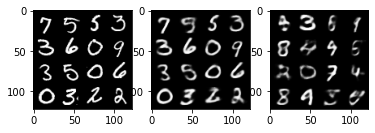

Iter: 34610/50000, Recon loss: 5517.8799, KL div loss: 1405.9684, Total loss: 6923.8481
Iter: 34620/50000, Recon loss: 5709.3569, KL div loss: 1402.9084, Total loss: 7112.2656
Iter: 34630/50000, Recon loss: 5772.9536, KL div loss: 1477.8726, Total loss: 7250.8262
Iter: 34640/50000, Recon loss: 5526.5190, KL div loss: 1397.6025, Total loss: 6924.1216
Iter: 34650/50000, Recon loss: 5785.4668, KL div loss: 1421.7363, Total loss: 7207.2031


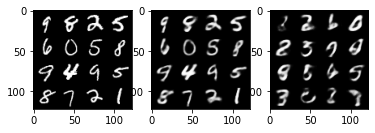

Iter: 34660/50000, Recon loss: 5680.0903, KL div loss: 1456.7168, Total loss: 7136.8071
Iter: 34670/50000, Recon loss: 5552.9043, KL div loss: 1425.3313, Total loss: 6978.2354
Iter: 34680/50000, Recon loss: 5484.2339, KL div loss: 1354.8300, Total loss: 6839.0640
Iter: 34690/50000, Recon loss: 5255.9307, KL div loss: 1361.8188, Total loss: 6617.7495
Iter: 34700/50000, Recon loss: 5118.9541, KL div loss: 1396.0798, Total loss: 6515.0342


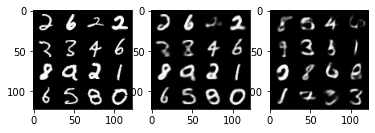

Iter: 34710/50000, Recon loss: 5466.1323, KL div loss: 1422.5173, Total loss: 6888.6494
Iter: 34720/50000, Recon loss: 5540.3789, KL div loss: 1423.3333, Total loss: 6963.7119
Iter: 34730/50000, Recon loss: 5458.3960, KL div loss: 1392.3127, Total loss: 6850.7090
Iter: 34740/50000, Recon loss: 5575.6978, KL div loss: 1446.8201, Total loss: 7022.5176
Iter: 34750/50000, Recon loss: 5556.9668, KL div loss: 1401.5940, Total loss: 6958.5605


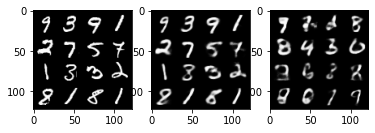

Iter: 34760/50000, Recon loss: 5674.0698, KL div loss: 1421.8083, Total loss: 7095.8779
Iter: 34770/50000, Recon loss: 5846.3296, KL div loss: 1448.5919, Total loss: 7294.9214
Iter: 34780/50000, Recon loss: 5372.7524, KL div loss: 1414.2460, Total loss: 6786.9985
Iter: 34790/50000, Recon loss: 5450.2617, KL div loss: 1417.0061, Total loss: 6867.2676
Iter: 34800/50000, Recon loss: 5390.1582, KL div loss: 1394.8738, Total loss: 6785.0322


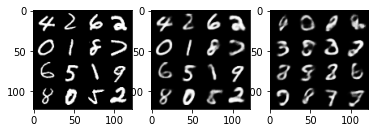

Iter: 34810/50000, Recon loss: 5490.5679, KL div loss: 1371.5674, Total loss: 6862.1353
Iter: 34820/50000, Recon loss: 5937.0298, KL div loss: 1456.1787, Total loss: 7393.2085
Iter: 34830/50000, Recon loss: 5794.4189, KL div loss: 1454.9489, Total loss: 7249.3677
Iter: 34840/50000, Recon loss: 5460.4453, KL div loss: 1373.0129, Total loss: 6833.4580
Iter: 34850/50000, Recon loss: 5487.7466, KL div loss: 1347.3846, Total loss: 6835.1313


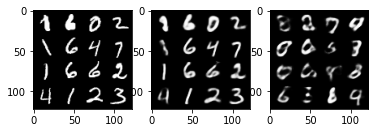

Iter: 34860/50000, Recon loss: 5358.6270, KL div loss: 1371.4883, Total loss: 6730.1152
Iter: 34870/50000, Recon loss: 5307.2188, KL div loss: 1380.5842, Total loss: 6687.8027
Iter: 34880/50000, Recon loss: 5308.2559, KL div loss: 1354.2180, Total loss: 6662.4736
Iter: 34890/50000, Recon loss: 5239.1094, KL div loss: 1392.1530, Total loss: 6631.2622
Iter: 34900/50000, Recon loss: 5507.9380, KL div loss: 1430.6855, Total loss: 6938.6235


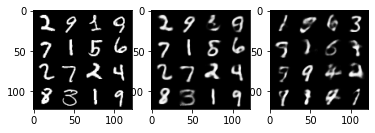

Iter: 34910/50000, Recon loss: 5136.8994, KL div loss: 1356.0801, Total loss: 6492.9795
Iter: 34920/50000, Recon loss: 5591.9341, KL div loss: 1404.5513, Total loss: 6996.4854
Iter: 34930/50000, Recon loss: 5440.1392, KL div loss: 1428.4440, Total loss: 6868.5830
Iter: 34940/50000, Recon loss: 5639.9307, KL div loss: 1412.3330, Total loss: 7052.2637
Iter: 34950/50000, Recon loss: 5242.2290, KL div loss: 1350.3036, Total loss: 6592.5327


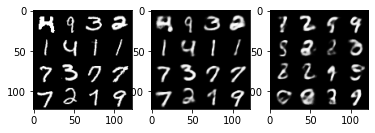

Iter: 34960/50000, Recon loss: 5399.4951, KL div loss: 1424.7458, Total loss: 6824.2412
Iter: 34970/50000, Recon loss: 5420.0293, KL div loss: 1401.5483, Total loss: 6821.5776
Iter: 34980/50000, Recon loss: 5383.6621, KL div loss: 1401.9055, Total loss: 6785.5674
Iter: 34990/50000, Recon loss: 5750.8696, KL div loss: 1431.1133, Total loss: 7181.9829
Iter: 35000/50000, Recon loss: 5433.2988, KL div loss: 1387.6913, Total loss: 6820.9902


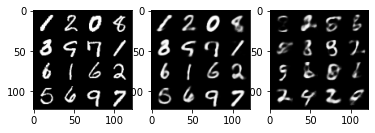

Iter: 35010/50000, Recon loss: 5736.6924, KL div loss: 1415.7092, Total loss: 7152.4014
Iter: 35020/50000, Recon loss: 5483.1597, KL div loss: 1411.6462, Total loss: 6894.8057
Iter: 35030/50000, Recon loss: 5373.4722, KL div loss: 1389.7684, Total loss: 6763.2407
Iter: 35040/50000, Recon loss: 5356.4282, KL div loss: 1358.6748, Total loss: 6715.1030
Iter: 35050/50000, Recon loss: 5404.3555, KL div loss: 1328.4678, Total loss: 6732.8232


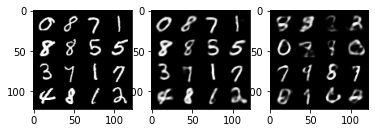

Iter: 35060/50000, Recon loss: 5118.3311, KL div loss: 1355.5006, Total loss: 6473.8315
Iter: 35070/50000, Recon loss: 5401.3926, KL div loss: 1385.0312, Total loss: 6786.4238
Iter: 35080/50000, Recon loss: 5751.4141, KL div loss: 1389.3303, Total loss: 7140.7441
Iter: 35090/50000, Recon loss: 5595.5283, KL div loss: 1400.6147, Total loss: 6996.1431
Iter: 35100/50000, Recon loss: 5473.2290, KL div loss: 1386.0132, Total loss: 6859.2422


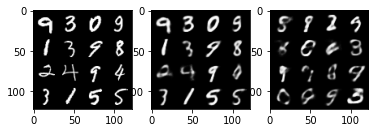

Iter: 35110/50000, Recon loss: 5603.5332, KL div loss: 1425.1243, Total loss: 7028.6572
Iter: 35120/50000, Recon loss: 5345.8037, KL div loss: 1359.6333, Total loss: 6705.4370
Iter: 35130/50000, Recon loss: 5537.1367, KL div loss: 1426.1520, Total loss: 6963.2886
Iter: 35140/50000, Recon loss: 5285.7310, KL div loss: 1345.9016, Total loss: 6631.6328
Iter: 35150/50000, Recon loss: 5064.4219, KL div loss: 1362.2197, Total loss: 6426.6416


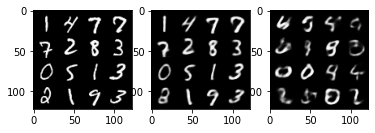

Iter: 35160/50000, Recon loss: 5139.0928, KL div loss: 1380.1580, Total loss: 6519.2510
Iter: 35170/50000, Recon loss: 5205.5366, KL div loss: 1361.0040, Total loss: 6566.5405
Iter: 35180/50000, Recon loss: 5186.5068, KL div loss: 1353.5554, Total loss: 6540.0625
Iter: 35190/50000, Recon loss: 5576.3853, KL div loss: 1435.1714, Total loss: 7011.5566
Iter: 35200/50000, Recon loss: 5376.4385, KL div loss: 1378.3228, Total loss: 6754.7612


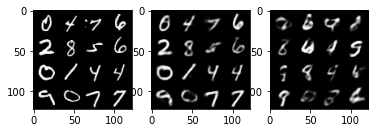

Iter: 35210/50000, Recon loss: 5523.0107, KL div loss: 1388.3667, Total loss: 6911.3774
Iter: 35220/50000, Recon loss: 5885.6245, KL div loss: 1414.7023, Total loss: 7300.3267
Iter: 35230/50000, Recon loss: 5499.9238, KL div loss: 1419.2452, Total loss: 6919.1689
Iter: 35240/50000, Recon loss: 5489.6484, KL div loss: 1452.2721, Total loss: 6941.9204
Iter: 35250/50000, Recon loss: 5748.9258, KL div loss: 1417.7477, Total loss: 7166.6733


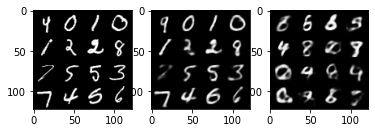

Iter: 35260/50000, Recon loss: 5828.6797, KL div loss: 1416.9839, Total loss: 7245.6636
Iter: 35270/50000, Recon loss: 5175.6875, KL div loss: 1363.6243, Total loss: 6539.3115
Iter: 35280/50000, Recon loss: 5517.5435, KL div loss: 1396.4386, Total loss: 6913.9819
Iter: 35290/50000, Recon loss: 5833.1279, KL div loss: 1417.4476, Total loss: 7250.5757
Iter: 35300/50000, Recon loss: 5671.0117, KL div loss: 1432.8384, Total loss: 7103.8501


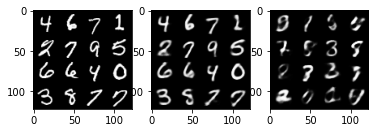

Iter: 35310/50000, Recon loss: 5709.9688, KL div loss: 1376.8484, Total loss: 7086.8174
Iter: 35320/50000, Recon loss: 5538.3662, KL div loss: 1405.8710, Total loss: 6944.2373
Iter: 35330/50000, Recon loss: 5694.2104, KL div loss: 1436.5844, Total loss: 7130.7949
Iter: 35340/50000, Recon loss: 5824.6182, KL div loss: 1422.6279, Total loss: 7247.2461
Iter: 35350/50000, Recon loss: 5568.5474, KL div loss: 1467.2905, Total loss: 7035.8379


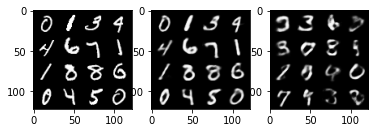

Iter: 35360/50000, Recon loss: 5598.4321, KL div loss: 1418.7411, Total loss: 7017.1733
Iter: 35370/50000, Recon loss: 5319.6465, KL div loss: 1327.2295, Total loss: 6646.8760
Iter: 35380/50000, Recon loss: 5466.8760, KL div loss: 1415.3763, Total loss: 6882.2524
Iter: 35390/50000, Recon loss: 5883.5254, KL div loss: 1425.1177, Total loss: 7308.6431
Iter: 35400/50000, Recon loss: 5699.8599, KL div loss: 1385.2750, Total loss: 7085.1348


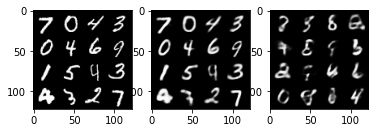

Iter: 35410/50000, Recon loss: 5603.6938, KL div loss: 1431.7812, Total loss: 7035.4751
Iter: 35420/50000, Recon loss: 5205.7290, KL div loss: 1459.9971, Total loss: 6665.7261
Iter: 35430/50000, Recon loss: 5770.9941, KL div loss: 1413.9490, Total loss: 7184.9434
Iter: 35440/50000, Recon loss: 5664.7959, KL div loss: 1368.6917, Total loss: 7033.4873
Iter: 35450/50000, Recon loss: 5775.0830, KL div loss: 1396.4309, Total loss: 7171.5137


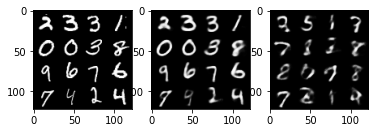

Iter: 35460/50000, Recon loss: 5435.0850, KL div loss: 1373.9083, Total loss: 6808.9932
Iter: 35470/50000, Recon loss: 5170.8267, KL div loss: 1381.0951, Total loss: 6551.9219
Iter: 35480/50000, Recon loss: 5507.1719, KL div loss: 1371.0936, Total loss: 6878.2656
Iter: 35490/50000, Recon loss: 5505.5684, KL div loss: 1365.9833, Total loss: 6871.5518
Iter: 35500/50000, Recon loss: 5456.5840, KL div loss: 1438.8031, Total loss: 6895.3872


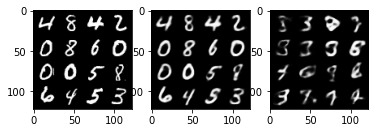

Iter: 35510/50000, Recon loss: 5951.6821, KL div loss: 1464.8604, Total loss: 7416.5425
Iter: 35520/50000, Recon loss: 5624.8960, KL div loss: 1397.8579, Total loss: 7022.7539
Iter: 35530/50000, Recon loss: 5516.3154, KL div loss: 1389.9109, Total loss: 6906.2266
Iter: 35540/50000, Recon loss: 5348.9961, KL div loss: 1328.5090, Total loss: 6677.5049
Iter: 35550/50000, Recon loss: 5411.4209, KL div loss: 1397.8251, Total loss: 6809.2461


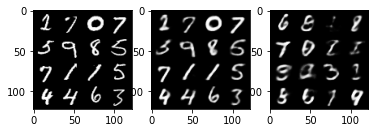

Iter: 35560/50000, Recon loss: 5145.6309, KL div loss: 1390.7693, Total loss: 6536.4004
Iter: 35570/50000, Recon loss: 5385.2412, KL div loss: 1326.5881, Total loss: 6711.8291
Iter: 35580/50000, Recon loss: 5303.5288, KL div loss: 1411.2577, Total loss: 6714.7866
Iter: 35590/50000, Recon loss: 5418.4609, KL div loss: 1390.9949, Total loss: 6809.4561
Iter: 35600/50000, Recon loss: 5752.5088, KL div loss: 1393.7891, Total loss: 7146.2979


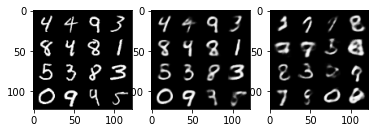

Iter: 35610/50000, Recon loss: 5185.1753, KL div loss: 1394.2214, Total loss: 6579.3965
Iter: 35620/50000, Recon loss: 5555.0742, KL div loss: 1392.9039, Total loss: 6947.9780
Iter: 35630/50000, Recon loss: 5341.0991, KL div loss: 1393.9783, Total loss: 6735.0771
Iter: 35640/50000, Recon loss: 5476.1865, KL div loss: 1391.5803, Total loss: 6867.7666
Iter: 35650/50000, Recon loss: 5681.1694, KL div loss: 1442.9156, Total loss: 7124.0850


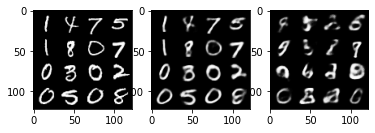

Iter: 35660/50000, Recon loss: 5129.6406, KL div loss: 1360.3561, Total loss: 6489.9966
Iter: 35670/50000, Recon loss: 5494.7046, KL div loss: 1405.6509, Total loss: 6900.3555
Iter: 35680/50000, Recon loss: 5302.0273, KL div loss: 1386.3435, Total loss: 6688.3711
Iter: 35690/50000, Recon loss: 5511.1768, KL div loss: 1403.3516, Total loss: 6914.5283
Iter: 35700/50000, Recon loss: 5217.1357, KL div loss: 1358.4867, Total loss: 6575.6226


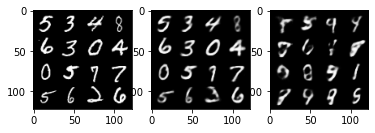

Iter: 35710/50000, Recon loss: 5644.5947, KL div loss: 1428.0095, Total loss: 7072.6045
Iter: 35720/50000, Recon loss: 5273.8818, KL div loss: 1366.1035, Total loss: 6639.9854
Iter: 35730/50000, Recon loss: 5603.9883, KL div loss: 1393.2236, Total loss: 6997.2119
Iter: 35740/50000, Recon loss: 5898.4941, KL div loss: 1458.8137, Total loss: 7357.3076
Iter: 35750/50000, Recon loss: 5827.4307, KL div loss: 1393.5872, Total loss: 7221.0176


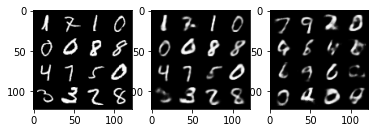

Iter: 35760/50000, Recon loss: 5460.4009, KL div loss: 1411.4369, Total loss: 6871.8379
Iter: 35770/50000, Recon loss: 5860.9346, KL div loss: 1462.3524, Total loss: 7323.2871
Iter: 35780/50000, Recon loss: 5578.0508, KL div loss: 1424.2712, Total loss: 7002.3223
Iter: 35790/50000, Recon loss: 5612.5410, KL div loss: 1403.2728, Total loss: 7015.8140
Iter: 35800/50000, Recon loss: 5349.3188, KL div loss: 1390.1401, Total loss: 6739.4590


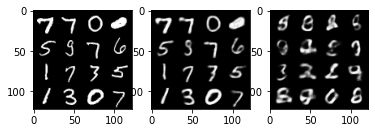

Iter: 35810/50000, Recon loss: 5421.2490, KL div loss: 1460.2754, Total loss: 6881.5244
Iter: 35820/50000, Recon loss: 5531.3975, KL div loss: 1407.2859, Total loss: 6938.6836
Iter: 35830/50000, Recon loss: 6034.8779, KL div loss: 1368.1276, Total loss: 7403.0054
Iter: 35840/50000, Recon loss: 5226.0425, KL div loss: 1388.6650, Total loss: 6614.7075
Iter: 35850/50000, Recon loss: 5558.7949, KL div loss: 1419.5615, Total loss: 6978.3564


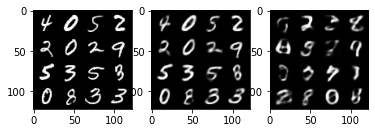

Iter: 35860/50000, Recon loss: 5348.9380, KL div loss: 1389.5103, Total loss: 6738.4482
Iter: 35870/50000, Recon loss: 5727.2988, KL div loss: 1405.1670, Total loss: 7132.4658
Iter: 35880/50000, Recon loss: 5627.5952, KL div loss: 1366.3538, Total loss: 6993.9492
Iter: 35890/50000, Recon loss: 5484.9194, KL div loss: 1410.9916, Total loss: 6895.9111
Iter: 35900/50000, Recon loss: 5563.9370, KL div loss: 1418.6876, Total loss: 6982.6245


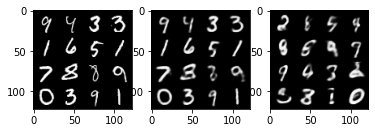

Iter: 35910/50000, Recon loss: 5484.9697, KL div loss: 1388.1604, Total loss: 6873.1299
Iter: 35920/50000, Recon loss: 5756.1729, KL div loss: 1408.1763, Total loss: 7164.3491
Iter: 35930/50000, Recon loss: 5670.6445, KL div loss: 1448.4927, Total loss: 7119.1372
Iter: 35940/50000, Recon loss: 5351.4492, KL div loss: 1394.9351, Total loss: 6746.3843
Iter: 35950/50000, Recon loss: 5421.7129, KL div loss: 1397.1411, Total loss: 6818.8540


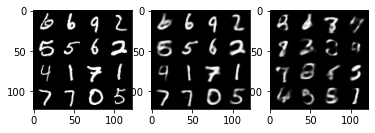

Iter: 35960/50000, Recon loss: 5507.1377, KL div loss: 1425.6296, Total loss: 6932.7676
Iter: 35970/50000, Recon loss: 5478.8643, KL div loss: 1406.6660, Total loss: 6885.5303
Iter: 35980/50000, Recon loss: 5748.9722, KL div loss: 1429.3893, Total loss: 7178.3613
Iter: 35990/50000, Recon loss: 5501.1133, KL div loss: 1405.2246, Total loss: 6906.3379
Iter: 36000/50000, Recon loss: 5426.8271, KL div loss: 1390.7366, Total loss: 6817.5635


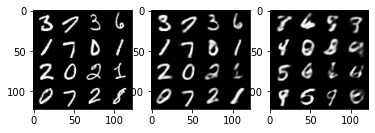

Iter: 36010/50000, Recon loss: 5148.8198, KL div loss: 1399.7842, Total loss: 6548.6040
Iter: 36020/50000, Recon loss: 5518.7861, KL div loss: 1419.2205, Total loss: 6938.0068
Iter: 36030/50000, Recon loss: 5430.7412, KL div loss: 1382.7817, Total loss: 6813.5229
Iter: 36040/50000, Recon loss: 5107.8433, KL div loss: 1304.7251, Total loss: 6412.5684
Iter: 36050/50000, Recon loss: 5395.1689, KL div loss: 1410.4514, Total loss: 6805.6201


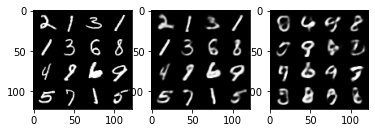

Iter: 36060/50000, Recon loss: 5424.6289, KL div loss: 1393.0713, Total loss: 6817.7002
Iter: 36070/50000, Recon loss: 5509.8945, KL div loss: 1391.0261, Total loss: 6900.9209
Iter: 36080/50000, Recon loss: 5727.0723, KL div loss: 1447.7765, Total loss: 7174.8486
Iter: 36090/50000, Recon loss: 5408.8003, KL div loss: 1364.4011, Total loss: 6773.2012
Iter: 36100/50000, Recon loss: 5739.2920, KL div loss: 1407.0795, Total loss: 7146.3716


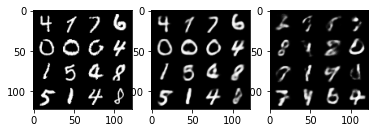

Iter: 36110/50000, Recon loss: 5334.5186, KL div loss: 1352.4375, Total loss: 6686.9561
Iter: 36120/50000, Recon loss: 6002.5586, KL div loss: 1423.1588, Total loss: 7425.7173
Iter: 36130/50000, Recon loss: 5628.6426, KL div loss: 1470.0100, Total loss: 7098.6523
Iter: 36140/50000, Recon loss: 4955.0889, KL div loss: 1373.3081, Total loss: 6328.3970
Iter: 36150/50000, Recon loss: 5233.3232, KL div loss: 1390.8987, Total loss: 6624.2217


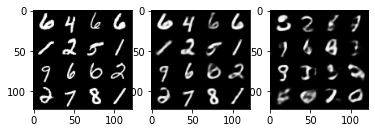

Iter: 36160/50000, Recon loss: 5397.4946, KL div loss: 1382.6335, Total loss: 6780.1279
Iter: 36170/50000, Recon loss: 5090.6553, KL div loss: 1343.9655, Total loss: 6434.6206
Iter: 36180/50000, Recon loss: 5063.8037, KL div loss: 1367.0486, Total loss: 6430.8525
Iter: 36190/50000, Recon loss: 5162.7471, KL div loss: 1385.3904, Total loss: 6548.1377
Iter: 36200/50000, Recon loss: 5487.3569, KL div loss: 1418.5688, Total loss: 6905.9258


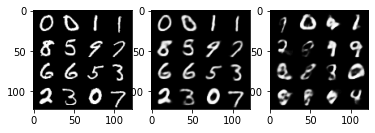

Iter: 36210/50000, Recon loss: 5209.4375, KL div loss: 1387.4839, Total loss: 6596.9214
Iter: 36220/50000, Recon loss: 5584.0830, KL div loss: 1404.2378, Total loss: 6988.3208
Iter: 36230/50000, Recon loss: 5340.7842, KL div loss: 1404.8152, Total loss: 6745.5996
Iter: 36240/50000, Recon loss: 5630.1396, KL div loss: 1372.5830, Total loss: 7002.7227
Iter: 36250/50000, Recon loss: 5665.6162, KL div loss: 1453.0543, Total loss: 7118.6704


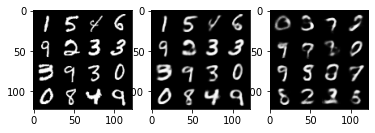

Iter: 36260/50000, Recon loss: 5383.4673, KL div loss: 1429.0769, Total loss: 6812.5439
Iter: 36270/50000, Recon loss: 5188.2520, KL div loss: 1407.7841, Total loss: 6596.0361
Iter: 36280/50000, Recon loss: 5331.0835, KL div loss: 1390.6206, Total loss: 6721.7041
Iter: 36290/50000, Recon loss: 5516.2559, KL div loss: 1386.9435, Total loss: 6903.1992
Iter: 36300/50000, Recon loss: 5400.1357, KL div loss: 1394.9193, Total loss: 6795.0552


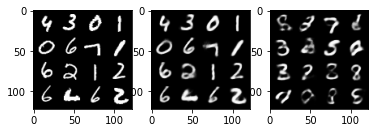

Iter: 36310/50000, Recon loss: 5408.6094, KL div loss: 1396.6816, Total loss: 6805.2910
Iter: 36320/50000, Recon loss: 6060.9434, KL div loss: 1453.4094, Total loss: 7514.3525
Iter: 36330/50000, Recon loss: 5274.3672, KL div loss: 1383.5664, Total loss: 6657.9336
Iter: 36340/50000, Recon loss: 5555.6943, KL div loss: 1437.2476, Total loss: 6992.9419
Iter: 36350/50000, Recon loss: 5674.0293, KL div loss: 1394.0715, Total loss: 7068.1006


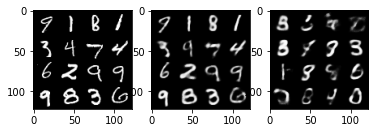

Iter: 36360/50000, Recon loss: 5526.7930, KL div loss: 1388.1559, Total loss: 6914.9487
Iter: 36370/50000, Recon loss: 5238.2725, KL div loss: 1383.3207, Total loss: 6621.5933
Iter: 36380/50000, Recon loss: 5102.1846, KL div loss: 1368.9407, Total loss: 6471.1250
Iter: 36390/50000, Recon loss: 5059.4805, KL div loss: 1372.0269, Total loss: 6431.5073
Iter: 36400/50000, Recon loss: 5845.5996, KL div loss: 1471.7277, Total loss: 7317.3271


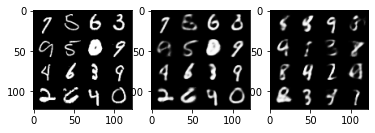

Iter: 36410/50000, Recon loss: 5623.2192, KL div loss: 1420.9121, Total loss: 7044.1313
Iter: 36420/50000, Recon loss: 5772.9502, KL div loss: 1423.6304, Total loss: 7196.5806
Iter: 36430/50000, Recon loss: 4816.7783, KL div loss: 1335.4987, Total loss: 6152.2769
Iter: 36440/50000, Recon loss: 5327.8501, KL div loss: 1393.0719, Total loss: 6720.9219
Iter: 36450/50000, Recon loss: 5165.6704, KL div loss: 1364.5454, Total loss: 6530.2158


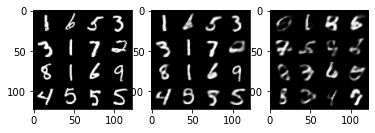

Iter: 36460/50000, Recon loss: 5536.9355, KL div loss: 1400.2749, Total loss: 6937.2104
Iter: 36470/50000, Recon loss: 5327.3813, KL div loss: 1397.4259, Total loss: 6724.8071
Iter: 36480/50000, Recon loss: 5442.6201, KL div loss: 1417.2834, Total loss: 6859.9033
Iter: 36490/50000, Recon loss: 5380.2793, KL div loss: 1416.4250, Total loss: 6796.7041
Iter: 36500/50000, Recon loss: 5403.5898, KL div loss: 1405.1238, Total loss: 6808.7139


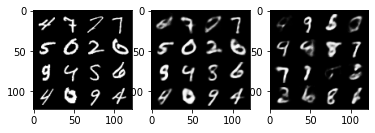

Iter: 36510/50000, Recon loss: 5481.8262, KL div loss: 1399.6848, Total loss: 6881.5107
Iter: 36520/50000, Recon loss: 5612.1401, KL div loss: 1431.8254, Total loss: 7043.9658
Iter: 36530/50000, Recon loss: 5389.0537, KL div loss: 1383.0254, Total loss: 6772.0791
Iter: 36540/50000, Recon loss: 5611.7676, KL div loss: 1409.4480, Total loss: 7021.2158
Iter: 36550/50000, Recon loss: 5514.1226, KL div loss: 1379.2239, Total loss: 6893.3467


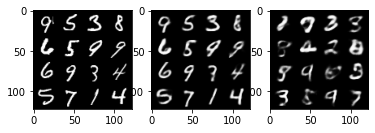

Iter: 36560/50000, Recon loss: 5654.0322, KL div loss: 1386.7135, Total loss: 7040.7456
Iter: 36570/50000, Recon loss: 6099.9507, KL div loss: 1437.1481, Total loss: 7537.0986
Iter: 36580/50000, Recon loss: 5721.1865, KL div loss: 1471.5608, Total loss: 7192.7471
Iter: 36590/50000, Recon loss: 5420.1357, KL div loss: 1409.3079, Total loss: 6829.4434
Iter: 36600/50000, Recon loss: 5004.1865, KL div loss: 1401.4880, Total loss: 6405.6748


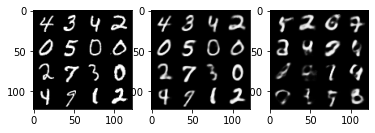

Iter: 36610/50000, Recon loss: 5532.6733, KL div loss: 1429.1736, Total loss: 6961.8467
Iter: 36620/50000, Recon loss: 5666.8926, KL div loss: 1440.4009, Total loss: 7107.2935
Iter: 36630/50000, Recon loss: 5338.4966, KL div loss: 1364.3389, Total loss: 6702.8354
Iter: 36640/50000, Recon loss: 5625.2163, KL div loss: 1400.8422, Total loss: 7026.0586
Iter: 36650/50000, Recon loss: 5827.0659, KL div loss: 1449.1000, Total loss: 7276.1660


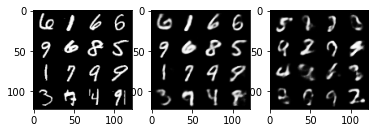

Iter: 36660/50000, Recon loss: 5516.5308, KL div loss: 1406.9241, Total loss: 6923.4551
Iter: 36670/50000, Recon loss: 5639.1143, KL div loss: 1426.9160, Total loss: 7066.0303
Iter: 36680/50000, Recon loss: 5637.0303, KL div loss: 1387.6251, Total loss: 7024.6553
Iter: 36690/50000, Recon loss: 5893.4126, KL div loss: 1444.9855, Total loss: 7338.3979
Iter: 36700/50000, Recon loss: 5624.0317, KL div loss: 1413.4801, Total loss: 7037.5117


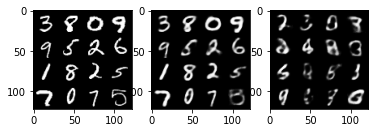

Iter: 36710/50000, Recon loss: 5613.6826, KL div loss: 1442.7295, Total loss: 7056.4121
Iter: 36720/50000, Recon loss: 5532.4131, KL div loss: 1414.9565, Total loss: 6947.3696
Iter: 36730/50000, Recon loss: 5253.2935, KL div loss: 1349.8087, Total loss: 6603.1021
Iter: 36740/50000, Recon loss: 5273.1831, KL div loss: 1335.2343, Total loss: 6608.4175
Iter: 36750/50000, Recon loss: 5188.8848, KL div loss: 1410.1157, Total loss: 6599.0005


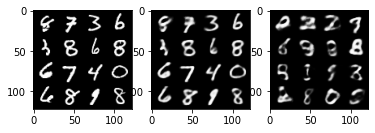

Iter: 36760/50000, Recon loss: 5452.6143, KL div loss: 1472.5630, Total loss: 6925.1772
Iter: 36770/50000, Recon loss: 5621.1143, KL div loss: 1423.5875, Total loss: 7044.7017
Iter: 36780/50000, Recon loss: 5353.2236, KL div loss: 1383.2024, Total loss: 6736.4258
Iter: 36790/50000, Recon loss: 5686.9561, KL div loss: 1414.3247, Total loss: 7101.2808
Iter: 36800/50000, Recon loss: 5115.4092, KL div loss: 1390.6179, Total loss: 6506.0273


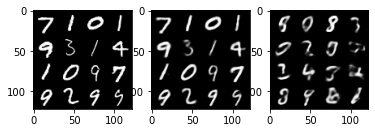

Iter: 36810/50000, Recon loss: 5320.2671, KL div loss: 1381.6477, Total loss: 6701.9150
Iter: 36820/50000, Recon loss: 5429.6543, KL div loss: 1394.2971, Total loss: 6823.9512
Iter: 36830/50000, Recon loss: 5366.7705, KL div loss: 1393.5386, Total loss: 6760.3091
Iter: 36840/50000, Recon loss: 5216.7017, KL div loss: 1386.9636, Total loss: 6603.6650
Iter: 36850/50000, Recon loss: 5370.5425, KL div loss: 1438.1116, Total loss: 6808.6543


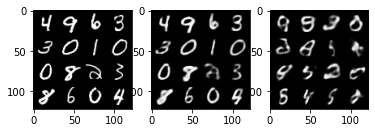

Iter: 36860/50000, Recon loss: 5737.8154, KL div loss: 1395.8115, Total loss: 7133.6270
Iter: 36870/50000, Recon loss: 5186.7251, KL div loss: 1359.0752, Total loss: 6545.8003
Iter: 36880/50000, Recon loss: 5308.4854, KL div loss: 1381.9509, Total loss: 6690.4365
Iter: 36890/50000, Recon loss: 5564.6689, KL div loss: 1427.0068, Total loss: 6991.6758
Iter: 36900/50000, Recon loss: 5643.4043, KL div loss: 1461.7960, Total loss: 7105.2002


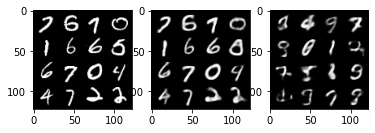

Iter: 36910/50000, Recon loss: 5458.9326, KL div loss: 1374.4114, Total loss: 6833.3438
Iter: 36920/50000, Recon loss: 5522.9731, KL div loss: 1443.5607, Total loss: 6966.5337
Iter: 36930/50000, Recon loss: 5405.6055, KL div loss: 1390.4050, Total loss: 6796.0107
Iter: 36940/50000, Recon loss: 5509.1567, KL div loss: 1395.6902, Total loss: 6904.8467
Iter: 36950/50000, Recon loss: 5347.5654, KL div loss: 1404.3203, Total loss: 6751.8857


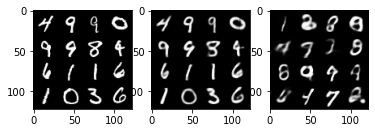

Iter: 36960/50000, Recon loss: 5638.0957, KL div loss: 1418.5278, Total loss: 7056.6235
Iter: 36970/50000, Recon loss: 5669.7104, KL div loss: 1421.8943, Total loss: 7091.6045
Iter: 36980/50000, Recon loss: 5002.1030, KL div loss: 1376.9252, Total loss: 6379.0283
Iter: 36990/50000, Recon loss: 5600.4639, KL div loss: 1422.5530, Total loss: 7023.0166
Iter: 37000/50000, Recon loss: 5340.8130, KL div loss: 1392.7339, Total loss: 6733.5469


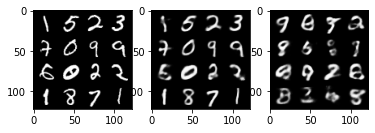

Iter: 37010/50000, Recon loss: 5263.0293, KL div loss: 1389.6787, Total loss: 6652.7080
Iter: 37020/50000, Recon loss: 5348.7202, KL div loss: 1388.0758, Total loss: 6736.7959
Iter: 37030/50000, Recon loss: 5253.4561, KL div loss: 1365.8359, Total loss: 6619.2920
Iter: 37040/50000, Recon loss: 5433.8711, KL div loss: 1362.7567, Total loss: 6796.6279
Iter: 37050/50000, Recon loss: 5323.1104, KL div loss: 1422.9708, Total loss: 6746.0811


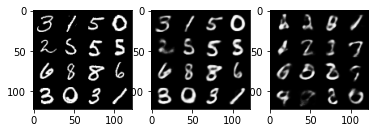

Iter: 37060/50000, Recon loss: 5411.2402, KL div loss: 1368.9069, Total loss: 6780.1470
Iter: 37070/50000, Recon loss: 5463.8682, KL div loss: 1356.6437, Total loss: 6820.5117
Iter: 37080/50000, Recon loss: 5407.7783, KL div loss: 1416.3177, Total loss: 6824.0962
Iter: 37090/50000, Recon loss: 5445.7495, KL div loss: 1401.2505, Total loss: 6847.0000
Iter: 37100/50000, Recon loss: 5317.3545, KL div loss: 1357.8982, Total loss: 6675.2529


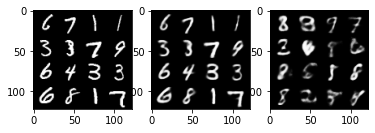

Iter: 37110/50000, Recon loss: 5636.0664, KL div loss: 1413.6344, Total loss: 7049.7007
Iter: 37120/50000, Recon loss: 5494.5723, KL div loss: 1427.4695, Total loss: 6922.0420
Iter: 37130/50000, Recon loss: 5185.1094, KL div loss: 1356.6302, Total loss: 6541.7397
Iter: 37140/50000, Recon loss: 6186.9033, KL div loss: 1462.6295, Total loss: 7649.5327
Iter: 37150/50000, Recon loss: 5562.5347, KL div loss: 1482.4282, Total loss: 7044.9629


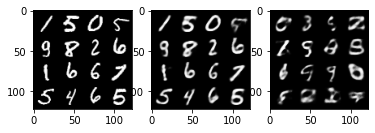

Iter: 37160/50000, Recon loss: 5286.4624, KL div loss: 1374.2869, Total loss: 6660.7490
Iter: 37170/50000, Recon loss: 5675.0767, KL div loss: 1426.0190, Total loss: 7101.0957
Iter: 37180/50000, Recon loss: 5753.5146, KL div loss: 1398.1870, Total loss: 7151.7017
Iter: 37190/50000, Recon loss: 5406.3066, KL div loss: 1399.6565, Total loss: 6805.9629
Iter: 37200/50000, Recon loss: 5685.8398, KL div loss: 1466.7874, Total loss: 7152.6270


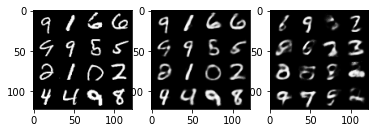

Iter: 37210/50000, Recon loss: 5794.3057, KL div loss: 1453.6733, Total loss: 7247.9790
Iter: 37220/50000, Recon loss: 5426.9033, KL div loss: 1388.4708, Total loss: 6815.3740
Iter: 37230/50000, Recon loss: 5661.3696, KL div loss: 1388.9971, Total loss: 7050.3667
Iter: 37240/50000, Recon loss: 5647.7979, KL div loss: 1434.7494, Total loss: 7082.5474
Iter: 37250/50000, Recon loss: 5318.6016, KL div loss: 1393.0144, Total loss: 6711.6162


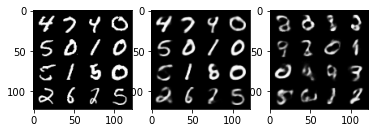

Iter: 37260/50000, Recon loss: 5158.5801, KL div loss: 1383.2410, Total loss: 6541.8213
Iter: 37270/50000, Recon loss: 5456.3682, KL div loss: 1376.6219, Total loss: 6832.9902
Iter: 37280/50000, Recon loss: 5713.9150, KL div loss: 1423.6829, Total loss: 7137.5977
Iter: 37290/50000, Recon loss: 5689.7720, KL div loss: 1410.5173, Total loss: 7100.2891
Iter: 37300/50000, Recon loss: 5324.5386, KL div loss: 1338.9919, Total loss: 6663.5303


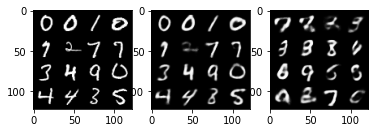

Iter: 37310/50000, Recon loss: 5539.7065, KL div loss: 1418.7151, Total loss: 6958.4219
Iter: 37320/50000, Recon loss: 5785.8691, KL div loss: 1503.7537, Total loss: 7289.6230
Iter: 37330/50000, Recon loss: 5745.9180, KL div loss: 1430.4631, Total loss: 7176.3809
Iter: 37340/50000, Recon loss: 5451.5654, KL div loss: 1360.9019, Total loss: 6812.4673
Iter: 37350/50000, Recon loss: 5496.6670, KL div loss: 1434.2635, Total loss: 6930.9307


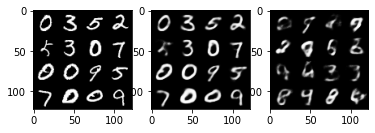

Iter: 37360/50000, Recon loss: 5030.1543, KL div loss: 1391.5386, Total loss: 6421.6929
Iter: 37370/50000, Recon loss: 5378.6836, KL div loss: 1381.3440, Total loss: 6760.0273
Iter: 37380/50000, Recon loss: 5368.2251, KL div loss: 1414.0587, Total loss: 6782.2837
Iter: 37390/50000, Recon loss: 5361.4043, KL div loss: 1386.2596, Total loss: 6747.6641
Iter: 37400/50000, Recon loss: 5486.0063, KL div loss: 1402.3708, Total loss: 6888.3770


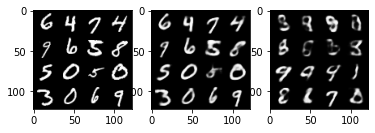

Iter: 37410/50000, Recon loss: 5596.1934, KL div loss: 1411.0203, Total loss: 7007.2139
Iter: 37420/50000, Recon loss: 5644.4785, KL div loss: 1375.2377, Total loss: 7019.7163
Iter: 37430/50000, Recon loss: 5856.1240, KL div loss: 1444.0076, Total loss: 7300.1318
Iter: 37440/50000, Recon loss: 5219.7266, KL div loss: 1387.9882, Total loss: 6607.7148
Iter: 37450/50000, Recon loss: 5490.9946, KL div loss: 1419.6018, Total loss: 6910.5967


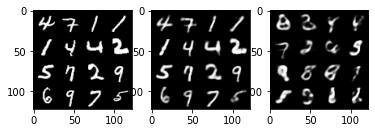

Iter: 37460/50000, Recon loss: 5361.2334, KL div loss: 1408.9194, Total loss: 6770.1528
Iter: 37470/50000, Recon loss: 5344.1650, KL div loss: 1349.3408, Total loss: 6693.5059
Iter: 37480/50000, Recon loss: 5394.8398, KL div loss: 1361.9756, Total loss: 6756.8154
Iter: 37490/50000, Recon loss: 5607.7324, KL div loss: 1459.1208, Total loss: 7066.8535
Iter: 37500/50000, Recon loss: 5642.6514, KL div loss: 1399.2710, Total loss: 7041.9224


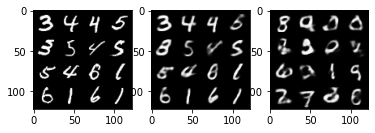

Iter: 37510/50000, Recon loss: 5733.7739, KL div loss: 1438.9910, Total loss: 7172.7646
Iter: 37520/50000, Recon loss: 5913.5571, KL div loss: 1463.7146, Total loss: 7377.2715
Iter: 37530/50000, Recon loss: 5597.5034, KL div loss: 1406.6843, Total loss: 7004.1875
Iter: 37540/50000, Recon loss: 5146.8154, KL div loss: 1343.3724, Total loss: 6490.1880
Iter: 37550/50000, Recon loss: 5418.9087, KL div loss: 1403.3000, Total loss: 6822.2090


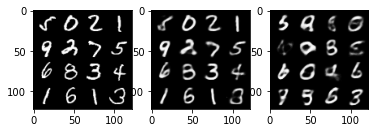

Iter: 37560/50000, Recon loss: 5286.6895, KL div loss: 1388.8788, Total loss: 6675.5684
Iter: 37570/50000, Recon loss: 5516.0776, KL div loss: 1365.0386, Total loss: 6881.1162
Iter: 37580/50000, Recon loss: 5628.8003, KL div loss: 1458.9783, Total loss: 7087.7783
Iter: 37590/50000, Recon loss: 5176.2031, KL div loss: 1391.9476, Total loss: 6568.1509
Iter: 37600/50000, Recon loss: 5573.8770, KL div loss: 1387.1382, Total loss: 6961.0151


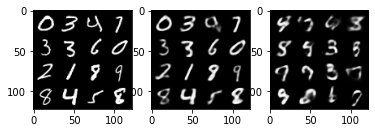

Iter: 37610/50000, Recon loss: 5429.2979, KL div loss: 1439.8340, Total loss: 6869.1318
Iter: 37620/50000, Recon loss: 5298.6997, KL div loss: 1376.8037, Total loss: 6675.5034
Iter: 37630/50000, Recon loss: 5622.9883, KL div loss: 1380.4115, Total loss: 7003.3999
Iter: 37640/50000, Recon loss: 5702.1826, KL div loss: 1438.5835, Total loss: 7140.7661
Iter: 37650/50000, Recon loss: 5450.6475, KL div loss: 1436.5853, Total loss: 6887.2329


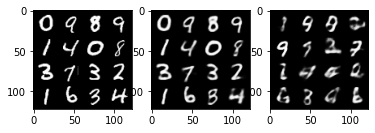

Iter: 37660/50000, Recon loss: 5500.6953, KL div loss: 1434.2219, Total loss: 6934.9170
Iter: 37670/50000, Recon loss: 5050.5049, KL div loss: 1388.5116, Total loss: 6439.0166
Iter: 37680/50000, Recon loss: 5635.8066, KL div loss: 1419.4673, Total loss: 7055.2739
Iter: 37690/50000, Recon loss: 5092.0547, KL div loss: 1393.5221, Total loss: 6485.5767
Iter: 37700/50000, Recon loss: 5529.6392, KL div loss: 1427.5583, Total loss: 6957.1973


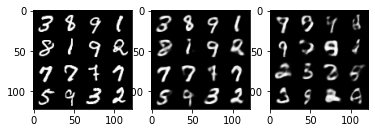

Iter: 37710/50000, Recon loss: 5394.6904, KL div loss: 1419.3176, Total loss: 6814.0078
Iter: 37720/50000, Recon loss: 5287.2539, KL div loss: 1408.2402, Total loss: 6695.4941
Iter: 37730/50000, Recon loss: 5773.4873, KL div loss: 1424.3328, Total loss: 7197.8203
Iter: 37740/50000, Recon loss: 5472.3643, KL div loss: 1436.9368, Total loss: 6909.3008
Iter: 37750/50000, Recon loss: 5177.1885, KL div loss: 1378.8904, Total loss: 6556.0791


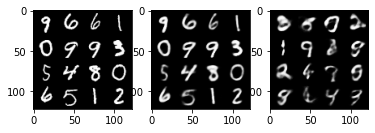

Iter: 37760/50000, Recon loss: 5628.4170, KL div loss: 1415.4929, Total loss: 7043.9102
Iter: 37770/50000, Recon loss: 5420.6353, KL div loss: 1415.5957, Total loss: 6836.2310
Iter: 37780/50000, Recon loss: 5833.3911, KL div loss: 1425.1892, Total loss: 7258.5801
Iter: 37790/50000, Recon loss: 5307.4775, KL div loss: 1426.5466, Total loss: 6734.0244
Iter: 37800/50000, Recon loss: 5238.8779, KL div loss: 1404.5483, Total loss: 6643.4263


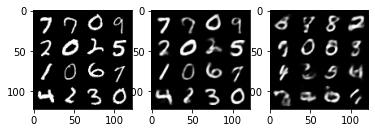

Iter: 37810/50000, Recon loss: 5310.8262, KL div loss: 1390.8934, Total loss: 6701.7197
Iter: 37820/50000, Recon loss: 5014.3008, KL div loss: 1378.6736, Total loss: 6392.9746
Iter: 37830/50000, Recon loss: 5441.1733, KL div loss: 1355.6963, Total loss: 6796.8696
Iter: 37840/50000, Recon loss: 5752.1826, KL div loss: 1399.4111, Total loss: 7151.5938
Iter: 37850/50000, Recon loss: 5570.4976, KL div loss: 1382.0322, Total loss: 6952.5298


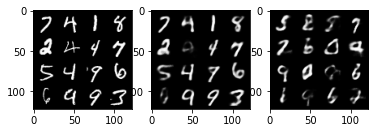

Iter: 37860/50000, Recon loss: 5315.6938, KL div loss: 1400.9438, Total loss: 6716.6377
Iter: 37870/50000, Recon loss: 5459.9580, KL div loss: 1420.5458, Total loss: 6880.5039
Iter: 37880/50000, Recon loss: 5224.2412, KL div loss: 1383.8787, Total loss: 6608.1201
Iter: 37890/50000, Recon loss: 5754.7446, KL div loss: 1443.0327, Total loss: 7197.7773
Iter: 37900/50000, Recon loss: 5222.4883, KL div loss: 1411.8074, Total loss: 6634.2959


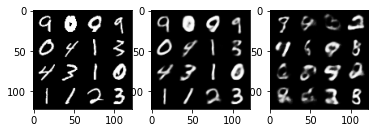

Iter: 37910/50000, Recon loss: 4933.9839, KL div loss: 1361.4885, Total loss: 6295.4727
Iter: 37920/50000, Recon loss: 5340.9575, KL div loss: 1438.0178, Total loss: 6778.9756
Iter: 37930/50000, Recon loss: 5416.7397, KL div loss: 1398.7041, Total loss: 6815.4438
Iter: 37940/50000, Recon loss: 5646.0869, KL div loss: 1442.9336, Total loss: 7089.0205
Iter: 37950/50000, Recon loss: 5599.3799, KL div loss: 1382.6887, Total loss: 6982.0684


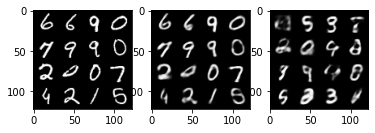

Iter: 37960/50000, Recon loss: 5441.1875, KL div loss: 1403.0696, Total loss: 6844.2568
Iter: 37970/50000, Recon loss: 4941.4478, KL div loss: 1391.5472, Total loss: 6332.9951
Iter: 37980/50000, Recon loss: 5486.4150, KL div loss: 1403.1626, Total loss: 6889.5776
Iter: 37990/50000, Recon loss: 5364.4897, KL div loss: 1406.0703, Total loss: 6770.5601
Iter: 38000/50000, Recon loss: 5791.0103, KL div loss: 1442.8911, Total loss: 7233.9014


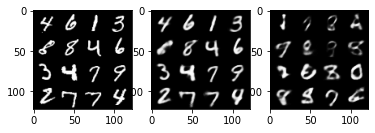

Iter: 38010/50000, Recon loss: 5226.2212, KL div loss: 1409.6245, Total loss: 6635.8457
Iter: 38020/50000, Recon loss: 5755.1680, KL div loss: 1461.9993, Total loss: 7217.1670
Iter: 38030/50000, Recon loss: 5668.8979, KL div loss: 1374.2283, Total loss: 7043.1260
Iter: 38040/50000, Recon loss: 5373.9551, KL div loss: 1398.3105, Total loss: 6772.2656
Iter: 38050/50000, Recon loss: 5280.5566, KL div loss: 1425.8132, Total loss: 6706.3701


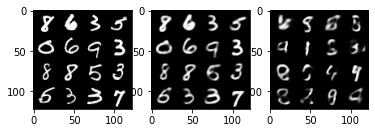

Iter: 38060/50000, Recon loss: 5426.0342, KL div loss: 1408.5615, Total loss: 6834.5957
Iter: 38070/50000, Recon loss: 5855.6519, KL div loss: 1444.6808, Total loss: 7300.3325
Iter: 38080/50000, Recon loss: 5463.6436, KL div loss: 1415.2871, Total loss: 6878.9307
Iter: 38090/50000, Recon loss: 5694.3848, KL div loss: 1461.2635, Total loss: 7155.6484
Iter: 38100/50000, Recon loss: 5423.2461, KL div loss: 1410.3381, Total loss: 6833.5840


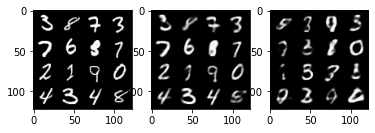

Iter: 38110/50000, Recon loss: 5810.0732, KL div loss: 1466.4083, Total loss: 7276.4814
Iter: 38120/50000, Recon loss: 5737.2749, KL div loss: 1407.7188, Total loss: 7144.9937
Iter: 38130/50000, Recon loss: 5524.6436, KL div loss: 1419.9022, Total loss: 6944.5459
Iter: 38140/50000, Recon loss: 5534.7422, KL div loss: 1390.9817, Total loss: 6925.7236
Iter: 38150/50000, Recon loss: 5379.9873, KL div loss: 1404.5071, Total loss: 6784.4941


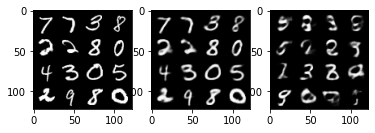

Iter: 38160/50000, Recon loss: 4913.4062, KL div loss: 1328.6118, Total loss: 6242.0181
Iter: 38170/50000, Recon loss: 5505.0977, KL div loss: 1417.7101, Total loss: 6922.8076
Iter: 38180/50000, Recon loss: 5198.0752, KL div loss: 1394.2604, Total loss: 6592.3354
Iter: 38190/50000, Recon loss: 5716.6992, KL div loss: 1428.9268, Total loss: 7145.6260
Iter: 38200/50000, Recon loss: 5671.9565, KL div loss: 1460.9248, Total loss: 7132.8813


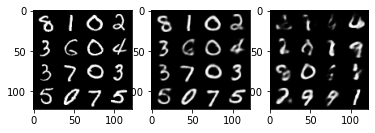

Iter: 38210/50000, Recon loss: 5216.3281, KL div loss: 1395.0854, Total loss: 6611.4136
Iter: 38220/50000, Recon loss: 5700.6553, KL div loss: 1387.7755, Total loss: 7088.4307
Iter: 38230/50000, Recon loss: 5791.0713, KL div loss: 1423.6764, Total loss: 7214.7476
Iter: 38240/50000, Recon loss: 5774.8101, KL div loss: 1430.0377, Total loss: 7204.8477
Iter: 38250/50000, Recon loss: 5241.5547, KL div loss: 1382.4580, Total loss: 6624.0127


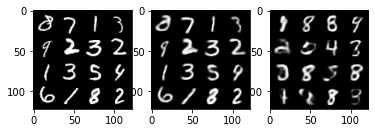

Iter: 38260/50000, Recon loss: 5182.0449, KL div loss: 1367.0760, Total loss: 6549.1211
Iter: 38270/50000, Recon loss: 5472.8071, KL div loss: 1388.6183, Total loss: 6861.4253
Iter: 38280/50000, Recon loss: 5463.1362, KL div loss: 1404.7808, Total loss: 6867.9170
Iter: 38290/50000, Recon loss: 5064.2646, KL div loss: 1363.4207, Total loss: 6427.6855
Iter: 38300/50000, Recon loss: 5317.5059, KL div loss: 1411.2698, Total loss: 6728.7754


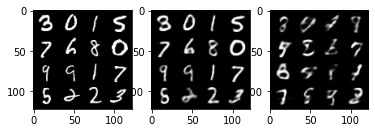

Iter: 38310/50000, Recon loss: 5309.9092, KL div loss: 1390.0613, Total loss: 6699.9707
Iter: 38320/50000, Recon loss: 5144.1011, KL div loss: 1362.2515, Total loss: 6506.3525
Iter: 38330/50000, Recon loss: 5475.1270, KL div loss: 1417.2771, Total loss: 6892.4043
Iter: 38340/50000, Recon loss: 5574.6475, KL div loss: 1378.3632, Total loss: 6953.0107
Iter: 38350/50000, Recon loss: 5443.0215, KL div loss: 1399.8354, Total loss: 6842.8569


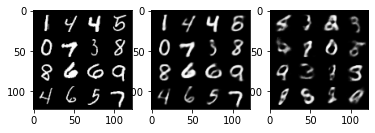

Iter: 38360/50000, Recon loss: 5684.7705, KL div loss: 1441.3279, Total loss: 7126.0986
Iter: 38370/50000, Recon loss: 5864.0605, KL div loss: 1444.5475, Total loss: 7308.6079
Iter: 38380/50000, Recon loss: 5229.5654, KL div loss: 1395.7397, Total loss: 6625.3052
Iter: 38390/50000, Recon loss: 5530.4551, KL div loss: 1421.2639, Total loss: 6951.7188
Iter: 38400/50000, Recon loss: 5750.3535, KL div loss: 1429.6611, Total loss: 7180.0146


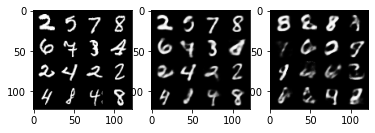

Iter: 38410/50000, Recon loss: 5332.7754, KL div loss: 1418.9441, Total loss: 6751.7197
Iter: 38420/50000, Recon loss: 5537.8379, KL div loss: 1409.7578, Total loss: 6947.5957
Iter: 38430/50000, Recon loss: 5143.3950, KL div loss: 1434.9954, Total loss: 6578.3906
Iter: 38440/50000, Recon loss: 5421.1016, KL div loss: 1391.0272, Total loss: 6812.1289
Iter: 38450/50000, Recon loss: 5428.0010, KL div loss: 1417.8074, Total loss: 6845.8086


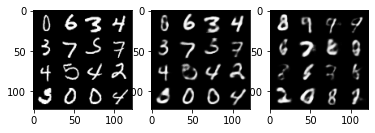

Iter: 38460/50000, Recon loss: 5363.1631, KL div loss: 1381.5024, Total loss: 6744.6655
Iter: 38470/50000, Recon loss: 5183.8398, KL div loss: 1337.8684, Total loss: 6521.7080
Iter: 38480/50000, Recon loss: 5288.4019, KL div loss: 1406.0857, Total loss: 6694.4873
Iter: 38490/50000, Recon loss: 5272.8066, KL div loss: 1391.3256, Total loss: 6664.1323
Iter: 38500/50000, Recon loss: 5353.1992, KL div loss: 1397.2227, Total loss: 6750.4219


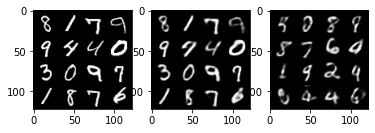

Iter: 38510/50000, Recon loss: 5559.9805, KL div loss: 1379.8125, Total loss: 6939.7930
Iter: 38520/50000, Recon loss: 5305.2227, KL div loss: 1433.6454, Total loss: 6738.8682
Iter: 38530/50000, Recon loss: 5670.0815, KL div loss: 1458.9551, Total loss: 7129.0366
Iter: 38540/50000, Recon loss: 5693.4971, KL div loss: 1425.2192, Total loss: 7118.7163
Iter: 38550/50000, Recon loss: 5461.3350, KL div loss: 1385.5348, Total loss: 6846.8696


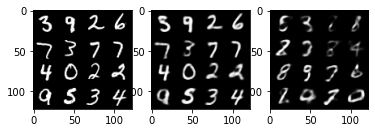

Iter: 38560/50000, Recon loss: 5698.0864, KL div loss: 1426.6194, Total loss: 7124.7061
Iter: 38570/50000, Recon loss: 5608.9287, KL div loss: 1410.0844, Total loss: 7019.0132
Iter: 38580/50000, Recon loss: 5316.6611, KL div loss: 1425.5100, Total loss: 6742.1709
Iter: 38590/50000, Recon loss: 5839.9253, KL div loss: 1434.5735, Total loss: 7274.4990
Iter: 38600/50000, Recon loss: 5492.0259, KL div loss: 1359.2776, Total loss: 6851.3037


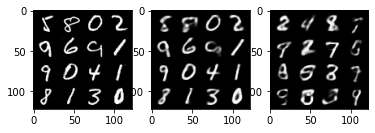

Iter: 38610/50000, Recon loss: 5264.7852, KL div loss: 1375.1432, Total loss: 6639.9282
Iter: 38620/50000, Recon loss: 5363.3281, KL div loss: 1399.1904, Total loss: 6762.5186
Iter: 38630/50000, Recon loss: 4929.1699, KL div loss: 1353.1528, Total loss: 6282.3228
Iter: 38640/50000, Recon loss: 5455.4038, KL div loss: 1377.1602, Total loss: 6832.5640
Iter: 38650/50000, Recon loss: 5716.8154, KL div loss: 1445.3770, Total loss: 7162.1924


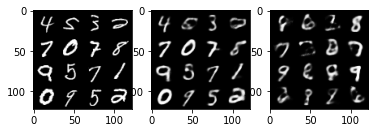

Iter: 38660/50000, Recon loss: 5439.3647, KL div loss: 1389.3152, Total loss: 6828.6797
Iter: 38670/50000, Recon loss: 5572.9443, KL div loss: 1413.2836, Total loss: 6986.2280
Iter: 38680/50000, Recon loss: 5363.0337, KL div loss: 1410.5686, Total loss: 6773.6025
Iter: 38690/50000, Recon loss: 5379.6426, KL div loss: 1416.7722, Total loss: 6796.4150
Iter: 38700/50000, Recon loss: 5767.9888, KL div loss: 1449.3313, Total loss: 7217.3203


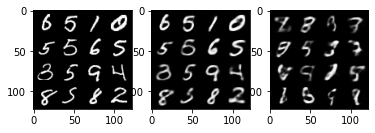

Iter: 38710/50000, Recon loss: 5563.5557, KL div loss: 1418.7166, Total loss: 6982.2725
Iter: 38720/50000, Recon loss: 5370.6860, KL div loss: 1420.7197, Total loss: 6791.4058
Iter: 38730/50000, Recon loss: 5747.7915, KL div loss: 1452.8999, Total loss: 7200.6914
Iter: 38740/50000, Recon loss: 5852.1035, KL div loss: 1459.6760, Total loss: 7311.7793
Iter: 38750/50000, Recon loss: 5531.3379, KL div loss: 1430.0808, Total loss: 6961.4189


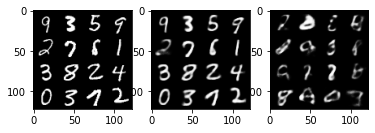

Iter: 38760/50000, Recon loss: 5661.2729, KL div loss: 1433.6277, Total loss: 7094.9004
Iter: 38770/50000, Recon loss: 4954.0068, KL div loss: 1361.1382, Total loss: 6315.1450
Iter: 38780/50000, Recon loss: 5311.6904, KL div loss: 1360.4939, Total loss: 6672.1846
Iter: 38790/50000, Recon loss: 5130.1982, KL div loss: 1388.6790, Total loss: 6518.8770
Iter: 38800/50000, Recon loss: 5052.1611, KL div loss: 1368.1072, Total loss: 6420.2686


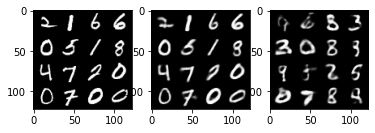

Iter: 38810/50000, Recon loss: 5051.1719, KL div loss: 1349.2224, Total loss: 6400.3945
Iter: 38820/50000, Recon loss: 5391.2920, KL div loss: 1426.5228, Total loss: 6817.8149
Iter: 38830/50000, Recon loss: 5356.0742, KL div loss: 1399.6826, Total loss: 6755.7568
Iter: 38840/50000, Recon loss: 5706.6216, KL div loss: 1435.6490, Total loss: 7142.2705
Iter: 38850/50000, Recon loss: 5634.9956, KL div loss: 1457.0161, Total loss: 7092.0117


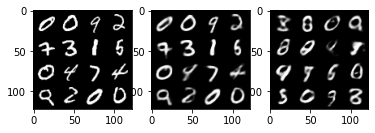

Iter: 38860/50000, Recon loss: 5419.0044, KL div loss: 1383.7935, Total loss: 6802.7979
Iter: 38870/50000, Recon loss: 5326.6973, KL div loss: 1392.0879, Total loss: 6718.7852
Iter: 38880/50000, Recon loss: 5747.6484, KL div loss: 1444.2329, Total loss: 7191.8813
Iter: 38890/50000, Recon loss: 5165.5205, KL div loss: 1363.8589, Total loss: 6529.3794
Iter: 38900/50000, Recon loss: 5275.6318, KL div loss: 1378.8486, Total loss: 6654.4805


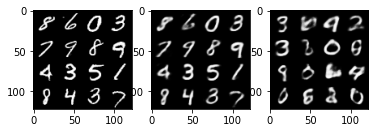

Iter: 38910/50000, Recon loss: 5271.6826, KL div loss: 1405.5916, Total loss: 6677.2744
Iter: 38920/50000, Recon loss: 5515.6099, KL div loss: 1424.8528, Total loss: 6940.4629
Iter: 38930/50000, Recon loss: 5142.5127, KL div loss: 1388.0322, Total loss: 6530.5449
Iter: 38940/50000, Recon loss: 5821.2686, KL div loss: 1422.7112, Total loss: 7243.9795
Iter: 38950/50000, Recon loss: 5116.8818, KL div loss: 1357.4695, Total loss: 6474.3516


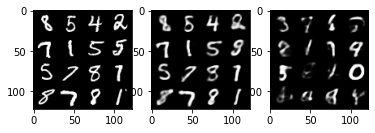

Iter: 38960/50000, Recon loss: 5332.2954, KL div loss: 1405.4283, Total loss: 6737.7236
Iter: 38970/50000, Recon loss: 5741.7710, KL div loss: 1453.7451, Total loss: 7195.5161
Iter: 38980/50000, Recon loss: 5220.2368, KL div loss: 1390.1719, Total loss: 6610.4087
Iter: 38990/50000, Recon loss: 5246.9668, KL div loss: 1388.3772, Total loss: 6635.3438
Iter: 39000/50000, Recon loss: 5341.4414, KL div loss: 1396.5220, Total loss: 6737.9634


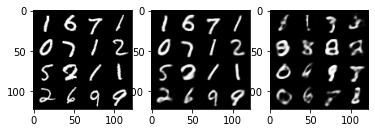

Iter: 39010/50000, Recon loss: 5233.3853, KL div loss: 1449.2898, Total loss: 6682.6748
Iter: 39020/50000, Recon loss: 5259.1982, KL div loss: 1385.2081, Total loss: 6644.4062
Iter: 39030/50000, Recon loss: 5360.8369, KL div loss: 1404.2931, Total loss: 6765.1299
Iter: 39040/50000, Recon loss: 5369.4805, KL div loss: 1409.7167, Total loss: 6779.1973
Iter: 39050/50000, Recon loss: 5524.2671, KL div loss: 1390.3840, Total loss: 6914.6514


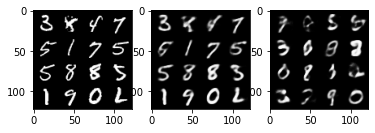

Iter: 39060/50000, Recon loss: 5649.0322, KL div loss: 1428.4585, Total loss: 7077.4907
Iter: 39070/50000, Recon loss: 5418.9360, KL div loss: 1394.4275, Total loss: 6813.3633
Iter: 39080/50000, Recon loss: 5437.9468, KL div loss: 1367.2927, Total loss: 6805.2393
Iter: 39090/50000, Recon loss: 5338.3779, KL div loss: 1402.3850, Total loss: 6740.7627
Iter: 39100/50000, Recon loss: 5474.7178, KL div loss: 1375.3496, Total loss: 6850.0674


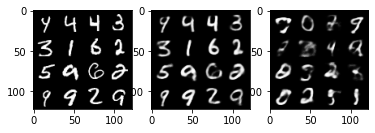

Iter: 39110/50000, Recon loss: 5773.7109, KL div loss: 1461.6497, Total loss: 7235.3604
Iter: 39120/50000, Recon loss: 5723.0000, KL div loss: 1422.3381, Total loss: 7145.3379
Iter: 39130/50000, Recon loss: 5583.0034, KL div loss: 1431.5441, Total loss: 7014.5474
Iter: 39140/50000, Recon loss: 4981.4346, KL div loss: 1382.6802, Total loss: 6364.1147
Iter: 39150/50000, Recon loss: 5311.8613, KL div loss: 1438.0073, Total loss: 6749.8687


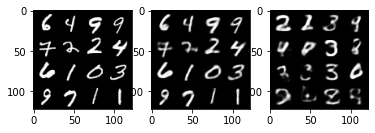

Iter: 39160/50000, Recon loss: 5446.1460, KL div loss: 1455.8882, Total loss: 6902.0342
Iter: 39170/50000, Recon loss: 5378.6172, KL div loss: 1418.6091, Total loss: 6797.2266
Iter: 39180/50000, Recon loss: 5480.8296, KL div loss: 1337.3464, Total loss: 6818.1758
Iter: 39190/50000, Recon loss: 5516.6968, KL div loss: 1399.4288, Total loss: 6916.1255
Iter: 39200/50000, Recon loss: 5472.0283, KL div loss: 1400.4396, Total loss: 6872.4678


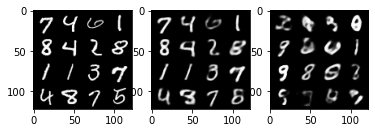

Iter: 39210/50000, Recon loss: 5269.9727, KL div loss: 1405.2864, Total loss: 6675.2588
Iter: 39220/50000, Recon loss: 5540.8838, KL div loss: 1440.6389, Total loss: 6981.5225
Iter: 39230/50000, Recon loss: 5386.1826, KL div loss: 1411.3643, Total loss: 6797.5469
Iter: 39240/50000, Recon loss: 5313.5640, KL div loss: 1398.2747, Total loss: 6711.8389
Iter: 39250/50000, Recon loss: 5718.0537, KL div loss: 1432.3132, Total loss: 7150.3672


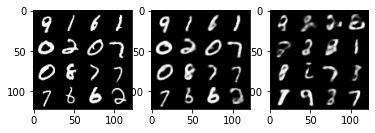

Iter: 39260/50000, Recon loss: 5269.4668, KL div loss: 1415.5947, Total loss: 6685.0615
Iter: 39270/50000, Recon loss: 5175.6812, KL div loss: 1435.3923, Total loss: 6611.0732
Iter: 39280/50000, Recon loss: 5382.3633, KL div loss: 1417.2280, Total loss: 6799.5913
Iter: 39290/50000, Recon loss: 5536.7432, KL div loss: 1426.1626, Total loss: 6962.9058
Iter: 39300/50000, Recon loss: 5461.7544, KL div loss: 1433.6362, Total loss: 6895.3906


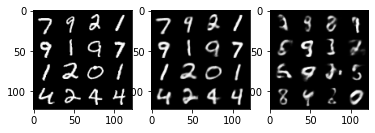

Iter: 39310/50000, Recon loss: 5488.2139, KL div loss: 1454.9536, Total loss: 6943.1675
Iter: 39320/50000, Recon loss: 5546.3271, KL div loss: 1435.3938, Total loss: 6981.7207
Iter: 39330/50000, Recon loss: 5503.5674, KL div loss: 1448.1609, Total loss: 6951.7285
Iter: 39340/50000, Recon loss: 5702.2686, KL div loss: 1408.2887, Total loss: 7110.5571
Iter: 39350/50000, Recon loss: 5324.6396, KL div loss: 1383.0348, Total loss: 6707.6743


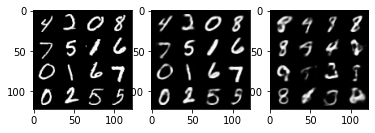

Iter: 39360/50000, Recon loss: 5235.9761, KL div loss: 1373.2986, Total loss: 6609.2744
Iter: 39370/50000, Recon loss: 5660.4360, KL div loss: 1428.7708, Total loss: 7089.2070
Iter: 39380/50000, Recon loss: 5166.7485, KL div loss: 1347.4922, Total loss: 6514.2407
Iter: 39390/50000, Recon loss: 5199.8486, KL div loss: 1348.7952, Total loss: 6548.6436
Iter: 39400/50000, Recon loss: 5335.1396, KL div loss: 1424.6379, Total loss: 6759.7773


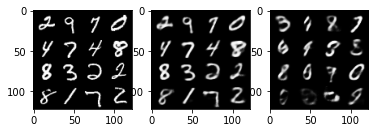

Iter: 39410/50000, Recon loss: 5401.2485, KL div loss: 1435.5339, Total loss: 6836.7822
Iter: 39420/50000, Recon loss: 5011.0566, KL div loss: 1383.7872, Total loss: 6394.8438
Iter: 39430/50000, Recon loss: 5192.0435, KL div loss: 1365.4893, Total loss: 6557.5327
Iter: 39440/50000, Recon loss: 5358.1963, KL div loss: 1399.3866, Total loss: 6757.5830
Iter: 39450/50000, Recon loss: 5385.9116, KL div loss: 1416.1121, Total loss: 6802.0234


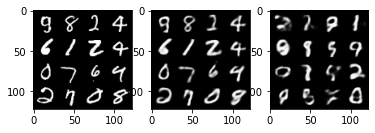

Iter: 39460/50000, Recon loss: 5134.0117, KL div loss: 1364.1499, Total loss: 6498.1616
Iter: 39470/50000, Recon loss: 5447.8486, KL div loss: 1422.1752, Total loss: 6870.0239
Iter: 39480/50000, Recon loss: 5894.7295, KL div loss: 1445.4268, Total loss: 7340.1562
Iter: 39490/50000, Recon loss: 5396.2324, KL div loss: 1406.7505, Total loss: 6802.9829
Iter: 39500/50000, Recon loss: 5305.8701, KL div loss: 1446.1603, Total loss: 6752.0303


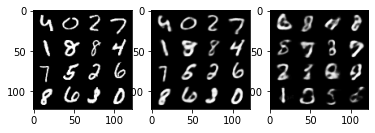

Iter: 39510/50000, Recon loss: 5435.0474, KL div loss: 1442.3016, Total loss: 6877.3491
Iter: 39520/50000, Recon loss: 5265.3008, KL div loss: 1355.0187, Total loss: 6620.3193
Iter: 39530/50000, Recon loss: 5444.1445, KL div loss: 1403.6040, Total loss: 6847.7485
Iter: 39540/50000, Recon loss: 5214.6411, KL div loss: 1395.5220, Total loss: 6610.1631
Iter: 39550/50000, Recon loss: 5710.4253, KL div loss: 1400.9797, Total loss: 7111.4053


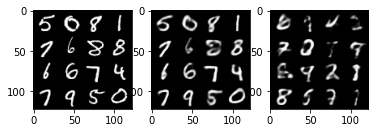

Iter: 39560/50000, Recon loss: 5179.4995, KL div loss: 1407.5729, Total loss: 6587.0723
Iter: 39570/50000, Recon loss: 5632.3960, KL div loss: 1427.2574, Total loss: 7059.6533
Iter: 39580/50000, Recon loss: 5271.1860, KL div loss: 1402.8417, Total loss: 6674.0278
Iter: 39590/50000, Recon loss: 5211.7432, KL div loss: 1416.1099, Total loss: 6627.8530
Iter: 39600/50000, Recon loss: 5745.0674, KL div loss: 1389.4783, Total loss: 7134.5459


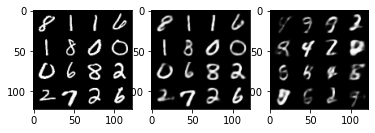

Iter: 39610/50000, Recon loss: 5637.2764, KL div loss: 1433.7540, Total loss: 7071.0303
Iter: 39620/50000, Recon loss: 5486.7461, KL div loss: 1425.0822, Total loss: 6911.8281
Iter: 39630/50000, Recon loss: 5140.3730, KL div loss: 1366.2600, Total loss: 6506.6328
Iter: 39640/50000, Recon loss: 5268.1411, KL div loss: 1376.1483, Total loss: 6644.2896
Iter: 39650/50000, Recon loss: 5241.6016, KL div loss: 1377.1145, Total loss: 6618.7158


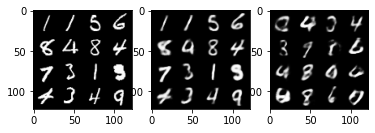

Iter: 39660/50000, Recon loss: 5602.7275, KL div loss: 1372.4355, Total loss: 6975.1631
Iter: 39670/50000, Recon loss: 5518.5693, KL div loss: 1445.0863, Total loss: 6963.6558
Iter: 39680/50000, Recon loss: 5675.0957, KL div loss: 1477.0146, Total loss: 7152.1104
Iter: 39690/50000, Recon loss: 5367.5083, KL div loss: 1411.6682, Total loss: 6779.1768
Iter: 39700/50000, Recon loss: 5397.3145, KL div loss: 1392.3003, Total loss: 6789.6147


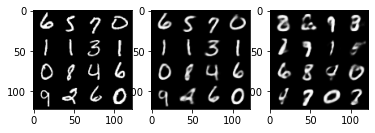

Iter: 39710/50000, Recon loss: 5570.5459, KL div loss: 1432.3679, Total loss: 7002.9141
Iter: 39720/50000, Recon loss: 4997.5869, KL div loss: 1410.2791, Total loss: 6407.8662
Iter: 39730/50000, Recon loss: 5352.6816, KL div loss: 1381.6445, Total loss: 6734.3262
Iter: 39740/50000, Recon loss: 5402.8618, KL div loss: 1408.5845, Total loss: 6811.4463
Iter: 39750/50000, Recon loss: 5457.4600, KL div loss: 1429.8436, Total loss: 6887.3037


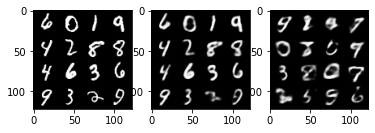

Iter: 39760/50000, Recon loss: 5339.7173, KL div loss: 1416.2998, Total loss: 6756.0171
Iter: 39770/50000, Recon loss: 5515.2690, KL div loss: 1434.2834, Total loss: 6949.5527
Iter: 39780/50000, Recon loss: 4899.1304, KL div loss: 1332.7554, Total loss: 6231.8857
Iter: 39790/50000, Recon loss: 5665.5259, KL div loss: 1428.1052, Total loss: 7093.6309
Iter: 39800/50000, Recon loss: 5351.8193, KL div loss: 1399.6047, Total loss: 6751.4238


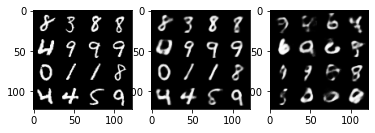

Iter: 39810/50000, Recon loss: 5321.2959, KL div loss: 1447.8979, Total loss: 6769.1938
Iter: 39820/50000, Recon loss: 5428.0942, KL div loss: 1412.7162, Total loss: 6840.8105
Iter: 39830/50000, Recon loss: 5793.7026, KL div loss: 1395.3079, Total loss: 7189.0107
Iter: 39840/50000, Recon loss: 5404.3652, KL div loss: 1412.0159, Total loss: 6816.3809
Iter: 39850/50000, Recon loss: 5164.0264, KL div loss: 1419.2384, Total loss: 6583.2646


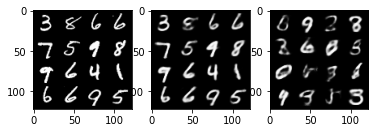

Iter: 39860/50000, Recon loss: 5495.7607, KL div loss: 1491.2833, Total loss: 6987.0439
Iter: 39870/50000, Recon loss: 5270.1348, KL div loss: 1422.4858, Total loss: 6692.6206
Iter: 39880/50000, Recon loss: 5322.8271, KL div loss: 1420.0511, Total loss: 6742.8784
Iter: 39890/50000, Recon loss: 5458.4746, KL div loss: 1366.1658, Total loss: 6824.6406
Iter: 39900/50000, Recon loss: 5122.2451, KL div loss: 1399.1362, Total loss: 6521.3813


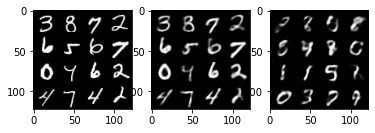

Iter: 39910/50000, Recon loss: 5530.4180, KL div loss: 1473.2509, Total loss: 7003.6689
Iter: 39920/50000, Recon loss: 5280.3516, KL div loss: 1423.3319, Total loss: 6703.6836
Iter: 39930/50000, Recon loss: 5761.4048, KL div loss: 1363.9996, Total loss: 7125.4043
Iter: 39940/50000, Recon loss: 5560.4360, KL div loss: 1438.7126, Total loss: 6999.1484
Iter: 39950/50000, Recon loss: 5543.1357, KL div loss: 1432.8752, Total loss: 6976.0107


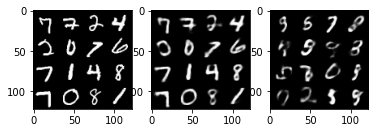

Iter: 39960/50000, Recon loss: 5257.3716, KL div loss: 1396.4097, Total loss: 6653.7812
Iter: 39970/50000, Recon loss: 5448.6240, KL div loss: 1403.6389, Total loss: 6852.2627
Iter: 39980/50000, Recon loss: 5340.2852, KL div loss: 1400.2261, Total loss: 6740.5112
Iter: 39990/50000, Recon loss: 5445.8525, KL div loss: 1421.1106, Total loss: 6866.9629
Iter: 40000/50000, Recon loss: 5424.1577, KL div loss: 1477.7610, Total loss: 6901.9189


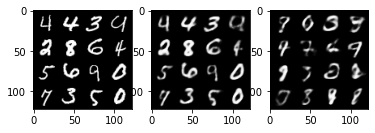

Iter: 40010/50000, Recon loss: 5168.3389, KL div loss: 1385.9857, Total loss: 6554.3247
Iter: 40020/50000, Recon loss: 5578.5791, KL div loss: 1418.8887, Total loss: 6997.4678
Iter: 40030/50000, Recon loss: 5492.8994, KL div loss: 1402.7251, Total loss: 6895.6245
Iter: 40040/50000, Recon loss: 5753.1475, KL div loss: 1441.5562, Total loss: 7194.7036
Iter: 40050/50000, Recon loss: 5134.1455, KL div loss: 1378.9977, Total loss: 6513.1431


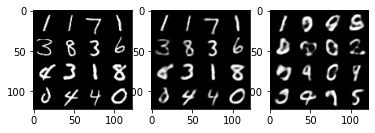

Iter: 40060/50000, Recon loss: 5428.4736, KL div loss: 1430.5566, Total loss: 6859.0303
Iter: 40070/50000, Recon loss: 5195.3403, KL div loss: 1424.9430, Total loss: 6620.2832
Iter: 40080/50000, Recon loss: 5422.0840, KL div loss: 1449.2598, Total loss: 6871.3438
Iter: 40090/50000, Recon loss: 5403.0801, KL div loss: 1448.6182, Total loss: 6851.6982
Iter: 40100/50000, Recon loss: 5247.5859, KL div loss: 1379.6787, Total loss: 6627.2646


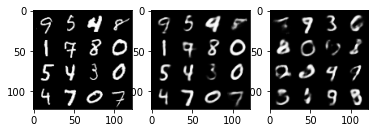

Iter: 40110/50000, Recon loss: 5729.8325, KL div loss: 1451.9874, Total loss: 7181.8198
Iter: 40120/50000, Recon loss: 5709.5918, KL div loss: 1387.1240, Total loss: 7096.7158
Iter: 40130/50000, Recon loss: 5531.8911, KL div loss: 1455.7997, Total loss: 6987.6909
Iter: 40140/50000, Recon loss: 5760.8740, KL div loss: 1470.1956, Total loss: 7231.0693
Iter: 40150/50000, Recon loss: 5530.8345, KL div loss: 1458.4940, Total loss: 6989.3286


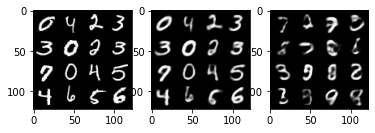

Iter: 40160/50000, Recon loss: 5422.3623, KL div loss: 1360.7885, Total loss: 6783.1509
Iter: 40170/50000, Recon loss: 5432.9346, KL div loss: 1409.7446, Total loss: 6842.6792
Iter: 40180/50000, Recon loss: 5598.3560, KL div loss: 1418.5525, Total loss: 7016.9082
Iter: 40190/50000, Recon loss: 5440.7300, KL div loss: 1442.3585, Total loss: 6883.0884
Iter: 40200/50000, Recon loss: 5298.6895, KL div loss: 1391.5190, Total loss: 6690.2085


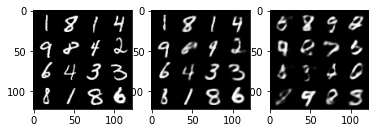

Iter: 40210/50000, Recon loss: 5497.0664, KL div loss: 1424.6193, Total loss: 6921.6855
Iter: 40220/50000, Recon loss: 5349.1226, KL div loss: 1366.2489, Total loss: 6715.3716
Iter: 40230/50000, Recon loss: 5601.0229, KL div loss: 1444.7793, Total loss: 7045.8022
Iter: 40240/50000, Recon loss: 4996.6470, KL div loss: 1368.6443, Total loss: 6365.2910
Iter: 40250/50000, Recon loss: 5212.7148, KL div loss: 1393.9882, Total loss: 6606.7031


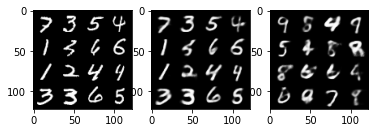

Iter: 40260/50000, Recon loss: 5470.5645, KL div loss: 1420.3921, Total loss: 6890.9565
Iter: 40270/50000, Recon loss: 5478.2490, KL div loss: 1427.1669, Total loss: 6905.4160
Iter: 40280/50000, Recon loss: 5506.6064, KL div loss: 1436.8311, Total loss: 6943.4375
Iter: 40290/50000, Recon loss: 5190.8008, KL div loss: 1361.7454, Total loss: 6552.5459
Iter: 40300/50000, Recon loss: 5464.6890, KL div loss: 1412.2291, Total loss: 6876.9180


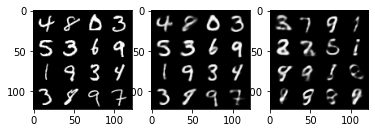

Iter: 40310/50000, Recon loss: 5191.7969, KL div loss: 1370.0879, Total loss: 6561.8848
Iter: 40320/50000, Recon loss: 5408.3418, KL div loss: 1429.0271, Total loss: 6837.3691
Iter: 40330/50000, Recon loss: 5267.8159, KL div loss: 1390.3364, Total loss: 6658.1523
Iter: 40340/50000, Recon loss: 5252.6299, KL div loss: 1363.4652, Total loss: 6616.0952
Iter: 40350/50000, Recon loss: 5170.7427, KL div loss: 1390.6400, Total loss: 6561.3828


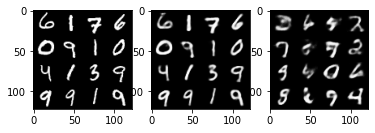

Iter: 40360/50000, Recon loss: 5551.1450, KL div loss: 1405.3674, Total loss: 6956.5127
Iter: 40370/50000, Recon loss: 5422.6553, KL div loss: 1385.4399, Total loss: 6808.0952
Iter: 40380/50000, Recon loss: 4988.1934, KL div loss: 1378.8060, Total loss: 6366.9995
Iter: 40390/50000, Recon loss: 5476.2593, KL div loss: 1452.6648, Total loss: 6928.9238
Iter: 40400/50000, Recon loss: 5472.0137, KL div loss: 1382.9373, Total loss: 6854.9512


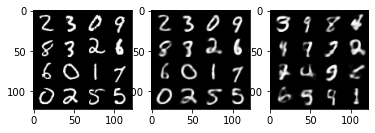

Iter: 40410/50000, Recon loss: 5210.7490, KL div loss: 1400.6516, Total loss: 6611.4004
Iter: 40420/50000, Recon loss: 5573.1221, KL div loss: 1411.4413, Total loss: 6984.5635
Iter: 40430/50000, Recon loss: 5460.7104, KL div loss: 1387.9785, Total loss: 6848.6890
Iter: 40440/50000, Recon loss: 5249.9507, KL div loss: 1397.6211, Total loss: 6647.5718
Iter: 40450/50000, Recon loss: 5240.1270, KL div loss: 1405.5717, Total loss: 6645.6987


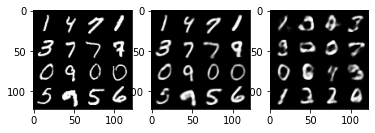

Iter: 40460/50000, Recon loss: 5317.3257, KL div loss: 1409.8179, Total loss: 6727.1436
Iter: 40470/50000, Recon loss: 6038.2158, KL div loss: 1496.0049, Total loss: 7534.2207
Iter: 40480/50000, Recon loss: 5057.1104, KL div loss: 1369.1235, Total loss: 6426.2339
Iter: 40490/50000, Recon loss: 5493.7197, KL div loss: 1413.0494, Total loss: 6906.7690
Iter: 40500/50000, Recon loss: 5427.1182, KL div loss: 1416.8982, Total loss: 6844.0166


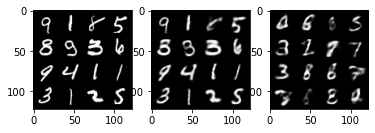

Iter: 40510/50000, Recon loss: 5882.4932, KL div loss: 1446.9436, Total loss: 7329.4365
Iter: 40520/50000, Recon loss: 5440.5068, KL div loss: 1412.3783, Total loss: 6852.8853
Iter: 40530/50000, Recon loss: 5106.4897, KL div loss: 1389.6558, Total loss: 6496.1455
Iter: 40540/50000, Recon loss: 5540.2295, KL div loss: 1401.7236, Total loss: 6941.9531
Iter: 40550/50000, Recon loss: 5248.6030, KL div loss: 1431.8918, Total loss: 6680.4951


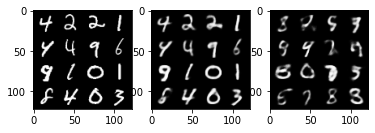

Iter: 40560/50000, Recon loss: 5298.7295, KL div loss: 1422.2451, Total loss: 6720.9746
Iter: 40570/50000, Recon loss: 5307.9482, KL div loss: 1408.9181, Total loss: 6716.8662
Iter: 40580/50000, Recon loss: 5556.7090, KL div loss: 1377.6887, Total loss: 6934.3975
Iter: 40590/50000, Recon loss: 5129.2900, KL div loss: 1368.4617, Total loss: 6497.7520
Iter: 40600/50000, Recon loss: 5409.6255, KL div loss: 1422.6995, Total loss: 6832.3252


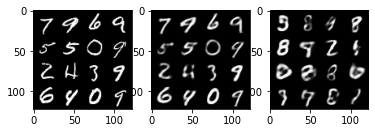

Iter: 40610/50000, Recon loss: 5499.7461, KL div loss: 1406.5635, Total loss: 6906.3096
Iter: 40620/50000, Recon loss: 4996.7100, KL div loss: 1389.1299, Total loss: 6385.8398
Iter: 40630/50000, Recon loss: 5400.8438, KL div loss: 1447.6119, Total loss: 6848.4556
Iter: 40640/50000, Recon loss: 5398.3638, KL div loss: 1329.3655, Total loss: 6727.7295
Iter: 40650/50000, Recon loss: 5386.4556, KL div loss: 1405.0085, Total loss: 6791.4639


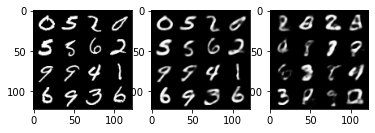

Iter: 40660/50000, Recon loss: 5471.4971, KL div loss: 1446.7389, Total loss: 6918.2358
Iter: 40670/50000, Recon loss: 5537.4131, KL div loss: 1407.4753, Total loss: 6944.8887
Iter: 40680/50000, Recon loss: 5636.5645, KL div loss: 1463.6198, Total loss: 7100.1841
Iter: 40690/50000, Recon loss: 5112.3403, KL div loss: 1382.8381, Total loss: 6495.1787
Iter: 40700/50000, Recon loss: 5382.4521, KL div loss: 1473.8704, Total loss: 6856.3223


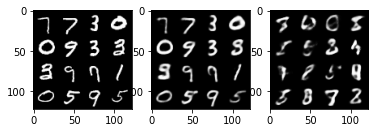

Iter: 40710/50000, Recon loss: 5119.6855, KL div loss: 1384.2140, Total loss: 6503.8994
Iter: 40720/50000, Recon loss: 5402.9702, KL div loss: 1393.8557, Total loss: 6796.8262
Iter: 40730/50000, Recon loss: 5387.9639, KL div loss: 1428.0459, Total loss: 6816.0098
Iter: 40740/50000, Recon loss: 5421.8867, KL div loss: 1425.8904, Total loss: 6847.7773
Iter: 40750/50000, Recon loss: 5405.4834, KL div loss: 1444.8353, Total loss: 6850.3188


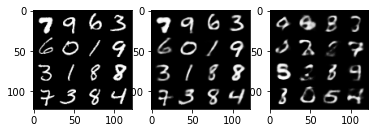

Iter: 40760/50000, Recon loss: 5448.7847, KL div loss: 1428.4700, Total loss: 6877.2549
Iter: 40770/50000, Recon loss: 5355.0977, KL div loss: 1415.1221, Total loss: 6770.2197
Iter: 40780/50000, Recon loss: 5684.3257, KL div loss: 1430.0486, Total loss: 7114.3740
Iter: 40790/50000, Recon loss: 5489.2349, KL div loss: 1444.7863, Total loss: 6934.0210
Iter: 40800/50000, Recon loss: 5292.4888, KL div loss: 1405.1179, Total loss: 6697.6064


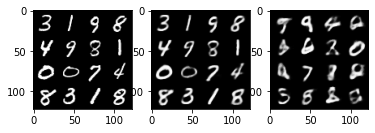

Iter: 40810/50000, Recon loss: 5338.7700, KL div loss: 1395.4988, Total loss: 6734.2686
Iter: 40820/50000, Recon loss: 5522.0439, KL div loss: 1411.2302, Total loss: 6933.2744
Iter: 40830/50000, Recon loss: 5463.1367, KL div loss: 1419.3600, Total loss: 6882.4966
Iter: 40840/50000, Recon loss: 5553.2261, KL div loss: 1451.6230, Total loss: 7004.8491
Iter: 40850/50000, Recon loss: 5530.9375, KL div loss: 1383.0537, Total loss: 6913.9912


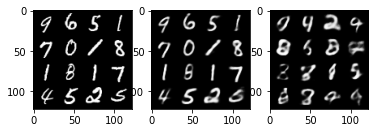

Iter: 40860/50000, Recon loss: 5797.7100, KL div loss: 1450.8425, Total loss: 7248.5527
Iter: 40870/50000, Recon loss: 5328.7051, KL div loss: 1405.1560, Total loss: 6733.8613
Iter: 40880/50000, Recon loss: 5650.5103, KL div loss: 1436.5928, Total loss: 7087.1030
Iter: 40890/50000, Recon loss: 5433.2139, KL div loss: 1420.6504, Total loss: 6853.8643
Iter: 40900/50000, Recon loss: 5555.5918, KL div loss: 1448.8624, Total loss: 7004.4541


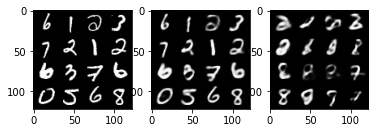

Iter: 40910/50000, Recon loss: 5397.0488, KL div loss: 1393.6345, Total loss: 6790.6836
Iter: 40920/50000, Recon loss: 5332.0479, KL div loss: 1415.9675, Total loss: 6748.0156
Iter: 40930/50000, Recon loss: 5550.9756, KL div loss: 1377.1711, Total loss: 6928.1465
Iter: 40940/50000, Recon loss: 5351.7471, KL div loss: 1399.4037, Total loss: 6751.1509
Iter: 40950/50000, Recon loss: 5413.3101, KL div loss: 1396.5295, Total loss: 6809.8398


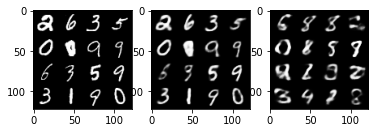

Iter: 40960/50000, Recon loss: 5633.4834, KL div loss: 1482.6801, Total loss: 7116.1636
Iter: 40970/50000, Recon loss: 5231.7666, KL div loss: 1392.9231, Total loss: 6624.6895
Iter: 40980/50000, Recon loss: 5636.7070, KL div loss: 1481.3441, Total loss: 7118.0513
Iter: 40990/50000, Recon loss: 5360.2676, KL div loss: 1417.1011, Total loss: 6777.3687
Iter: 41000/50000, Recon loss: 5774.2090, KL div loss: 1487.7086, Total loss: 7261.9175


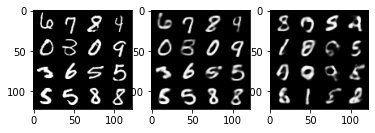

Iter: 41010/50000, Recon loss: 5355.5010, KL div loss: 1385.9521, Total loss: 6741.4531
Iter: 41020/50000, Recon loss: 5085.9297, KL div loss: 1339.4518, Total loss: 6425.3813
Iter: 41030/50000, Recon loss: 5110.6758, KL div loss: 1413.6772, Total loss: 6524.3530
Iter: 41040/50000, Recon loss: 5423.2124, KL div loss: 1412.6666, Total loss: 6835.8789
Iter: 41050/50000, Recon loss: 5790.4111, KL div loss: 1458.5789, Total loss: 7248.9902


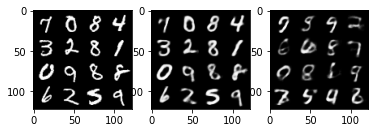

Iter: 41060/50000, Recon loss: 5219.1104, KL div loss: 1419.2561, Total loss: 6638.3662
Iter: 41070/50000, Recon loss: 5395.4824, KL div loss: 1400.6226, Total loss: 6796.1050
Iter: 41080/50000, Recon loss: 5780.7246, KL div loss: 1410.5894, Total loss: 7191.3140
Iter: 41090/50000, Recon loss: 5315.1934, KL div loss: 1384.9370, Total loss: 6700.1304
Iter: 41100/50000, Recon loss: 5285.5679, KL div loss: 1397.0530, Total loss: 6682.6211


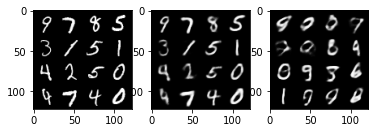

Iter: 41110/50000, Recon loss: 5637.0122, KL div loss: 1395.3186, Total loss: 7032.3311
Iter: 41120/50000, Recon loss: 5040.4312, KL div loss: 1416.7957, Total loss: 6457.2266
Iter: 41130/50000, Recon loss: 5075.8125, KL div loss: 1380.8218, Total loss: 6456.6343
Iter: 41140/50000, Recon loss: 5661.8618, KL div loss: 1451.1389, Total loss: 7113.0010
Iter: 41150/50000, Recon loss: 5760.6504, KL div loss: 1433.2345, Total loss: 7193.8848


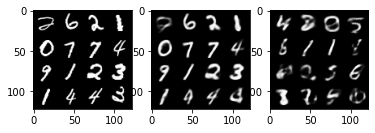

Iter: 41160/50000, Recon loss: 5659.3770, KL div loss: 1514.8713, Total loss: 7174.2480
Iter: 41170/50000, Recon loss: 5256.0513, KL div loss: 1384.0895, Total loss: 6640.1406
Iter: 41180/50000, Recon loss: 5399.6240, KL div loss: 1433.6545, Total loss: 6833.2783
Iter: 41190/50000, Recon loss: 5323.3589, KL div loss: 1421.1724, Total loss: 6744.5312
Iter: 41200/50000, Recon loss: 5576.2832, KL div loss: 1440.6921, Total loss: 7016.9756


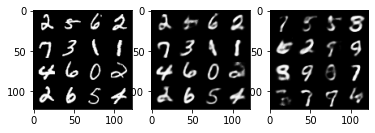

Iter: 41210/50000, Recon loss: 5468.6777, KL div loss: 1412.0422, Total loss: 6880.7197
Iter: 41220/50000, Recon loss: 5546.8994, KL div loss: 1424.3040, Total loss: 6971.2031
Iter: 41230/50000, Recon loss: 5549.7139, KL div loss: 1462.1002, Total loss: 7011.8140
Iter: 41240/50000, Recon loss: 5203.9722, KL div loss: 1411.6035, Total loss: 6615.5757
Iter: 41250/50000, Recon loss: 5428.3105, KL div loss: 1384.4615, Total loss: 6812.7720


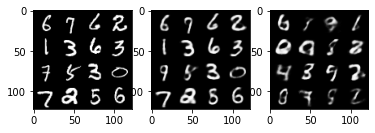

Iter: 41260/50000, Recon loss: 5447.0015, KL div loss: 1378.4165, Total loss: 6825.4180
Iter: 41270/50000, Recon loss: 5220.1465, KL div loss: 1419.1855, Total loss: 6639.3320
Iter: 41280/50000, Recon loss: 5540.1167, KL div loss: 1449.9373, Total loss: 6990.0537
Iter: 41290/50000, Recon loss: 5341.8486, KL div loss: 1456.1464, Total loss: 6797.9951
Iter: 41300/50000, Recon loss: 5372.8252, KL div loss: 1385.8567, Total loss: 6758.6816


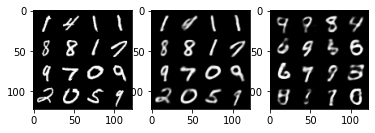

Iter: 41310/50000, Recon loss: 5335.2588, KL div loss: 1410.7400, Total loss: 6745.9990
Iter: 41320/50000, Recon loss: 5041.7607, KL div loss: 1359.2189, Total loss: 6400.9795
Iter: 41330/50000, Recon loss: 5131.2148, KL div loss: 1427.7913, Total loss: 6559.0059
Iter: 41340/50000, Recon loss: 5423.8530, KL div loss: 1441.3864, Total loss: 6865.2393
Iter: 41350/50000, Recon loss: 5540.0908, KL div loss: 1424.8755, Total loss: 6964.9663


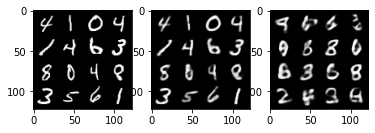

Iter: 41360/50000, Recon loss: 5575.6699, KL div loss: 1405.2521, Total loss: 6980.9219
Iter: 41370/50000, Recon loss: 5704.4727, KL div loss: 1452.3921, Total loss: 7156.8647
Iter: 41380/50000, Recon loss: 5281.6958, KL div loss: 1400.4288, Total loss: 6682.1245
Iter: 41390/50000, Recon loss: 5322.8286, KL div loss: 1424.0415, Total loss: 6746.8701
Iter: 41400/50000, Recon loss: 5068.0444, KL div loss: 1360.2988, Total loss: 6428.3433


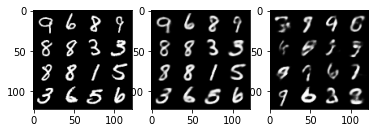

Iter: 41410/50000, Recon loss: 5577.2939, KL div loss: 1409.1375, Total loss: 6986.4316
Iter: 41420/50000, Recon loss: 5514.0254, KL div loss: 1467.2365, Total loss: 6981.2617
Iter: 41430/50000, Recon loss: 5240.3027, KL div loss: 1361.5103, Total loss: 6601.8130
Iter: 41440/50000, Recon loss: 5224.8857, KL div loss: 1373.8854, Total loss: 6598.7710
Iter: 41450/50000, Recon loss: 5252.0908, KL div loss: 1419.3513, Total loss: 6671.4424


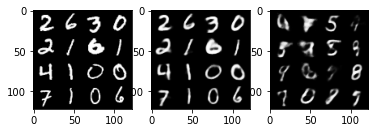

Iter: 41460/50000, Recon loss: 5494.4287, KL div loss: 1421.6687, Total loss: 6916.0977
Iter: 41470/50000, Recon loss: 5322.4619, KL div loss: 1413.9329, Total loss: 6736.3945
Iter: 41480/50000, Recon loss: 5359.2197, KL div loss: 1463.6216, Total loss: 6822.8413
Iter: 41490/50000, Recon loss: 5453.7080, KL div loss: 1407.4282, Total loss: 6861.1362
Iter: 41500/50000, Recon loss: 5795.3672, KL div loss: 1441.2472, Total loss: 7236.6143


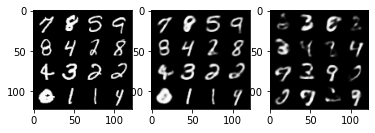

Iter: 41510/50000, Recon loss: 5595.2646, KL div loss: 1482.6108, Total loss: 7077.8755
Iter: 41520/50000, Recon loss: 5432.7754, KL div loss: 1388.4917, Total loss: 6821.2671
Iter: 41530/50000, Recon loss: 5354.0732, KL div loss: 1370.2998, Total loss: 6724.3730
Iter: 41540/50000, Recon loss: 5288.8818, KL div loss: 1400.5801, Total loss: 6689.4619
Iter: 41550/50000, Recon loss: 5348.6519, KL div loss: 1374.0562, Total loss: 6722.7080


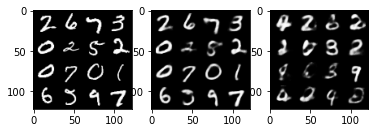

Iter: 41560/50000, Recon loss: 5386.6133, KL div loss: 1486.3699, Total loss: 6872.9834
Iter: 41570/50000, Recon loss: 5580.5889, KL div loss: 1455.8792, Total loss: 7036.4678
Iter: 41580/50000, Recon loss: 5385.9438, KL div loss: 1357.4583, Total loss: 6743.4023
Iter: 41590/50000, Recon loss: 5546.8936, KL div loss: 1468.3157, Total loss: 7015.2090
Iter: 41600/50000, Recon loss: 5183.2734, KL div loss: 1365.0321, Total loss: 6548.3057


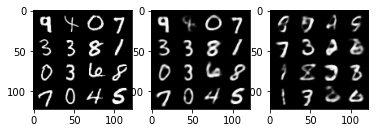

Iter: 41610/50000, Recon loss: 5261.5024, KL div loss: 1394.3043, Total loss: 6655.8066
Iter: 41620/50000, Recon loss: 5702.3037, KL div loss: 1447.7373, Total loss: 7150.0410
Iter: 41630/50000, Recon loss: 5314.8101, KL div loss: 1415.8967, Total loss: 6730.7070
Iter: 41640/50000, Recon loss: 5379.7900, KL div loss: 1448.0476, Total loss: 6827.8379
Iter: 41650/50000, Recon loss: 5511.9971, KL div loss: 1419.0757, Total loss: 6931.0728


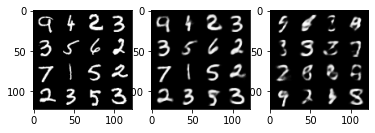

Iter: 41660/50000, Recon loss: 5123.1729, KL div loss: 1348.6130, Total loss: 6471.7861
Iter: 41670/50000, Recon loss: 5238.1113, KL div loss: 1399.0369, Total loss: 6637.1484
Iter: 41680/50000, Recon loss: 5223.1777, KL div loss: 1428.8254, Total loss: 6652.0029
Iter: 41690/50000, Recon loss: 5319.4741, KL div loss: 1398.7437, Total loss: 6718.2178
Iter: 41700/50000, Recon loss: 5214.7715, KL div loss: 1420.6340, Total loss: 6635.4053


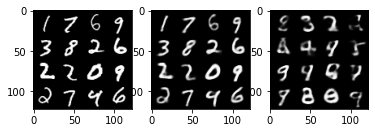

Iter: 41710/50000, Recon loss: 5306.2314, KL div loss: 1436.0725, Total loss: 6742.3037
Iter: 41720/50000, Recon loss: 5498.8677, KL div loss: 1442.3451, Total loss: 6941.2129
Iter: 41730/50000, Recon loss: 5301.0244, KL div loss: 1416.7886, Total loss: 6717.8130
Iter: 41740/50000, Recon loss: 5273.9316, KL div loss: 1376.4393, Total loss: 6650.3711
Iter: 41750/50000, Recon loss: 5442.6938, KL div loss: 1437.3542, Total loss: 6880.0479


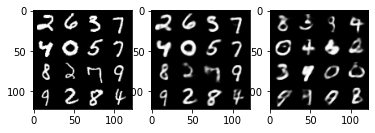

Iter: 41760/50000, Recon loss: 5448.7676, KL div loss: 1438.9025, Total loss: 6887.6699
Iter: 41770/50000, Recon loss: 5437.1279, KL div loss: 1383.3549, Total loss: 6820.4829
Iter: 41780/50000, Recon loss: 5585.8970, KL div loss: 1456.0840, Total loss: 7041.9810
Iter: 41790/50000, Recon loss: 5749.1396, KL div loss: 1439.8036, Total loss: 7188.9434
Iter: 41800/50000, Recon loss: 5371.2305, KL div loss: 1371.8014, Total loss: 6743.0317


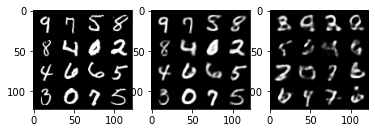

Iter: 41810/50000, Recon loss: 5282.9253, KL div loss: 1431.2241, Total loss: 6714.1494
Iter: 41820/50000, Recon loss: 5099.8330, KL div loss: 1409.5781, Total loss: 6509.4111
Iter: 41830/50000, Recon loss: 5137.1670, KL div loss: 1423.7122, Total loss: 6560.8789
Iter: 41840/50000, Recon loss: 5483.7041, KL div loss: 1437.0721, Total loss: 6920.7764
Iter: 41850/50000, Recon loss: 5217.0400, KL div loss: 1399.1781, Total loss: 6616.2183


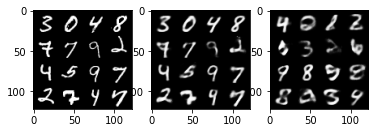

Iter: 41860/50000, Recon loss: 5604.1182, KL div loss: 1458.6099, Total loss: 7062.7280
Iter: 41870/50000, Recon loss: 5355.1704, KL div loss: 1417.6968, Total loss: 6772.8672
Iter: 41880/50000, Recon loss: 5384.6777, KL div loss: 1385.5151, Total loss: 6770.1929
Iter: 41890/50000, Recon loss: 5304.5078, KL div loss: 1382.8307, Total loss: 6687.3384
Iter: 41900/50000, Recon loss: 4898.2686, KL div loss: 1427.4865, Total loss: 6325.7549


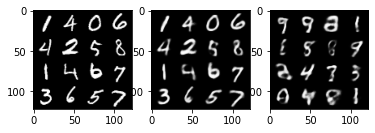

Iter: 41910/50000, Recon loss: 5490.0322, KL div loss: 1421.2814, Total loss: 6911.3135
Iter: 41920/50000, Recon loss: 5243.4521, KL div loss: 1404.7534, Total loss: 6648.2056
Iter: 41930/50000, Recon loss: 5589.5049, KL div loss: 1394.5197, Total loss: 6984.0244
Iter: 41940/50000, Recon loss: 5186.0601, KL div loss: 1396.6497, Total loss: 6582.7100
Iter: 41950/50000, Recon loss: 5059.7476, KL div loss: 1391.5070, Total loss: 6451.2544


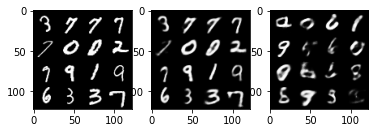

Iter: 41960/50000, Recon loss: 5249.6577, KL div loss: 1408.4219, Total loss: 6658.0796
Iter: 41970/50000, Recon loss: 5581.5210, KL div loss: 1397.0776, Total loss: 6978.5986
Iter: 41980/50000, Recon loss: 5575.6226, KL div loss: 1450.5244, Total loss: 7026.1470
Iter: 41990/50000, Recon loss: 5728.3379, KL div loss: 1455.4138, Total loss: 7183.7520
Iter: 42000/50000, Recon loss: 5216.0566, KL div loss: 1359.5934, Total loss: 6575.6499


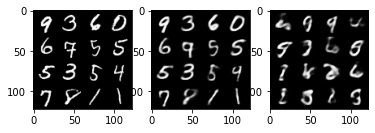

Iter: 42010/50000, Recon loss: 5873.2969, KL div loss: 1493.8325, Total loss: 7367.1294
Iter: 42020/50000, Recon loss: 5252.8564, KL div loss: 1420.3926, Total loss: 6673.2490
Iter: 42030/50000, Recon loss: 5811.0581, KL div loss: 1459.4617, Total loss: 7270.5195
Iter: 42040/50000, Recon loss: 5468.4238, KL div loss: 1456.2393, Total loss: 6924.6631
Iter: 42050/50000, Recon loss: 5495.4053, KL div loss: 1444.9783, Total loss: 6940.3838


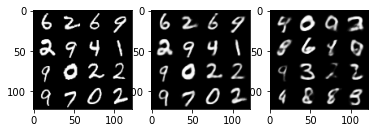

Iter: 42060/50000, Recon loss: 5357.9199, KL div loss: 1440.4482, Total loss: 6798.3682
Iter: 42070/50000, Recon loss: 5388.4541, KL div loss: 1411.8889, Total loss: 6800.3428
Iter: 42080/50000, Recon loss: 5393.0254, KL div loss: 1400.8096, Total loss: 6793.8350
Iter: 42090/50000, Recon loss: 5733.8022, KL div loss: 1443.9832, Total loss: 7177.7852
Iter: 42100/50000, Recon loss: 5498.9854, KL div loss: 1411.1276, Total loss: 6910.1128


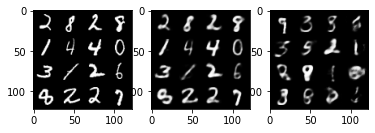

Iter: 42110/50000, Recon loss: 5463.9189, KL div loss: 1469.2114, Total loss: 6933.1304
Iter: 42120/50000, Recon loss: 5624.4482, KL div loss: 1477.7332, Total loss: 7102.1816
Iter: 42130/50000, Recon loss: 5060.6636, KL div loss: 1380.5046, Total loss: 6441.1680
Iter: 42140/50000, Recon loss: 5588.9355, KL div loss: 1426.7347, Total loss: 7015.6704
Iter: 42150/50000, Recon loss: 5336.6626, KL div loss: 1390.8674, Total loss: 6727.5303


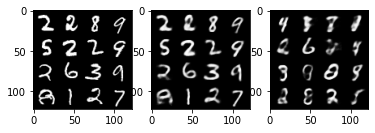

Iter: 42160/50000, Recon loss: 5328.9062, KL div loss: 1391.8307, Total loss: 6720.7368
Iter: 42170/50000, Recon loss: 5465.9131, KL div loss: 1436.3130, Total loss: 6902.2261
Iter: 42180/50000, Recon loss: 5640.9370, KL div loss: 1432.7874, Total loss: 7073.7246
Iter: 42190/50000, Recon loss: 5530.4478, KL div loss: 1453.6899, Total loss: 6984.1377
Iter: 42200/50000, Recon loss: 4991.3193, KL div loss: 1355.8748, Total loss: 6347.1943


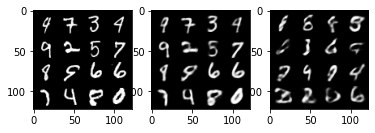

Iter: 42210/50000, Recon loss: 5359.4111, KL div loss: 1403.2986, Total loss: 6762.7100
Iter: 42220/50000, Recon loss: 5092.7109, KL div loss: 1419.0709, Total loss: 6511.7817
Iter: 42230/50000, Recon loss: 5221.8232, KL div loss: 1388.8579, Total loss: 6610.6812
Iter: 42240/50000, Recon loss: 5613.6094, KL div loss: 1418.9203, Total loss: 7032.5298
Iter: 42250/50000, Recon loss: 5276.3350, KL div loss: 1403.5339, Total loss: 6679.8691


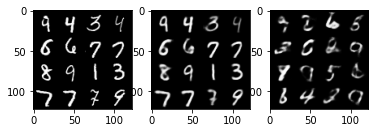

Iter: 42260/50000, Recon loss: 5117.8574, KL div loss: 1378.2932, Total loss: 6496.1504
Iter: 42270/50000, Recon loss: 5182.4233, KL div loss: 1410.2755, Total loss: 6592.6987
Iter: 42280/50000, Recon loss: 5169.4810, KL div loss: 1467.3744, Total loss: 6636.8555
Iter: 42290/50000, Recon loss: 5539.0215, KL div loss: 1412.2333, Total loss: 6951.2549
Iter: 42300/50000, Recon loss: 5553.2041, KL div loss: 1460.7977, Total loss: 7014.0020


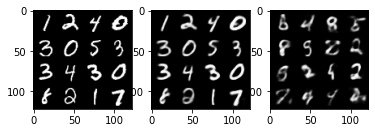

Iter: 42310/50000, Recon loss: 5318.5366, KL div loss: 1421.7791, Total loss: 6740.3154
Iter: 42320/50000, Recon loss: 5572.5566, KL div loss: 1438.5767, Total loss: 7011.1333
Iter: 42330/50000, Recon loss: 5122.1162, KL div loss: 1373.7964, Total loss: 6495.9126
Iter: 42340/50000, Recon loss: 5131.9307, KL div loss: 1404.7344, Total loss: 6536.6650
Iter: 42350/50000, Recon loss: 4997.2305, KL div loss: 1399.4014, Total loss: 6396.6318


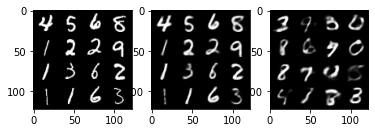

Iter: 42360/50000, Recon loss: 5147.1846, KL div loss: 1392.7485, Total loss: 6539.9331
Iter: 42370/50000, Recon loss: 5317.2642, KL div loss: 1413.8096, Total loss: 6731.0737
Iter: 42380/50000, Recon loss: 5193.2881, KL div loss: 1409.3812, Total loss: 6602.6694
Iter: 42390/50000, Recon loss: 5530.5312, KL div loss: 1444.0254, Total loss: 6974.5566
Iter: 42400/50000, Recon loss: 5542.3691, KL div loss: 1468.6791, Total loss: 7011.0483


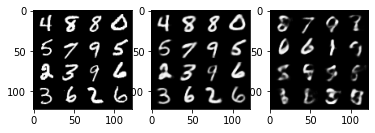

Iter: 42410/50000, Recon loss: 5407.9438, KL div loss: 1457.4033, Total loss: 6865.3472
Iter: 42420/50000, Recon loss: 5205.4146, KL div loss: 1392.1183, Total loss: 6597.5327
Iter: 42430/50000, Recon loss: 5265.7041, KL div loss: 1390.8042, Total loss: 6656.5083
Iter: 42440/50000, Recon loss: 5474.9424, KL div loss: 1431.2021, Total loss: 6906.1445
Iter: 42450/50000, Recon loss: 5270.4307, KL div loss: 1382.0007, Total loss: 6652.4316


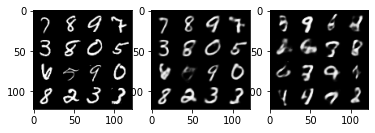

Iter: 42460/50000, Recon loss: 5560.8135, KL div loss: 1459.8308, Total loss: 7020.6445
Iter: 42470/50000, Recon loss: 5135.8174, KL div loss: 1338.0833, Total loss: 6473.9004
Iter: 42480/50000, Recon loss: 5306.8364, KL div loss: 1424.6206, Total loss: 6731.4570
Iter: 42490/50000, Recon loss: 5103.7822, KL div loss: 1402.0172, Total loss: 6505.7993
Iter: 42500/50000, Recon loss: 5020.9385, KL div loss: 1375.4541, Total loss: 6396.3926


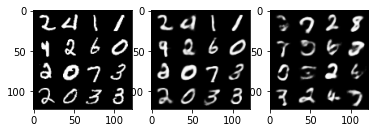

Iter: 42510/50000, Recon loss: 5362.4531, KL div loss: 1388.9207, Total loss: 6751.3740
Iter: 42520/50000, Recon loss: 5440.2197, KL div loss: 1483.9918, Total loss: 6924.2114
Iter: 42530/50000, Recon loss: 5265.2490, KL div loss: 1444.8030, Total loss: 6710.0518
Iter: 42540/50000, Recon loss: 5570.9365, KL div loss: 1478.4453, Total loss: 7049.3818
Iter: 42550/50000, Recon loss: 5804.1484, KL div loss: 1472.0812, Total loss: 7276.2295


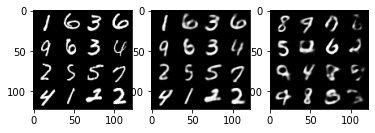

Iter: 42560/50000, Recon loss: 5011.7236, KL div loss: 1399.4756, Total loss: 6411.1992
Iter: 42570/50000, Recon loss: 5286.6479, KL div loss: 1365.4633, Total loss: 6652.1113
Iter: 42580/50000, Recon loss: 5150.7217, KL div loss: 1359.1880, Total loss: 6509.9097
Iter: 42590/50000, Recon loss: 5540.0005, KL div loss: 1441.8750, Total loss: 6981.8755
Iter: 42600/50000, Recon loss: 5184.6655, KL div loss: 1426.8063, Total loss: 6611.4717


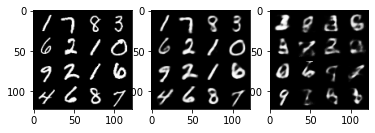

Iter: 42610/50000, Recon loss: 5290.1113, KL div loss: 1405.8374, Total loss: 6695.9487
Iter: 42620/50000, Recon loss: 5426.2500, KL div loss: 1426.4487, Total loss: 6852.6987
Iter: 42630/50000, Recon loss: 5190.8721, KL div loss: 1445.0737, Total loss: 6635.9458
Iter: 42640/50000, Recon loss: 5517.8062, KL div loss: 1385.2330, Total loss: 6903.0391
Iter: 42650/50000, Recon loss: 5398.1641, KL div loss: 1381.2323, Total loss: 6779.3965


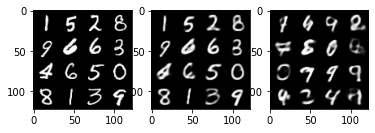

Iter: 42660/50000, Recon loss: 5430.2236, KL div loss: 1385.5125, Total loss: 6815.7363
Iter: 42670/50000, Recon loss: 5533.8799, KL div loss: 1410.6003, Total loss: 6944.4805
Iter: 42680/50000, Recon loss: 5487.1592, KL div loss: 1426.9904, Total loss: 6914.1494
Iter: 42690/50000, Recon loss: 5306.2178, KL div loss: 1410.0121, Total loss: 6716.2300
Iter: 42700/50000, Recon loss: 5436.0010, KL div loss: 1416.8561, Total loss: 6852.8569


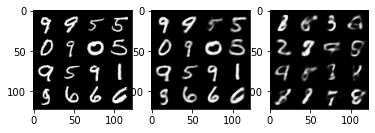

Iter: 42710/50000, Recon loss: 5310.7637, KL div loss: 1421.1604, Total loss: 6731.9238
Iter: 42720/50000, Recon loss: 5575.4717, KL div loss: 1412.3982, Total loss: 6987.8701
Iter: 42730/50000, Recon loss: 5278.3657, KL div loss: 1486.6765, Total loss: 6765.0420
Iter: 42740/50000, Recon loss: 5579.5796, KL div loss: 1407.8793, Total loss: 6987.4590
Iter: 42750/50000, Recon loss: 5271.8223, KL div loss: 1375.3201, Total loss: 6647.1426


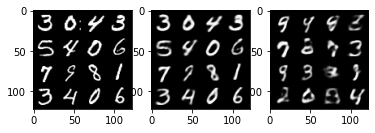

Iter: 42760/50000, Recon loss: 5130.2388, KL div loss: 1423.6099, Total loss: 6553.8486
Iter: 42770/50000, Recon loss: 5423.1885, KL div loss: 1435.7158, Total loss: 6858.9043
Iter: 42780/50000, Recon loss: 5237.9170, KL div loss: 1411.3292, Total loss: 6649.2461
Iter: 42790/50000, Recon loss: 4971.7007, KL div loss: 1419.6531, Total loss: 6391.3535
Iter: 42800/50000, Recon loss: 5216.0791, KL div loss: 1401.6801, Total loss: 6617.7593


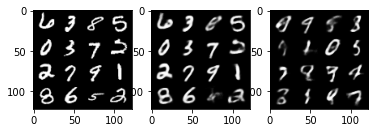

Iter: 42810/50000, Recon loss: 5417.3105, KL div loss: 1413.8154, Total loss: 6831.1260
Iter: 42820/50000, Recon loss: 5312.2808, KL div loss: 1415.5530, Total loss: 6727.8340
Iter: 42830/50000, Recon loss: 5305.1318, KL div loss: 1402.6792, Total loss: 6707.8110
Iter: 42840/50000, Recon loss: 5250.5415, KL div loss: 1424.3618, Total loss: 6674.9033
Iter: 42850/50000, Recon loss: 5519.3906, KL div loss: 1457.4011, Total loss: 6976.7920


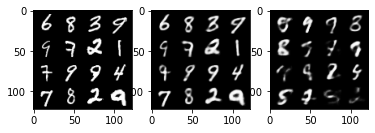

Iter: 42860/50000, Recon loss: 5433.8105, KL div loss: 1436.1310, Total loss: 6869.9414
Iter: 42870/50000, Recon loss: 5046.9932, KL div loss: 1407.4646, Total loss: 6454.4580
Iter: 42880/50000, Recon loss: 5261.5049, KL div loss: 1425.9694, Total loss: 6687.4741
Iter: 42890/50000, Recon loss: 5357.0078, KL div loss: 1420.4142, Total loss: 6777.4219
Iter: 42900/50000, Recon loss: 5365.3027, KL div loss: 1443.3767, Total loss: 6808.6797


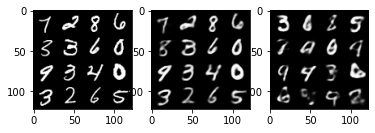

Iter: 42910/50000, Recon loss: 5462.4390, KL div loss: 1447.4768, Total loss: 6909.9160
Iter: 42920/50000, Recon loss: 5286.7559, KL div loss: 1421.3871, Total loss: 6708.1431
Iter: 42930/50000, Recon loss: 5272.4634, KL div loss: 1419.6304, Total loss: 6692.0938
Iter: 42940/50000, Recon loss: 5467.7759, KL div loss: 1438.5947, Total loss: 6906.3706
Iter: 42950/50000, Recon loss: 5510.5454, KL div loss: 1453.1044, Total loss: 6963.6499


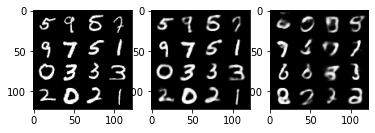

Iter: 42960/50000, Recon loss: 5237.2603, KL div loss: 1404.7109, Total loss: 6641.9712
Iter: 42970/50000, Recon loss: 5831.8086, KL div loss: 1515.8256, Total loss: 7347.6343
Iter: 42980/50000, Recon loss: 5502.9028, KL div loss: 1406.2864, Total loss: 6909.1895
Iter: 42990/50000, Recon loss: 5584.5947, KL div loss: 1444.7092, Total loss: 7029.3037
Iter: 43000/50000, Recon loss: 5044.7588, KL div loss: 1359.0547, Total loss: 6403.8135


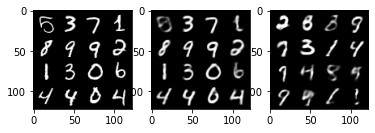

Iter: 43010/50000, Recon loss: 5514.5674, KL div loss: 1440.7869, Total loss: 6955.3545
Iter: 43020/50000, Recon loss: 5449.6235, KL div loss: 1424.4370, Total loss: 6874.0605
Iter: 43030/50000, Recon loss: 5464.8594, KL div loss: 1445.2803, Total loss: 6910.1396
Iter: 43040/50000, Recon loss: 5260.4155, KL div loss: 1348.1483, Total loss: 6608.5640
Iter: 43050/50000, Recon loss: 5559.5557, KL div loss: 1402.1655, Total loss: 6961.7212


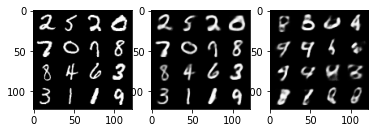

Iter: 43060/50000, Recon loss: 5507.0151, KL div loss: 1398.3888, Total loss: 6905.4038
Iter: 43070/50000, Recon loss: 5588.4697, KL div loss: 1457.7502, Total loss: 7046.2197
Iter: 43080/50000, Recon loss: 5067.3657, KL div loss: 1391.1334, Total loss: 6458.4990
Iter: 43090/50000, Recon loss: 5587.5303, KL div loss: 1466.6886, Total loss: 7054.2188
Iter: 43100/50000, Recon loss: 5394.9570, KL div loss: 1431.5505, Total loss: 6826.5078


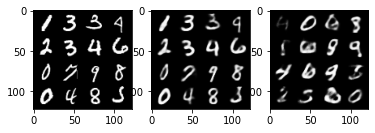

Iter: 43110/50000, Recon loss: 5337.1201, KL div loss: 1401.2970, Total loss: 6738.4170
Iter: 43120/50000, Recon loss: 5168.7432, KL div loss: 1391.3258, Total loss: 6560.0688
Iter: 43130/50000, Recon loss: 5239.4683, KL div loss: 1395.5746, Total loss: 6635.0430
Iter: 43140/50000, Recon loss: 5392.9541, KL div loss: 1409.0408, Total loss: 6801.9951
Iter: 43150/50000, Recon loss: 5139.3018, KL div loss: 1424.9814, Total loss: 6564.2832


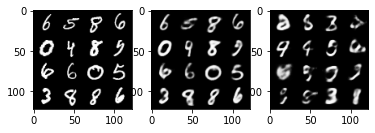

Iter: 43160/50000, Recon loss: 5435.5952, KL div loss: 1454.8596, Total loss: 6890.4551
Iter: 43170/50000, Recon loss: 5456.5479, KL div loss: 1433.5498, Total loss: 6890.0977
Iter: 43180/50000, Recon loss: 5156.1304, KL div loss: 1414.6279, Total loss: 6570.7583
Iter: 43190/50000, Recon loss: 5209.1807, KL div loss: 1436.7922, Total loss: 6645.9727
Iter: 43200/50000, Recon loss: 5465.8237, KL div loss: 1380.5850, Total loss: 6846.4087


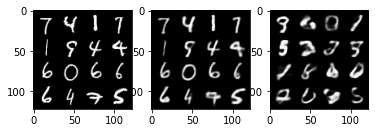

Iter: 43210/50000, Recon loss: 5237.3770, KL div loss: 1407.3560, Total loss: 6644.7329
Iter: 43220/50000, Recon loss: 5477.1069, KL div loss: 1455.7373, Total loss: 6932.8442
Iter: 43230/50000, Recon loss: 5032.2422, KL div loss: 1366.8276, Total loss: 6399.0698
Iter: 43240/50000, Recon loss: 5689.4351, KL div loss: 1412.9966, Total loss: 7102.4316
Iter: 43250/50000, Recon loss: 5422.9819, KL div loss: 1408.7003, Total loss: 6831.6821


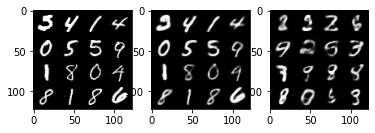

Iter: 43260/50000, Recon loss: 5425.7959, KL div loss: 1449.2317, Total loss: 6875.0273
Iter: 43270/50000, Recon loss: 5253.1128, KL div loss: 1396.0496, Total loss: 6649.1621
Iter: 43280/50000, Recon loss: 5255.9941, KL div loss: 1395.8486, Total loss: 6651.8428
Iter: 43290/50000, Recon loss: 5636.9111, KL div loss: 1456.2584, Total loss: 7093.1694
Iter: 43300/50000, Recon loss: 5371.2109, KL div loss: 1449.1538, Total loss: 6820.3647


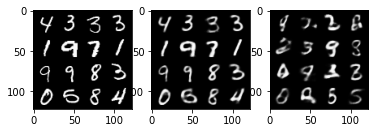

Iter: 43310/50000, Recon loss: 5355.6836, KL div loss: 1452.5640, Total loss: 6808.2476
Iter: 43320/50000, Recon loss: 5469.8408, KL div loss: 1397.5046, Total loss: 6867.3457
Iter: 43330/50000, Recon loss: 5546.1724, KL div loss: 1466.1610, Total loss: 7012.3335
Iter: 43340/50000, Recon loss: 5351.0459, KL div loss: 1384.0273, Total loss: 6735.0732
Iter: 43350/50000, Recon loss: 5620.7290, KL div loss: 1464.4801, Total loss: 7085.2090


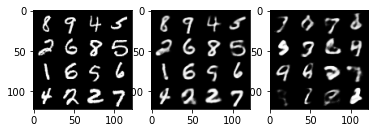

Iter: 43360/50000, Recon loss: 5336.6299, KL div loss: 1447.7051, Total loss: 6784.3350
Iter: 43370/50000, Recon loss: 5631.9873, KL div loss: 1463.6178, Total loss: 7095.6050
Iter: 43380/50000, Recon loss: 5245.2354, KL div loss: 1423.0698, Total loss: 6668.3052
Iter: 43390/50000, Recon loss: 5312.5830, KL div loss: 1398.0498, Total loss: 6710.6328
Iter: 43400/50000, Recon loss: 5477.6631, KL div loss: 1424.9592, Total loss: 6902.6221


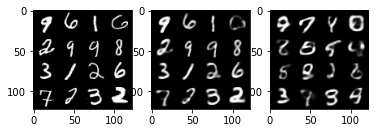

Iter: 43410/50000, Recon loss: 5304.7598, KL div loss: 1354.6338, Total loss: 6659.3936
Iter: 43420/50000, Recon loss: 5334.7319, KL div loss: 1394.1521, Total loss: 6728.8838
Iter: 43430/50000, Recon loss: 5533.0361, KL div loss: 1422.1981, Total loss: 6955.2344
Iter: 43440/50000, Recon loss: 5261.2871, KL div loss: 1416.9956, Total loss: 6678.2827
Iter: 43450/50000, Recon loss: 5080.9170, KL div loss: 1377.7202, Total loss: 6458.6372


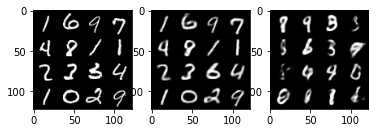

Iter: 43460/50000, Recon loss: 5533.9238, KL div loss: 1438.6719, Total loss: 6972.5957
Iter: 43470/50000, Recon loss: 5271.4473, KL div loss: 1403.0342, Total loss: 6674.4814
Iter: 43480/50000, Recon loss: 5661.0923, KL div loss: 1449.2891, Total loss: 7110.3813
Iter: 43490/50000, Recon loss: 5368.5679, KL div loss: 1410.7048, Total loss: 6779.2725
Iter: 43500/50000, Recon loss: 5576.3750, KL div loss: 1468.5601, Total loss: 7044.9351


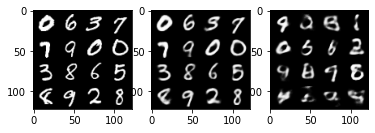

Iter: 43510/50000, Recon loss: 5489.8735, KL div loss: 1447.4115, Total loss: 6937.2852
Iter: 43520/50000, Recon loss: 5190.6084, KL div loss: 1410.6130, Total loss: 6601.2217
Iter: 43530/50000, Recon loss: 5429.6440, KL div loss: 1386.8474, Total loss: 6816.4912
Iter: 43540/50000, Recon loss: 5187.1113, KL div loss: 1423.9470, Total loss: 6611.0586
Iter: 43550/50000, Recon loss: 5170.0049, KL div loss: 1422.0955, Total loss: 6592.1006


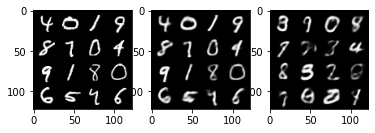

Iter: 43560/50000, Recon loss: 5549.6943, KL div loss: 1453.6230, Total loss: 7003.3174
Iter: 43570/50000, Recon loss: 5263.6582, KL div loss: 1375.8167, Total loss: 6639.4746
Iter: 43580/50000, Recon loss: 5402.0459, KL div loss: 1432.6018, Total loss: 6834.6475
Iter: 43590/50000, Recon loss: 5316.6021, KL div loss: 1420.8784, Total loss: 6737.4805
Iter: 43600/50000, Recon loss: 5372.6475, KL div loss: 1431.8123, Total loss: 6804.4600


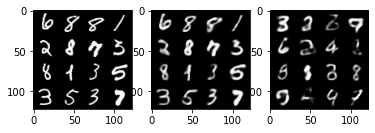

Iter: 43610/50000, Recon loss: 5691.4741, KL div loss: 1420.0610, Total loss: 7111.5352
Iter: 43620/50000, Recon loss: 5034.2886, KL div loss: 1406.1085, Total loss: 6440.3970
Iter: 43630/50000, Recon loss: 5599.6826, KL div loss: 1445.8950, Total loss: 7045.5776
Iter: 43640/50000, Recon loss: 5501.5986, KL div loss: 1414.7764, Total loss: 6916.3750
Iter: 43650/50000, Recon loss: 4995.4297, KL div loss: 1378.0210, Total loss: 6373.4507


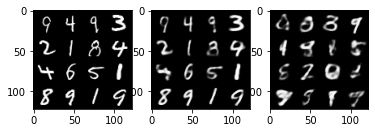

Iter: 43660/50000, Recon loss: 5572.2656, KL div loss: 1461.5593, Total loss: 7033.8252
Iter: 43670/50000, Recon loss: 5161.0073, KL div loss: 1388.4563, Total loss: 6549.4639
Iter: 43680/50000, Recon loss: 5105.4136, KL div loss: 1374.8098, Total loss: 6480.2236
Iter: 43690/50000, Recon loss: 5602.3545, KL div loss: 1449.9384, Total loss: 7052.2930
Iter: 43700/50000, Recon loss: 5301.7368, KL div loss: 1411.6052, Total loss: 6713.3418


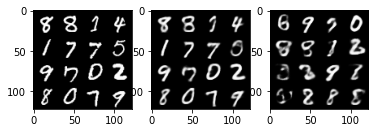

Iter: 43710/50000, Recon loss: 5279.5801, KL div loss: 1456.6787, Total loss: 6736.2588
Iter: 43720/50000, Recon loss: 5542.5410, KL div loss: 1461.8676, Total loss: 7004.4087
Iter: 43730/50000, Recon loss: 5538.6821, KL div loss: 1428.8988, Total loss: 6967.5811
Iter: 43740/50000, Recon loss: 5500.2959, KL div loss: 1443.5588, Total loss: 6943.8545
Iter: 43750/50000, Recon loss: 4991.3838, KL div loss: 1348.4250, Total loss: 6339.8086


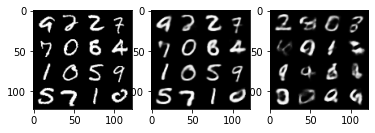

Iter: 43760/50000, Recon loss: 5497.6196, KL div loss: 1465.5042, Total loss: 6963.1240
Iter: 43770/50000, Recon loss: 5381.3130, KL div loss: 1406.7932, Total loss: 6788.1064
Iter: 43780/50000, Recon loss: 5173.2881, KL div loss: 1376.7426, Total loss: 6550.0308
Iter: 43790/50000, Recon loss: 5711.5884, KL div loss: 1415.5825, Total loss: 7127.1709
Iter: 43800/50000, Recon loss: 5348.6250, KL div loss: 1397.0571, Total loss: 6745.6821


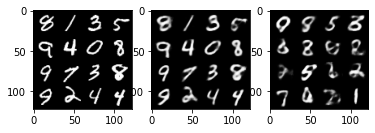

Iter: 43810/50000, Recon loss: 5155.2305, KL div loss: 1374.5664, Total loss: 6529.7969
Iter: 43820/50000, Recon loss: 5121.0898, KL div loss: 1384.6255, Total loss: 6505.7153
Iter: 43830/50000, Recon loss: 5334.6050, KL div loss: 1454.0354, Total loss: 6788.6406
Iter: 43840/50000, Recon loss: 5316.4609, KL div loss: 1423.4235, Total loss: 6739.8843
Iter: 43850/50000, Recon loss: 5051.3750, KL div loss: 1388.7737, Total loss: 6440.1484


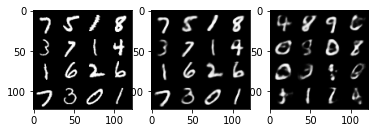

Iter: 43860/50000, Recon loss: 5097.3525, KL div loss: 1345.5831, Total loss: 6442.9355
Iter: 43870/50000, Recon loss: 4882.6006, KL div loss: 1395.0322, Total loss: 6277.6328
Iter: 43880/50000, Recon loss: 5391.2480, KL div loss: 1376.7122, Total loss: 6767.9600
Iter: 43890/50000, Recon loss: 5389.3359, KL div loss: 1459.6909, Total loss: 6849.0269
Iter: 43900/50000, Recon loss: 5237.2891, KL div loss: 1399.5356, Total loss: 6636.8247


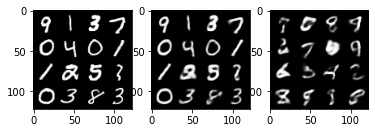

Iter: 43910/50000, Recon loss: 5229.4688, KL div loss: 1414.6722, Total loss: 6644.1411
Iter: 43920/50000, Recon loss: 5620.5142, KL div loss: 1457.9355, Total loss: 7078.4497
Iter: 43930/50000, Recon loss: 5536.3760, KL div loss: 1398.9211, Total loss: 6935.2969
Iter: 43940/50000, Recon loss: 5256.2783, KL div loss: 1423.1611, Total loss: 6679.4395
Iter: 43950/50000, Recon loss: 5284.8765, KL div loss: 1408.4313, Total loss: 6693.3076


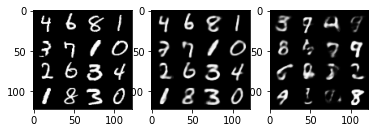

Iter: 43960/50000, Recon loss: 5471.1567, KL div loss: 1428.6045, Total loss: 6899.7612
Iter: 43970/50000, Recon loss: 5778.8203, KL div loss: 1463.6403, Total loss: 7242.4604
Iter: 43980/50000, Recon loss: 5251.2031, KL div loss: 1370.7917, Total loss: 6621.9951
Iter: 43990/50000, Recon loss: 5427.1689, KL div loss: 1449.2931, Total loss: 6876.4619
Iter: 44000/50000, Recon loss: 5380.3926, KL div loss: 1412.2344, Total loss: 6792.6270


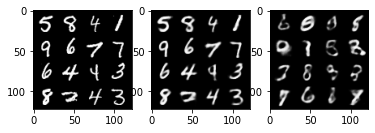

Iter: 44010/50000, Recon loss: 5351.0928, KL div loss: 1439.6038, Total loss: 6790.6963
Iter: 44020/50000, Recon loss: 5209.2803, KL div loss: 1425.4971, Total loss: 6634.7773
Iter: 44030/50000, Recon loss: 5478.8276, KL div loss: 1432.4009, Total loss: 6911.2285
Iter: 44040/50000, Recon loss: 5740.4521, KL div loss: 1457.0571, Total loss: 7197.5093
Iter: 44050/50000, Recon loss: 5259.3232, KL div loss: 1442.4048, Total loss: 6701.7280


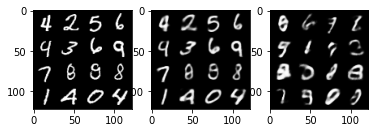

Iter: 44060/50000, Recon loss: 5781.6079, KL div loss: 1442.9072, Total loss: 7224.5151
Iter: 44070/50000, Recon loss: 5387.6973, KL div loss: 1398.3660, Total loss: 6786.0635
Iter: 44080/50000, Recon loss: 5633.2002, KL div loss: 1444.4778, Total loss: 7077.6777
Iter: 44090/50000, Recon loss: 5454.9009, KL div loss: 1442.5593, Total loss: 6897.4600
Iter: 44100/50000, Recon loss: 5177.5957, KL div loss: 1436.3137, Total loss: 6613.9092


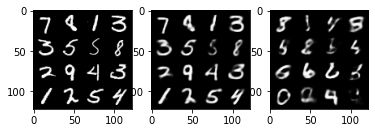

Iter: 44110/50000, Recon loss: 5694.3428, KL div loss: 1446.9382, Total loss: 7141.2812
Iter: 44120/50000, Recon loss: 5337.5859, KL div loss: 1455.9438, Total loss: 6793.5298
Iter: 44130/50000, Recon loss: 5131.0005, KL div loss: 1407.0132, Total loss: 6538.0137
Iter: 44140/50000, Recon loss: 5086.4194, KL div loss: 1392.9832, Total loss: 6479.4023
Iter: 44150/50000, Recon loss: 5438.6562, KL div loss: 1389.9272, Total loss: 6828.5835


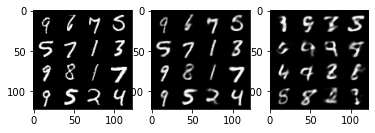

Iter: 44160/50000, Recon loss: 5462.9883, KL div loss: 1446.1897, Total loss: 6909.1777
Iter: 44170/50000, Recon loss: 5099.4355, KL div loss: 1395.6519, Total loss: 6495.0874
Iter: 44180/50000, Recon loss: 5524.0918, KL div loss: 1406.7682, Total loss: 6930.8599
Iter: 44190/50000, Recon loss: 5308.4590, KL div loss: 1408.8470, Total loss: 6717.3062
Iter: 44200/50000, Recon loss: 5024.4639, KL div loss: 1379.5122, Total loss: 6403.9761


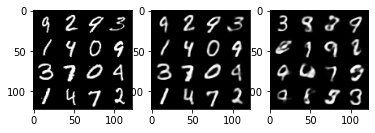

Iter: 44210/50000, Recon loss: 5500.4644, KL div loss: 1433.1323, Total loss: 6933.5967
Iter: 44220/50000, Recon loss: 5082.0488, KL div loss: 1359.0127, Total loss: 6441.0615
Iter: 44230/50000, Recon loss: 5317.9424, KL div loss: 1428.5764, Total loss: 6746.5186
Iter: 44240/50000, Recon loss: 5553.2822, KL div loss: 1446.7480, Total loss: 7000.0303
Iter: 44250/50000, Recon loss: 5200.7700, KL div loss: 1428.6709, Total loss: 6629.4409


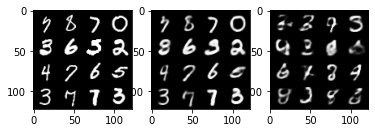

Iter: 44260/50000, Recon loss: 5456.6089, KL div loss: 1448.8970, Total loss: 6905.5059
Iter: 44270/50000, Recon loss: 5559.3560, KL div loss: 1426.2620, Total loss: 6985.6182
Iter: 44280/50000, Recon loss: 5240.5547, KL div loss: 1443.5728, Total loss: 6684.1274
Iter: 44290/50000, Recon loss: 5358.7148, KL div loss: 1390.7893, Total loss: 6749.5039
Iter: 44300/50000, Recon loss: 4831.3325, KL div loss: 1369.6777, Total loss: 6201.0103


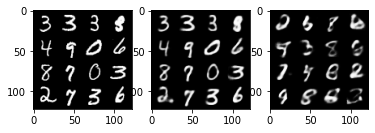

Iter: 44310/50000, Recon loss: 5251.8730, KL div loss: 1412.1997, Total loss: 6664.0728
Iter: 44320/50000, Recon loss: 5188.4785, KL div loss: 1387.0752, Total loss: 6575.5537
Iter: 44330/50000, Recon loss: 5425.8340, KL div loss: 1420.9753, Total loss: 6846.8096
Iter: 44340/50000, Recon loss: 5396.2881, KL div loss: 1402.9358, Total loss: 6799.2236
Iter: 44350/50000, Recon loss: 5419.0947, KL div loss: 1461.4084, Total loss: 6880.5029


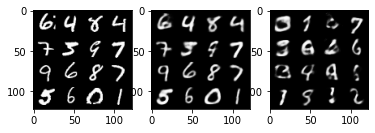

Iter: 44360/50000, Recon loss: 5005.3496, KL div loss: 1402.9043, Total loss: 6408.2539
Iter: 44370/50000, Recon loss: 5191.6812, KL div loss: 1449.4277, Total loss: 6641.1089
Iter: 44380/50000, Recon loss: 5656.8955, KL div loss: 1465.0312, Total loss: 7121.9268
Iter: 44390/50000, Recon loss: 5586.6309, KL div loss: 1446.2937, Total loss: 7032.9248
Iter: 44400/50000, Recon loss: 5467.5181, KL div loss: 1408.9410, Total loss: 6876.4590


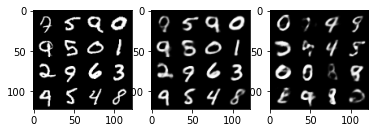

Iter: 44410/50000, Recon loss: 4985.1978, KL div loss: 1374.0022, Total loss: 6359.2002
Iter: 44420/50000, Recon loss: 5288.0229, KL div loss: 1417.2056, Total loss: 6705.2285
Iter: 44430/50000, Recon loss: 5359.0557, KL div loss: 1445.8164, Total loss: 6804.8721
Iter: 44440/50000, Recon loss: 5316.3188, KL div loss: 1426.0011, Total loss: 6742.3198
Iter: 44450/50000, Recon loss: 5687.4180, KL div loss: 1428.2681, Total loss: 7115.6860


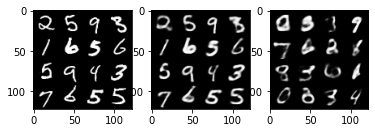

Iter: 44460/50000, Recon loss: 5625.9678, KL div loss: 1469.2847, Total loss: 7095.2524
Iter: 44470/50000, Recon loss: 5290.0781, KL div loss: 1444.5365, Total loss: 6734.6147
Iter: 44480/50000, Recon loss: 5111.2627, KL div loss: 1408.1213, Total loss: 6519.3838
Iter: 44490/50000, Recon loss: 5423.0049, KL div loss: 1451.6370, Total loss: 6874.6416
Iter: 44500/50000, Recon loss: 5065.1860, KL div loss: 1397.1611, Total loss: 6462.3472


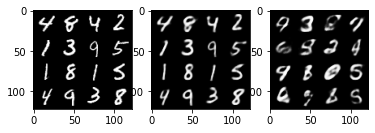

Iter: 44510/50000, Recon loss: 5052.9902, KL div loss: 1361.8069, Total loss: 6414.7969
Iter: 44520/50000, Recon loss: 5277.2432, KL div loss: 1395.5063, Total loss: 6672.7495
Iter: 44530/50000, Recon loss: 5225.0264, KL div loss: 1414.1189, Total loss: 6639.1455
Iter: 44540/50000, Recon loss: 5505.1836, KL div loss: 1439.7148, Total loss: 6944.8984
Iter: 44550/50000, Recon loss: 5217.0518, KL div loss: 1412.0933, Total loss: 6629.1450


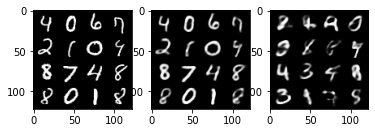

Iter: 44560/50000, Recon loss: 5132.2856, KL div loss: 1436.3101, Total loss: 6568.5957
Iter: 44570/50000, Recon loss: 5455.7080, KL div loss: 1438.9314, Total loss: 6894.6396
Iter: 44580/50000, Recon loss: 5504.7559, KL div loss: 1406.8843, Total loss: 6911.6401
Iter: 44590/50000, Recon loss: 5763.5415, KL div loss: 1466.7593, Total loss: 7230.3008
Iter: 44600/50000, Recon loss: 5388.1582, KL div loss: 1421.2114, Total loss: 6809.3696


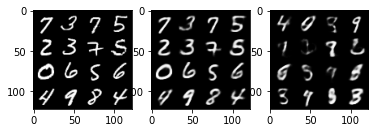

Iter: 44610/50000, Recon loss: 5331.8594, KL div loss: 1419.2219, Total loss: 6751.0811
Iter: 44620/50000, Recon loss: 5106.6616, KL div loss: 1443.2626, Total loss: 6549.9243
Iter: 44630/50000, Recon loss: 5610.6348, KL div loss: 1444.1099, Total loss: 7054.7446
Iter: 44640/50000, Recon loss: 5139.7061, KL div loss: 1392.7955, Total loss: 6532.5015
Iter: 44650/50000, Recon loss: 5260.4282, KL div loss: 1391.7622, Total loss: 6652.1904


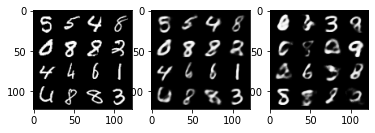

Iter: 44660/50000, Recon loss: 5460.7090, KL div loss: 1412.0985, Total loss: 6872.8076
Iter: 44670/50000, Recon loss: 5358.8613, KL div loss: 1433.6879, Total loss: 6792.5493
Iter: 44680/50000, Recon loss: 5123.5947, KL div loss: 1418.3438, Total loss: 6541.9385
Iter: 44690/50000, Recon loss: 5209.5493, KL div loss: 1389.0575, Total loss: 6598.6069
Iter: 44700/50000, Recon loss: 5110.9937, KL div loss: 1401.8740, Total loss: 6512.8677


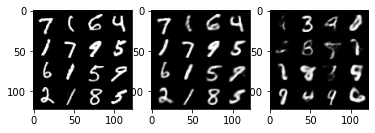

Iter: 44710/50000, Recon loss: 5560.6885, KL div loss: 1473.1113, Total loss: 7033.7998
Iter: 44720/50000, Recon loss: 5217.4521, KL div loss: 1425.2677, Total loss: 6642.7197
Iter: 44730/50000, Recon loss: 5262.0791, KL div loss: 1462.6442, Total loss: 6724.7231
Iter: 44740/50000, Recon loss: 5032.2715, KL div loss: 1432.1527, Total loss: 6464.4243
Iter: 44750/50000, Recon loss: 5376.9165, KL div loss: 1403.8608, Total loss: 6780.7773


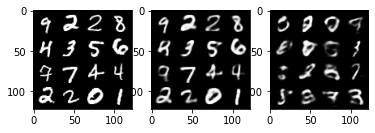

Iter: 44760/50000, Recon loss: 5147.0801, KL div loss: 1438.0518, Total loss: 6585.1318
Iter: 44770/50000, Recon loss: 5141.8750, KL div loss: 1423.4368, Total loss: 6565.3115
Iter: 44780/50000, Recon loss: 5429.3804, KL div loss: 1423.4768, Total loss: 6852.8574
Iter: 44790/50000, Recon loss: 5619.2031, KL div loss: 1445.0515, Total loss: 7064.2549
Iter: 44800/50000, Recon loss: 5331.7012, KL div loss: 1420.2251, Total loss: 6751.9263


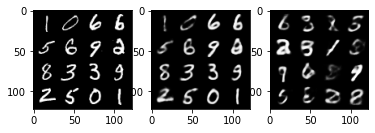

Iter: 44810/50000, Recon loss: 5498.1294, KL div loss: 1466.8018, Total loss: 6964.9312
Iter: 44820/50000, Recon loss: 5452.5054, KL div loss: 1470.3140, Total loss: 6922.8193
Iter: 44830/50000, Recon loss: 5607.6646, KL div loss: 1409.8628, Total loss: 7017.5273
Iter: 44840/50000, Recon loss: 5266.1367, KL div loss: 1399.0638, Total loss: 6665.2007
Iter: 44850/50000, Recon loss: 5281.6758, KL div loss: 1406.7122, Total loss: 6688.3877


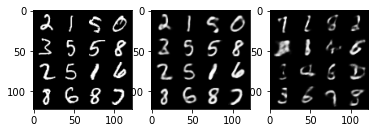

Iter: 44860/50000, Recon loss: 5519.3760, KL div loss: 1447.8828, Total loss: 6967.2588
Iter: 44870/50000, Recon loss: 5354.5137, KL div loss: 1428.3313, Total loss: 6782.8447
Iter: 44880/50000, Recon loss: 5457.2588, KL div loss: 1478.6592, Total loss: 6935.9180
Iter: 44890/50000, Recon loss: 5234.2231, KL div loss: 1387.2119, Total loss: 6621.4351
Iter: 44900/50000, Recon loss: 5171.1543, KL div loss: 1396.6033, Total loss: 6567.7578


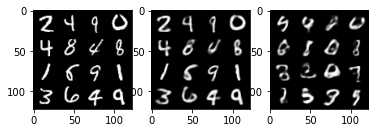

Iter: 44910/50000, Recon loss: 5272.7910, KL div loss: 1419.2327, Total loss: 6692.0234
Iter: 44920/50000, Recon loss: 5160.1143, KL div loss: 1433.7400, Total loss: 6593.8545
Iter: 44930/50000, Recon loss: 5548.1006, KL div loss: 1425.4373, Total loss: 6973.5381
Iter: 44940/50000, Recon loss: 5480.8135, KL div loss: 1413.1711, Total loss: 6893.9844
Iter: 44950/50000, Recon loss: 5244.9336, KL div loss: 1414.5908, Total loss: 6659.5244


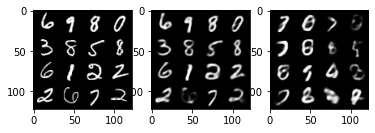

Iter: 44960/50000, Recon loss: 5628.3218, KL div loss: 1452.0566, Total loss: 7080.3784
Iter: 44970/50000, Recon loss: 5460.5225, KL div loss: 1489.7123, Total loss: 6950.2349
Iter: 44980/50000, Recon loss: 5445.1660, KL div loss: 1471.8020, Total loss: 6916.9678
Iter: 44990/50000, Recon loss: 4898.1187, KL div loss: 1344.7683, Total loss: 6242.8867
Iter: 45000/50000, Recon loss: 5230.9629, KL div loss: 1396.7264, Total loss: 6627.6895


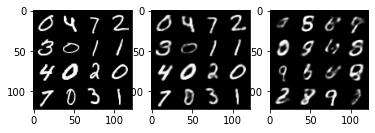

Iter: 45010/50000, Recon loss: 5764.4805, KL div loss: 1461.6531, Total loss: 7226.1338
Iter: 45020/50000, Recon loss: 5642.9053, KL div loss: 1421.0427, Total loss: 7063.9482
Iter: 45030/50000, Recon loss: 5169.1396, KL div loss: 1361.9735, Total loss: 6531.1133
Iter: 45040/50000, Recon loss: 5020.0732, KL div loss: 1405.8887, Total loss: 6425.9619
Iter: 45050/50000, Recon loss: 5335.1045, KL div loss: 1406.6036, Total loss: 6741.7080


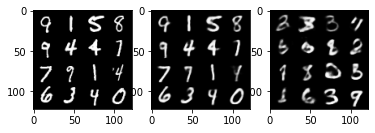

Iter: 45060/50000, Recon loss: 5364.5635, KL div loss: 1460.1748, Total loss: 6824.7383
Iter: 45070/50000, Recon loss: 5046.1108, KL div loss: 1412.1045, Total loss: 6458.2153
Iter: 45080/50000, Recon loss: 5271.3291, KL div loss: 1424.5573, Total loss: 6695.8862
Iter: 45090/50000, Recon loss: 5429.3145, KL div loss: 1417.6169, Total loss: 6846.9316
Iter: 45100/50000, Recon loss: 5271.5913, KL div loss: 1421.9126, Total loss: 6693.5039


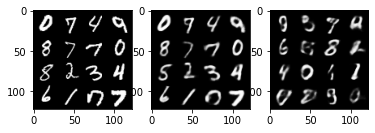

Iter: 45110/50000, Recon loss: 5694.4268, KL div loss: 1424.6851, Total loss: 7119.1118
Iter: 45120/50000, Recon loss: 5277.3447, KL div loss: 1427.5891, Total loss: 6704.9336
Iter: 45130/50000, Recon loss: 5518.3291, KL div loss: 1440.6704, Total loss: 6958.9995
Iter: 45140/50000, Recon loss: 5244.3979, KL div loss: 1453.6555, Total loss: 6698.0537
Iter: 45150/50000, Recon loss: 5575.5894, KL div loss: 1446.3862, Total loss: 7021.9756


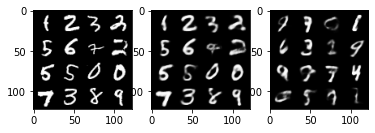

Iter: 45160/50000, Recon loss: 5488.3320, KL div loss: 1431.3572, Total loss: 6919.6895
Iter: 45170/50000, Recon loss: 5218.5137, KL div loss: 1405.5520, Total loss: 6624.0654
Iter: 45180/50000, Recon loss: 5334.0791, KL div loss: 1401.9728, Total loss: 6736.0518
Iter: 45190/50000, Recon loss: 5126.0020, KL div loss: 1446.3215, Total loss: 6572.3232
Iter: 45200/50000, Recon loss: 5425.1846, KL div loss: 1442.0027, Total loss: 6867.1875


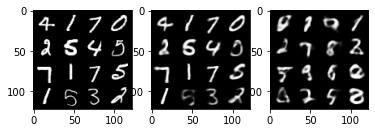

Iter: 45210/50000, Recon loss: 5226.7188, KL div loss: 1399.2737, Total loss: 6625.9922
Iter: 45220/50000, Recon loss: 4798.2646, KL div loss: 1377.4229, Total loss: 6175.6875
Iter: 45230/50000, Recon loss: 5804.2412, KL div loss: 1492.5265, Total loss: 7296.7676
Iter: 45240/50000, Recon loss: 5511.6050, KL div loss: 1428.3535, Total loss: 6939.9585
Iter: 45250/50000, Recon loss: 5054.4512, KL div loss: 1381.5571, Total loss: 6436.0083


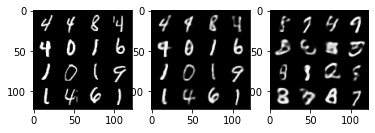

Iter: 45260/50000, Recon loss: 5408.9512, KL div loss: 1464.1112, Total loss: 6873.0625
Iter: 45270/50000, Recon loss: 5054.9785, KL div loss: 1447.8081, Total loss: 6502.7866
Iter: 45280/50000, Recon loss: 5263.3662, KL div loss: 1442.4397, Total loss: 6705.8057
Iter: 45290/50000, Recon loss: 5273.3779, KL div loss: 1412.2705, Total loss: 6685.6484
Iter: 45300/50000, Recon loss: 5624.6445, KL div loss: 1456.5852, Total loss: 7081.2295


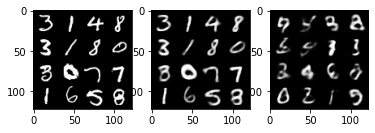

Iter: 45310/50000, Recon loss: 5536.1523, KL div loss: 1470.6780, Total loss: 7006.8301
Iter: 45320/50000, Recon loss: 5153.8462, KL div loss: 1404.1453, Total loss: 6557.9912
Iter: 45330/50000, Recon loss: 4969.6348, KL div loss: 1380.0428, Total loss: 6349.6777
Iter: 45340/50000, Recon loss: 5034.4932, KL div loss: 1419.0049, Total loss: 6453.4980
Iter: 45350/50000, Recon loss: 5391.0132, KL div loss: 1471.6532, Total loss: 6862.6665


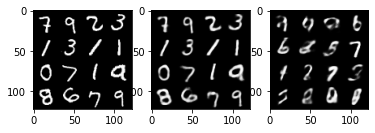

Iter: 45360/50000, Recon loss: 5423.9087, KL div loss: 1405.5999, Total loss: 6829.5088
Iter: 45370/50000, Recon loss: 5391.9521, KL div loss: 1349.8345, Total loss: 6741.7866
Iter: 45380/50000, Recon loss: 5505.8711, KL div loss: 1421.9169, Total loss: 6927.7881
Iter: 45390/50000, Recon loss: 5292.7910, KL div loss: 1409.8635, Total loss: 6702.6543
Iter: 45400/50000, Recon loss: 5426.8242, KL div loss: 1460.4445, Total loss: 6887.2686


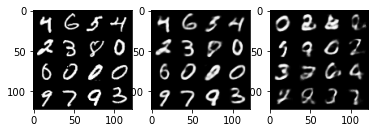

Iter: 45410/50000, Recon loss: 5395.9307, KL div loss: 1443.9022, Total loss: 6839.8330
Iter: 45420/50000, Recon loss: 4902.3184, KL div loss: 1382.7931, Total loss: 6285.1113
Iter: 45430/50000, Recon loss: 5418.6641, KL div loss: 1438.1288, Total loss: 6856.7930
Iter: 45440/50000, Recon loss: 5219.9844, KL div loss: 1395.5190, Total loss: 6615.5034
Iter: 45450/50000, Recon loss: 5611.9663, KL div loss: 1458.4717, Total loss: 7070.4380


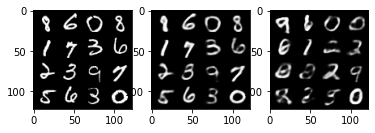

Iter: 45460/50000, Recon loss: 5681.9717, KL div loss: 1449.5894, Total loss: 7131.5610
Iter: 45470/50000, Recon loss: 5073.9468, KL div loss: 1450.1205, Total loss: 6524.0674
Iter: 45480/50000, Recon loss: 5250.4062, KL div loss: 1401.9424, Total loss: 6652.3486
Iter: 45490/50000, Recon loss: 5207.3149, KL div loss: 1419.8762, Total loss: 6627.1914
Iter: 45500/50000, Recon loss: 5148.1904, KL div loss: 1385.5720, Total loss: 6533.7627


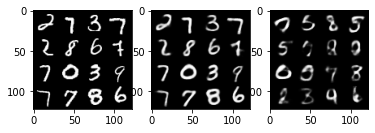

Iter: 45510/50000, Recon loss: 5355.9688, KL div loss: 1390.8910, Total loss: 6746.8599
Iter: 45520/50000, Recon loss: 5001.1396, KL div loss: 1366.0972, Total loss: 6367.2368
Iter: 45530/50000, Recon loss: 5450.4390, KL div loss: 1430.2910, Total loss: 6880.7300
Iter: 45540/50000, Recon loss: 5371.9912, KL div loss: 1434.4666, Total loss: 6806.4580
Iter: 45550/50000, Recon loss: 5531.3994, KL div loss: 1426.0343, Total loss: 6957.4336


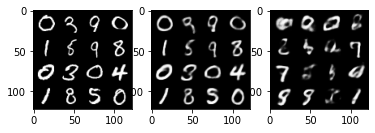

Iter: 45560/50000, Recon loss: 5360.8301, KL div loss: 1436.4139, Total loss: 6797.2441
Iter: 45570/50000, Recon loss: 5501.6211, KL div loss: 1425.6680, Total loss: 6927.2891
Iter: 45580/50000, Recon loss: 5299.7646, KL div loss: 1436.4897, Total loss: 6736.2544
Iter: 45590/50000, Recon loss: 5554.5366, KL div loss: 1470.4011, Total loss: 7024.9375
Iter: 45600/50000, Recon loss: 5200.3896, KL div loss: 1414.2158, Total loss: 6614.6055


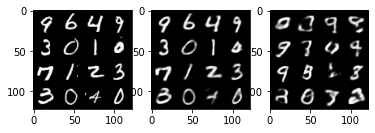

Iter: 45610/50000, Recon loss: 5433.0283, KL div loss: 1418.6260, Total loss: 6851.6543
Iter: 45620/50000, Recon loss: 5632.8779, KL div loss: 1407.2380, Total loss: 7040.1162
Iter: 45630/50000, Recon loss: 5263.8975, KL div loss: 1428.1892, Total loss: 6692.0869
Iter: 45640/50000, Recon loss: 5454.9951, KL div loss: 1423.7505, Total loss: 6878.7456
Iter: 45650/50000, Recon loss: 5122.4141, KL div loss: 1413.2336, Total loss: 6535.6475


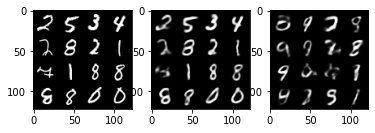

Iter: 45660/50000, Recon loss: 5169.0840, KL div loss: 1446.5411, Total loss: 6615.6250
Iter: 45670/50000, Recon loss: 5552.6743, KL div loss: 1405.4392, Total loss: 6958.1133
Iter: 45680/50000, Recon loss: 5139.4961, KL div loss: 1432.7070, Total loss: 6572.2031
Iter: 45690/50000, Recon loss: 5299.7803, KL div loss: 1460.7461, Total loss: 6760.5264
Iter: 45700/50000, Recon loss: 5710.3169, KL div loss: 1410.9427, Total loss: 7121.2598


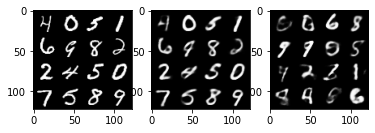

Iter: 45710/50000, Recon loss: 5302.3867, KL div loss: 1467.9312, Total loss: 6770.3179
Iter: 45720/50000, Recon loss: 5316.4414, KL div loss: 1388.1943, Total loss: 6704.6357
Iter: 45730/50000, Recon loss: 5454.8970, KL div loss: 1465.4619, Total loss: 6920.3589
Iter: 45740/50000, Recon loss: 5195.7949, KL div loss: 1463.4373, Total loss: 6659.2324
Iter: 45750/50000, Recon loss: 5152.0605, KL div loss: 1410.8229, Total loss: 6562.8833


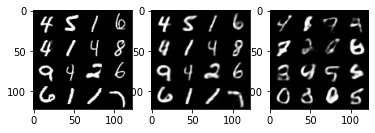

Iter: 45760/50000, Recon loss: 5165.9956, KL div loss: 1390.6387, Total loss: 6556.6343
Iter: 45770/50000, Recon loss: 5266.6543, KL div loss: 1459.6411, Total loss: 6726.2954
Iter: 45780/50000, Recon loss: 4971.4434, KL div loss: 1350.5258, Total loss: 6321.9692
Iter: 45790/50000, Recon loss: 5276.0977, KL div loss: 1434.8923, Total loss: 6710.9902
Iter: 45800/50000, Recon loss: 5225.1079, KL div loss: 1430.7783, Total loss: 6655.8862


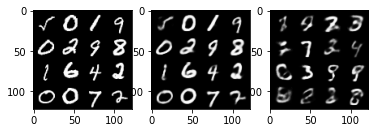

Iter: 45810/50000, Recon loss: 5353.1548, KL div loss: 1416.5244, Total loss: 6769.6792
Iter: 45820/50000, Recon loss: 5380.4033, KL div loss: 1458.1309, Total loss: 6838.5342
Iter: 45830/50000, Recon loss: 5414.1880, KL div loss: 1409.7599, Total loss: 6823.9478
Iter: 45840/50000, Recon loss: 5635.0029, KL div loss: 1421.1364, Total loss: 7056.1392
Iter: 45850/50000, Recon loss: 5877.7251, KL div loss: 1438.1895, Total loss: 7315.9146


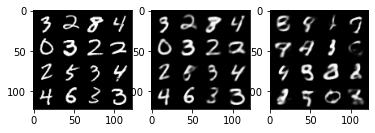

Iter: 45860/50000, Recon loss: 5749.5171, KL div loss: 1477.6902, Total loss: 7227.2070
Iter: 45870/50000, Recon loss: 5640.3281, KL div loss: 1417.4008, Total loss: 7057.7290
Iter: 45880/50000, Recon loss: 5500.3232, KL div loss: 1429.1405, Total loss: 6929.4639
Iter: 45890/50000, Recon loss: 5566.8516, KL div loss: 1431.7683, Total loss: 6998.6201
Iter: 45900/50000, Recon loss: 5497.3086, KL div loss: 1424.8071, Total loss: 6922.1157


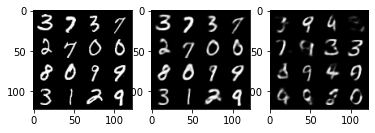

Iter: 45910/50000, Recon loss: 5663.9678, KL div loss: 1447.7380, Total loss: 7111.7061
Iter: 45920/50000, Recon loss: 5128.6221, KL div loss: 1394.1038, Total loss: 6522.7256
Iter: 45930/50000, Recon loss: 5303.2134, KL div loss: 1414.1978, Total loss: 6717.4111
Iter: 45940/50000, Recon loss: 5052.3301, KL div loss: 1431.1208, Total loss: 6483.4512
Iter: 45950/50000, Recon loss: 4617.7441, KL div loss: 1345.6495, Total loss: 5963.3936


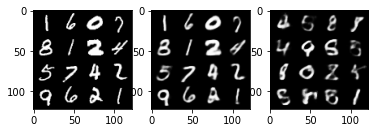

Iter: 45960/50000, Recon loss: 5119.5771, KL div loss: 1409.9124, Total loss: 6529.4893
Iter: 45970/50000, Recon loss: 5649.7939, KL div loss: 1458.6492, Total loss: 7108.4434
Iter: 45980/50000, Recon loss: 5267.2051, KL div loss: 1441.1951, Total loss: 6708.4004
Iter: 45990/50000, Recon loss: 5174.3369, KL div loss: 1409.0469, Total loss: 6583.3838
Iter: 46000/50000, Recon loss: 5523.6025, KL div loss: 1440.7715, Total loss: 6964.3740


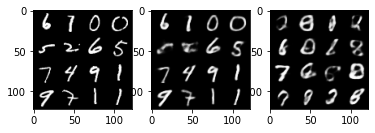

Iter: 46010/50000, Recon loss: 5442.6680, KL div loss: 1464.9329, Total loss: 6907.6006
Iter: 46020/50000, Recon loss: 5440.3359, KL div loss: 1406.9082, Total loss: 6847.2441
Iter: 46030/50000, Recon loss: 5480.6016, KL div loss: 1416.9778, Total loss: 6897.5791
Iter: 46040/50000, Recon loss: 5292.1045, KL div loss: 1431.8279, Total loss: 6723.9326
Iter: 46050/50000, Recon loss: 5273.8428, KL div loss: 1412.4187, Total loss: 6686.2617


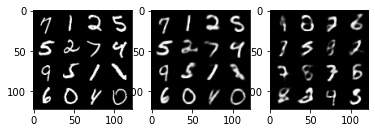

Iter: 46060/50000, Recon loss: 5021.0078, KL div loss: 1412.1152, Total loss: 6433.1230
Iter: 46070/50000, Recon loss: 5539.1055, KL div loss: 1454.5209, Total loss: 6993.6265
Iter: 46080/50000, Recon loss: 5350.8325, KL div loss: 1433.9004, Total loss: 6784.7329
Iter: 46090/50000, Recon loss: 5253.5498, KL div loss: 1463.9722, Total loss: 6717.5220
Iter: 46100/50000, Recon loss: 5148.3984, KL div loss: 1441.3804, Total loss: 6589.7788


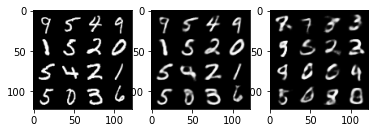

Iter: 46110/50000, Recon loss: 5347.8286, KL div loss: 1430.1895, Total loss: 6778.0181
Iter: 46120/50000, Recon loss: 5403.2979, KL div loss: 1484.3949, Total loss: 6887.6929
Iter: 46130/50000, Recon loss: 5311.9722, KL div loss: 1453.5958, Total loss: 6765.5679
Iter: 46140/50000, Recon loss: 5451.7393, KL div loss: 1459.1484, Total loss: 6910.8877
Iter: 46150/50000, Recon loss: 5417.5889, KL div loss: 1453.1003, Total loss: 6870.6895


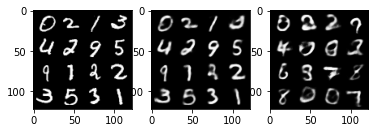

Iter: 46160/50000, Recon loss: 5203.9766, KL div loss: 1404.2402, Total loss: 6608.2168
Iter: 46170/50000, Recon loss: 5252.9023, KL div loss: 1457.0771, Total loss: 6709.9795
Iter: 46180/50000, Recon loss: 5433.3164, KL div loss: 1460.5649, Total loss: 6893.8813
Iter: 46190/50000, Recon loss: 5485.3184, KL div loss: 1454.0101, Total loss: 6939.3286
Iter: 46200/50000, Recon loss: 5766.0654, KL div loss: 1466.6782, Total loss: 7232.7437


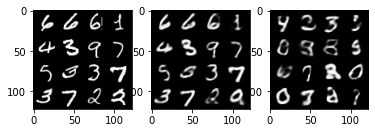

Iter: 46210/50000, Recon loss: 5724.7319, KL div loss: 1492.0802, Total loss: 7216.8120
Iter: 46220/50000, Recon loss: 5242.5830, KL div loss: 1383.5159, Total loss: 6626.0986
Iter: 46230/50000, Recon loss: 5353.4443, KL div loss: 1431.0243, Total loss: 6784.4688
Iter: 46240/50000, Recon loss: 5468.9541, KL div loss: 1424.3472, Total loss: 6893.3013
Iter: 46250/50000, Recon loss: 5189.1074, KL div loss: 1336.0591, Total loss: 6525.1665


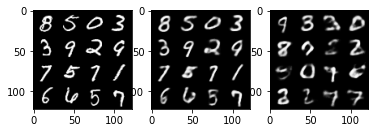

Iter: 46260/50000, Recon loss: 5051.7085, KL div loss: 1427.0750, Total loss: 6478.7832
Iter: 46270/50000, Recon loss: 5101.4072, KL div loss: 1406.6217, Total loss: 6508.0288
Iter: 46280/50000, Recon loss: 5288.4790, KL div loss: 1430.7980, Total loss: 6719.2769
Iter: 46290/50000, Recon loss: 5283.0059, KL div loss: 1397.2678, Total loss: 6680.2734
Iter: 46300/50000, Recon loss: 5543.5405, KL div loss: 1430.2764, Total loss: 6973.8169


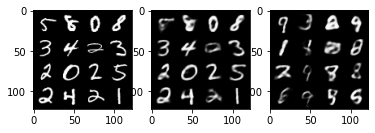

Iter: 46310/50000, Recon loss: 5535.8511, KL div loss: 1440.3816, Total loss: 6976.2324
Iter: 46320/50000, Recon loss: 5246.0396, KL div loss: 1426.2935, Total loss: 6672.3330
Iter: 46330/50000, Recon loss: 5232.1328, KL div loss: 1394.8735, Total loss: 6627.0063
Iter: 46340/50000, Recon loss: 5212.3267, KL div loss: 1415.4884, Total loss: 6627.8149
Iter: 46350/50000, Recon loss: 5758.8467, KL div loss: 1471.3936, Total loss: 7230.2402


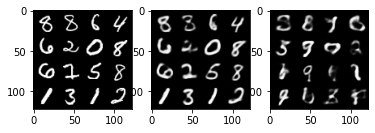

Iter: 46360/50000, Recon loss: 5121.7183, KL div loss: 1443.2562, Total loss: 6564.9746
Iter: 46370/50000, Recon loss: 5383.4229, KL div loss: 1365.8235, Total loss: 6749.2461
Iter: 46380/50000, Recon loss: 5301.8525, KL div loss: 1374.4995, Total loss: 6676.3521
Iter: 46390/50000, Recon loss: 5028.7578, KL div loss: 1353.3777, Total loss: 6382.1357
Iter: 46400/50000, Recon loss: 5944.5010, KL div loss: 1474.1053, Total loss: 7418.6064


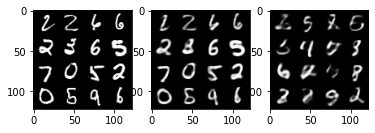

Iter: 46410/50000, Recon loss: 5541.1543, KL div loss: 1438.9515, Total loss: 6980.1060
Iter: 46420/50000, Recon loss: 5381.2246, KL div loss: 1378.7919, Total loss: 6760.0166
Iter: 46430/50000, Recon loss: 5180.2368, KL div loss: 1410.0747, Total loss: 6590.3115
Iter: 46440/50000, Recon loss: 5156.3086, KL div loss: 1412.6616, Total loss: 6568.9702
Iter: 46450/50000, Recon loss: 5285.3999, KL div loss: 1456.4951, Total loss: 6741.8950


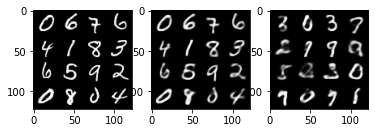

Iter: 46460/50000, Recon loss: 5377.7388, KL div loss: 1436.3123, Total loss: 6814.0508
Iter: 46470/50000, Recon loss: 5286.4951, KL div loss: 1402.7268, Total loss: 6689.2217
Iter: 46480/50000, Recon loss: 5515.6465, KL div loss: 1402.0732, Total loss: 6917.7197
Iter: 46490/50000, Recon loss: 5268.7715, KL div loss: 1429.4211, Total loss: 6698.1924
Iter: 46500/50000, Recon loss: 5270.0908, KL div loss: 1434.0198, Total loss: 6704.1104


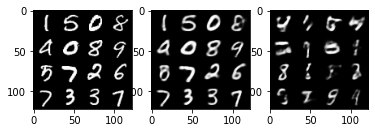

Iter: 46510/50000, Recon loss: 5518.8237, KL div loss: 1462.4404, Total loss: 6981.2642
Iter: 46520/50000, Recon loss: 5206.5537, KL div loss: 1405.7845, Total loss: 6612.3384
Iter: 46530/50000, Recon loss: 5681.2388, KL div loss: 1402.0181, Total loss: 7083.2568
Iter: 46540/50000, Recon loss: 5297.3369, KL div loss: 1448.4650, Total loss: 6745.8018
Iter: 46550/50000, Recon loss: 5697.4985, KL div loss: 1478.8411, Total loss: 7176.3398


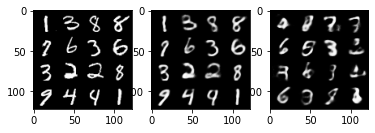

Iter: 46560/50000, Recon loss: 5529.1865, KL div loss: 1413.1766, Total loss: 6942.3633
Iter: 46570/50000, Recon loss: 5721.5039, KL div loss: 1472.5442, Total loss: 7194.0479
Iter: 46580/50000, Recon loss: 5083.4492, KL div loss: 1390.1521, Total loss: 6473.6016
Iter: 46590/50000, Recon loss: 5353.3442, KL div loss: 1449.6709, Total loss: 6803.0151
Iter: 46600/50000, Recon loss: 5157.3857, KL div loss: 1387.9868, Total loss: 6545.3726


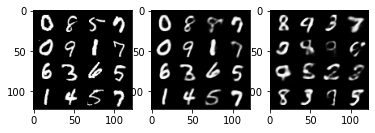

Iter: 46610/50000, Recon loss: 5268.9253, KL div loss: 1379.5884, Total loss: 6648.5137
Iter: 46620/50000, Recon loss: 5368.9609, KL div loss: 1434.8403, Total loss: 6803.8013
Iter: 46630/50000, Recon loss: 5238.8242, KL div loss: 1436.6620, Total loss: 6675.4863
Iter: 46640/50000, Recon loss: 5136.6631, KL div loss: 1420.8140, Total loss: 6557.4771
Iter: 46650/50000, Recon loss: 5484.4907, KL div loss: 1477.0017, Total loss: 6961.4922


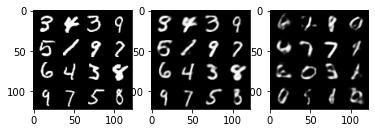

Iter: 46660/50000, Recon loss: 5256.6943, KL div loss: 1389.0967, Total loss: 6645.7910
Iter: 46670/50000, Recon loss: 5796.5928, KL div loss: 1403.5371, Total loss: 7200.1299
Iter: 46680/50000, Recon loss: 5486.9375, KL div loss: 1437.8290, Total loss: 6924.7666
Iter: 46690/50000, Recon loss: 5222.5762, KL div loss: 1397.9170, Total loss: 6620.4932
Iter: 46700/50000, Recon loss: 4924.0103, KL div loss: 1420.8710, Total loss: 6344.8813


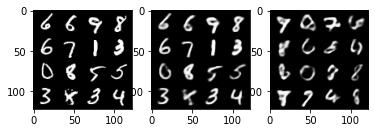

Iter: 46710/50000, Recon loss: 5521.8853, KL div loss: 1414.2534, Total loss: 6936.1387
Iter: 46720/50000, Recon loss: 5419.8403, KL div loss: 1484.4479, Total loss: 6904.2881
Iter: 46730/50000, Recon loss: 5552.5869, KL div loss: 1505.4900, Total loss: 7058.0771
Iter: 46740/50000, Recon loss: 5353.2646, KL div loss: 1460.3967, Total loss: 6813.6611
Iter: 46750/50000, Recon loss: 5136.5674, KL div loss: 1376.5488, Total loss: 6513.1162


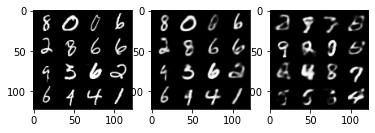

Iter: 46760/50000, Recon loss: 5206.1289, KL div loss: 1373.9731, Total loss: 6580.1021
Iter: 46770/50000, Recon loss: 5157.2432, KL div loss: 1413.9482, Total loss: 6571.1914
Iter: 46780/50000, Recon loss: 5551.6104, KL div loss: 1429.2417, Total loss: 6980.8521
Iter: 46790/50000, Recon loss: 5182.2031, KL div loss: 1380.2268, Total loss: 6562.4297
Iter: 46800/50000, Recon loss: 5454.3496, KL div loss: 1443.5267, Total loss: 6897.8765


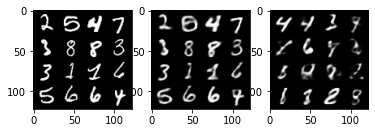

Iter: 46810/50000, Recon loss: 4903.7100, KL div loss: 1406.4680, Total loss: 6310.1777
Iter: 46820/50000, Recon loss: 5364.8647, KL div loss: 1369.0623, Total loss: 6733.9268
Iter: 46830/50000, Recon loss: 5750.4253, KL div loss: 1476.7710, Total loss: 7227.1963
Iter: 46840/50000, Recon loss: 5369.5918, KL div loss: 1434.0393, Total loss: 6803.6309
Iter: 46850/50000, Recon loss: 5402.2261, KL div loss: 1456.4064, Total loss: 6858.6323


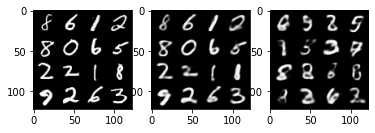

Iter: 46860/50000, Recon loss: 5286.8828, KL div loss: 1391.7827, Total loss: 6678.6655
Iter: 46870/50000, Recon loss: 5388.4600, KL div loss: 1412.7427, Total loss: 6801.2026
Iter: 46880/50000, Recon loss: 5122.7412, KL div loss: 1407.7688, Total loss: 6530.5098
Iter: 46890/50000, Recon loss: 5180.2920, KL div loss: 1411.7151, Total loss: 6592.0068
Iter: 46900/50000, Recon loss: 5433.1367, KL div loss: 1465.3867, Total loss: 6898.5234


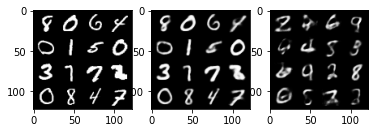

Iter: 46910/50000, Recon loss: 4987.8311, KL div loss: 1391.5420, Total loss: 6379.3730
Iter: 46920/50000, Recon loss: 5262.0840, KL div loss: 1421.5382, Total loss: 6683.6221
Iter: 46930/50000, Recon loss: 4973.9814, KL div loss: 1357.1997, Total loss: 6331.1812
Iter: 46940/50000, Recon loss: 5284.0635, KL div loss: 1401.2338, Total loss: 6685.2974
Iter: 46950/50000, Recon loss: 5278.0625, KL div loss: 1467.2065, Total loss: 6745.2690


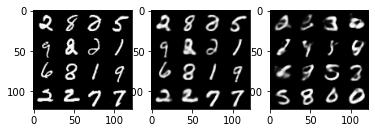

Iter: 46960/50000, Recon loss: 5130.0601, KL div loss: 1403.3127, Total loss: 6533.3730
Iter: 46970/50000, Recon loss: 5316.8296, KL div loss: 1369.2328, Total loss: 6686.0625
Iter: 46980/50000, Recon loss: 5630.1738, KL div loss: 1463.1754, Total loss: 7093.3491
Iter: 46990/50000, Recon loss: 5170.1035, KL div loss: 1361.9553, Total loss: 6532.0586
Iter: 47000/50000, Recon loss: 5436.2749, KL div loss: 1449.4736, Total loss: 6885.7485


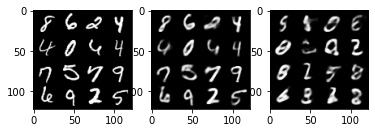

Iter: 47010/50000, Recon loss: 5548.9316, KL div loss: 1446.3552, Total loss: 6995.2871
Iter: 47020/50000, Recon loss: 5265.9277, KL div loss: 1463.8809, Total loss: 6729.8086
Iter: 47030/50000, Recon loss: 5097.2236, KL div loss: 1357.9795, Total loss: 6455.2031
Iter: 47040/50000, Recon loss: 5146.7012, KL div loss: 1395.1963, Total loss: 6541.8975
Iter: 47050/50000, Recon loss: 5138.8501, KL div loss: 1393.1499, Total loss: 6532.0000


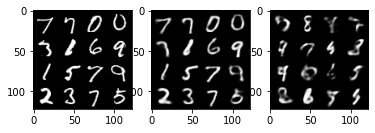

Iter: 47060/50000, Recon loss: 5486.7471, KL div loss: 1410.1774, Total loss: 6896.9243
Iter: 47070/50000, Recon loss: 5313.9961, KL div loss: 1443.3082, Total loss: 6757.3042
Iter: 47080/50000, Recon loss: 5032.8975, KL div loss: 1413.6138, Total loss: 6446.5112
Iter: 47090/50000, Recon loss: 5051.7012, KL div loss: 1385.1365, Total loss: 6436.8379
Iter: 47100/50000, Recon loss: 5270.3740, KL div loss: 1419.2605, Total loss: 6689.6348


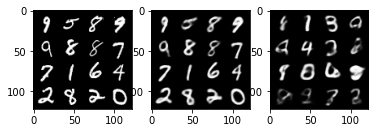

Iter: 47110/50000, Recon loss: 5395.5781, KL div loss: 1458.8645, Total loss: 6854.4424
Iter: 47120/50000, Recon loss: 5581.9580, KL div loss: 1417.6779, Total loss: 6999.6357
Iter: 47130/50000, Recon loss: 5381.5244, KL div loss: 1464.4255, Total loss: 6845.9502
Iter: 47140/50000, Recon loss: 5660.4248, KL div loss: 1497.2438, Total loss: 7157.6685
Iter: 47150/50000, Recon loss: 5654.0088, KL div loss: 1443.4777, Total loss: 7097.4863


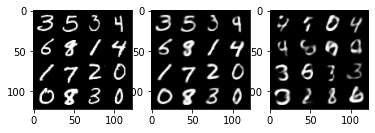

Iter: 47160/50000, Recon loss: 5248.6465, KL div loss: 1445.5651, Total loss: 6694.2114
Iter: 47170/50000, Recon loss: 5119.5996, KL div loss: 1411.4126, Total loss: 6531.0122
Iter: 47180/50000, Recon loss: 5328.1011, KL div loss: 1421.4596, Total loss: 6749.5605
Iter: 47190/50000, Recon loss: 4950.5840, KL div loss: 1383.4724, Total loss: 6334.0566
Iter: 47200/50000, Recon loss: 5352.2930, KL div loss: 1430.1614, Total loss: 6782.4541


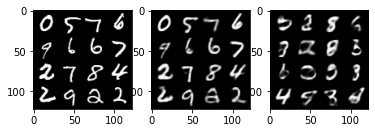

Iter: 47210/50000, Recon loss: 5392.3398, KL div loss: 1416.4404, Total loss: 6808.7803
Iter: 47220/50000, Recon loss: 5199.8193, KL div loss: 1370.5120, Total loss: 6570.3311
Iter: 47230/50000, Recon loss: 5138.7090, KL div loss: 1408.9951, Total loss: 6547.7041
Iter: 47240/50000, Recon loss: 5485.3027, KL div loss: 1476.0763, Total loss: 6961.3789
Iter: 47250/50000, Recon loss: 5383.3916, KL div loss: 1445.5861, Total loss: 6828.9775


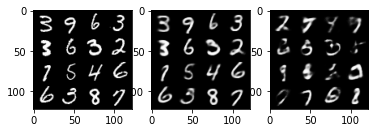

Iter: 47260/50000, Recon loss: 5195.8306, KL div loss: 1451.7146, Total loss: 6647.5449
Iter: 47270/50000, Recon loss: 5452.8428, KL div loss: 1428.6099, Total loss: 6881.4526
Iter: 47280/50000, Recon loss: 5331.6719, KL div loss: 1424.1201, Total loss: 6755.7920
Iter: 47290/50000, Recon loss: 5274.2119, KL div loss: 1456.3529, Total loss: 6730.5649
Iter: 47300/50000, Recon loss: 5458.0029, KL div loss: 1405.6223, Total loss: 6863.6250


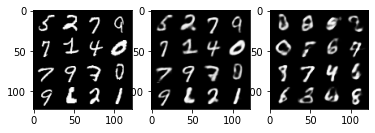

Iter: 47310/50000, Recon loss: 5452.6733, KL div loss: 1473.4899, Total loss: 6926.1631
Iter: 47320/50000, Recon loss: 5080.3799, KL div loss: 1429.5054, Total loss: 6509.8853
Iter: 47330/50000, Recon loss: 5342.6958, KL div loss: 1424.6896, Total loss: 6767.3853
Iter: 47340/50000, Recon loss: 5355.3765, KL div loss: 1462.9894, Total loss: 6818.3657
Iter: 47350/50000, Recon loss: 5630.1992, KL div loss: 1507.8145, Total loss: 7138.0137


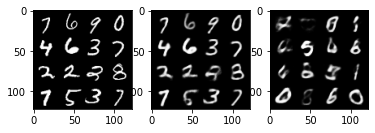

Iter: 47360/50000, Recon loss: 5093.8042, KL div loss: 1405.6195, Total loss: 6499.4238
Iter: 47370/50000, Recon loss: 5624.2700, KL div loss: 1484.5795, Total loss: 7108.8496
Iter: 47380/50000, Recon loss: 5634.2139, KL div loss: 1449.8245, Total loss: 7084.0381
Iter: 47390/50000, Recon loss: 5065.6934, KL div loss: 1425.5247, Total loss: 6491.2178
Iter: 47400/50000, Recon loss: 5313.5083, KL div loss: 1401.8196, Total loss: 6715.3281


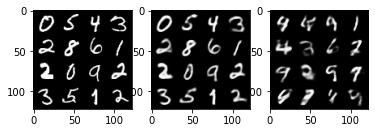

Iter: 47410/50000, Recon loss: 5093.5952, KL div loss: 1418.2772, Total loss: 6511.8726
Iter: 47420/50000, Recon loss: 5376.3447, KL div loss: 1412.5071, Total loss: 6788.8516
Iter: 47430/50000, Recon loss: 5319.0688, KL div loss: 1463.5251, Total loss: 6782.5938
Iter: 47440/50000, Recon loss: 5436.0713, KL div loss: 1413.2083, Total loss: 6849.2793
Iter: 47450/50000, Recon loss: 5465.6680, KL div loss: 1486.7839, Total loss: 6952.4521


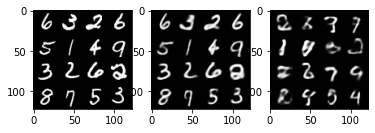

Iter: 47460/50000, Recon loss: 5462.9536, KL div loss: 1422.0072, Total loss: 6884.9609
Iter: 47470/50000, Recon loss: 5313.0449, KL div loss: 1416.9888, Total loss: 6730.0337
Iter: 47480/50000, Recon loss: 5323.7588, KL div loss: 1426.4137, Total loss: 6750.1724
Iter: 47490/50000, Recon loss: 5177.3955, KL div loss: 1422.6938, Total loss: 6600.0894
Iter: 47500/50000, Recon loss: 5355.6997, KL div loss: 1434.4858, Total loss: 6790.1855


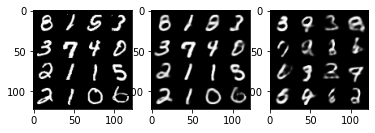

Iter: 47510/50000, Recon loss: 5747.0142, KL div loss: 1468.5901, Total loss: 7215.6045
Iter: 47520/50000, Recon loss: 5069.8984, KL div loss: 1394.1917, Total loss: 6464.0898
Iter: 47530/50000, Recon loss: 5148.2944, KL div loss: 1346.6562, Total loss: 6494.9507
Iter: 47540/50000, Recon loss: 5120.8242, KL div loss: 1419.2297, Total loss: 6540.0537
Iter: 47550/50000, Recon loss: 5174.1230, KL div loss: 1432.5571, Total loss: 6606.6802


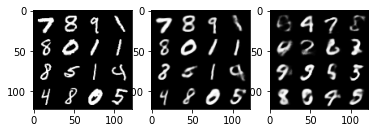

Iter: 47560/50000, Recon loss: 5217.6333, KL div loss: 1415.4146, Total loss: 6633.0479
Iter: 47570/50000, Recon loss: 5309.5225, KL div loss: 1492.4802, Total loss: 6802.0029
Iter: 47580/50000, Recon loss: 5204.1396, KL div loss: 1407.0256, Total loss: 6611.1650
Iter: 47590/50000, Recon loss: 5424.6426, KL div loss: 1463.5266, Total loss: 6888.1689
Iter: 47600/50000, Recon loss: 5231.7148, KL div loss: 1452.2312, Total loss: 6683.9463


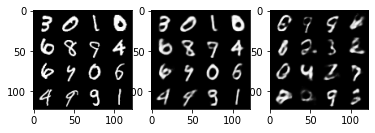

Iter: 47610/50000, Recon loss: 5186.4873, KL div loss: 1440.6880, Total loss: 6627.1753
Iter: 47620/50000, Recon loss: 5348.3799, KL div loss: 1446.0194, Total loss: 6794.3994
Iter: 47630/50000, Recon loss: 5338.3271, KL div loss: 1387.1538, Total loss: 6725.4810
Iter: 47640/50000, Recon loss: 5250.0718, KL div loss: 1417.0309, Total loss: 6667.1025
Iter: 47650/50000, Recon loss: 5482.4189, KL div loss: 1483.2037, Total loss: 6965.6226


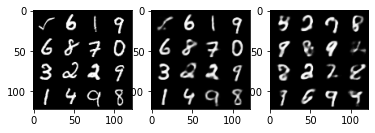

Iter: 47660/50000, Recon loss: 5346.2729, KL div loss: 1442.8599, Total loss: 6789.1328
Iter: 47670/50000, Recon loss: 5434.0908, KL div loss: 1424.5085, Total loss: 6858.5996
Iter: 47680/50000, Recon loss: 5320.9443, KL div loss: 1446.3083, Total loss: 6767.2529
Iter: 47690/50000, Recon loss: 5169.1270, KL div loss: 1443.5701, Total loss: 6612.6973
Iter: 47700/50000, Recon loss: 5138.1685, KL div loss: 1399.9191, Total loss: 6538.0874


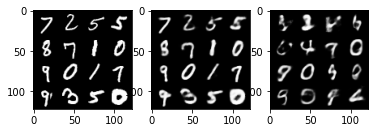

Iter: 47710/50000, Recon loss: 5430.3325, KL div loss: 1468.3999, Total loss: 6898.7324
Iter: 47720/50000, Recon loss: 5658.7354, KL div loss: 1506.3823, Total loss: 7165.1177
Iter: 47730/50000, Recon loss: 5620.6807, KL div loss: 1496.1475, Total loss: 7116.8281
Iter: 47740/50000, Recon loss: 5279.3555, KL div loss: 1401.9834, Total loss: 6681.3389
Iter: 47750/50000, Recon loss: 5345.0234, KL div loss: 1412.8912, Total loss: 6757.9146


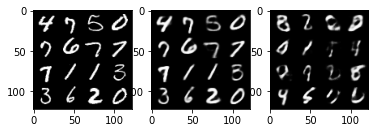

Iter: 47760/50000, Recon loss: 5345.8857, KL div loss: 1407.9944, Total loss: 6753.8799
Iter: 47770/50000, Recon loss: 5799.0137, KL div loss: 1433.0090, Total loss: 7232.0225
Iter: 47780/50000, Recon loss: 5502.7241, KL div loss: 1463.7402, Total loss: 6966.4644
Iter: 47790/50000, Recon loss: 5464.3389, KL div loss: 1427.6382, Total loss: 6891.9771
Iter: 47800/50000, Recon loss: 5087.6934, KL div loss: 1387.9824, Total loss: 6475.6758


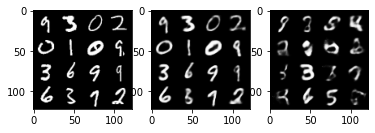

Iter: 47810/50000, Recon loss: 5205.8047, KL div loss: 1420.3353, Total loss: 6626.1401
Iter: 47820/50000, Recon loss: 5283.7905, KL div loss: 1413.3562, Total loss: 6697.1465
Iter: 47830/50000, Recon loss: 5352.8184, KL div loss: 1379.9961, Total loss: 6732.8145
Iter: 47840/50000, Recon loss: 5147.4316, KL div loss: 1431.2333, Total loss: 6578.6650
Iter: 47850/50000, Recon loss: 5563.8438, KL div loss: 1449.3785, Total loss: 7013.2222


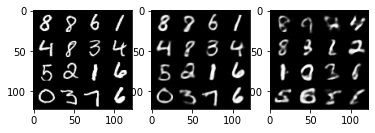

Iter: 47860/50000, Recon loss: 5355.9468, KL div loss: 1409.8203, Total loss: 6765.7671
Iter: 47870/50000, Recon loss: 5221.7954, KL div loss: 1464.6825, Total loss: 6686.4780
Iter: 47880/50000, Recon loss: 5371.2354, KL div loss: 1414.5334, Total loss: 6785.7686
Iter: 47890/50000, Recon loss: 5274.2231, KL div loss: 1391.4392, Total loss: 6665.6621
Iter: 47900/50000, Recon loss: 5313.9624, KL div loss: 1395.1887, Total loss: 6709.1514


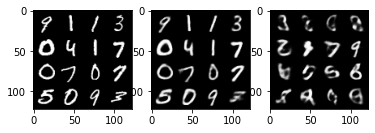

Iter: 47910/50000, Recon loss: 5398.5376, KL div loss: 1438.3293, Total loss: 6836.8672
Iter: 47920/50000, Recon loss: 5239.0850, KL div loss: 1416.1252, Total loss: 6655.2100
Iter: 47930/50000, Recon loss: 5458.3008, KL div loss: 1414.0858, Total loss: 6872.3867
Iter: 47940/50000, Recon loss: 5128.5645, KL div loss: 1437.1921, Total loss: 6565.7568
Iter: 47950/50000, Recon loss: 5305.8657, KL div loss: 1419.8345, Total loss: 6725.7002


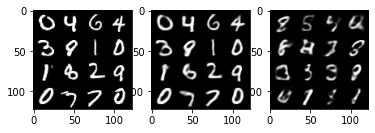

Iter: 47960/50000, Recon loss: 5078.0791, KL div loss: 1381.5664, Total loss: 6459.6455
Iter: 47970/50000, Recon loss: 5248.0923, KL div loss: 1416.5573, Total loss: 6664.6494
Iter: 47980/50000, Recon loss: 4964.6309, KL div loss: 1340.0706, Total loss: 6304.7012
Iter: 47990/50000, Recon loss: 5433.6006, KL div loss: 1472.6829, Total loss: 6906.2832
Iter: 48000/50000, Recon loss: 5411.4590, KL div loss: 1501.8958, Total loss: 6913.3545


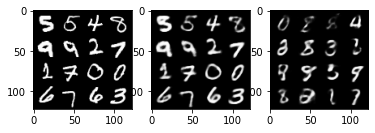

Iter: 48010/50000, Recon loss: 5381.2544, KL div loss: 1448.8071, Total loss: 6830.0615
Iter: 48020/50000, Recon loss: 5100.9678, KL div loss: 1404.1812, Total loss: 6505.1489
Iter: 48030/50000, Recon loss: 5340.3838, KL div loss: 1424.3752, Total loss: 6764.7588
Iter: 48040/50000, Recon loss: 5364.4561, KL div loss: 1425.1180, Total loss: 6789.5742
Iter: 48050/50000, Recon loss: 5422.7954, KL div loss: 1428.6681, Total loss: 6851.4634


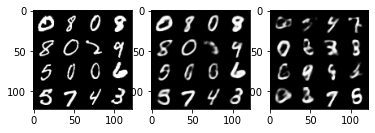

Iter: 48060/50000, Recon loss: 5322.4482, KL div loss: 1425.2244, Total loss: 6747.6729
Iter: 48070/50000, Recon loss: 5462.8369, KL div loss: 1435.1013, Total loss: 6897.9385
Iter: 48080/50000, Recon loss: 5065.7695, KL div loss: 1424.7849, Total loss: 6490.5547
Iter: 48090/50000, Recon loss: 5482.3403, KL div loss: 1450.1741, Total loss: 6932.5146
Iter: 48100/50000, Recon loss: 5288.6406, KL div loss: 1439.9834, Total loss: 6728.6240


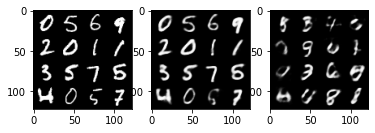

Iter: 48110/50000, Recon loss: 5432.9023, KL div loss: 1443.6631, Total loss: 6876.5654
Iter: 48120/50000, Recon loss: 5353.4209, KL div loss: 1424.6333, Total loss: 6778.0542
Iter: 48130/50000, Recon loss: 5507.7812, KL div loss: 1443.3561, Total loss: 6951.1372
Iter: 48140/50000, Recon loss: 5236.9238, KL div loss: 1469.3357, Total loss: 6706.2598
Iter: 48150/50000, Recon loss: 5339.5918, KL div loss: 1436.5941, Total loss: 6776.1860


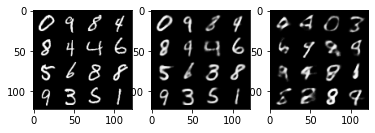

Iter: 48160/50000, Recon loss: 5153.9673, KL div loss: 1409.3435, Total loss: 6563.3105
Iter: 48170/50000, Recon loss: 5082.7314, KL div loss: 1441.0376, Total loss: 6523.7690
Iter: 48180/50000, Recon loss: 5419.8315, KL div loss: 1458.0044, Total loss: 6877.8359
Iter: 48190/50000, Recon loss: 5156.1328, KL div loss: 1417.0199, Total loss: 6573.1528
Iter: 48200/50000, Recon loss: 5900.9932, KL div loss: 1498.1780, Total loss: 7399.1709


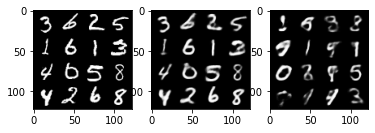

Iter: 48210/50000, Recon loss: 5571.1646, KL div loss: 1466.4460, Total loss: 7037.6104
Iter: 48220/50000, Recon loss: 5529.3315, KL div loss: 1429.5969, Total loss: 6958.9287
Iter: 48230/50000, Recon loss: 5293.5000, KL div loss: 1436.2871, Total loss: 6729.7871
Iter: 48240/50000, Recon loss: 5347.3198, KL div loss: 1425.1191, Total loss: 6772.4390
Iter: 48250/50000, Recon loss: 5160.6729, KL div loss: 1451.5396, Total loss: 6612.2124


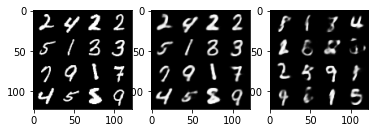

Iter: 48260/50000, Recon loss: 5329.4272, KL div loss: 1460.5071, Total loss: 6789.9346
Iter: 48270/50000, Recon loss: 4915.6660, KL div loss: 1402.5298, Total loss: 6318.1958
Iter: 48280/50000, Recon loss: 5409.9697, KL div loss: 1448.2739, Total loss: 6858.2437
Iter: 48290/50000, Recon loss: 5292.1592, KL div loss: 1444.9138, Total loss: 6737.0732
Iter: 48300/50000, Recon loss: 5219.4727, KL div loss: 1375.4282, Total loss: 6594.9009


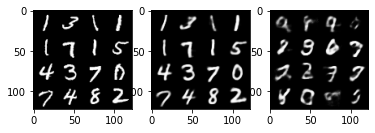

Iter: 48310/50000, Recon loss: 5360.1367, KL div loss: 1415.6487, Total loss: 6775.7852
Iter: 48320/50000, Recon loss: 5335.4097, KL div loss: 1415.6514, Total loss: 6751.0610
Iter: 48330/50000, Recon loss: 5252.3354, KL div loss: 1437.7798, Total loss: 6690.1152
Iter: 48340/50000, Recon loss: 5021.4453, KL div loss: 1409.0396, Total loss: 6430.4849
Iter: 48350/50000, Recon loss: 5537.1797, KL div loss: 1487.2021, Total loss: 7024.3818


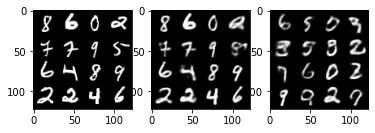

Iter: 48360/50000, Recon loss: 5203.4741, KL div loss: 1406.7823, Total loss: 6610.2563
Iter: 48370/50000, Recon loss: 5394.3516, KL div loss: 1469.9460, Total loss: 6864.2979
Iter: 48380/50000, Recon loss: 4944.1387, KL div loss: 1367.9253, Total loss: 6312.0640
Iter: 48390/50000, Recon loss: 5346.5317, KL div loss: 1457.9619, Total loss: 6804.4937
Iter: 48400/50000, Recon loss: 5237.0586, KL div loss: 1447.1008, Total loss: 6684.1592


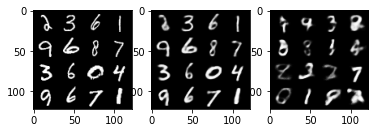

Iter: 48410/50000, Recon loss: 5481.0527, KL div loss: 1458.7999, Total loss: 6939.8525
Iter: 48420/50000, Recon loss: 5041.0688, KL div loss: 1412.8165, Total loss: 6453.8853
Iter: 48430/50000, Recon loss: 5293.2368, KL div loss: 1413.0256, Total loss: 6706.2627
Iter: 48440/50000, Recon loss: 5142.3262, KL div loss: 1400.1150, Total loss: 6542.4414
Iter: 48450/50000, Recon loss: 5455.9131, KL div loss: 1430.9490, Total loss: 6886.8623


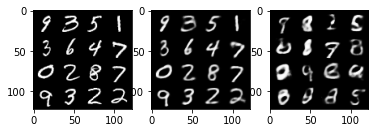

Iter: 48460/50000, Recon loss: 5257.2305, KL div loss: 1422.0280, Total loss: 6679.2583
Iter: 48470/50000, Recon loss: 5355.5137, KL div loss: 1399.6638, Total loss: 6755.1777
Iter: 48480/50000, Recon loss: 5389.8623, KL div loss: 1440.5747, Total loss: 6830.4370
Iter: 48490/50000, Recon loss: 5050.1680, KL div loss: 1406.2958, Total loss: 6456.4639
Iter: 48500/50000, Recon loss: 5134.6914, KL div loss: 1403.9473, Total loss: 6538.6387


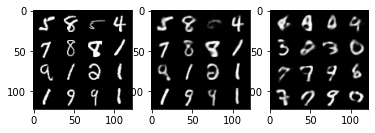

Iter: 48510/50000, Recon loss: 5324.0840, KL div loss: 1449.1602, Total loss: 6773.2441
Iter: 48520/50000, Recon loss: 5146.6309, KL div loss: 1403.9529, Total loss: 6550.5840
Iter: 48530/50000, Recon loss: 4972.1592, KL div loss: 1371.7423, Total loss: 6343.9014
Iter: 48540/50000, Recon loss: 5401.4736, KL div loss: 1471.6353, Total loss: 6873.1089
Iter: 48550/50000, Recon loss: 5387.7695, KL div loss: 1489.8159, Total loss: 6877.5854


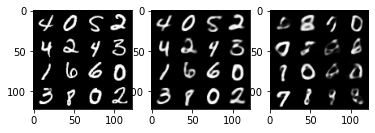

Iter: 48560/50000, Recon loss: 5629.2007, KL div loss: 1471.8252, Total loss: 7101.0259
Iter: 48570/50000, Recon loss: 5523.1924, KL div loss: 1464.8066, Total loss: 6987.9990
Iter: 48580/50000, Recon loss: 5405.0342, KL div loss: 1429.5726, Total loss: 6834.6069
Iter: 48590/50000, Recon loss: 5258.0977, KL div loss: 1419.2307, Total loss: 6677.3281
Iter: 48600/50000, Recon loss: 5524.6348, KL div loss: 1413.9004, Total loss: 6938.5352


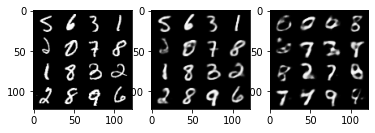

Iter: 48610/50000, Recon loss: 5149.5483, KL div loss: 1419.2166, Total loss: 6568.7646
Iter: 48620/50000, Recon loss: 5382.2861, KL div loss: 1416.3224, Total loss: 6798.6084
Iter: 48630/50000, Recon loss: 5437.7959, KL div loss: 1435.0857, Total loss: 6872.8818
Iter: 48640/50000, Recon loss: 5111.0293, KL div loss: 1433.2032, Total loss: 6544.2324
Iter: 48650/50000, Recon loss: 5469.8193, KL div loss: 1458.0654, Total loss: 6927.8848


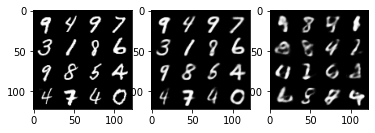

Iter: 48660/50000, Recon loss: 5411.0249, KL div loss: 1440.6465, Total loss: 6851.6714
Iter: 48670/50000, Recon loss: 5287.5029, KL div loss: 1446.3417, Total loss: 6733.8447
Iter: 48680/50000, Recon loss: 5128.4902, KL div loss: 1370.3767, Total loss: 6498.8672
Iter: 48690/50000, Recon loss: 5483.4219, KL div loss: 1440.6362, Total loss: 6924.0581
Iter: 48700/50000, Recon loss: 5614.3872, KL div loss: 1462.2271, Total loss: 7076.6143


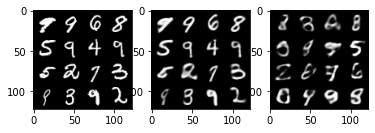

Iter: 48710/50000, Recon loss: 5370.9414, KL div loss: 1425.5518, Total loss: 6796.4932
Iter: 48720/50000, Recon loss: 5158.4883, KL div loss: 1426.8320, Total loss: 6585.3203
Iter: 48730/50000, Recon loss: 5365.7891, KL div loss: 1416.0867, Total loss: 6781.8760
Iter: 48740/50000, Recon loss: 5202.9502, KL div loss: 1374.3770, Total loss: 6577.3271
Iter: 48750/50000, Recon loss: 5108.5562, KL div loss: 1389.4906, Total loss: 6498.0469


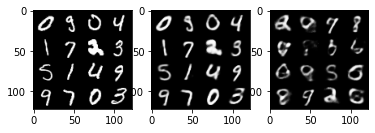

Iter: 48760/50000, Recon loss: 5194.1123, KL div loss: 1423.7637, Total loss: 6617.8760
Iter: 48770/50000, Recon loss: 5579.7812, KL div loss: 1448.4304, Total loss: 7028.2119
Iter: 48780/50000, Recon loss: 5431.1865, KL div loss: 1412.0542, Total loss: 6843.2407
Iter: 48790/50000, Recon loss: 5171.8911, KL div loss: 1397.6282, Total loss: 6569.5195
Iter: 48800/50000, Recon loss: 5376.3770, KL div loss: 1449.8173, Total loss: 6826.1943


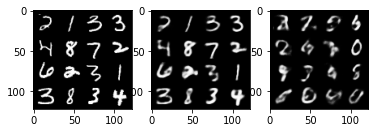

Iter: 48810/50000, Recon loss: 5447.7422, KL div loss: 1443.5276, Total loss: 6891.2695
Iter: 48820/50000, Recon loss: 5409.6689, KL div loss: 1452.9844, Total loss: 6862.6533
Iter: 48830/50000, Recon loss: 5222.7051, KL div loss: 1438.3300, Total loss: 6661.0352
Iter: 48840/50000, Recon loss: 5336.7607, KL div loss: 1439.4812, Total loss: 6776.2422
Iter: 48850/50000, Recon loss: 4862.0088, KL div loss: 1357.7297, Total loss: 6219.7383


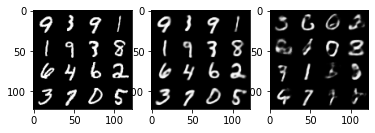

Iter: 48860/50000, Recon loss: 5468.1597, KL div loss: 1437.5347, Total loss: 6905.6943
Iter: 48870/50000, Recon loss: 5601.9272, KL div loss: 1458.1741, Total loss: 7060.1016
Iter: 48880/50000, Recon loss: 5485.0693, KL div loss: 1416.6405, Total loss: 6901.7100
Iter: 48890/50000, Recon loss: 5153.4819, KL div loss: 1382.4089, Total loss: 6535.8906
Iter: 48900/50000, Recon loss: 5601.6641, KL div loss: 1452.6208, Total loss: 7054.2852


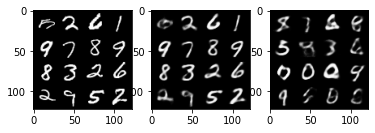

Iter: 48910/50000, Recon loss: 5216.8320, KL div loss: 1404.8883, Total loss: 6621.7202
Iter: 48920/50000, Recon loss: 5559.5557, KL div loss: 1436.2346, Total loss: 6995.7900
Iter: 48930/50000, Recon loss: 5387.1265, KL div loss: 1442.6721, Total loss: 6829.7988
Iter: 48940/50000, Recon loss: 5641.6216, KL div loss: 1446.6683, Total loss: 7088.2900
Iter: 48950/50000, Recon loss: 5130.9526, KL div loss: 1390.6968, Total loss: 6521.6494


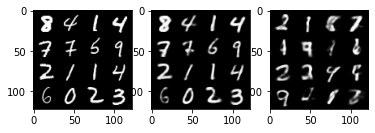

Iter: 48960/50000, Recon loss: 5541.9688, KL div loss: 1493.3928, Total loss: 7035.3613
Iter: 48970/50000, Recon loss: 5496.0625, KL div loss: 1419.0410, Total loss: 6915.1035
Iter: 48980/50000, Recon loss: 5269.0879, KL div loss: 1425.1282, Total loss: 6694.2158
Iter: 48990/50000, Recon loss: 5494.4316, KL div loss: 1473.5400, Total loss: 6967.9717
Iter: 49000/50000, Recon loss: 5182.9863, KL div loss: 1413.2986, Total loss: 6596.2852


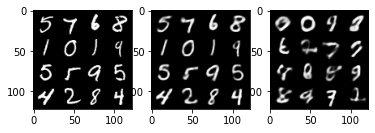

Iter: 49010/50000, Recon loss: 5391.0615, KL div loss: 1443.1785, Total loss: 6834.2402
Iter: 49020/50000, Recon loss: 5531.6206, KL div loss: 1466.4543, Total loss: 6998.0752
Iter: 49030/50000, Recon loss: 5058.0078, KL div loss: 1392.3230, Total loss: 6450.3311
Iter: 49040/50000, Recon loss: 5376.3613, KL div loss: 1421.8459, Total loss: 6798.2070
Iter: 49050/50000, Recon loss: 4972.8423, KL div loss: 1411.8335, Total loss: 6384.6758


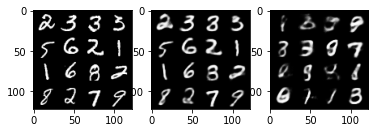

Iter: 49060/50000, Recon loss: 5555.3213, KL div loss: 1448.0022, Total loss: 7003.3232
Iter: 49070/50000, Recon loss: 5668.9478, KL div loss: 1464.6370, Total loss: 7133.5850
Iter: 49080/50000, Recon loss: 5558.7207, KL div loss: 1473.5862, Total loss: 7032.3066
Iter: 49090/50000, Recon loss: 5288.9507, KL div loss: 1455.0583, Total loss: 6744.0088
Iter: 49100/50000, Recon loss: 5279.7632, KL div loss: 1417.5310, Total loss: 6697.2939


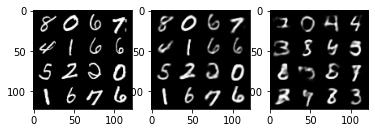

Iter: 49110/50000, Recon loss: 5138.3691, KL div loss: 1381.7668, Total loss: 6520.1357
Iter: 49120/50000, Recon loss: 5180.2837, KL div loss: 1405.0371, Total loss: 6585.3208
Iter: 49130/50000, Recon loss: 5332.0000, KL div loss: 1446.6091, Total loss: 6778.6094
Iter: 49140/50000, Recon loss: 5509.7446, KL div loss: 1446.0889, Total loss: 6955.8335
Iter: 49150/50000, Recon loss: 5121.0210, KL div loss: 1398.1307, Total loss: 6519.1519


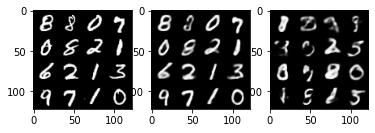

Iter: 49160/50000, Recon loss: 5240.7212, KL div loss: 1432.2354, Total loss: 6672.9565
Iter: 49170/50000, Recon loss: 5170.0391, KL div loss: 1403.7383, Total loss: 6573.7773
Iter: 49180/50000, Recon loss: 5304.8462, KL div loss: 1466.8503, Total loss: 6771.6963
Iter: 49190/50000, Recon loss: 5057.7715, KL div loss: 1388.7947, Total loss: 6446.5664
Iter: 49200/50000, Recon loss: 5120.0640, KL div loss: 1383.0647, Total loss: 6503.1289


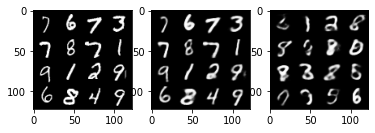

Iter: 49210/50000, Recon loss: 5305.2251, KL div loss: 1417.2935, Total loss: 6722.5186
Iter: 49220/50000, Recon loss: 5309.2700, KL div loss: 1411.1193, Total loss: 6720.3892
Iter: 49230/50000, Recon loss: 5389.0332, KL div loss: 1450.9489, Total loss: 6839.9819
Iter: 49240/50000, Recon loss: 5400.9438, KL div loss: 1470.9500, Total loss: 6871.8936
Iter: 49250/50000, Recon loss: 5537.3687, KL div loss: 1434.6555, Total loss: 6972.0244


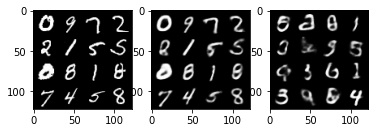

Iter: 49260/50000, Recon loss: 5076.2749, KL div loss: 1371.8092, Total loss: 6448.0840
Iter: 49270/50000, Recon loss: 5377.8511, KL div loss: 1415.5514, Total loss: 6793.4023
Iter: 49280/50000, Recon loss: 5294.9546, KL div loss: 1438.5427, Total loss: 6733.4971
Iter: 49290/50000, Recon loss: 5397.8149, KL div loss: 1434.8669, Total loss: 6832.6816
Iter: 49300/50000, Recon loss: 5285.8335, KL div loss: 1482.1636, Total loss: 6767.9971


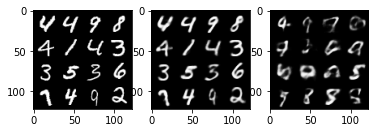

Iter: 49310/50000, Recon loss: 5196.3086, KL div loss: 1436.9789, Total loss: 6633.2876
Iter: 49320/50000, Recon loss: 5498.2725, KL div loss: 1451.9319, Total loss: 6950.2041
Iter: 49330/50000, Recon loss: 5062.6431, KL div loss: 1418.3508, Total loss: 6480.9941
Iter: 49340/50000, Recon loss: 5382.7803, KL div loss: 1433.4001, Total loss: 6816.1807
Iter: 49350/50000, Recon loss: 5452.2803, KL div loss: 1425.6550, Total loss: 6877.9355


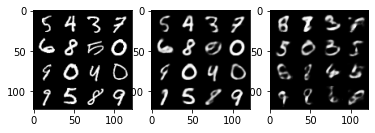

Iter: 49360/50000, Recon loss: 5188.0527, KL div loss: 1427.6058, Total loss: 6615.6587
Iter: 49370/50000, Recon loss: 5788.8076, KL div loss: 1484.6924, Total loss: 7273.5000
Iter: 49380/50000, Recon loss: 5117.0811, KL div loss: 1452.1472, Total loss: 6569.2285
Iter: 49390/50000, Recon loss: 5666.7148, KL div loss: 1448.1628, Total loss: 7114.8779
Iter: 49400/50000, Recon loss: 5309.9189, KL div loss: 1426.5156, Total loss: 6736.4346


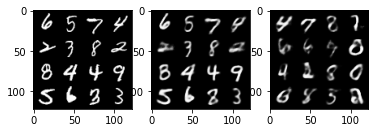

Iter: 49410/50000, Recon loss: 5351.9482, KL div loss: 1484.3356, Total loss: 6836.2837
Iter: 49420/50000, Recon loss: 5127.4473, KL div loss: 1390.4467, Total loss: 6517.8940
Iter: 49430/50000, Recon loss: 5182.6343, KL div loss: 1438.7731, Total loss: 6621.4072
Iter: 49440/50000, Recon loss: 5466.2617, KL div loss: 1414.4775, Total loss: 6880.7393
Iter: 49450/50000, Recon loss: 5572.2700, KL div loss: 1481.4427, Total loss: 7053.7129


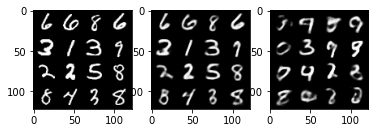

Iter: 49460/50000, Recon loss: 5415.7607, KL div loss: 1429.1985, Total loss: 6844.9590
Iter: 49470/50000, Recon loss: 5677.0327, KL div loss: 1426.7068, Total loss: 7103.7393
Iter: 49480/50000, Recon loss: 5219.8052, KL div loss: 1427.8175, Total loss: 6647.6226
Iter: 49490/50000, Recon loss: 5285.3589, KL div loss: 1410.6469, Total loss: 6696.0059
Iter: 49500/50000, Recon loss: 5267.3828, KL div loss: 1459.0570, Total loss: 6726.4399


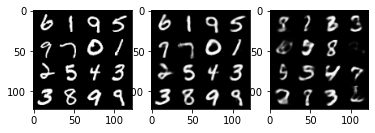

Iter: 49510/50000, Recon loss: 5373.5771, KL div loss: 1412.7354, Total loss: 6786.3125
Iter: 49520/50000, Recon loss: 5220.2910, KL div loss: 1406.8044, Total loss: 6627.0957
Iter: 49530/50000, Recon loss: 5250.4692, KL div loss: 1450.4484, Total loss: 6700.9175
Iter: 49540/50000, Recon loss: 5379.7764, KL div loss: 1508.8767, Total loss: 6888.6533
Iter: 49550/50000, Recon loss: 5307.9932, KL div loss: 1443.4462, Total loss: 6751.4395


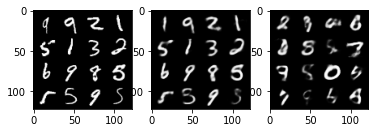

Iter: 49560/50000, Recon loss: 5250.0977, KL div loss: 1431.7981, Total loss: 6681.8955
Iter: 49570/50000, Recon loss: 5448.5669, KL div loss: 1496.5419, Total loss: 6945.1089
Iter: 49580/50000, Recon loss: 5324.0381, KL div loss: 1420.2605, Total loss: 6744.2988
Iter: 49590/50000, Recon loss: 5323.7837, KL div loss: 1432.8994, Total loss: 6756.6831
Iter: 49600/50000, Recon loss: 5351.7383, KL div loss: 1429.6499, Total loss: 6781.3882


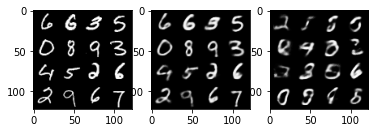

Iter: 49610/50000, Recon loss: 4922.3857, KL div loss: 1425.3722, Total loss: 6347.7578
Iter: 49620/50000, Recon loss: 5127.0913, KL div loss: 1411.6550, Total loss: 6538.7461
Iter: 49630/50000, Recon loss: 5305.3901, KL div loss: 1408.9133, Total loss: 6714.3037
Iter: 49640/50000, Recon loss: 5366.8657, KL div loss: 1476.4529, Total loss: 6843.3184
Iter: 49650/50000, Recon loss: 5229.4829, KL div loss: 1402.9208, Total loss: 6632.4038


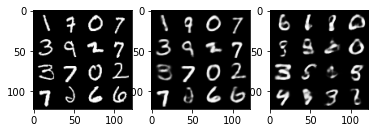

Iter: 49660/50000, Recon loss: 5431.5508, KL div loss: 1394.5184, Total loss: 6826.0693
Iter: 49670/50000, Recon loss: 5191.5371, KL div loss: 1361.4443, Total loss: 6552.9814
Iter: 49680/50000, Recon loss: 5700.1416, KL div loss: 1457.2689, Total loss: 7157.4106
Iter: 49690/50000, Recon loss: 5436.1436, KL div loss: 1485.3199, Total loss: 6921.4634
Iter: 49700/50000, Recon loss: 5231.2607, KL div loss: 1381.4728, Total loss: 6612.7334


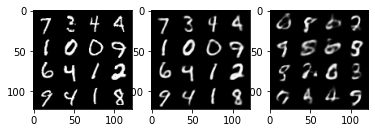

Iter: 49710/50000, Recon loss: 5441.0830, KL div loss: 1436.8453, Total loss: 6877.9282
Iter: 49720/50000, Recon loss: 5379.2749, KL div loss: 1418.2920, Total loss: 6797.5669
Iter: 49730/50000, Recon loss: 5455.1904, KL div loss: 1420.3783, Total loss: 6875.5688
Iter: 49740/50000, Recon loss: 5481.7988, KL div loss: 1404.4299, Total loss: 6886.2285
Iter: 49750/50000, Recon loss: 5508.3369, KL div loss: 1445.3130, Total loss: 6953.6499


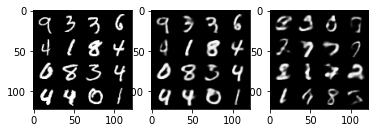

Iter: 49760/50000, Recon loss: 5486.7261, KL div loss: 1419.3412, Total loss: 6906.0674
Iter: 49770/50000, Recon loss: 5524.9258, KL div loss: 1428.9955, Total loss: 6953.9214
Iter: 49780/50000, Recon loss: 5381.0537, KL div loss: 1460.0105, Total loss: 6841.0645
Iter: 49790/50000, Recon loss: 5432.3535, KL div loss: 1449.2295, Total loss: 6881.5830
Iter: 49800/50000, Recon loss: 5349.6250, KL div loss: 1450.2549, Total loss: 6799.8799


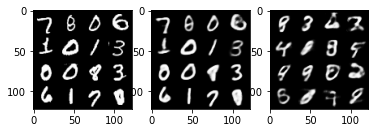

Iter: 49810/50000, Recon loss: 5404.9619, KL div loss: 1426.9893, Total loss: 6831.9512
Iter: 49820/50000, Recon loss: 5290.6367, KL div loss: 1474.3489, Total loss: 6764.9854
Iter: 49830/50000, Recon loss: 5032.8311, KL div loss: 1354.2207, Total loss: 6387.0518
Iter: 49840/50000, Recon loss: 5295.6338, KL div loss: 1455.0920, Total loss: 6750.7256
Iter: 49850/50000, Recon loss: 5098.0088, KL div loss: 1423.4434, Total loss: 6521.4521


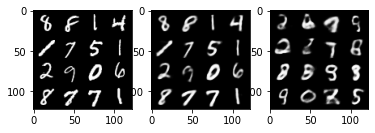

Iter: 49860/50000, Recon loss: 5299.3477, KL div loss: 1446.0160, Total loss: 6745.3638
Iter: 49870/50000, Recon loss: 5021.7168, KL div loss: 1429.7227, Total loss: 6451.4395
Iter: 49880/50000, Recon loss: 5132.6084, KL div loss: 1413.5022, Total loss: 6546.1104
Iter: 49890/50000, Recon loss: 5251.2114, KL div loss: 1402.9248, Total loss: 6654.1362
Iter: 49900/50000, Recon loss: 5342.4121, KL div loss: 1491.3162, Total loss: 6833.7285


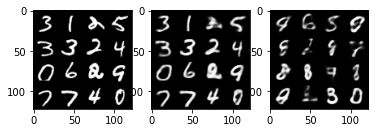

Iter: 49910/50000, Recon loss: 5370.5107, KL div loss: 1469.6722, Total loss: 6840.1831
Iter: 49920/50000, Recon loss: 5330.5049, KL div loss: 1419.3099, Total loss: 6749.8149
Iter: 49930/50000, Recon loss: 5159.3174, KL div loss: 1404.1448, Total loss: 6563.4619
Iter: 49940/50000, Recon loss: 5229.1885, KL div loss: 1419.0007, Total loss: 6648.1895
Iter: 49950/50000, Recon loss: 5542.3604, KL div loss: 1429.2344, Total loss: 6971.5947


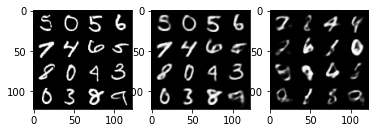

Iter: 49960/50000, Recon loss: 5098.4912, KL div loss: 1406.0498, Total loss: 6504.5410
Iter: 49970/50000, Recon loss: 5555.9521, KL div loss: 1430.7325, Total loss: 6986.6846
Iter: 49980/50000, Recon loss: 4974.9932, KL div loss: 1434.2368, Total loss: 6409.2300
Iter: 49990/50000, Recon loss: 5002.3511, KL div loss: 1409.7123, Total loss: 6412.0635
Iter: 50000/50000, Recon loss: 5288.9111, KL div loss: 1446.7793, Total loss: 6735.6904


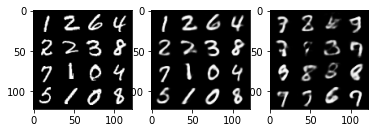

In [10]:
from torch.utils.data import DataLoader
from torchvision.utils import make_grid, save_image
import matplotlib.pyplot as plt

dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)
dataloader_iter = iter(dataloader)

vae = VAE(img_dim, latent_dim).to(device)

optimizer = torch.optim.Adam(vae.parameters(), learning_rate)


for it in range(total_iter):
    try:
        imgs, _ = next(dataloader_iter)
    except:
        dataloader_iter = iter(dataloader)
        imgs, _ = next(dataloader_iter)
        
    imgs = imgs.view((-1, img_dim)).to(device)
    recon_imgs, mu, logvar = vae(imgs)
    
    ################ ToDo ################
    recon_loss = F.binary_cross_entropy(recon_imgs, imgs.view(-1, 784), reduction='sum')
    kldiv_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    total_loss = (recon_loss + kldiv_loss)
    
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    
    if (it+1) % log_freq == 0:
        print("Iter: %05d/%d, Recon loss: %.4f, KL div loss: %.4f, Total loss: %.4f"%(it+1, total_iter,
                                                                                            recon_loss.data.item(),
                                                                                            kldiv_loss.data.item(),
                                                                                            total_loss.data.item()))
        
    if (it+1) % viz_freq == 0:
        with torch.no_grad():
            gen_imgs = vae.sample(16)
        org_imgs = make_grid(imgs[:16, :].view((16, 1, 28, 28)), nrow=4).permute(1, 2, 0).cpu().detach().numpy()
        plt.subplot(1, 3, 1)
        plt.imshow(org_imgs)
        recon_imgs = make_grid(recon_imgs[:16].view((16, 1, 28, 28)), nrow=4).permute(1, 2, 0).cpu().detach().numpy()
        plt.subplot(1, 3, 2)
        plt.imshow(recon_imgs)
        gen_imgs = make_grid(gen_imgs[:16].view((16, 1, 28, 28)), nrow=4).permute(1, 2, 0).cpu().detach().numpy()
        plt.subplot(1, 3, 3)
        plt.imshow(gen_imgs)
            
        plt.show()